In [2]:
!git clone https://github.com/rmcl/modeling-physiology-birdsong.git

Cloning into 'modeling-physiology-birdsong'...
remote: Enumerating objects: 113, done.
remote: Counting objects: 100% (113/113), done.
remote: Compressing objects: 100% (79/79), done.
remote: Total 113 (delta 56), reused 88 (delta 31), pack-reused 0 (from 0)
Receiving objects: 100% (113/113), 3.79 MiB | 5.05 MiB/s, done.
Resolving deltas: 100% (56/56), done.


In [3]:
!cd modeling-physiology-birdsong && git pull

Already up to date.


In [4]:
!ls modeling-physiology-birdsong

build_histograms_11_12_2024.ipynb     experiment_1_syllable_prob_shift	start-here.ipynb
build_pst_11_13_2024.ipynb	      experiment_2_avg_len_syllable	train_pst_utils.py
check_out_mat_files_11_11_2024.ipynb  Modeling_phys_canary
dataset_parser.py		      pypst


In [5]:
import sys
sys.path.append('modeling-physiology-birdsong')

In [6]:
# from dataset_parser import (
#     get_ordered_syllable_for_song,
#     get_recording_time_from_filename,
#     load_single_bird_syllable_csv,
#     split_dataset_by_surgery_date
# )

## No dataset_parser.py, so:

import re
from datetime import datetime
import csv
import json

def get_ordered_syllable_for_song(song_syllable_onsets_offsets_ms):
    """Using syllable_onsets_offsets_ms dictionary return an ordered list of tuples (syllable_label, onset, offset)

    syllable_onsets_offsets_ms (dict)
        key: syllable_label
        value: list of tuples (onset time, offset time)

    Alas python dictionaries are not ordered, so we can't rely on the order of the keys.
    """
    raw_syllable_tuples = []
    for syllable_label, times in song_syllable_onsets_offsets_ms.items():
        for start, end in times:
            raw_syllable_tuples.append((syllable_label, start, end))

    sorted_syllable_tuples = sorted(raw_syllable_tuples, key=lambda x: x[1])
    return sorted_syllable_tuples


def get_recording_time_from_filename(recording_file_path_name):
    """Function to extract animal_id and convert date/time to a datetime object using named groups"""
    try:
        # Define the regex pattern with named groups for animal_id, month, day, hour, minute, and second
        pattern = r'(?P<animal_id>[\w\d]+)_\d+\.\d+_(?P<month>\d+)_(?P<day>\d+)_(?P<hour>\d+)_(?P<minute>\d+)_(?P<second>\d+)\.wav$'

        # Search for the pattern in the file path
        match = re.search(pattern, recording_file_path_name)

        if match:
            # Use the named groups to extract the values
            animal_id = match.group('animal_id')
            month = match.group('month').zfill(2)
            day = match.group('day').zfill(2)
            hour = match.group('hour').zfill(2)
            minute = match.group('minute').zfill(2)
            second = match.group('second').zfill(2)

            # Construct a datetime object (assuming the year is 2024 for this example)
            date_time_str = f"2024-{month}-{day} {hour}:{minute}:{second}"
            date_time_obj = datetime.strptime(date_time_str, '%Y-%m-%d %H:%M:%S')

            return animal_id, date_time_obj
        else:
            return None, None  # Return None if no match is found
    except Exception as e:
        print(f"Error: {e}")
        return None, None


def load_single_bird_syllable_csv(file_path):
    """"""
    def unescape_and_eval(v):
        if v.startswith("''"):
            v = v.replace("''", "")
        if v.startswith("'"):
            v = v.replace("'", "")

        return eval(v)

    results = []
    with open(file_path, 'r') as f:
        reader = csv.DictReader(f)

        for row in reader:
            syllable_onsets_offsets_timebins = unescape_and_eval(row['syllable_onsets_offsets_timebins'])
            syllable_onsets_offsets_ms = unescape_and_eval(row['syllable_onsets_offsets_ms'])

            ordered_and_timed_syllables = get_ordered_syllable_for_song(syllable_onsets_offsets_ms)
            animal_id, recording_time = get_recording_time_from_filename(row['file_name'])

            data = {
                "file_name": row['file_name'],
                "song_present": row['song_present'],
                #'syllable_onsets_offsets_timebins': syllable_onsets_offsets_timebins,
                #'syllable_onsets_offsets_ms': syllable_onsets_offsets_ms,

                'animal_id': animal_id,
                'recording_time': recording_time,

                'ordered_and_timed_syllables': ordered_and_timed_syllables
            }

            results.append(data)

    return results

def split_dataset_by_surgery_date(results, surgery_date):
    """Split the dataset into two groups: pre-surgery and post-surgery based on the date of surgery"""
    results_pre_surgery = []
    results_post_surgery = []

    for result in results:
        recording_date = result['recording_time']

        if recording_date < surgery_date:
            results_pre_surgery.append(result)
        elif recording_date == surgery_date:
            raise ValueError("Recording date is the same as the surgery date")
        else:
            results_post_surgery.append(result)

    return results_pre_surgery, results_post_surgery

In [7]:

import pprint
file_path = 'modeling-physiology-birdsong/Modeling_phys_canary/USA5288_decoded.csv'

results = load_single_bird_syllable_csv(file_path)

print(f'SONGS IN DATASET: {len(results)}')
pprint.pprint(results[1])

import json
from datetime import datetime
json_file_path = 'modeling-physiology-birdsong/Modeling_phys_canary/USA5288_creation_data.json'

with open(json_file_path, 'r') as f:
    data = json.load(f)

    surgery_treatment_date = datetime.strptime(
        data['treatment_date'], '%Y-%m-%d')

print(f'Surgery Treatment Date: {surgery_treatment_date}')

results_pre_surgery, results_post_surgery = split_dataset_by_surgery_date(results, surgery_treatment_date)
print(f'PRE SURG SAMPLES: {len(results_pre_surgery)}, POST SURG SAMPLES: {len(results_post_surgery)}')

SONGS IN DATASET: 52151
{'animal_id': 'USA5288',
 'file_name': 'USA5288_45355.32438532_3_4_9_0_38.wav',
 'ordered_and_timed_syllables': [('8', 0.0, 1813.3333333333335),
                                 ('21', 1813.3333333333335, 3348.730158730159),
                                 ('22', 3348.730158730159, 4425.396825396826),
                                 ('21', 4425.396825396826, 4611.587301587302),
                                 ('22', 4611.587301587302, 4619.68253968254),
                                 ('21', 4619.68253968254, 4622.380952380952),
                                 ('22', 4622.380952380952, 4625.079365079366),
                                 ('21', 4625.079365079366, 4630.476190476191),
                                 ('26', 4630.476190476191, 4751.904761904762),
                                 ('23', 4751.904761904762, 5010.952380952382),
                                 ('2', 5010.952380952382, 5785.396825396826),
                                 ('3', 5785

In [8]:
def build_song_sequences(dataset):
    song_sequences = []
    for result in dataset:
        if len(result['ordered_and_timed_syllables']) == 0:
            continue

        song_sequences.append([
            str(s[0]) for s in result['ordered_and_timed_syllables']
        ])

    return song_sequences

pre_surgery_sequences = build_song_sequences(results_pre_surgery)
post_surgery_sequences = build_song_sequences(results_post_surgery)

In [9]:
from pypst import PST

"""
L=7; % maximum order
p_min=.0073; % minimum occurrence probability
g_min=.01; % minimum probability at each node=1.75;
r=1.6; % minimum difference between parent and child node
alpha=17.5;
p_smoothing=0;
"""



def train_pst(sequence_dataset, alphabet=None):

    pst = PST(
        L = 4,
        p_min = .00073, #0.0073,
        g_min = .01,
        r = 1.6,
        alpha = 17.5,
        alphabet = alphabet
    )
    pst.fit(sequence_dataset)

    return pst

pre_surgery_pst = train_pst(pre_surgery_sequences)
alphabet = pre_surgery_pst.alphabet
post_surgery_pst = train_pst(post_surgery_sequences, alphabet=alphabet)

In [10]:
s = pre_surgery_pst.tree[1]['string']
pre_surgery_pst.tree[1]['parent']
print(pre_surgery_pst.tree[1].keys())
pre_surgery_pst.tree[1]['label']
len(pre_surgery_pst.tree[1]['p']), pre_surgery_pst.tree[2]['p'][1].shape

dict_keys(['string', 'parent', 'label', 'internal', 'g_sigma_s', 'p', 'f'])


(29, (30,))

In [11]:
order = 2
idx = 3

print(len(pre_surgery_pst.tree[order]['p'][idx]), len(post_surgery_pst.tree[order]['p'][idx]))

trans = pre_surgery_pst.tree[order]['p'][idx]
trans

30 30


array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.39286457e-02,
       0.00000000e+00, 1.50320631e-03, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 4.79746694e-05, 6.39662258e-05, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00])

30 30


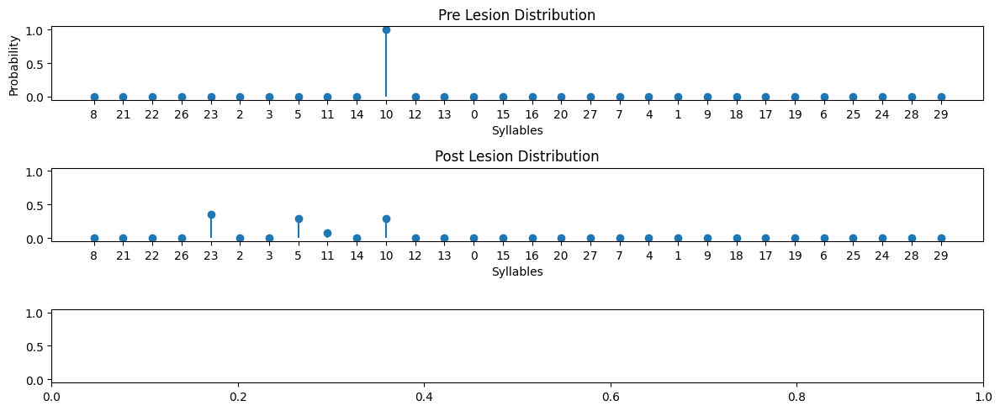

{"Earth Mover's Distance": 3.1428774265803514,
 'Information Gain': -1.272062113146192,
 'Kullback-Leibler Divergence': 1.2527617351373643}
30 30


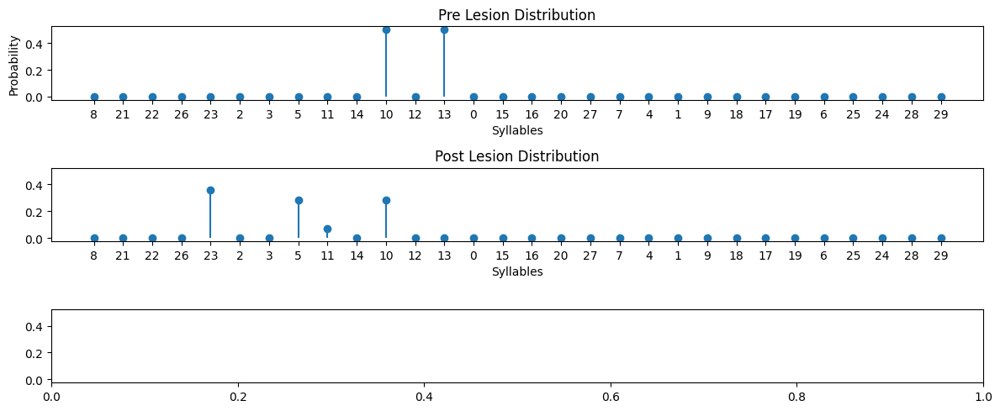

{"Earth Mover's Distance": 4.142865723153657,
 'Information Gain': -0.5789298038078534,
 'Kullback-Leibler Divergence': 9.96608071996119}
30 30


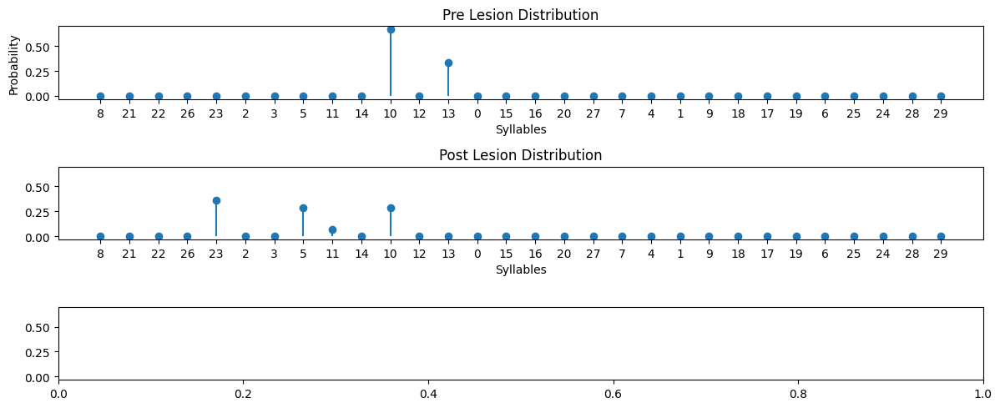

{"Earth Mover's Distance": 3.809529318056977,
 'Information Gain': -0.6355671967561931,
 'Kullback-Leibler Divergence': 6.887226949175807}
30 30


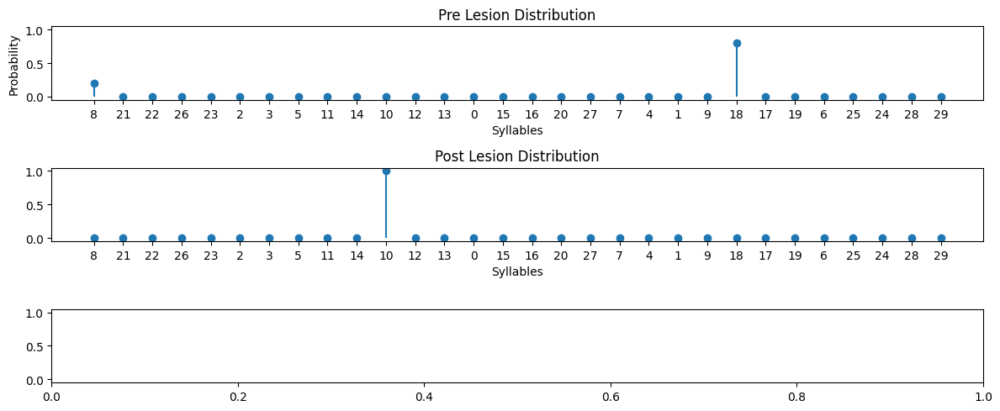

{"Earth Mover's Distance": 11.600005615035021,
 'Information Gain': 0.5003938934306709,
 'Kullback-Leibler Divergence': 16.926243778148987}
30 30


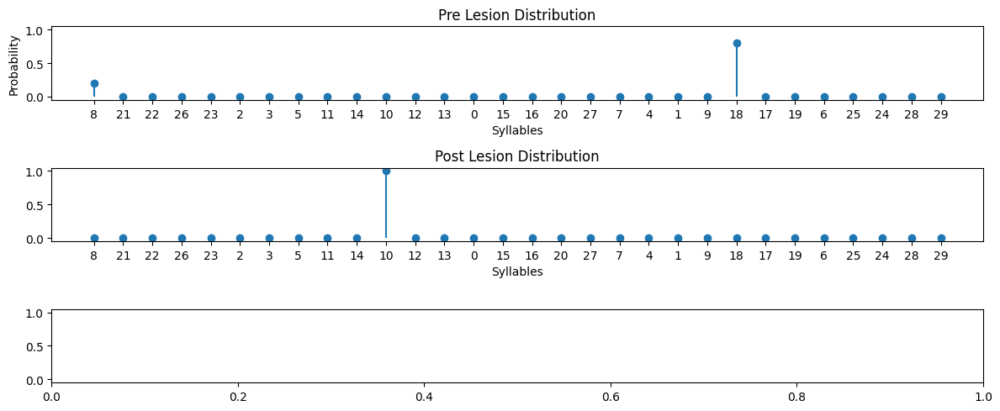

{"Earth Mover's Distance": 11.600005615035021,
 'Information Gain': 0.5003938934306709,
 'Kullback-Leibler Divergence': 16.926243778148987}
30 30


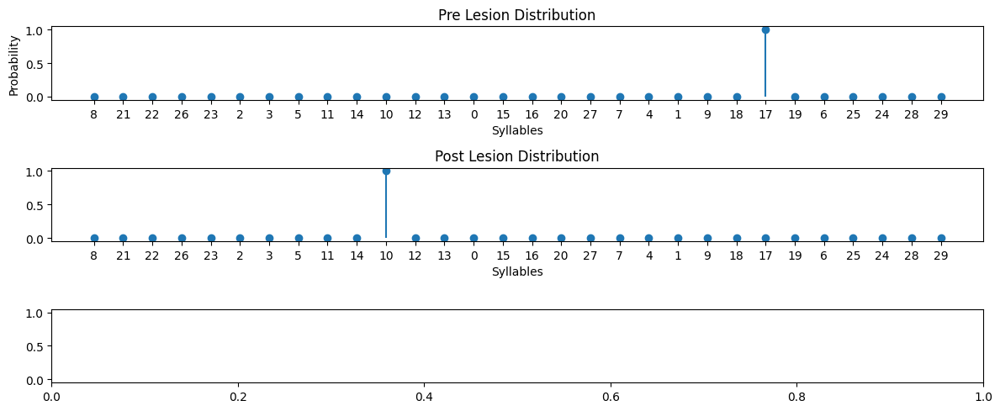

{"Earth Mover's Distance": 13.000000022746999,
 'Information Gain': 4.992943779704252e-07,
 'Kullback-Leibler Divergence': 17.426636879413305}
30 30


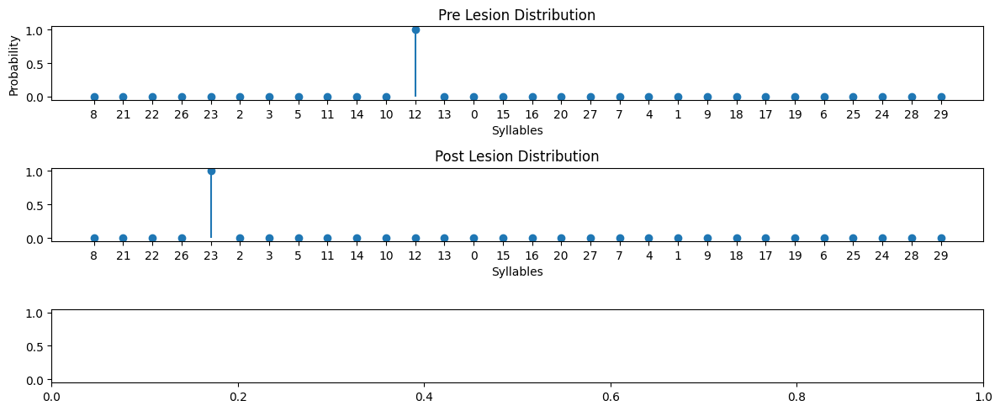

{"Earth Mover's Distance": 7.000007354905047,
 'Information Gain': -8.166129047451886e-06,
 'Kullback-Leibler Divergence': 17.426645837708705}
30 30


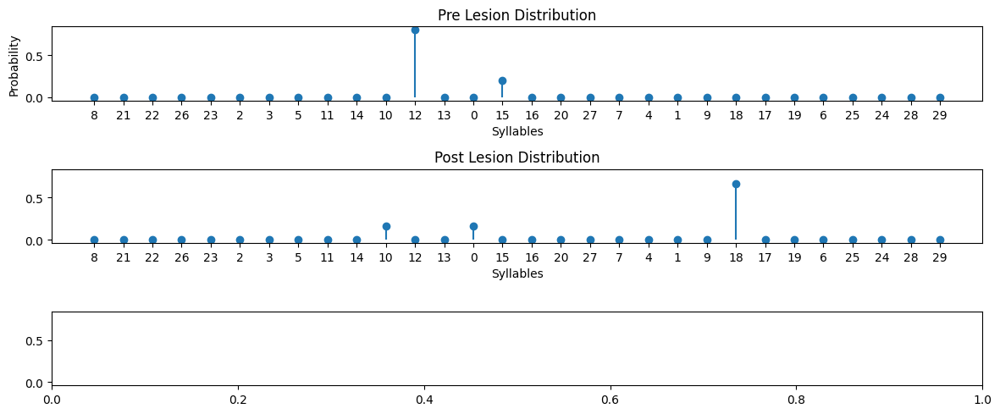

{"Earth Mover's Distance": 7.2333363016548216,
 'Information Gain': -0.36715725497173624,
 'Kullback-Leibler Divergence': 18.71800216582404}
30 30


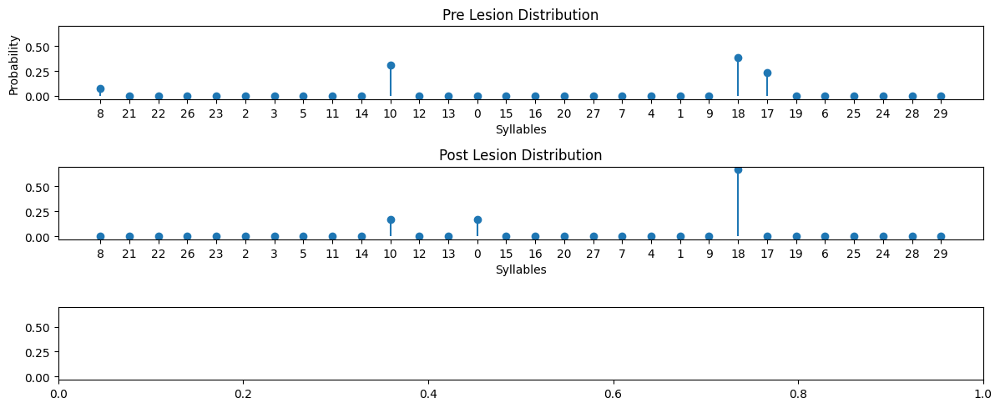

{"Earth Mover's Distance": 2.1153846074195783,
 'Information Gain': 0.3982932973249995,
 'Kullback-Leibler Divergence': 5.3547585808590465}
30 30


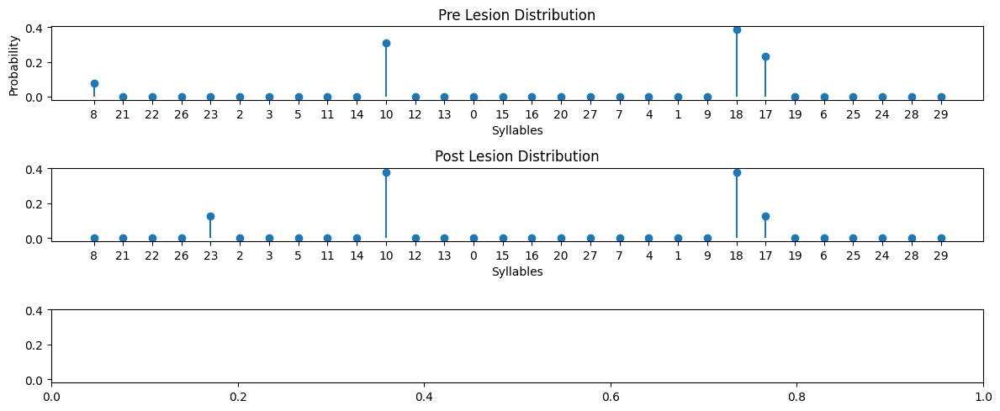

{"Earth Mover's Distance": 2.086538399120874,
 'Information Gain': 0.010374865561751268,
 'Kullback-Leibler Divergence': 1.393518528762257}
30 30


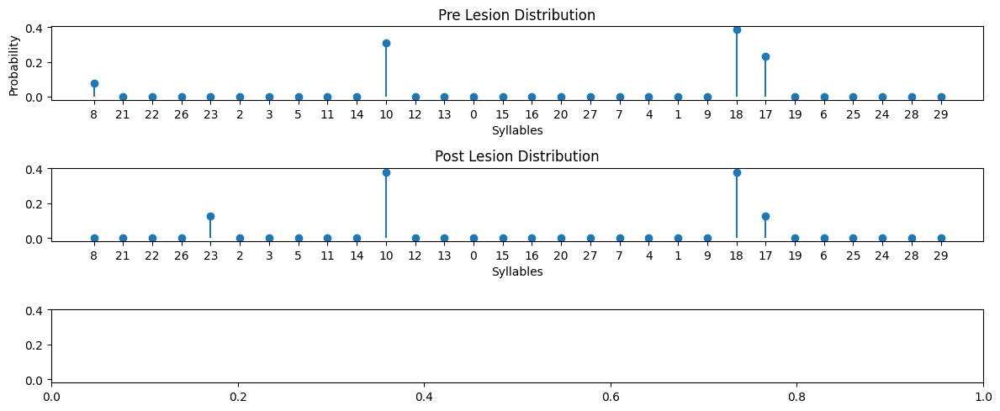

{"Earth Mover's Distance": 2.086538399120874,
 'Information Gain': 0.010374865561751268,
 'Kullback-Leibler Divergence': 1.393518528762257}
30 30


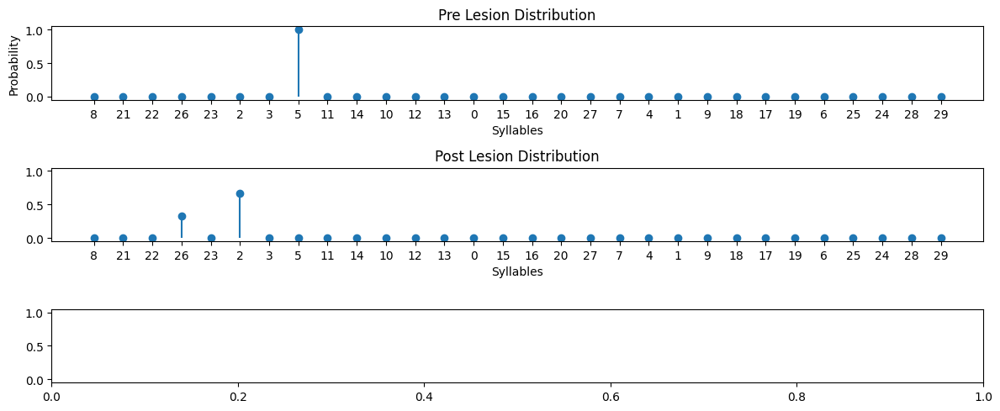

{"Earth Mover's Distance": 2.6666864591396493,
 'Information Gain': -0.6364901829913665,
 'Kullback-Leibler Divergence': 18.52523331199563}
30 30


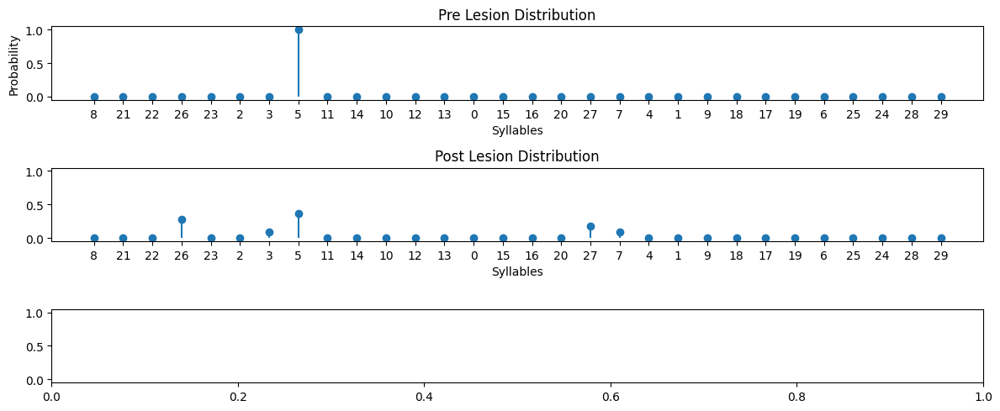

{"Earth Mover's Distance": 4.000022550252617,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 1.011598785319034}
30 30


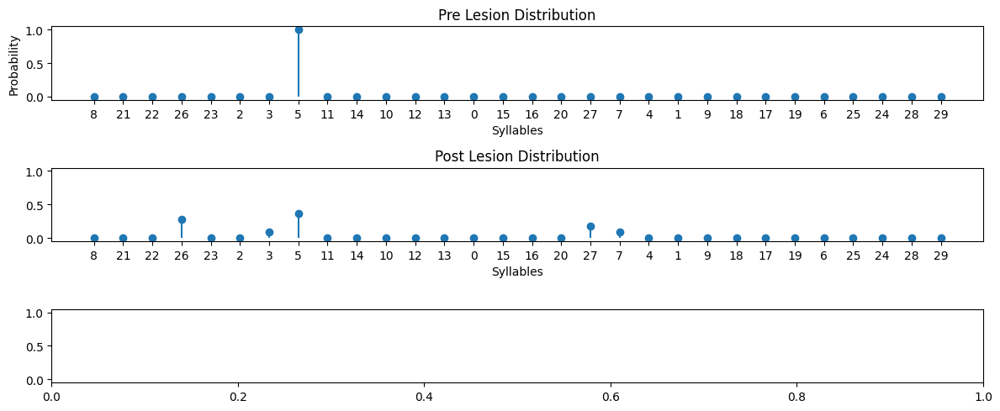

{"Earth Mover's Distance": 4.000022550252617,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 1.011598785319034}
30 30


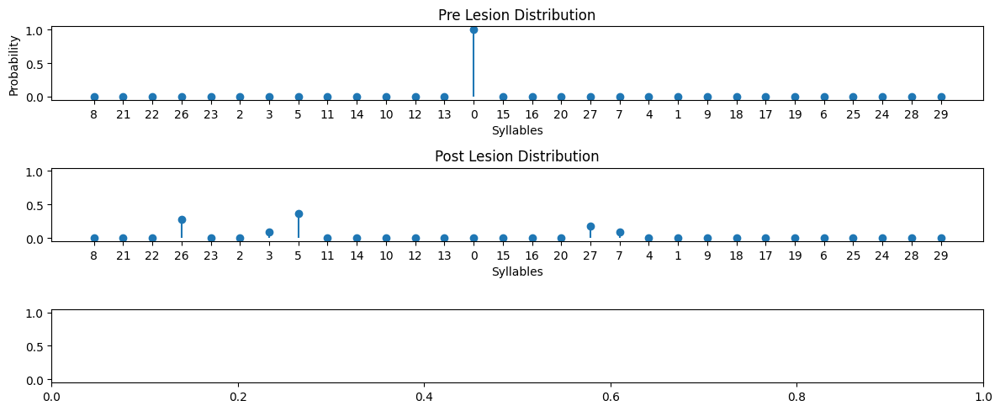

{"Earth Mover's Distance": 6.727288528518622,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 19.82451303168719}
30 30


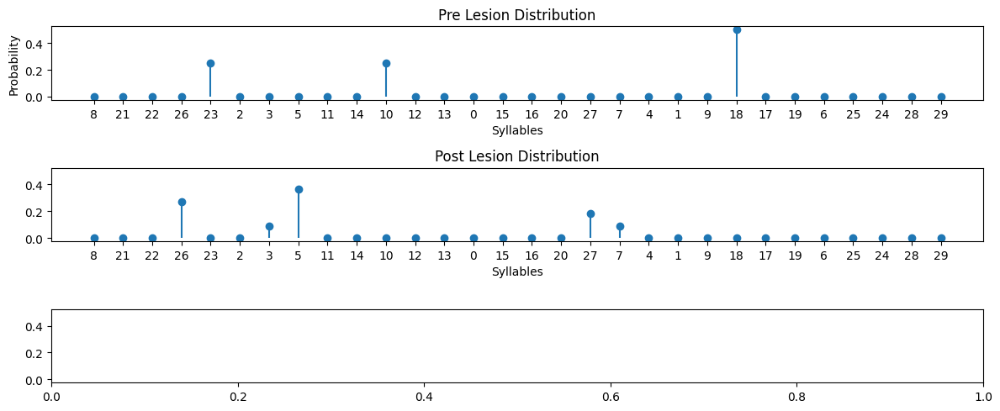

{"Earth Mover's Distance": 5.863636028728545,
 'Information Gain': -0.42841353252397996,
 'Kullback-Leibler Divergence': 18.78481797835106}
30 30


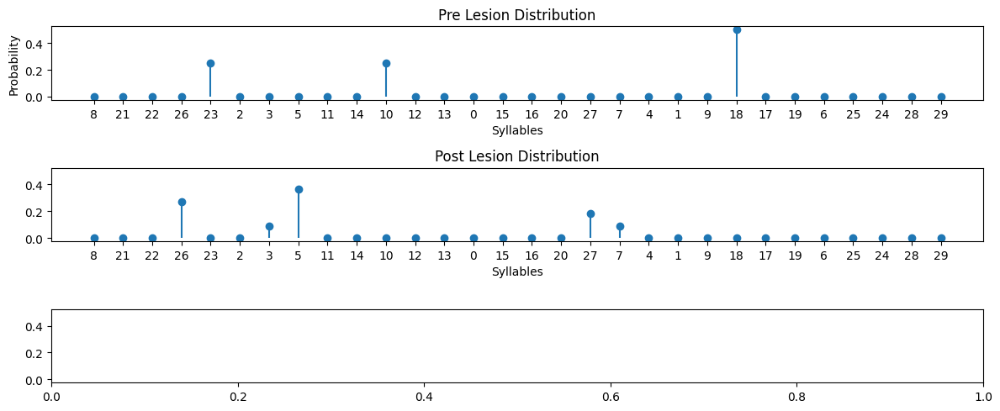

{"Earth Mover's Distance": 5.863636028728545,
 'Information Gain': -0.42841353252397996,
 'Kullback-Leibler Divergence': 18.78481797835106}
30 30


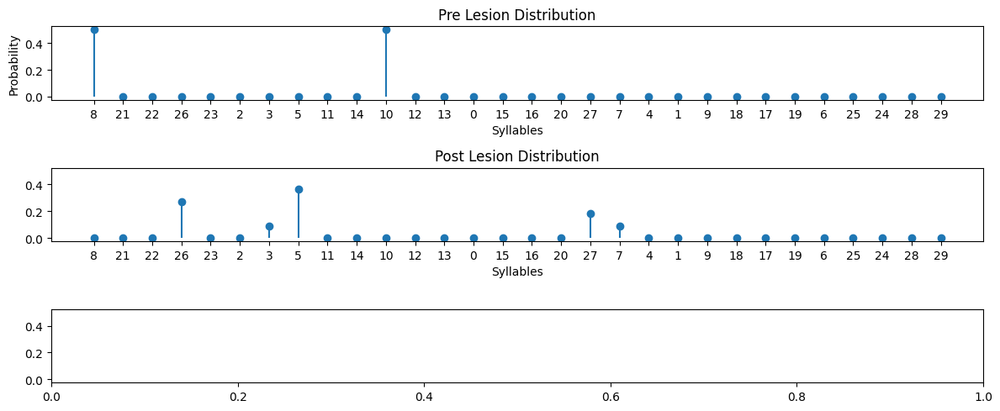

{"Earth Mover's Distance": 5.000010502507184,
 'Information Gain': -0.7749800709435355,
 'Kullback-Leibler Divergence': 19.131383251962294}
30 30


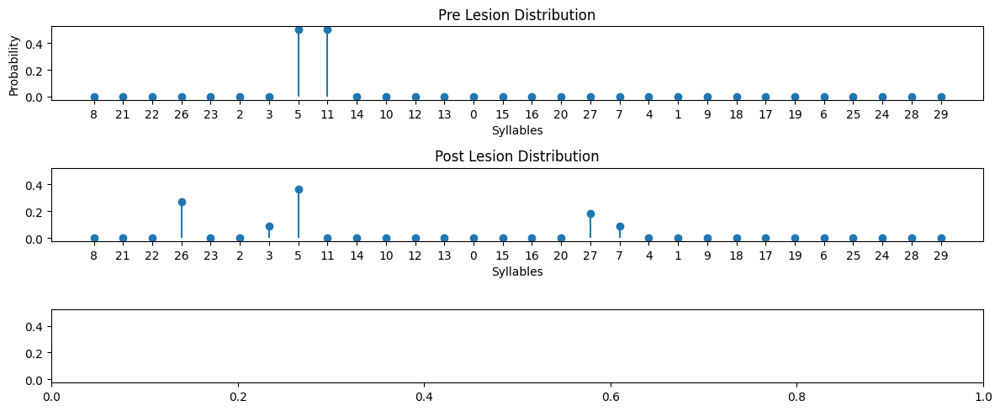

{"Earth Mover's Distance": 3.954555803731374,
 'Information Gain': -0.7749800709435355,
 'Kullback-Leibler Divergence': 9.724918224538943}
30 30


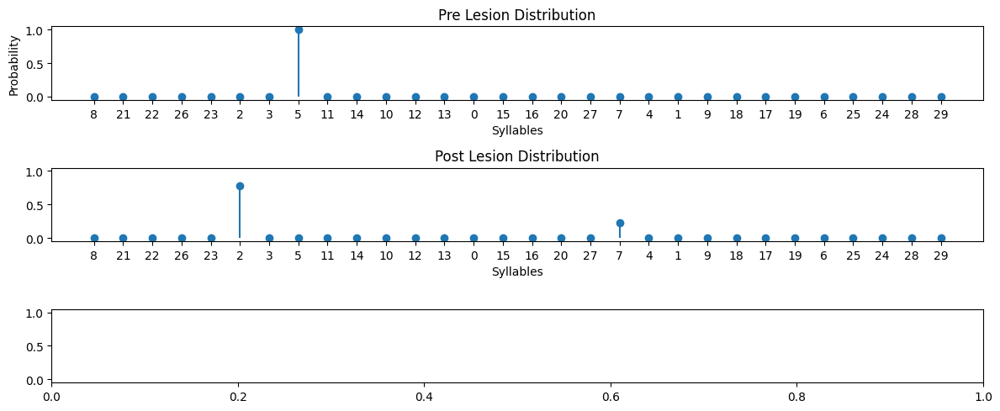

{"Earth Mover's Distance": 4.000024153438554,
 'Information Gain': -0.5296780425632384,
 'Kullback-Leibler Divergence': 20.72245741704719}
30 30


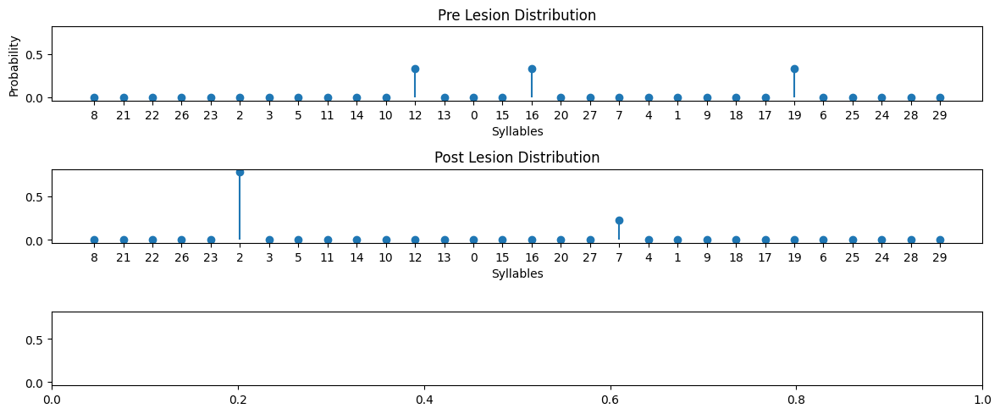

{"Earth Mover's Distance": 8.777775922159446,
 'Information Gain': 0.5689144178039991,
 'Kullback-Leibler Divergence': 19.62386643895034}
30 30


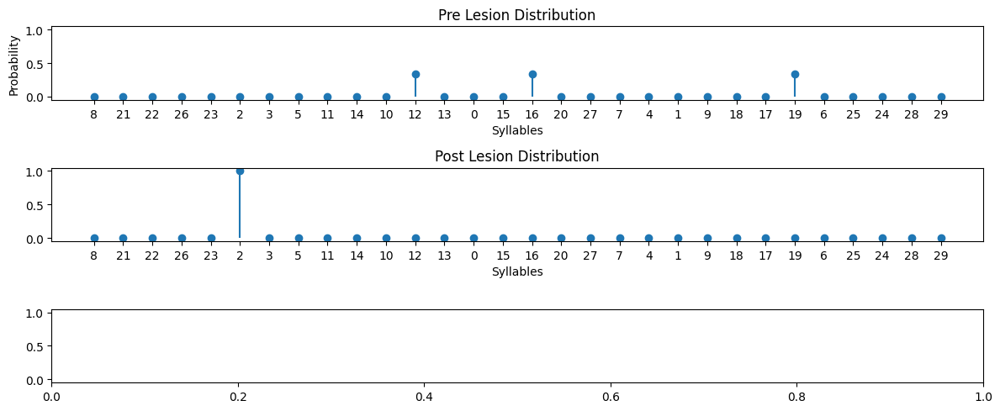

{"Earth Mover's Distance": 11.666670548331705,
 'Information Gain': 1.0986067721390134,
 'Kullback-Leibler Divergence': 16.328030769275284}
30 30


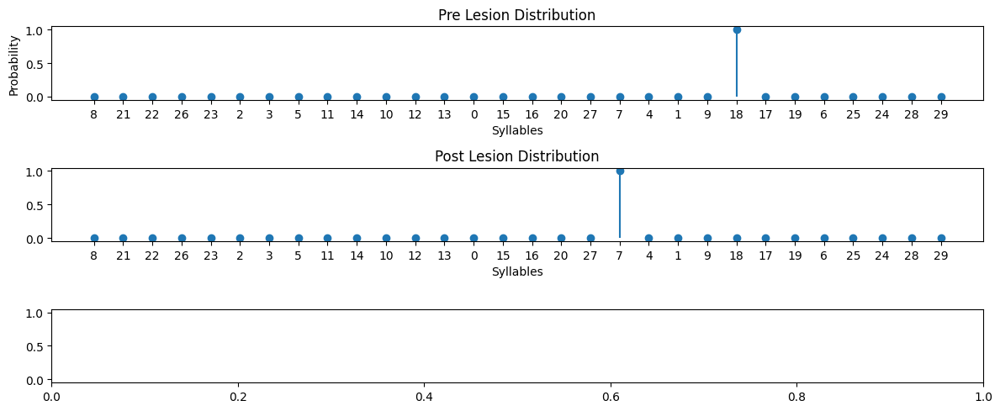

{"Earth Mover's Distance": 4.000008728698993,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}
30 30


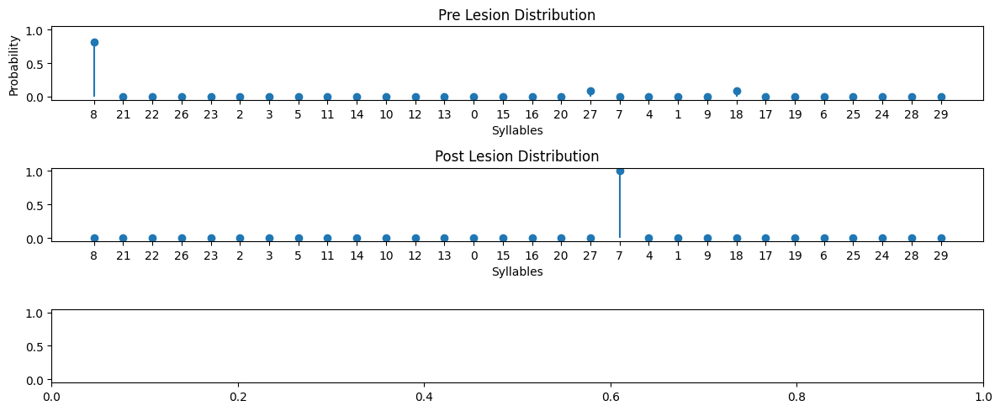

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}
30 30


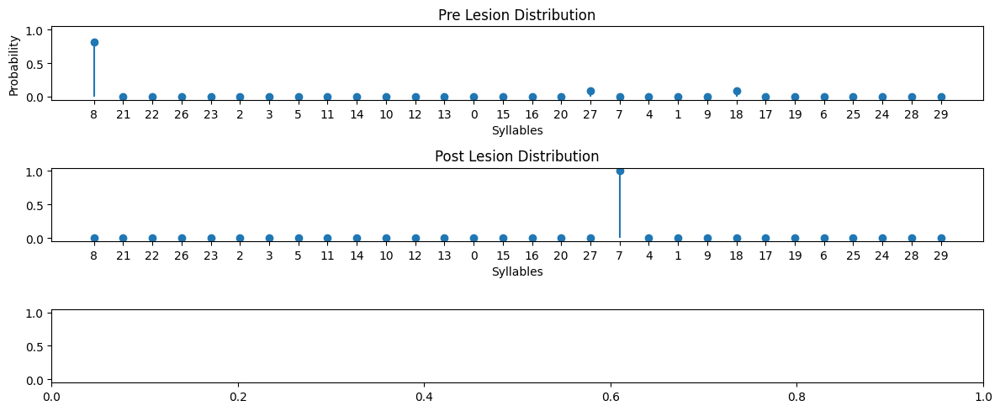

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}
30 30


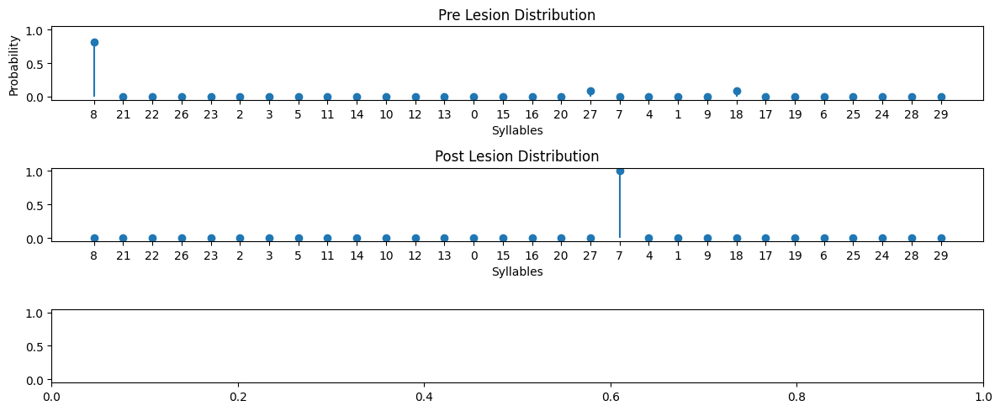

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}
30 30


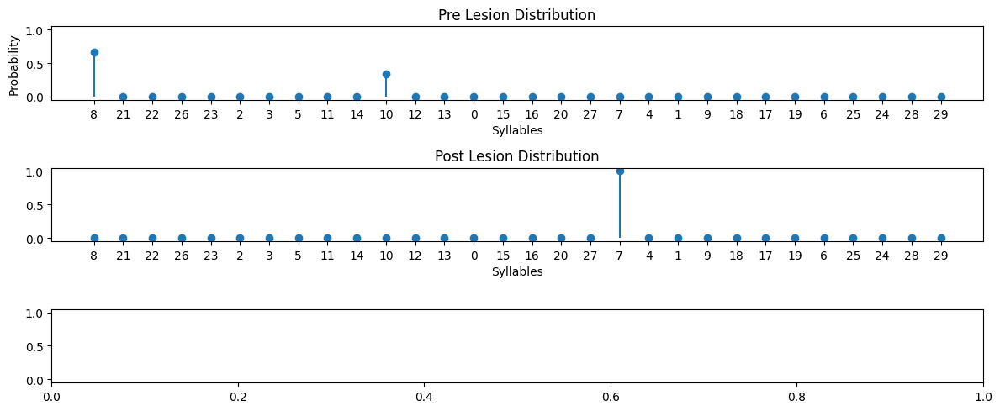

{"Earth Mover's Distance": 14.666667693429678,
 'Information Gain': 0.6365092281617749,
 'Kullback-Leibler Divergence': 16.790128313252524}
30 30


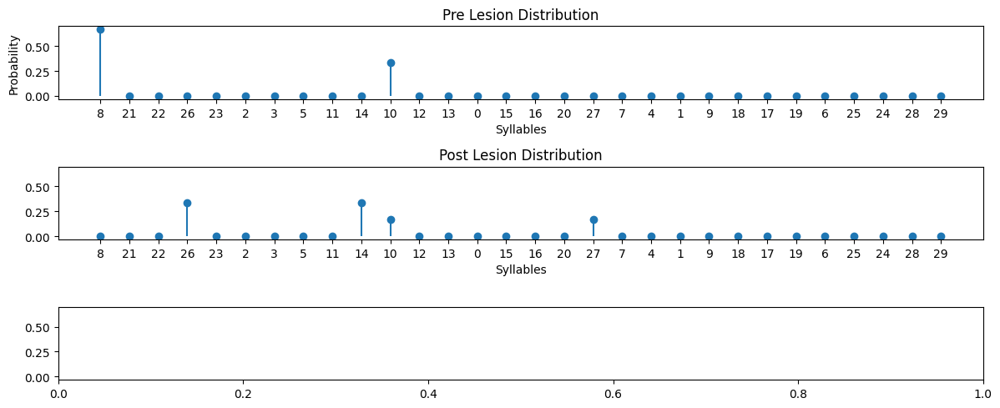

{"Earth Mover's Distance": 5.166673255639159,
 'Information Gain': -0.6931398951977573,
 'Kullback-Leibler Divergence': 12.773005518131047}
30 30


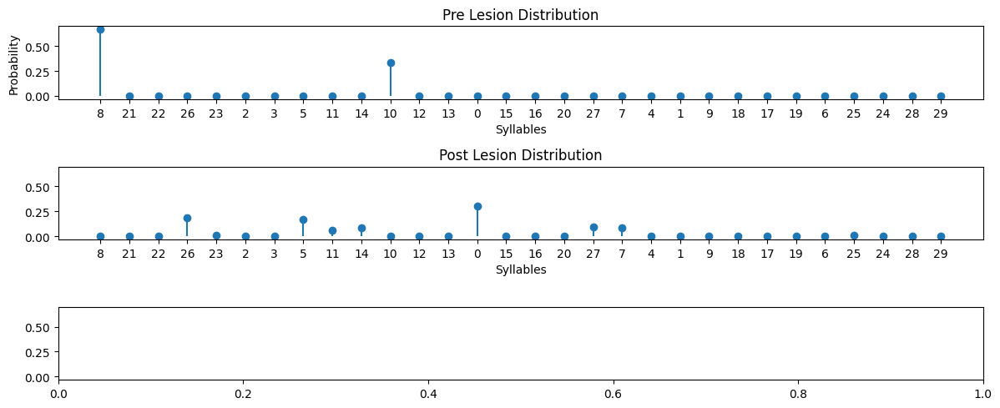

{"Earth Mover's Distance": 6.993881185925618,
 'Information Gain': -1.2349888758908718,
 'Kullback-Leibler Divergence': 22.395926477914944}
30 30


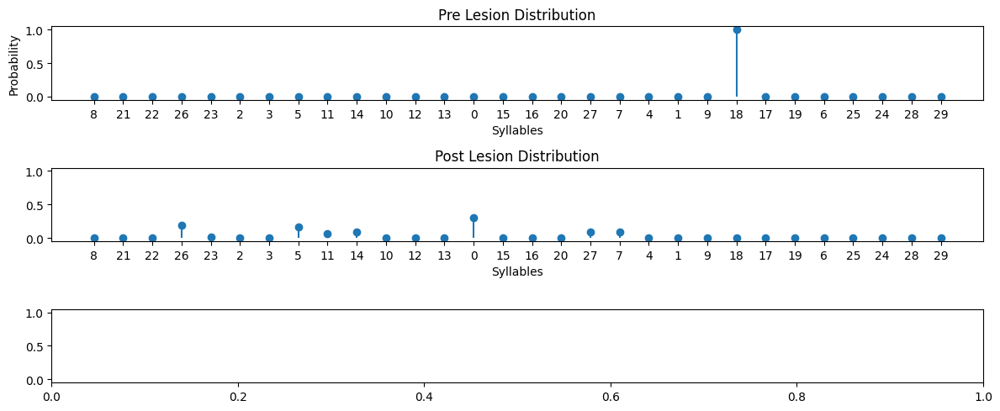

{"Earth Mover's Distance": 11.731616837649748,
 'Information Gain': -1.8714976047582685,
 'Kullback-Leibler Divergence': 23.032433497084927}
30 30


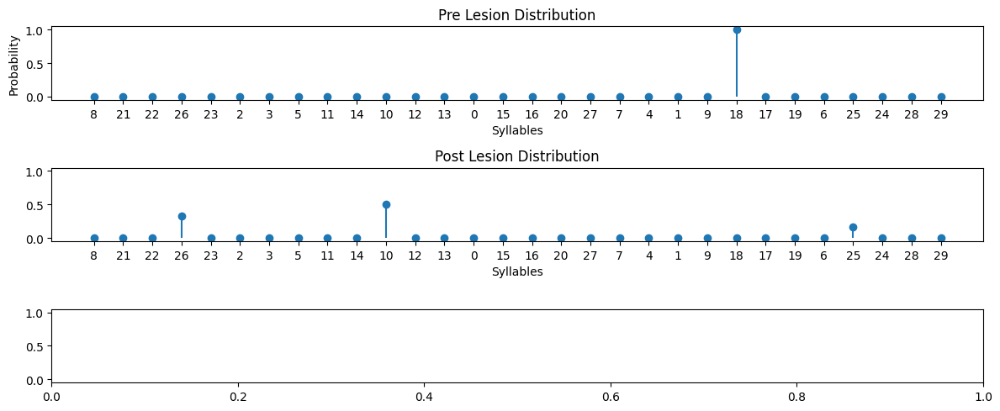

{"Earth Mover's Distance": 12.999999318311502,
 'Information Gain': -1.0113916640742673,
 'Kullback-Leibler Divergence': 19.218394646689347}
30 30


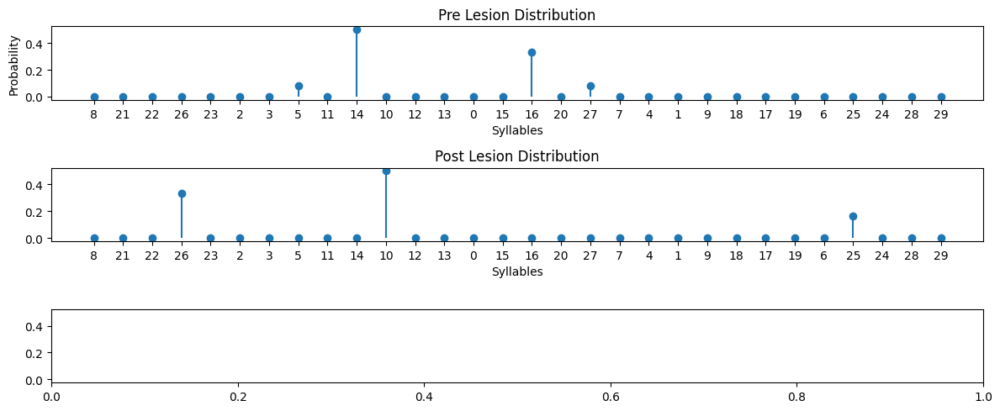

{"Earth Mover's Distance": 5.000000042362162,
 'Information Gain': 0.11552451557220778,
 'Kullback-Leibler Divergence': 18.091479729165563}
30 30


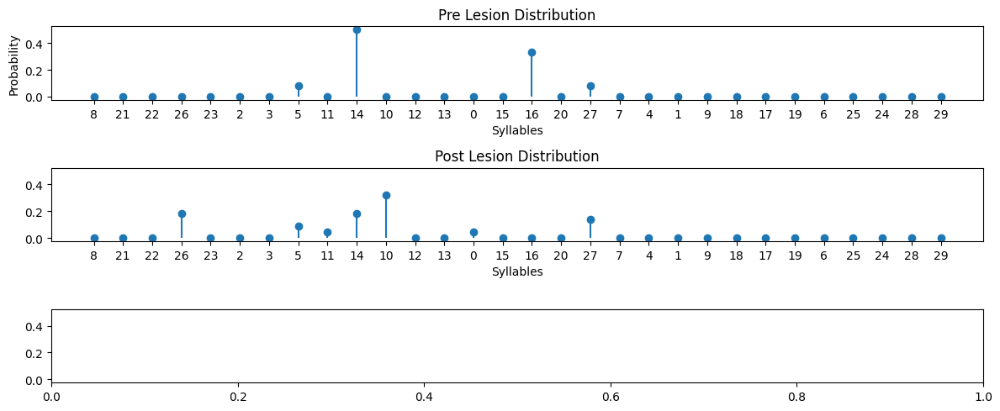

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}
30 30


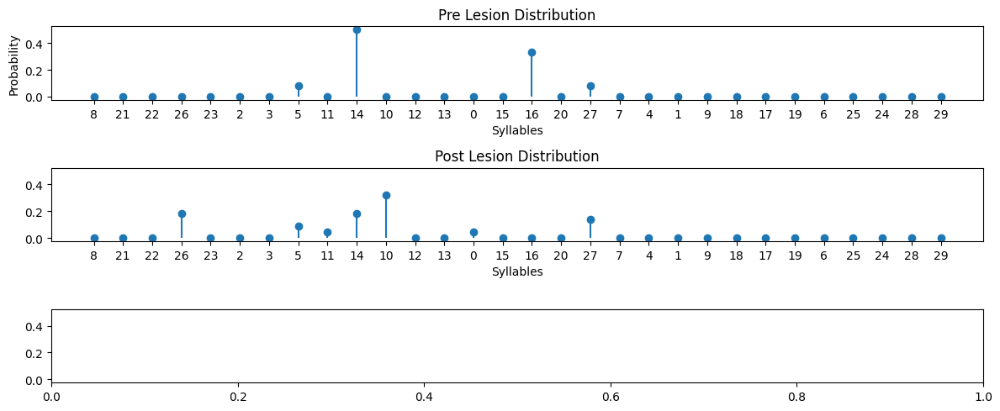

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}
30 30


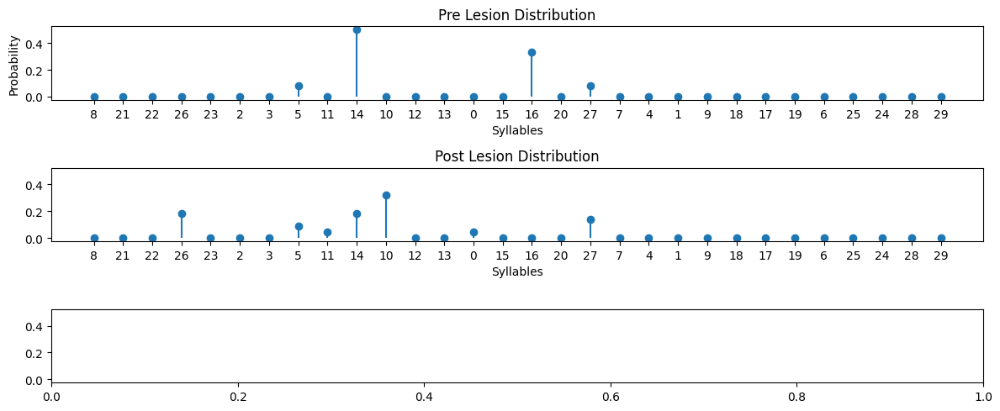

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}
30 30


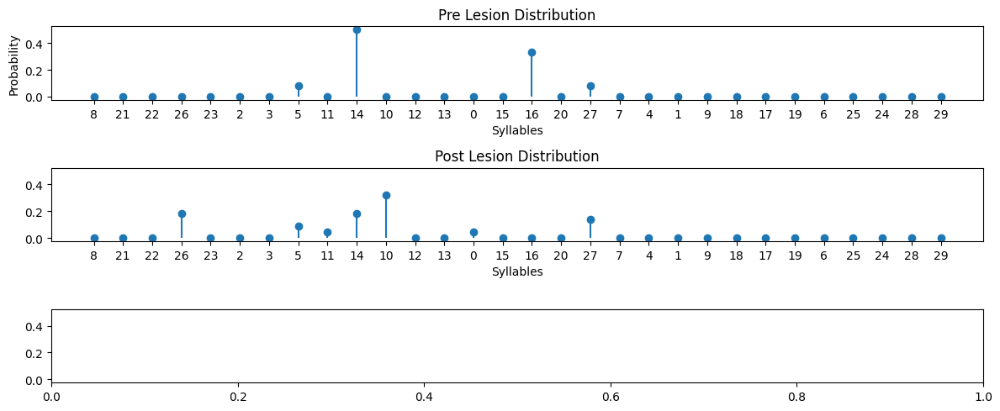

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}
30 30


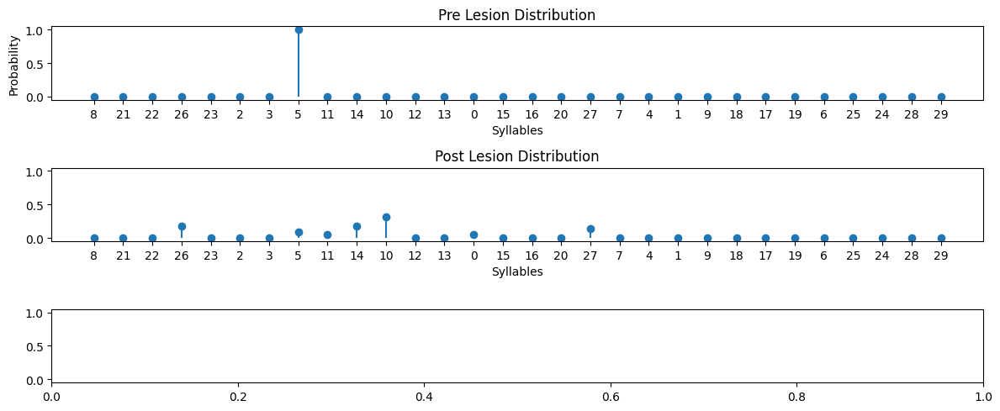

{"Earth Mover's Distance": 3.727275579391871,
 'Information Gain': -1.7549540398808456,
 'Kullback-Leibler Divergence': 2.3978940591860907}
30 30


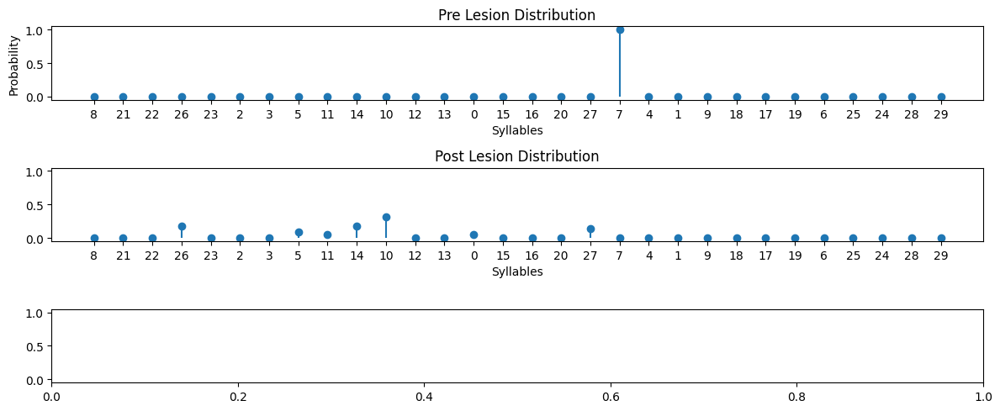

{"Earth Mover's Distance": 8.72728012416204,
 'Information Gain': -1.754929847741423,
 'Kullback-Leibler Divergence': 20.517658036251785}
30 30


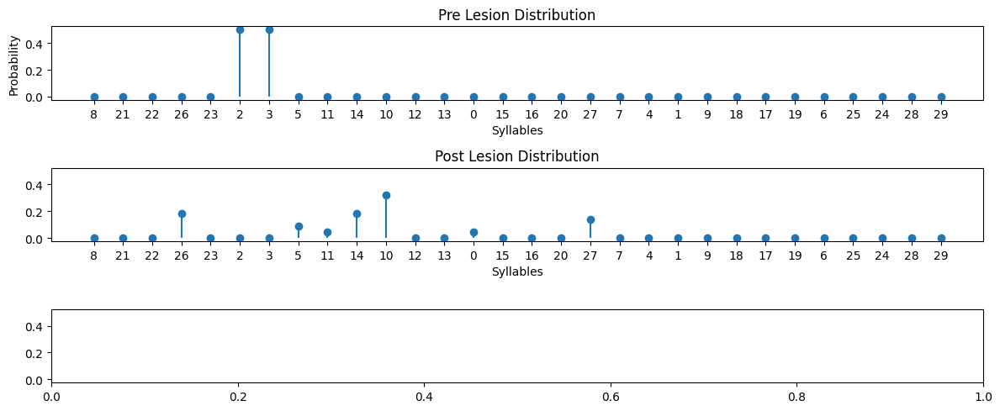

{"Earth Mover's Distance": 4.500011971452434,
 'Information Gain': -1.0617975384030844,
 'Kullback-Leibler Divergence': 19.82452932610026}
30 30


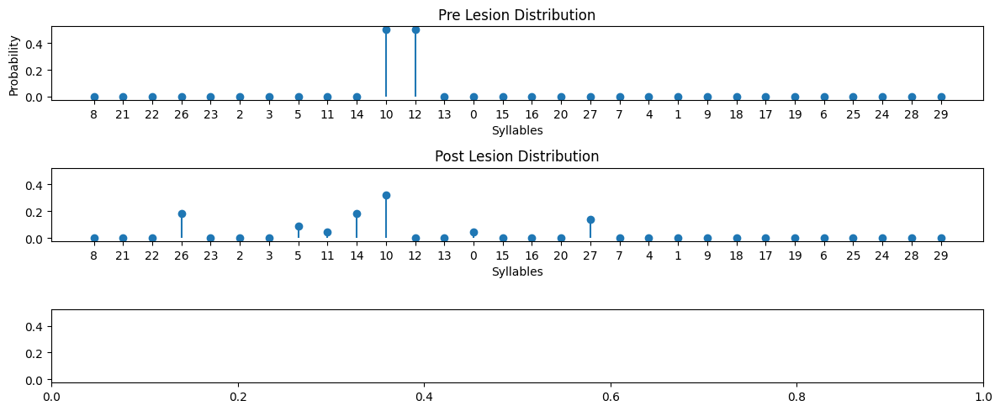

{"Earth Mover's Distance": 3.0454637851661475,
 'Information Gain': -1.0617975384030844,
 'Kullback-Leibler Divergence': 10.138256641279119}
30 30


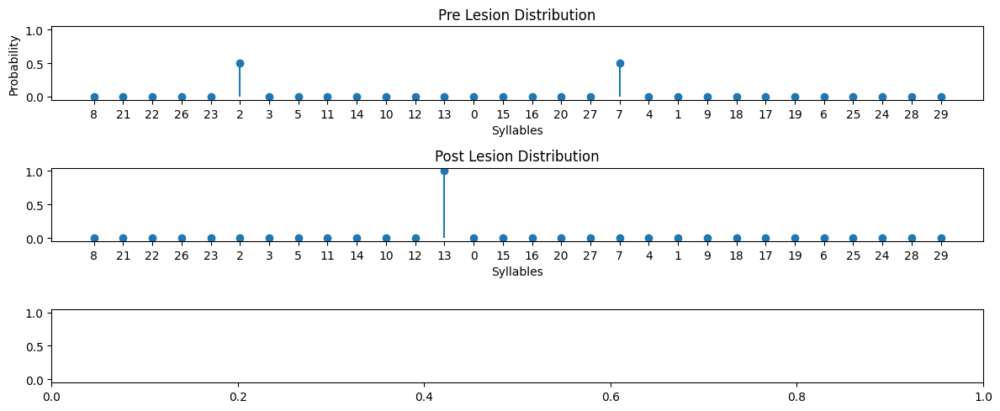

{"Earth Mover's Distance": 6.500000275930991,
 'Information Gain': 0.6931466211101145,
 'Kullback-Leibler Divergence': 16.733490757597572}
30 30


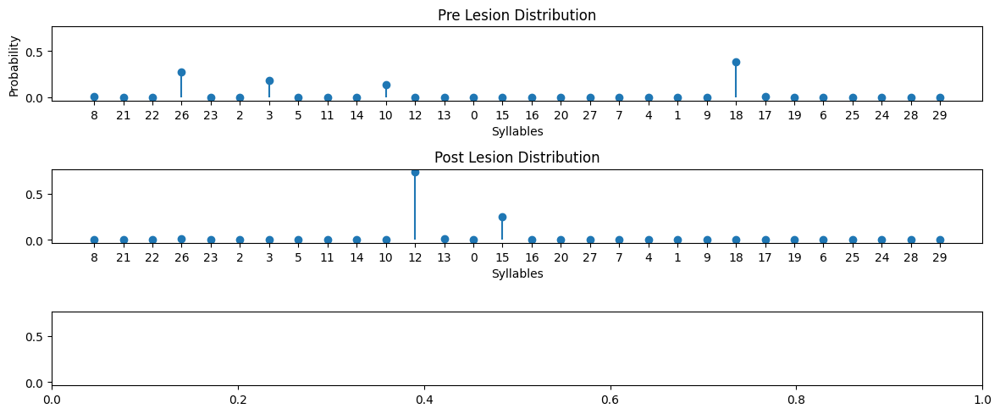

{"Earth Mover's Distance": 6.855075997322193,
 'Information Gain': 0.7383714154490462,
 'Kullback-Leibler Divergence': 16.040359735673178}
30 30


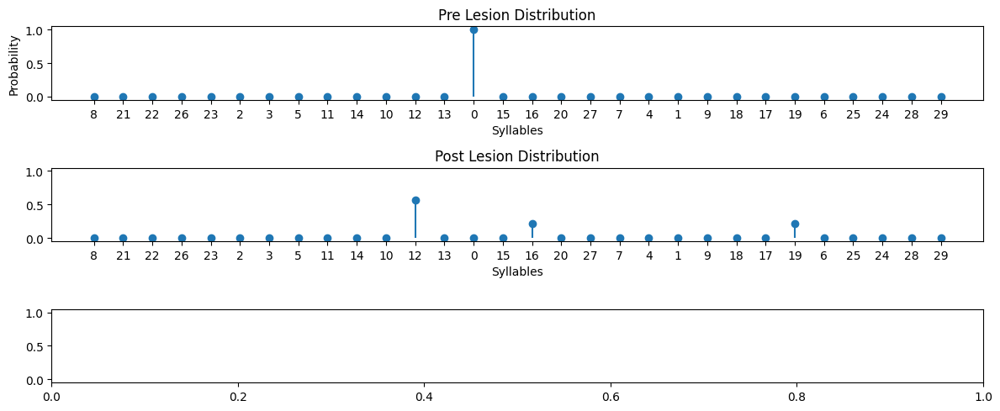

{"Earth Mover's Distance": 3.9285938758917833,
 'Information Gain': -0.9799434790916132,
 'Kullback-Leibler Divergence': 20.065676963647196}
30 30


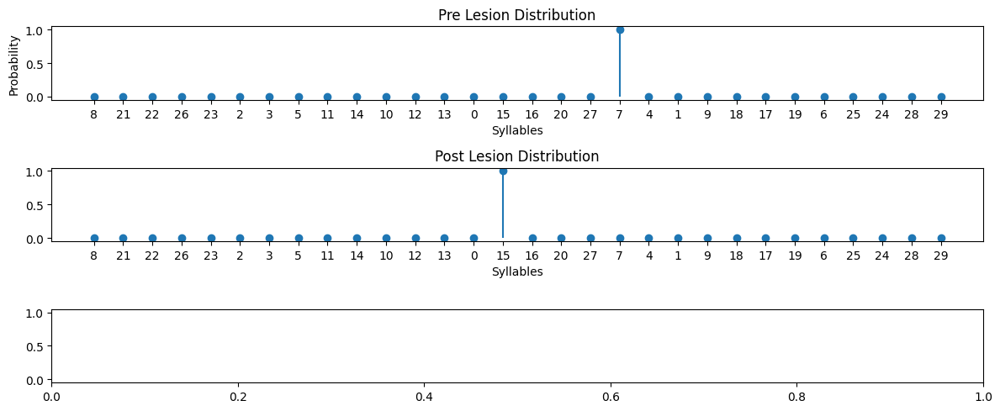

{"Earth Mover's Distance": 4.000014155663489,
 'Information Gain': 2.1259830145027644e-05,
 'Kullback-Leibler Divergence': 18.119769315231785}
30 30


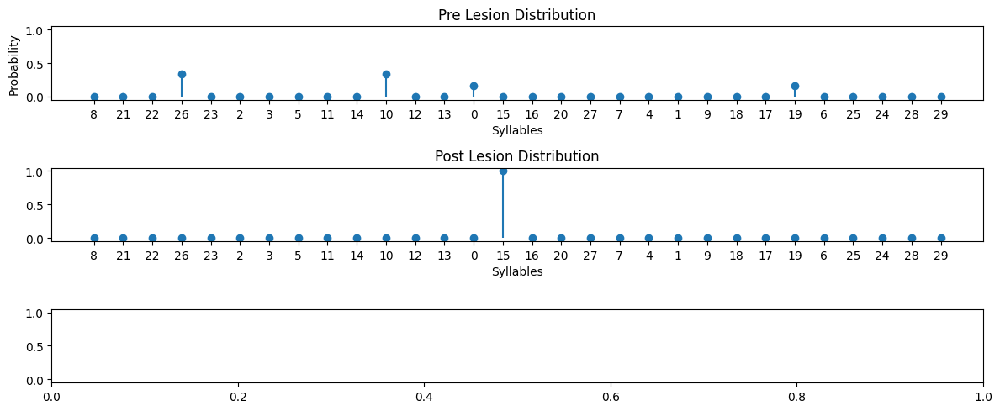

{"Earth Mover's Distance": 6.833334447746839,
 'Information Gain': 1.3296582702646391,
 'Kullback-Leibler Divergence': 16.790133150688238}
30 30


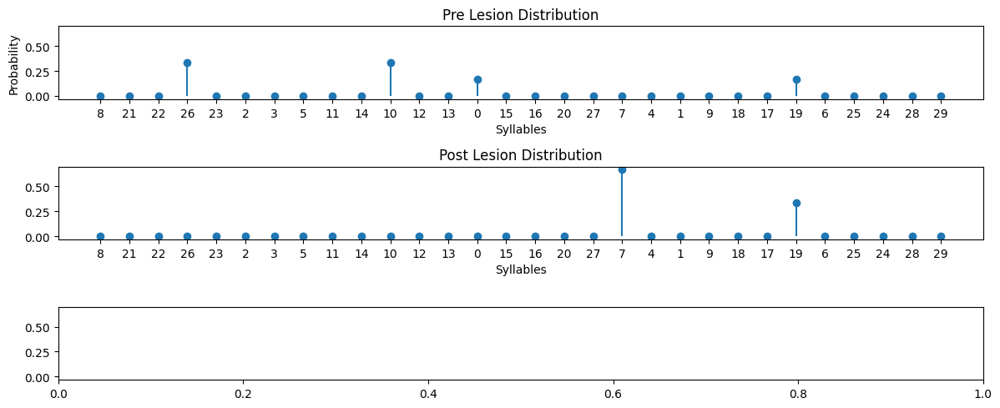

{"Earth Mover's Distance": 9.500000153295,
 'Information Gain': 0.6931468274431276,
 'Kullback-Leibler Divergence': 14.291156854102322}
30 30


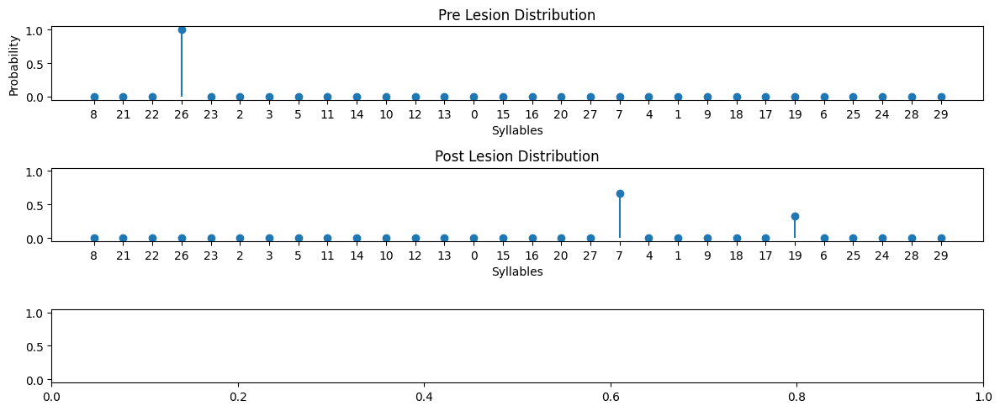

{"Earth Mover's Distance": 17.00002186104499,
 'Information Gain': -0.6364901829913665,
 'Kullback-Leibler Divergence': 18.525233311995628}
30 30


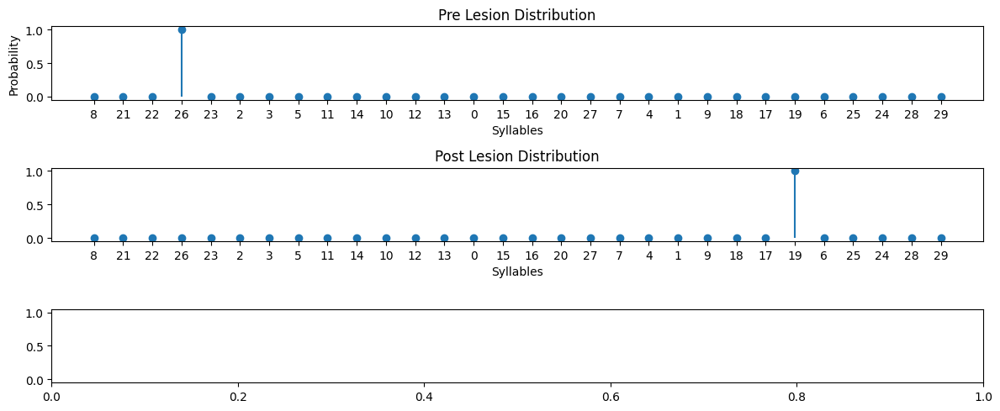

{"Earth Mover's Distance": 21.000013484534982,
 'Information Gain': 1.4311771776054103e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


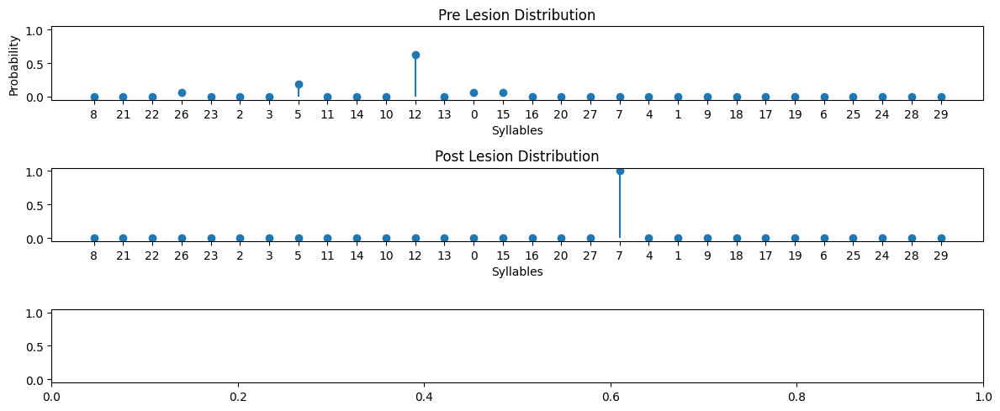

{"Earth Mover's Distance": 7.937503411500639,
 'Information Gain': 1.1274696810399392,
 'Kullback-Leibler Divergence': 16.299168155280327}
30 30


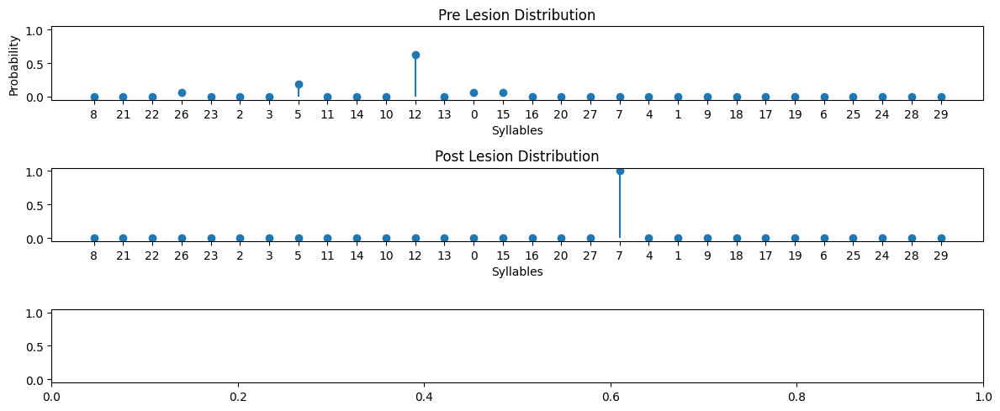

{"Earth Mover's Distance": 7.937503411500639,
 'Information Gain': 1.1274696810399392,
 'Kullback-Leibler Divergence': 16.299168155280327}
30 30


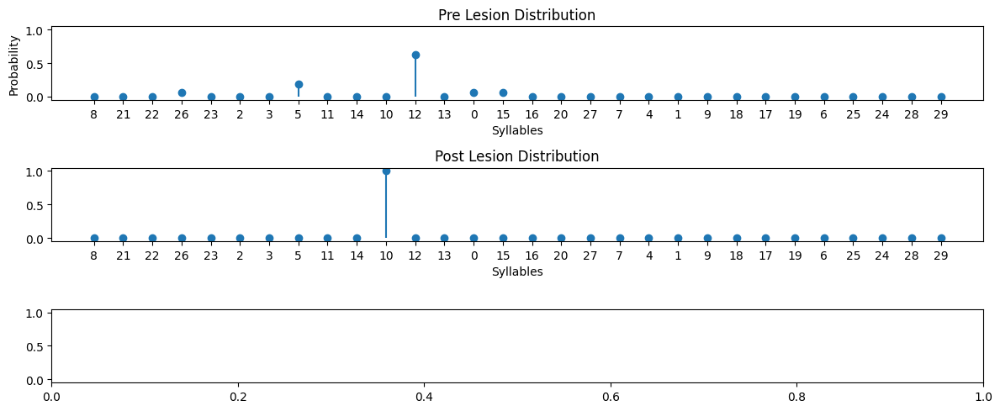

{"Earth Mover's Distance": 2.06250927422765,
 'Information Gain': 1.127469681039939,
 'Kullback-Leibler Divergence': 16.299168155280327}
30 30


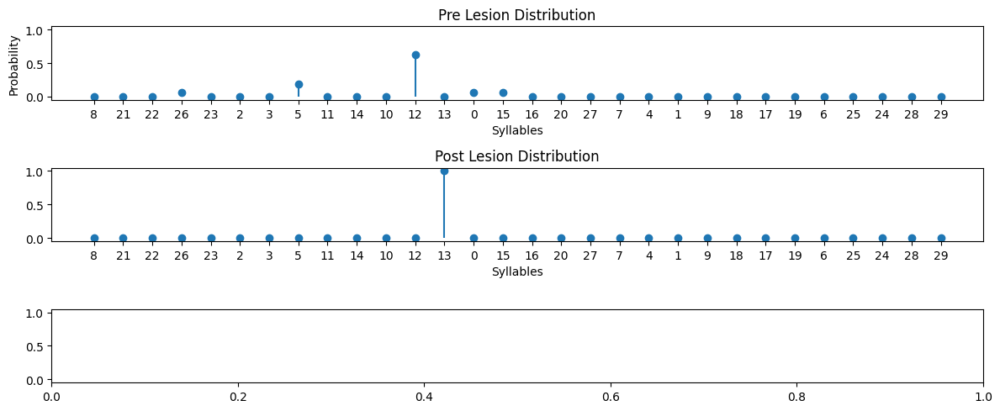

{"Earth Mover's Distance": 2.312508111790394,
 'Information Gain': 1.127469681039939,
 'Kullback-Leibler Divergence': 16.299168155280327}
30 30


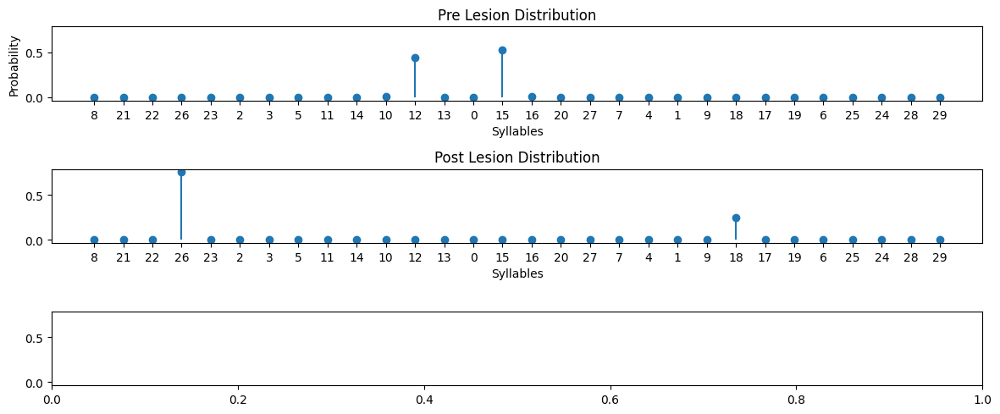

{"Earth Mover's Distance": 8.815164037041535,
 'Information Gain': 0.2702358799955942,
 'Kullback-Leibler Divergence': 17.91072753851081}
30 30


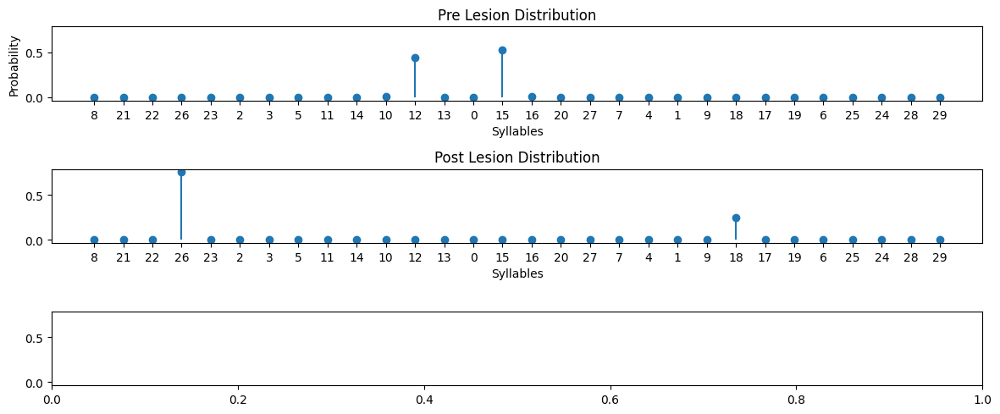

{"Earth Mover's Distance": 8.815164037041535,
 'Information Gain': 0.2702358799955942,
 'Kullback-Leibler Divergence': 17.91072753851081}
30 30


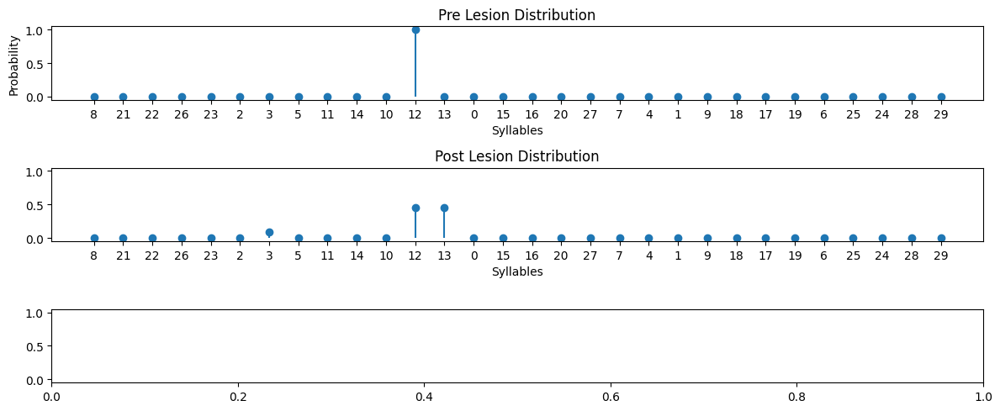

{"Earth Mover's Distance": 0.9091109954204404,
 'Information Gain': -0.9347424688580996,
 'Kullback-Leibler Divergence': 0.7884575605622037}
30 30


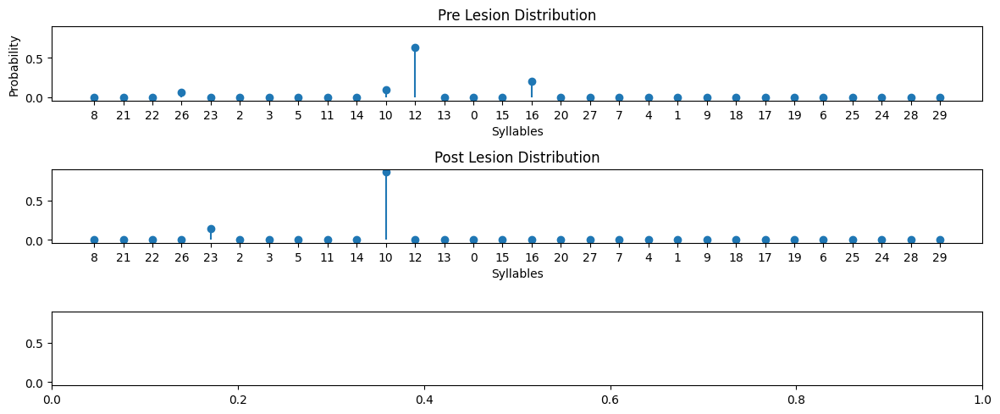

{"Earth Mover's Distance": 2.1679550860775967,
 'Information Gain': 0.6068355290052884,
 'Kullback-Leibler Divergence': 16.53764996964299}
30 30


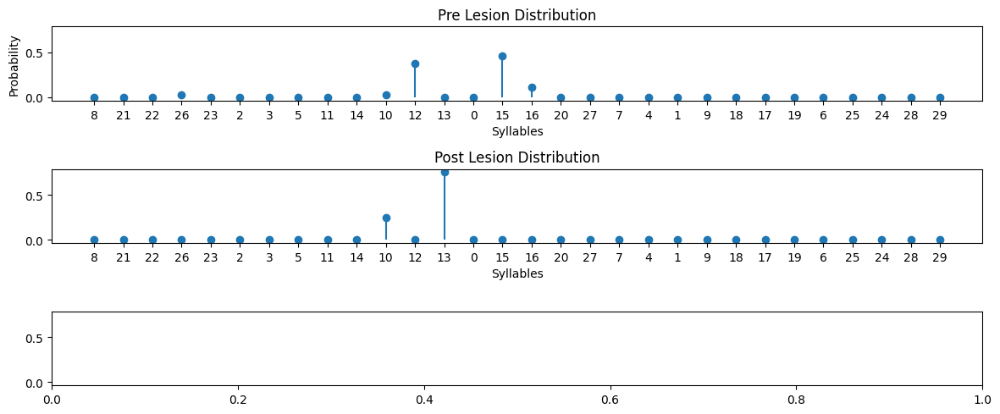

{"Earth Mover's Distance": 1.8285731966261602,
 'Information Gain': 0.6144118365057711,
 'Kullback-Leibler Divergence': 17.138291070374343}
30 30


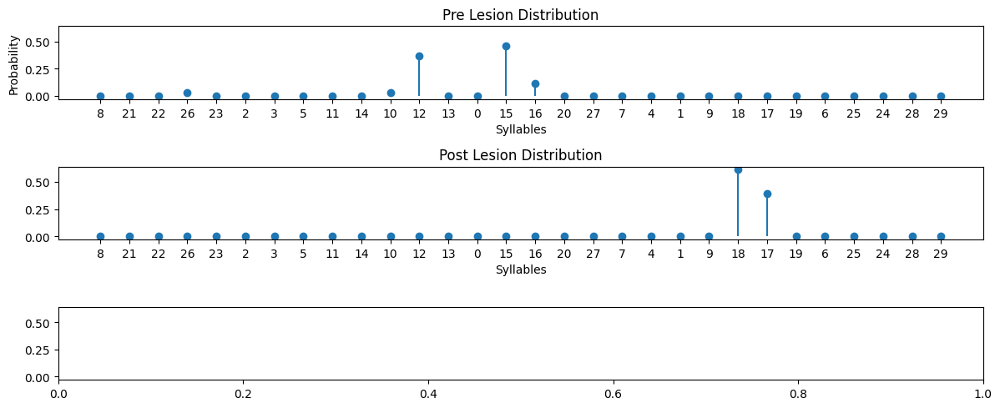

{"Earth Mover's Distance": 9.817460363683537,
 'Information Gain': 0.5085012802914783,
 'Kullback-Leibler Divergence': 19.14027260964027}
30 30


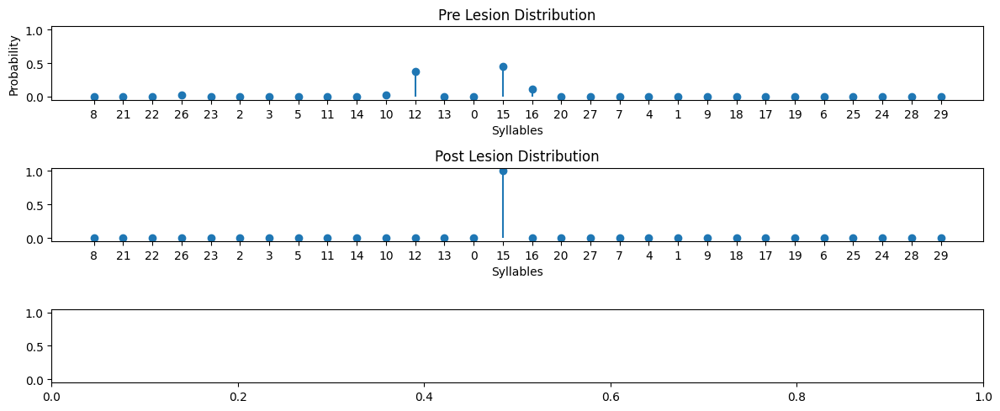

{"Earth Mover's Distance": 1.6571460370937885,
 'Information Gain': 1.176743134809619,
 'Kullback-Leibler Divergence': 8.659712280268858}
30 30


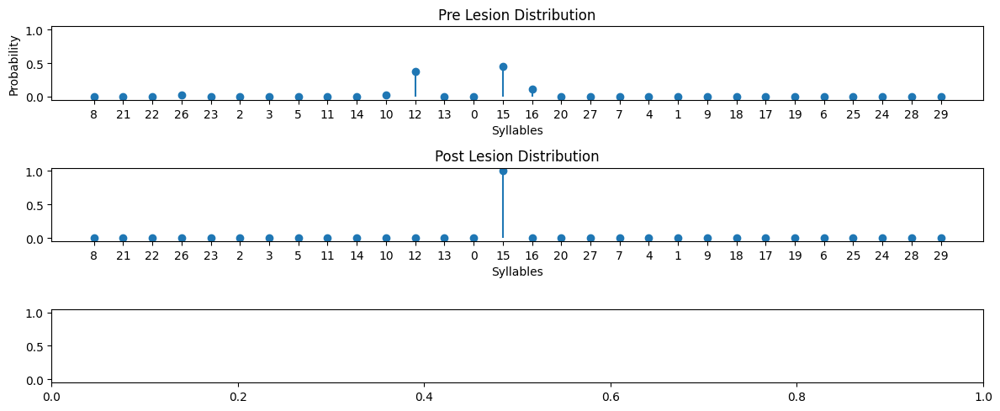

{"Earth Mover's Distance": 1.6571460370937885,
 'Information Gain': 1.176743134809619,
 'Kullback-Leibler Divergence': 8.659712280268858}
30 30


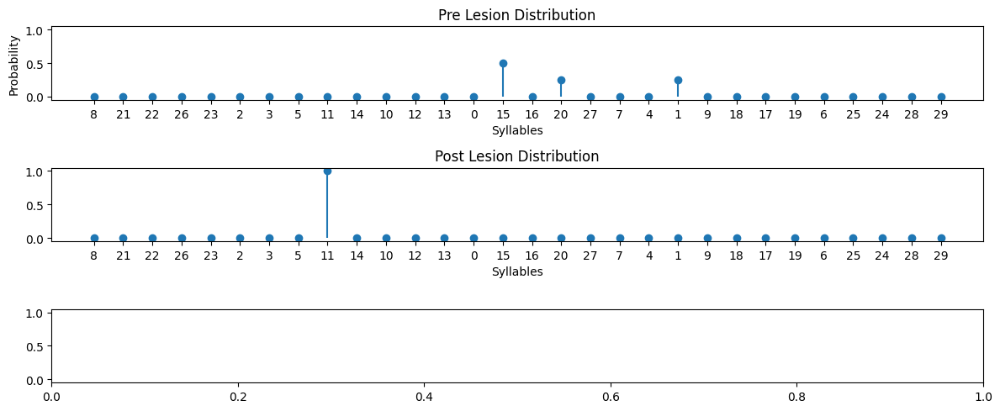

{"Earth Mover's Distance": 8.000000584766,
 'Information Gain': 1.0397224987521105,
 'Kullback-Leibler Divergence': 17.4855361961003}
30 30


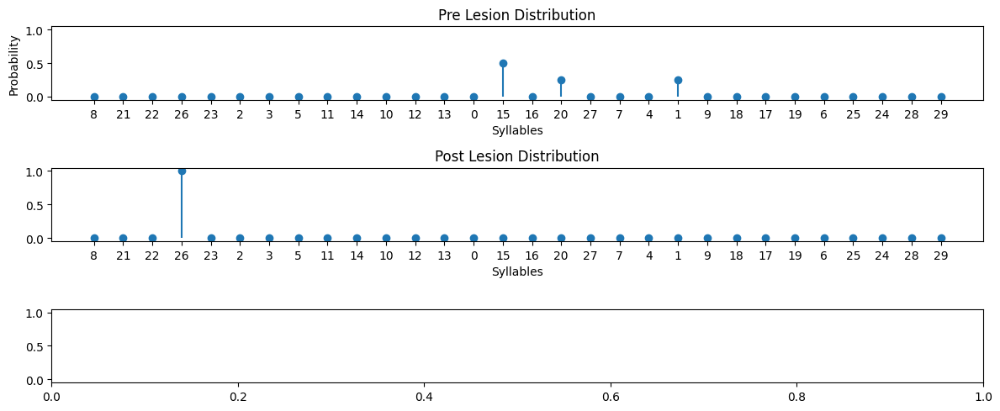

{"Earth Mover's Distance": 13.000006052440035,
 'Information Gain': 1.0397131595296698,
 'Kullback-Leibler Divergence': 16.386924463237968}
30 30


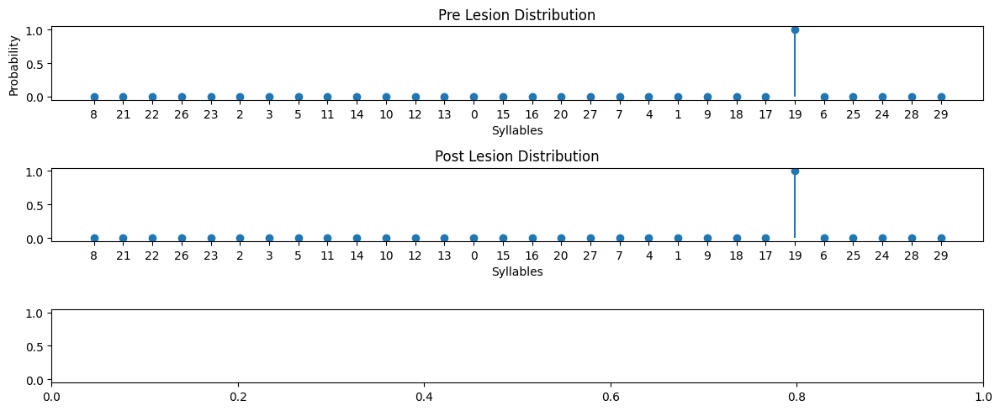

{"Earth Mover's Distance": 1.3484534996884865e-05,
 'Information Gain': 1.43117717760541e-05,
 'Kullback-Leibler Divergence': 3.435002717613748e-07}
30 30


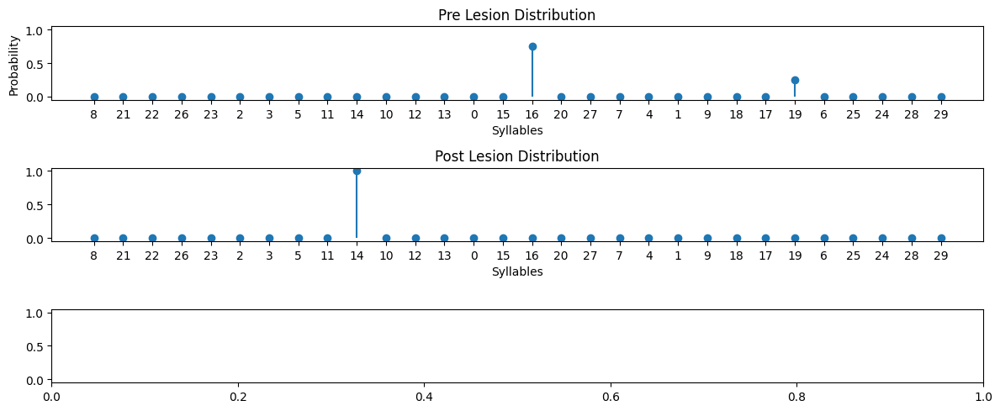

{"Earth Mover's Distance": 8.250006052440023,
 'Information Gain': 0.5623279760576936,
 'Kullback-Leibler Divergence': 16.86430964670994}
30 30


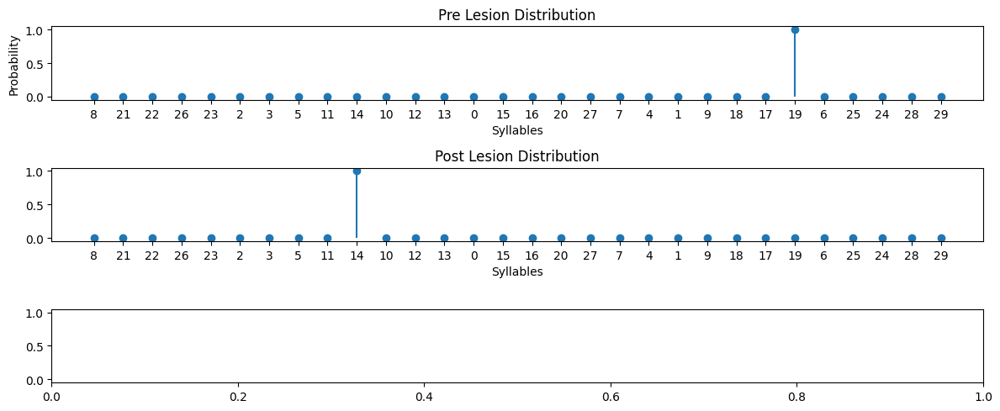

{"Earth Mover's Distance": 14.999998695045,
 'Information Gain': 1.4311771775832057e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}
30 30


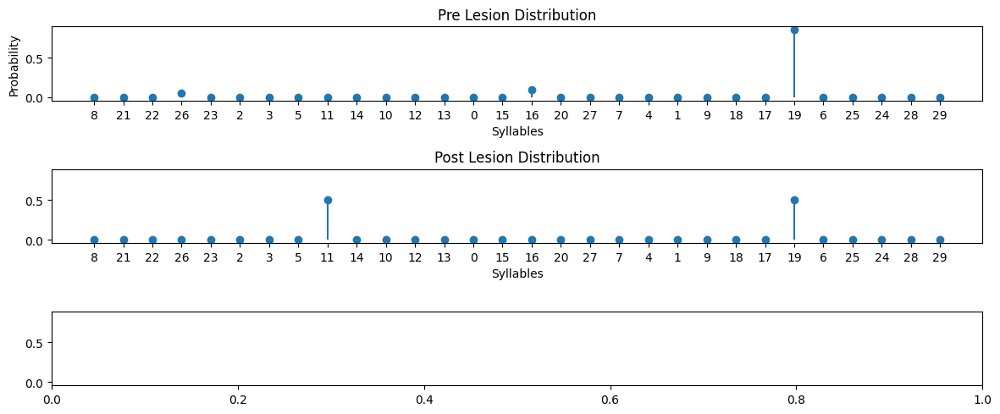

{"Earth Mover's Distance": 6.550004337347511,
 'Information Gain': -0.17496640147480746,
 'Kullback-Leibler Divergence': 2.7889586845375223}
30 30


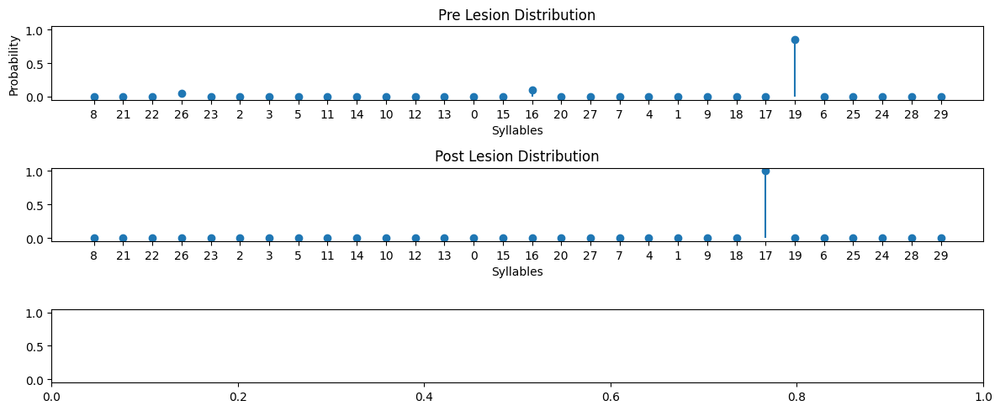

{"Earth Mover's Distance": 2.649998183500003,
 'Information Gain': 0.5181733104955201,
 'Kullback-Leibler Divergence': 16.908464507520225}
30 30


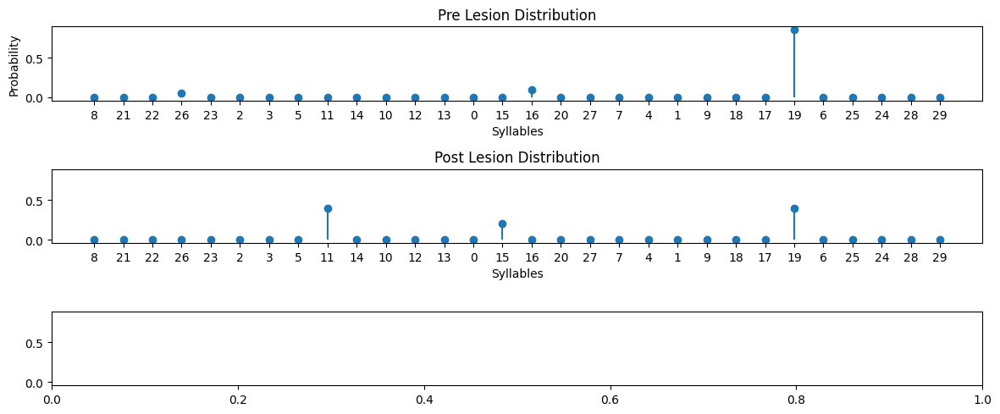

{"Earth Mover's Distance": 6.950001054295996,
 'Information Gain': -0.5367351893169149,
 'Kullback-Leibler Divergence': 3.1160740780440377}
30 30


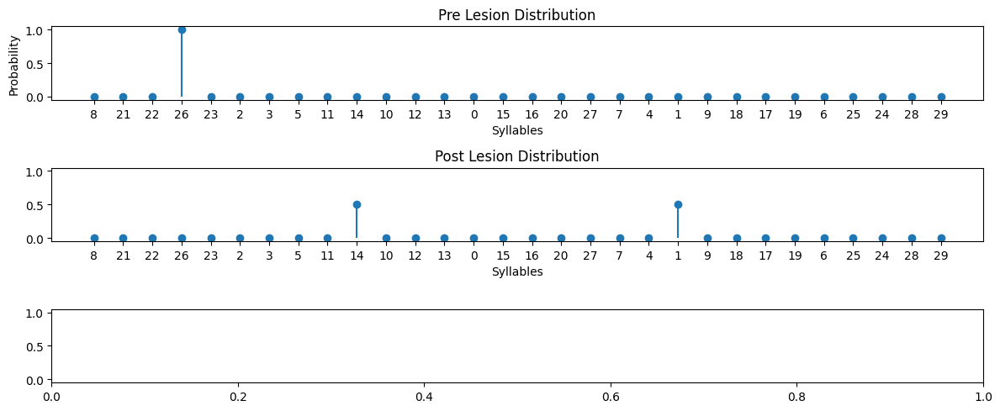

{"Earth Mover's Distance": 11.500019766917472,
 'Information Gain': -0.6931254001985515,
 'Kullback-Leibler Divergence': 18.119768377822442}
30 30


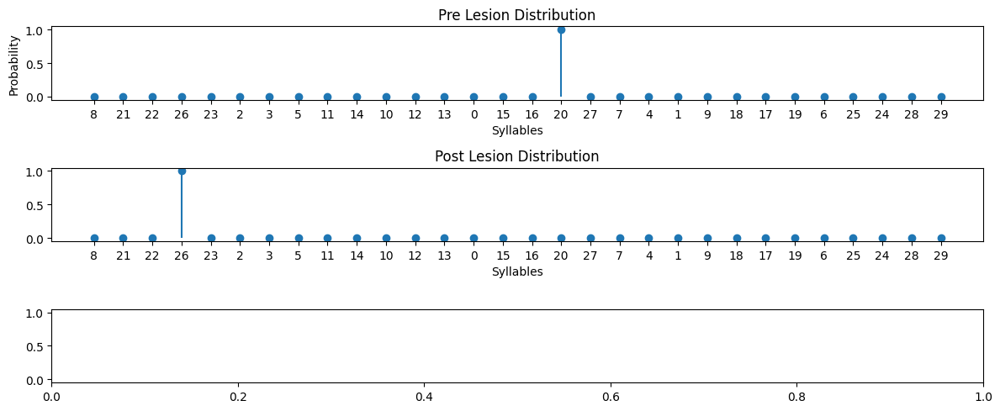

{"Earth Mover's Distance": 13.00000020274499,
 'Information Gain': 4.992943779704252e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}
30 30


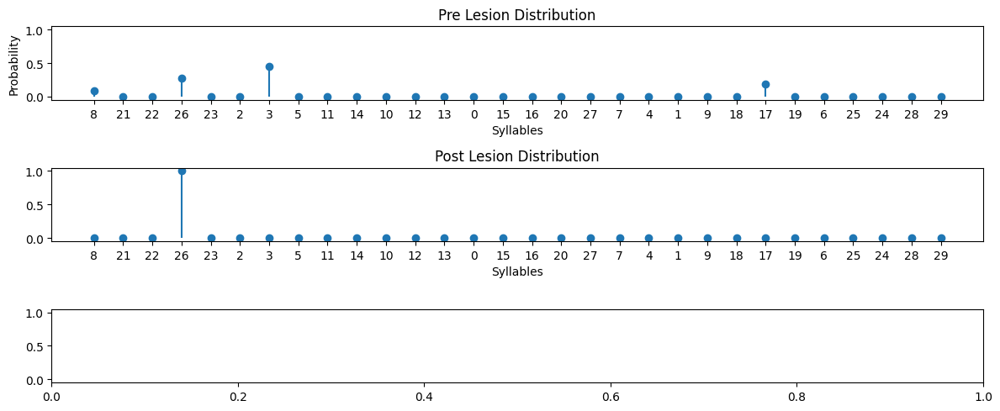

{"Earth Mover's Distance": 5.272737206234865,
 'Information Gain': 1.2406723555034957,
 'Kullback-Leibler Divergence': 11.433243006205318}
30 30


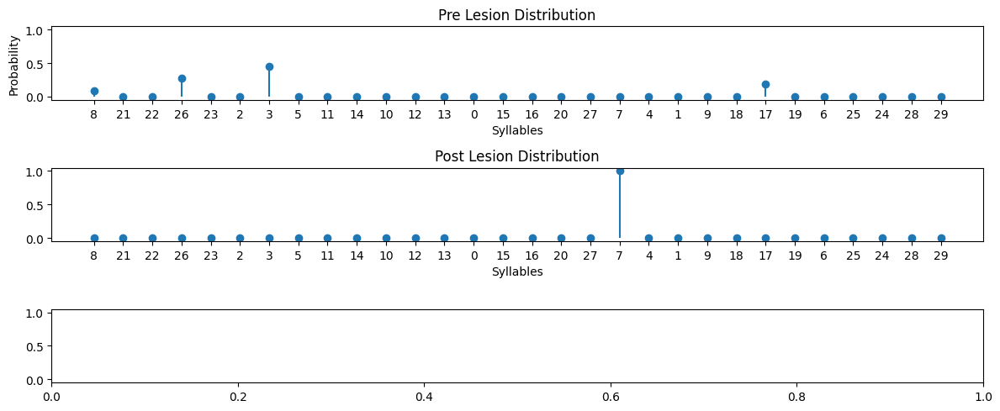

{"Earth Mover's Distance": 12.09091178808665,
 'Information Gain': 1.240672355503496,
 'Kullback-Leibler Divergence': 16.185965422575123}
30 30


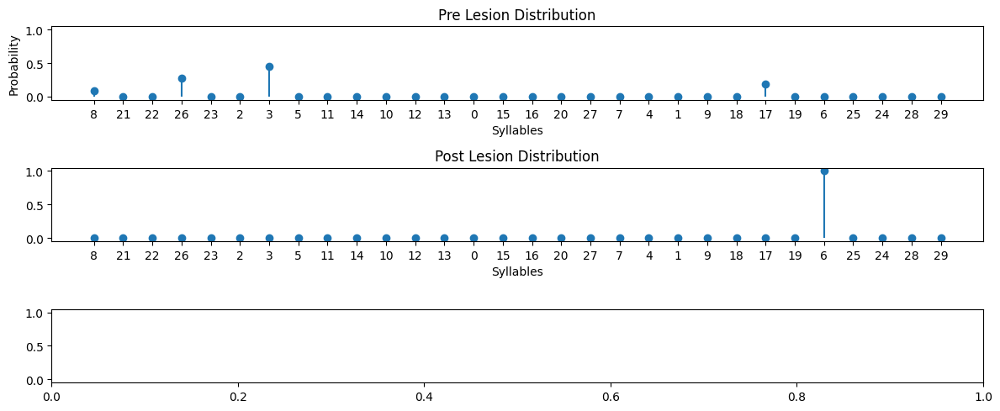

{"Earth Mover's Distance": 17.27272321599682,
 'Information Gain': 1.2406723555034962,
 'Kullback-Leibler Divergence': 16.185965422575123}
30 30


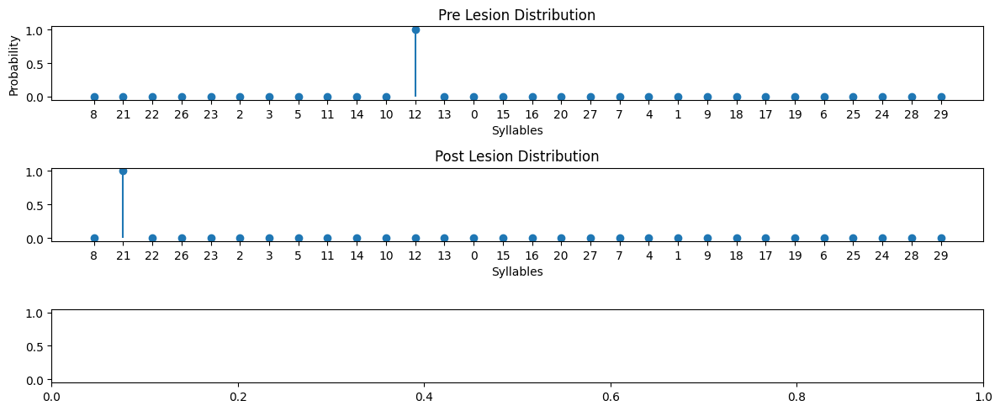

{"Earth Mover's Distance": 10.00000033131498,
 'Information Gain': 4.992943781924647e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}
30 30


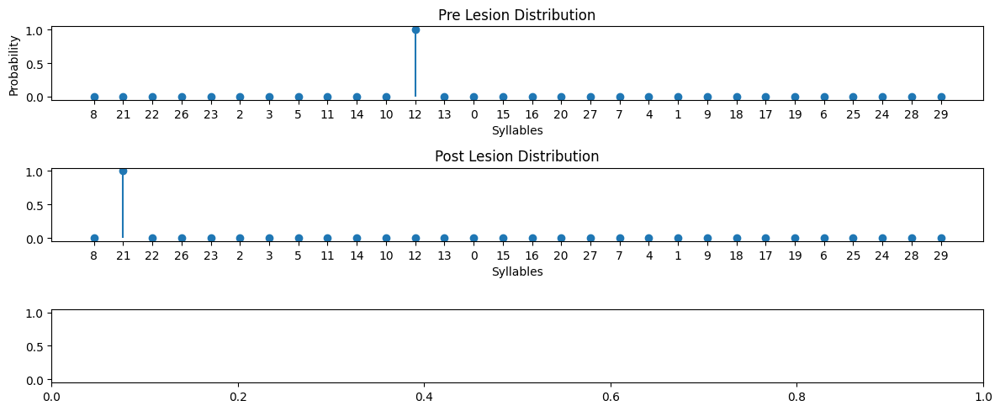

{"Earth Mover's Distance": 10.00000033131498,
 'Information Gain': 4.992943781924647e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}
30 30


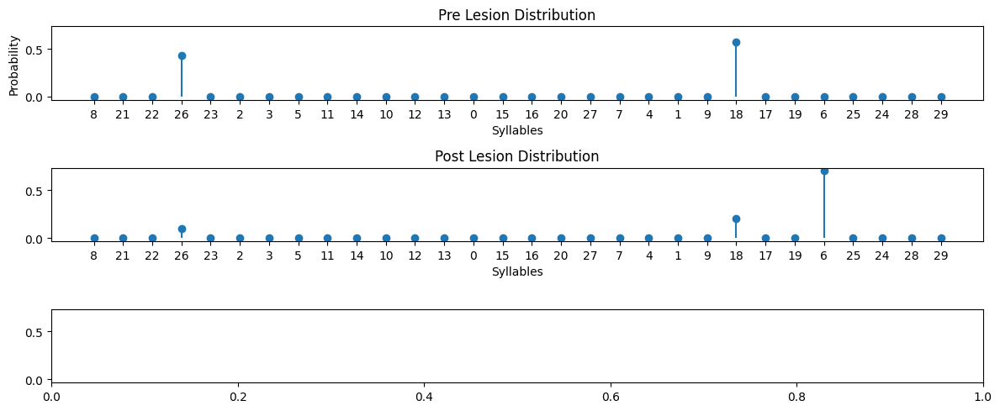

{"Earth Mover's Distance": 8.342859607709215,
 'Information Gain': -0.11890765770608624,
 'Kullback-Leibler Divergence': 1.2235925373430387}
30 30


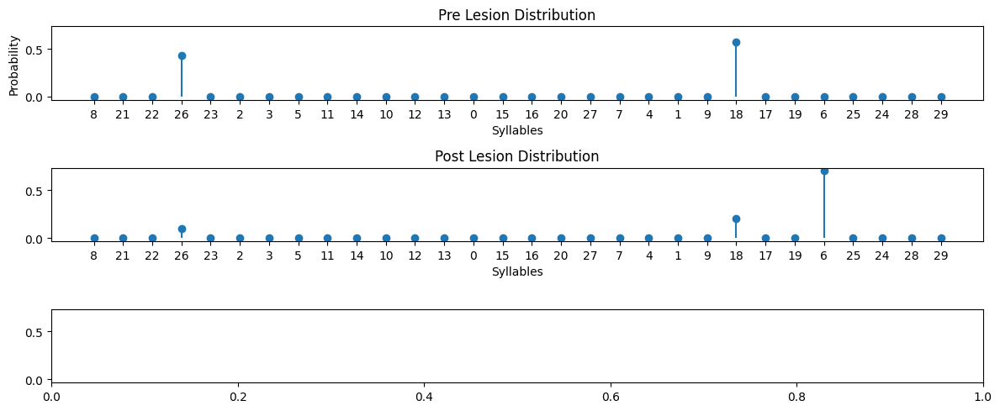

{"Earth Mover's Distance": 8.342859607709215,
 'Information Gain': -0.11890765770608624,
 'Kullback-Leibler Divergence': 1.2235925373430387}
30 30


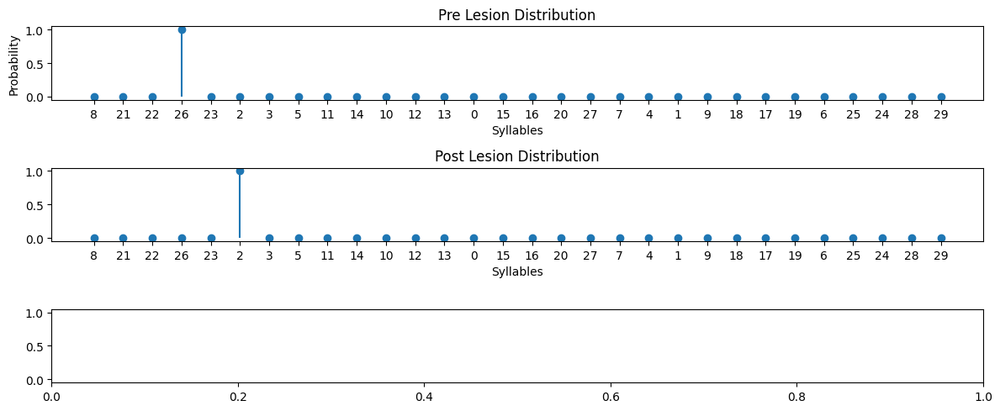

{"Earth Mover's Distance": 2.000013484534951,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


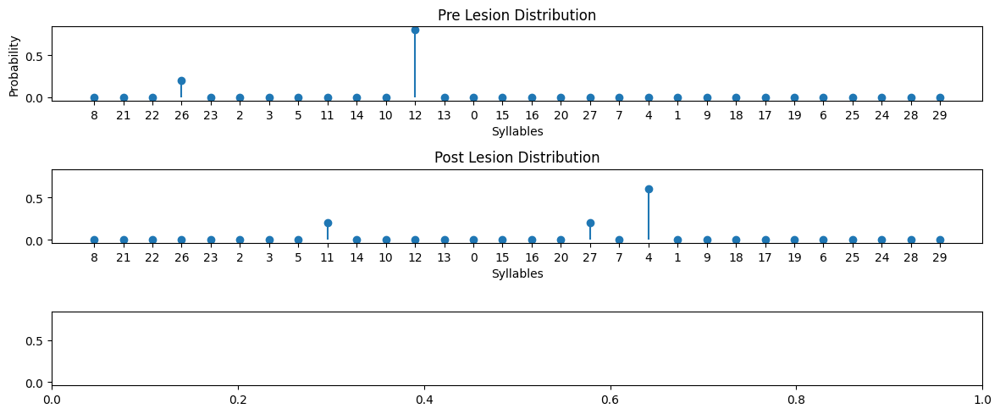

{"Earth Mover's Distance": 7.000002696906989,
 'Information Gain': -0.44986499614996767,
 'Kullback-Leibler Divergence': 18.53568063927428}
30 30


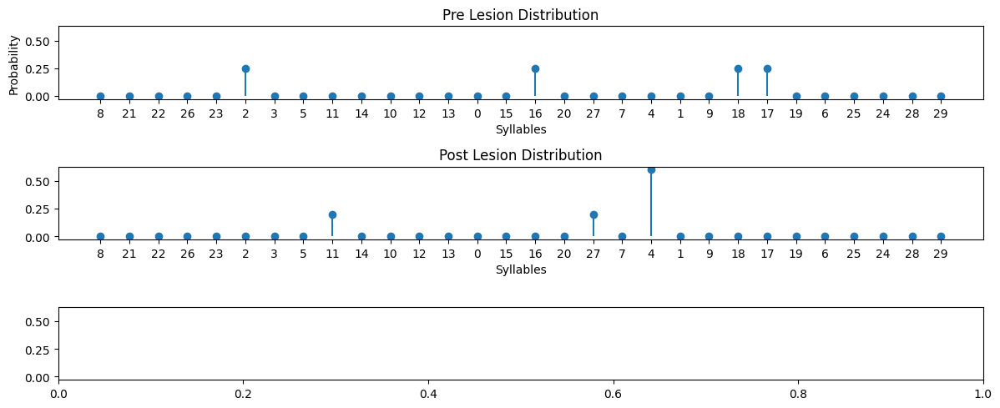

{"Earth Mover's Distance": 3.6500025200344,
 'Information Gain': 0.43602747646951046,
 'Kullback-Leibler Divergence': 17.649788017141546}
30 30


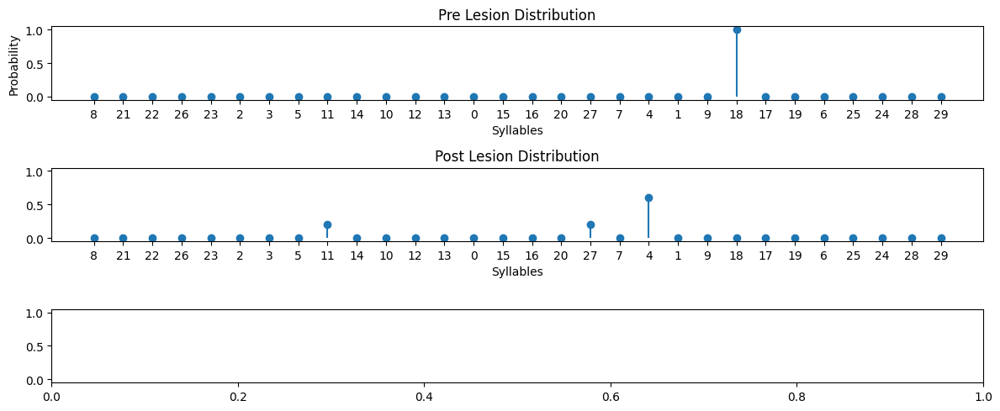

{"Earth Mover's Distance": 5.600001569089799,
 'Information Gain': -0.9502445778088626,
 'Kullback-Leibler Divergence': 19.03605782872415}
30 30


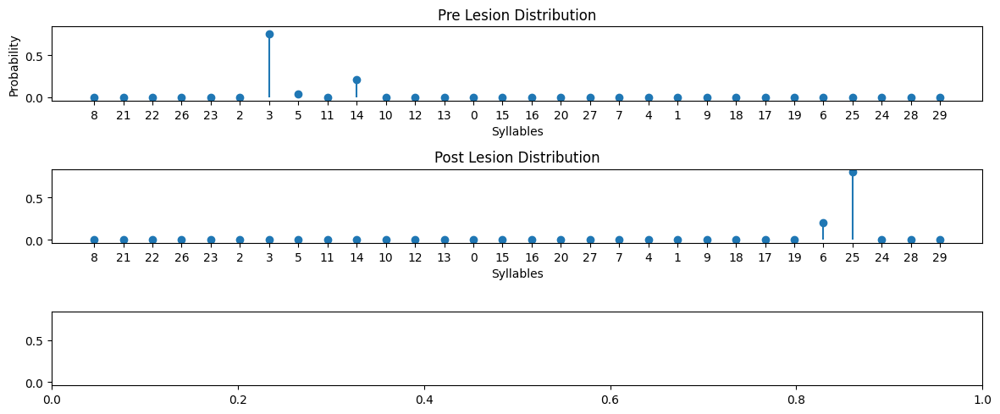

{"Earth Mover's Distance": 19.133332507095584,
 'Information Gain': 0.17457072461074352,
 'Kullback-Leibler Divergence': 18.361113419005328}
30 30


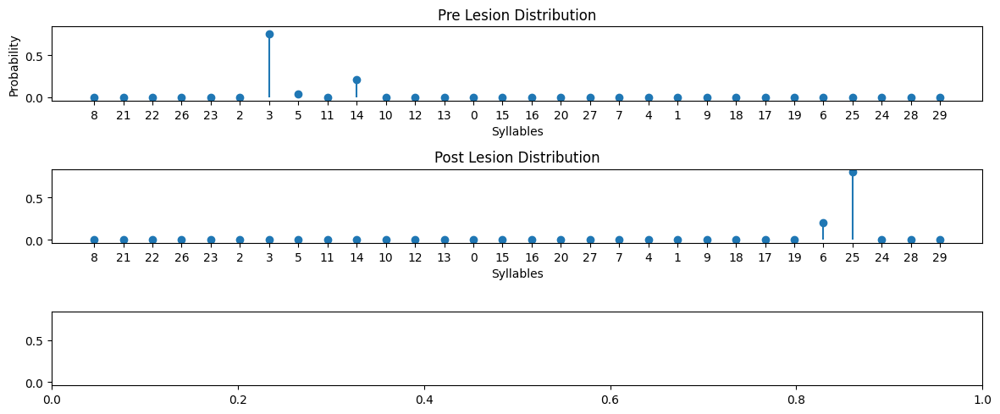

{"Earth Mover's Distance": 19.133332507095584,
 'Information Gain': 0.17457072461074352,
 'Kullback-Leibler Divergence': 18.361113419005328}
30 30


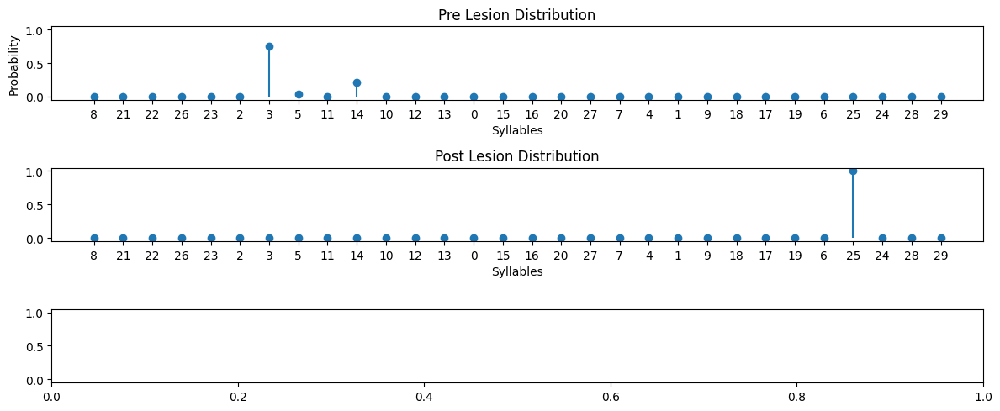

{"Earth Mover's Distance": 19.333328291819583,
 'Information Gain': 0.6749616694582451,
 'Kullback-Leibler Divergence': 16.75167617703119}
30 30


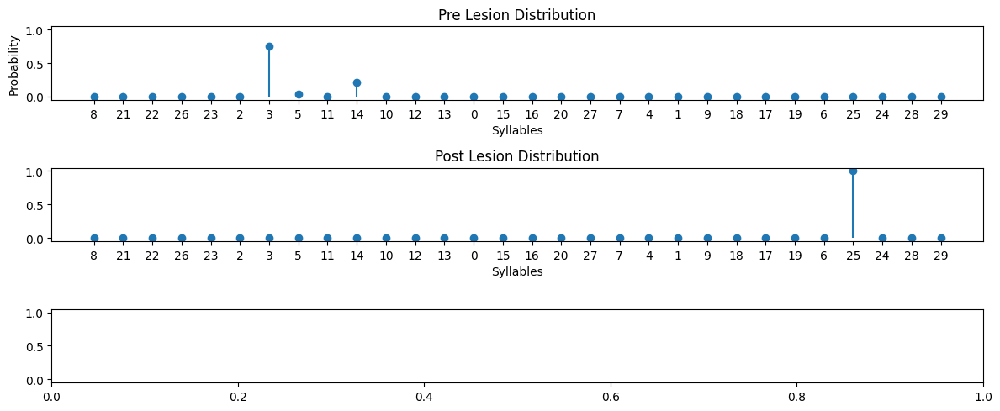

{"Earth Mover's Distance": 19.333328291819583,
 'Information Gain': 0.6749616694582451,
 'Kullback-Leibler Divergence': 16.75167617703119}
30 30


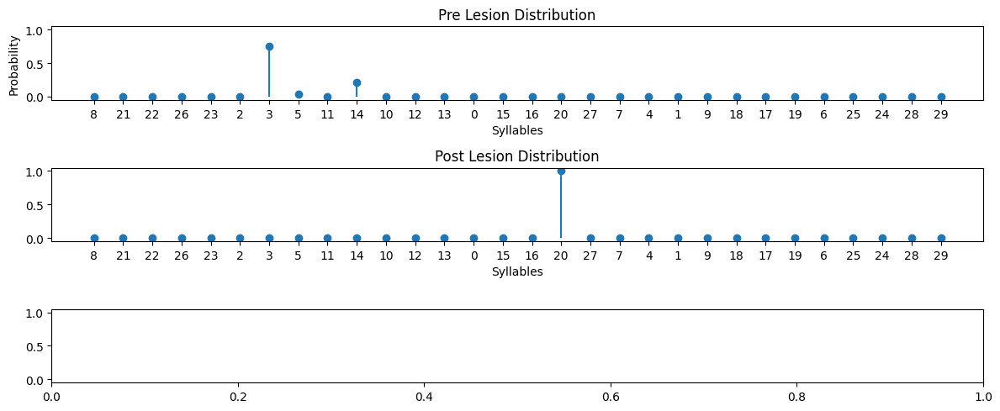

{"Earth Mover's Distance": 9.333339409003763,
 'Information Gain': 0.6749616694582449,
 'Kullback-Leibler Divergence': 16.75167617703119}
30 30


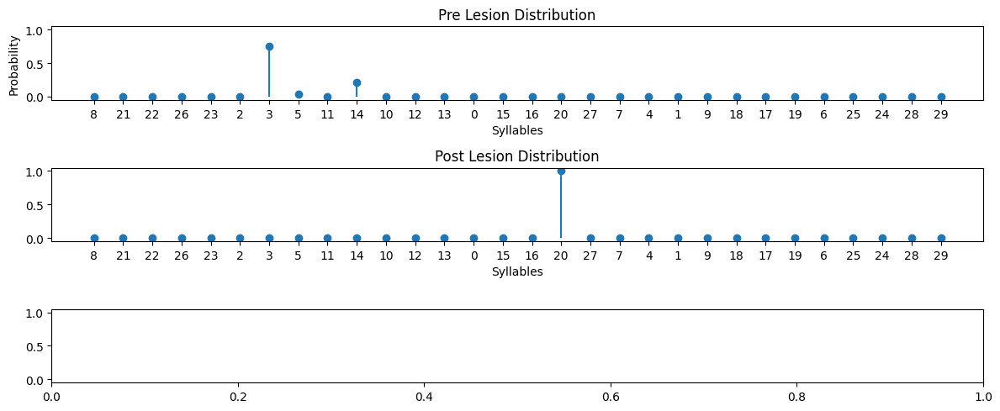

{"Earth Mover's Distance": 9.333339409003763,
 'Information Gain': 0.6749616694582449,
 'Kullback-Leibler Divergence': 16.75167617703119}
30 30


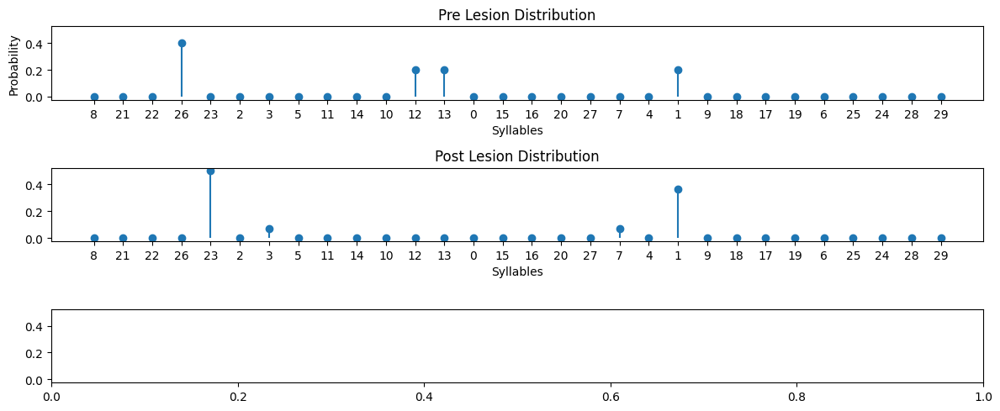

{"Earth Mover's Distance": 3.2000036370649063,
 'Information Gain': 0.2566594021467101,
 'Kullback-Leibler Divergence': 15.530755747963049}
30 30


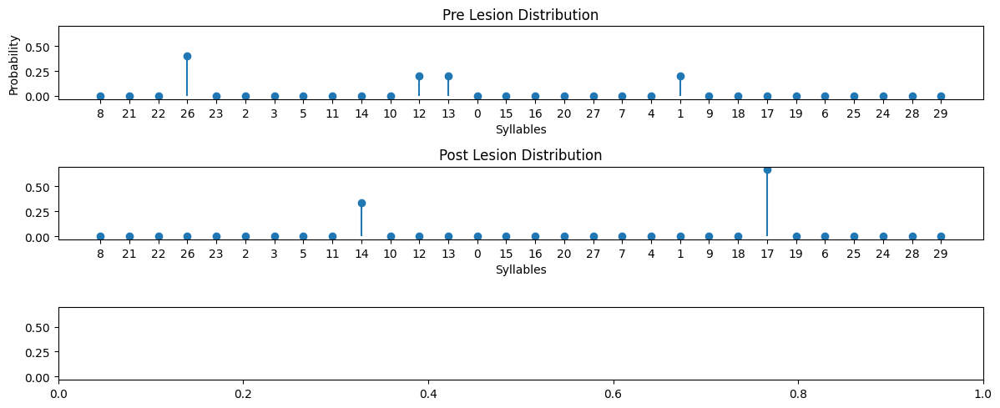

{"Earth Mover's Distance": 8.533334354938331,
 'Information Gain': 0.6956653469620935,
 'Kullback-Leibler Divergence': 17.19307937508867}
30 30


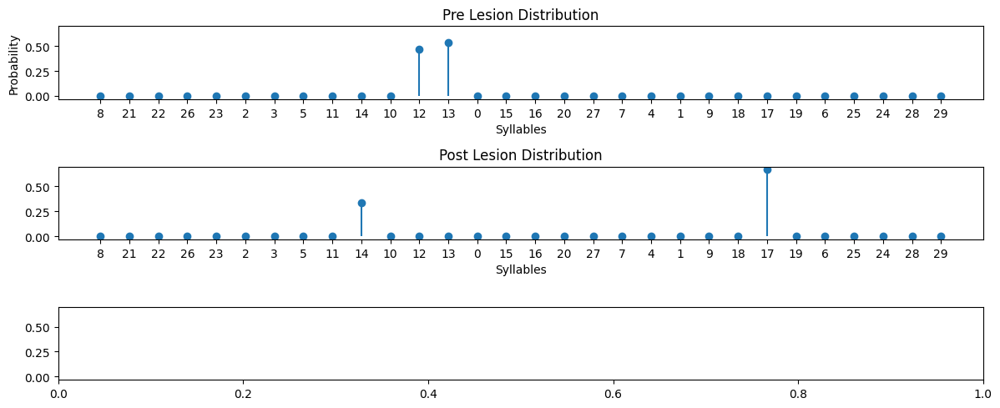

{"Earth Mover's Distance": 8.133333682628333,
 'Information Gain': 0.05440510076991023,
 'Kullback-Leibler Divergence': 17.834339975291766}
30 30


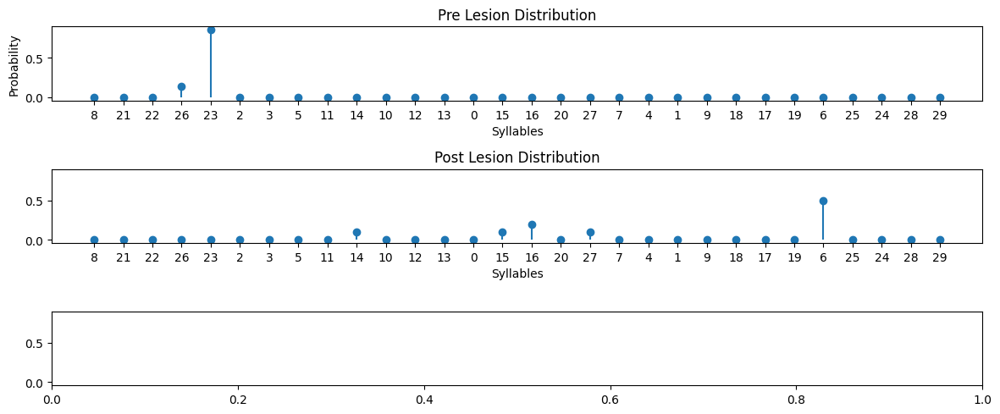

{"Earth Mover's Distance": 15.64285960770918,
 'Information Gain': -0.9491173773411624,
 'Kullback-Leibler Divergence': 19.319115315452706}
30 30


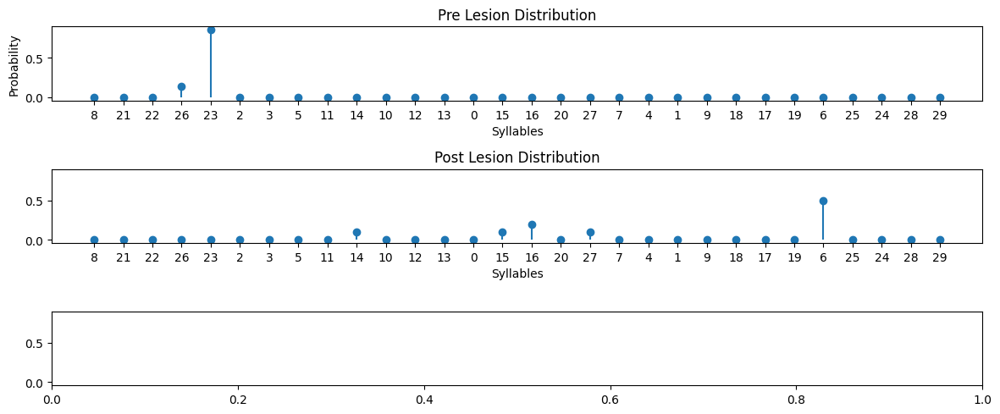

{"Earth Mover's Distance": 15.64285960770918,
 'Information Gain': -0.9491173773411624,
 'Kullback-Leibler Divergence': 19.319115315452706}
30 30


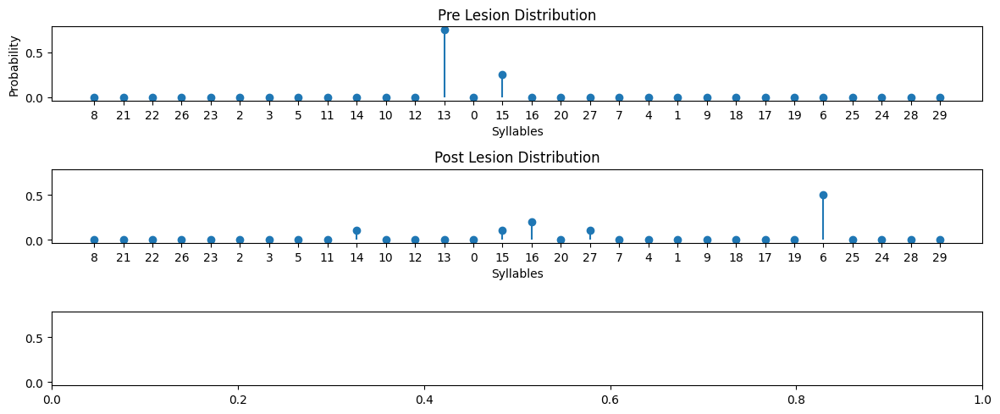

{"Earth Mover's Distance": 7.600004509857104,
 'Information Gain': -0.7968956003438445,
 'Kullback-Leibler Divergence': 14.810231951475725}
30 30


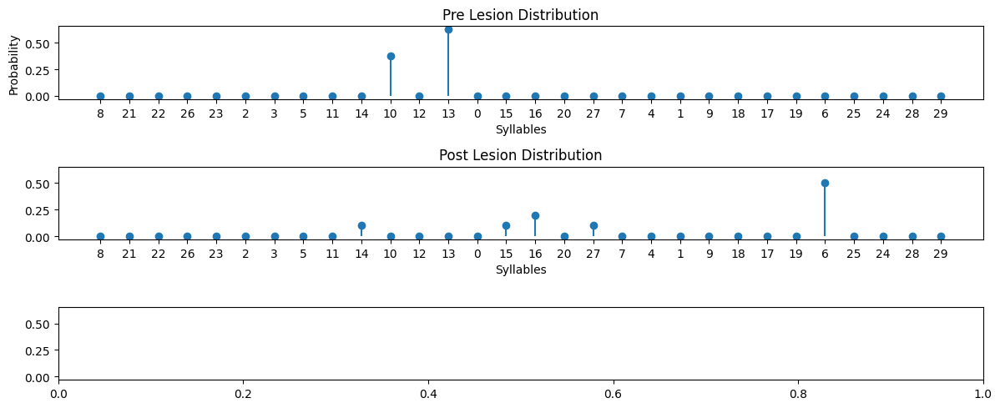

{"Earth Mover's Distance": 8.450001913677987,
 'Information Gain': -0.6976710286652202,
 'Kullback-Leibler Divergence': 19.067669056244505}
30 30


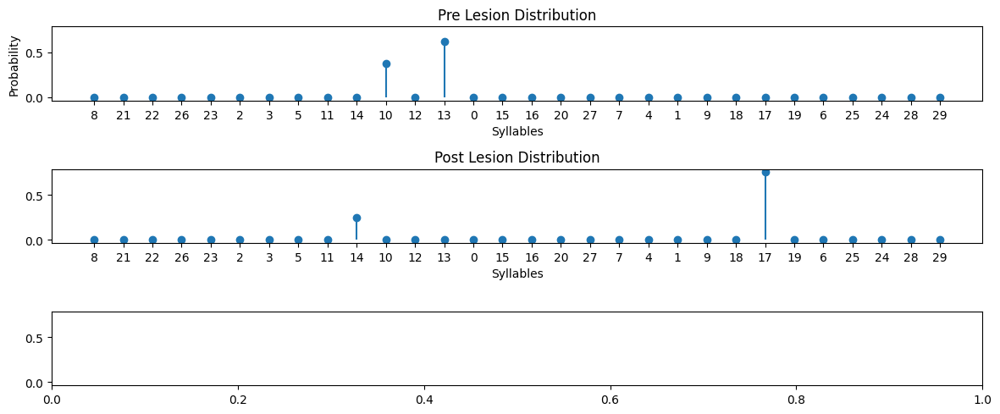

{"Earth Mover's Distance": 8.750000110026232,
 'Information Gain': 0.09922819749083922,
 'Kullback-Leibler Divergence': 18.15137882048595}
30 30


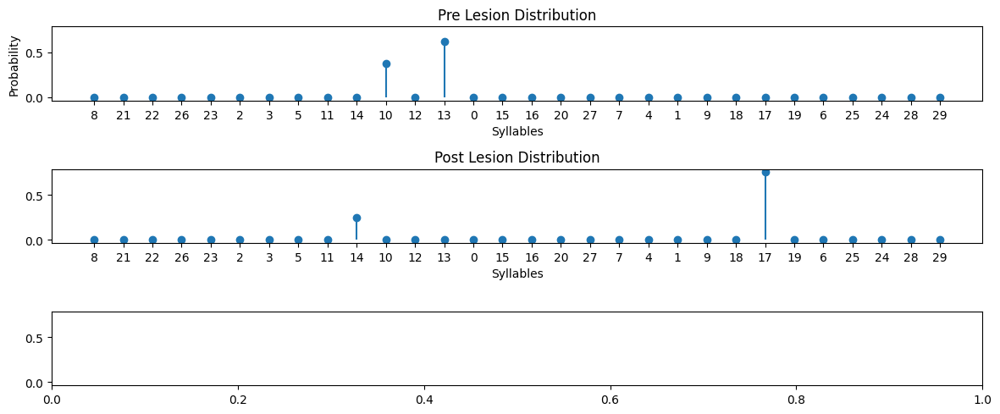

{"Earth Mover's Distance": 8.750000110026232,
 'Information Gain': 0.09922819749083922,
 'Kullback-Leibler Divergence': 18.15137882048595}
30 30


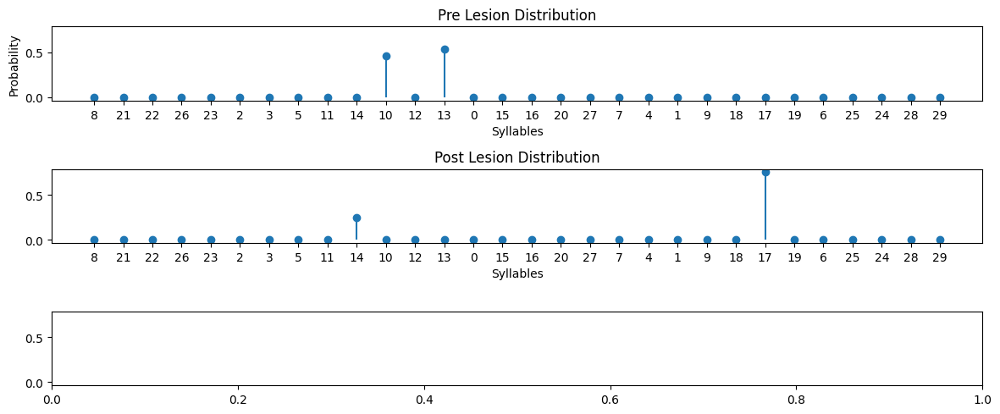

{"Earth Mover's Distance": 8.923077028891514,
 'Information Gain': 0.12784810912031275,
 'Kullback-Leibler Divergence': 18.122759083147162}
30 30


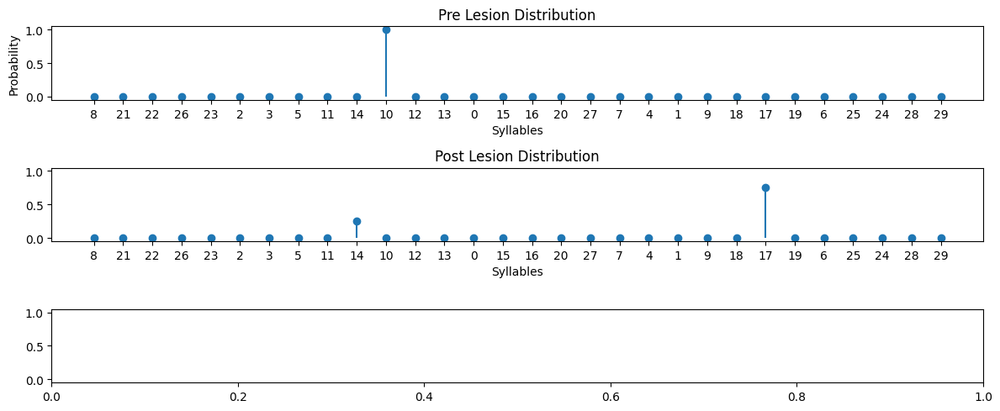

{"Earth Mover's Distance": 10.000021922813739,
 'Information Gain': -0.5623100384737028,
 'Kullback-Leibler Divergence': 18.81291529418081}
30 30


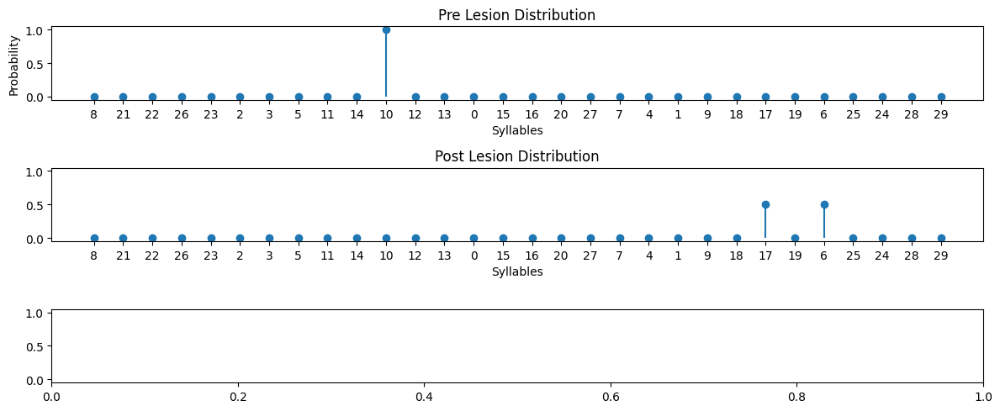

{"Earth Mover's Distance": 14.000019766917495,
 'Information Gain': -0.6931254001985513,
 'Kullback-Leibler Divergence': 18.119768377822442}
30 30


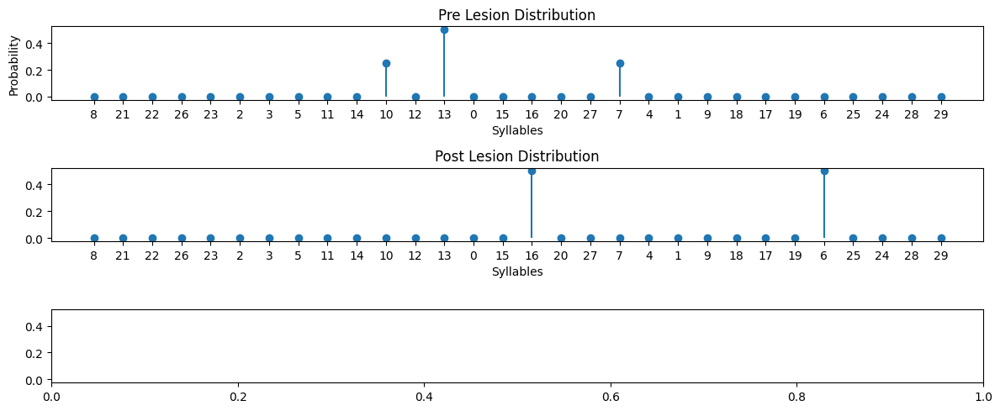

{"Earth Mover's Distance": 7.0000002299425015,
 'Information Gain': 0.3465734475593426,
 'Kullback-Leibler Divergence': 17.080070994423004}
30 30


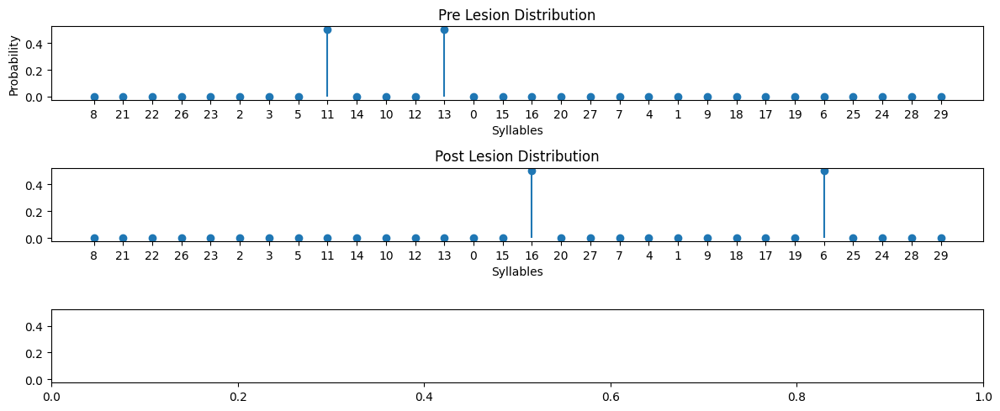

{"Earth Mover's Distance": 10.000006742267505,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}
30 30


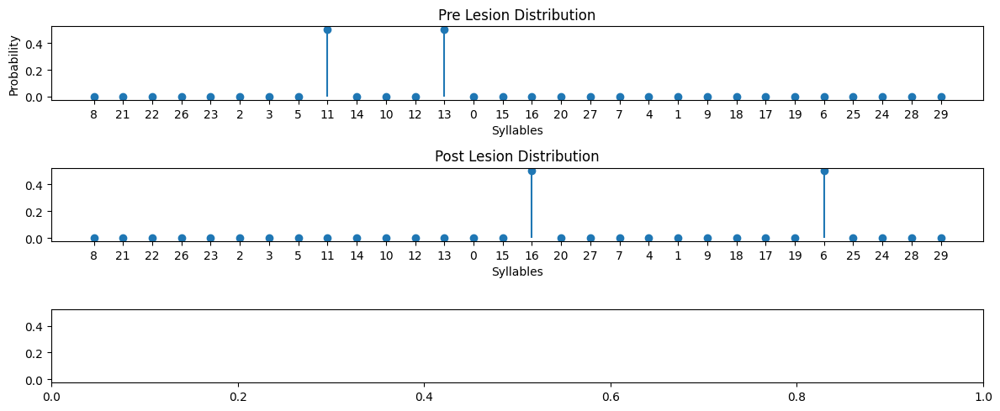

{"Earth Mover's Distance": 10.000006742267505,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}
30 30


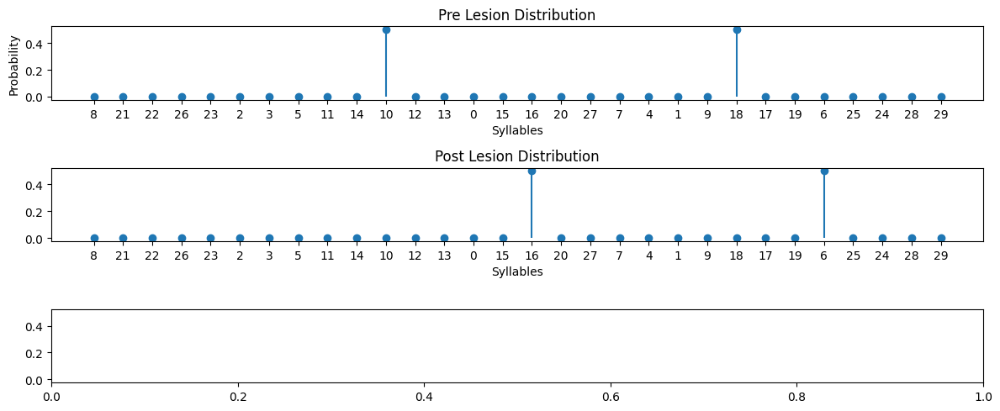

{"Earth Mover's Distance": 4.000006742267494,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}
30 30


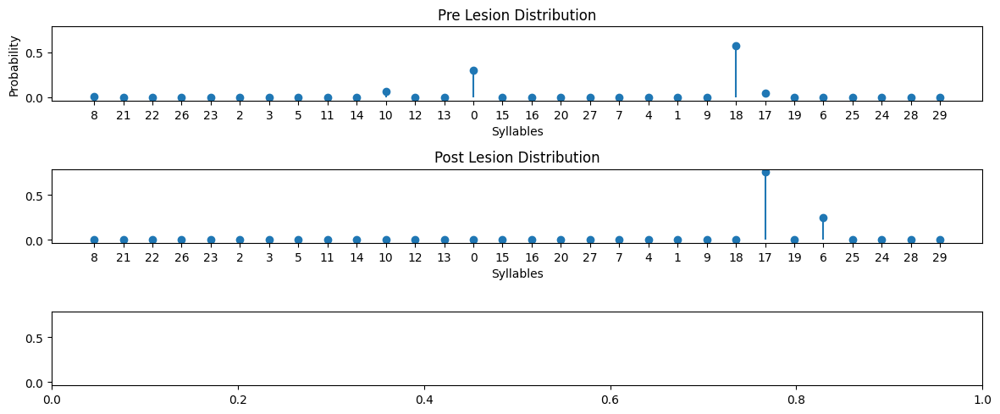

{"Earth Mover's Distance": 5.185183999437389,
 'Information Gain': 0.49267363034517786,
 'Kullback-Leibler Divergence': 16.84310579480594}
30 30


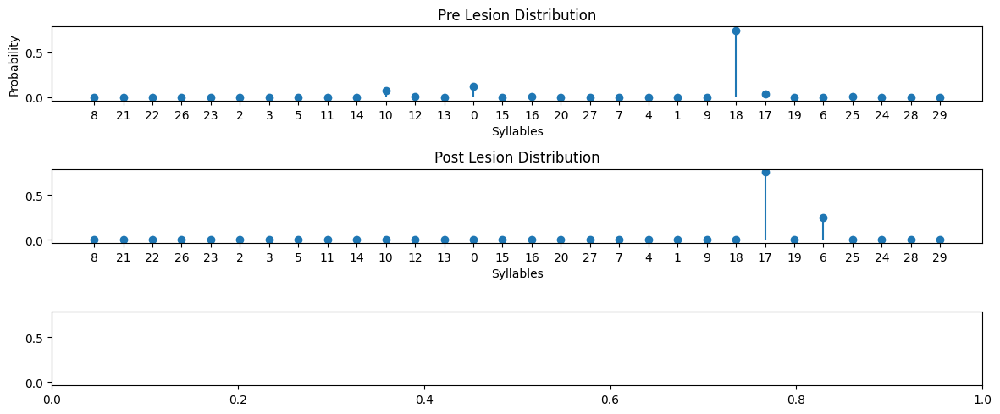

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}
30 30


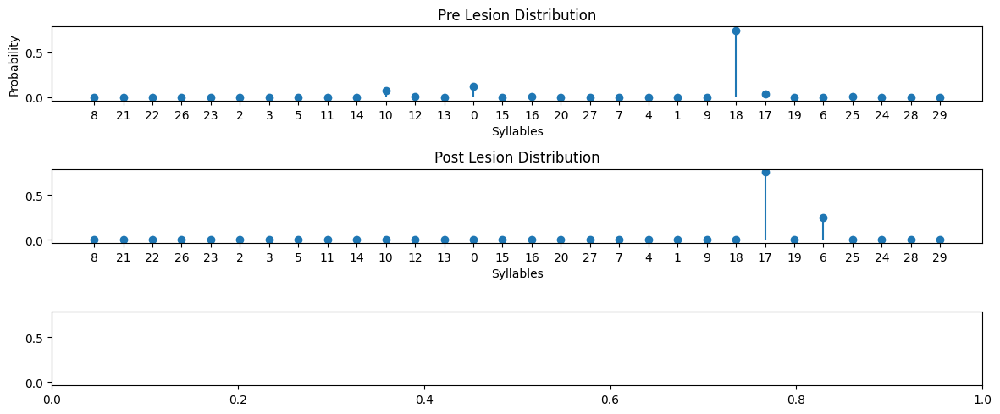

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}
30 30


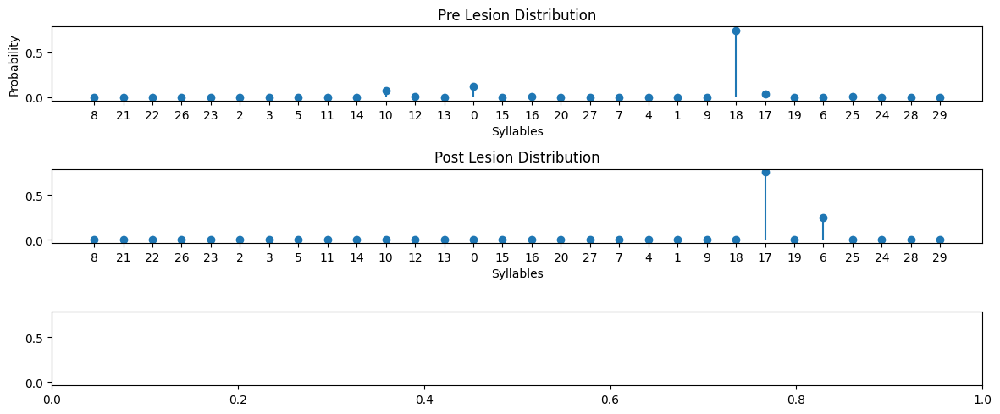

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}
30 30


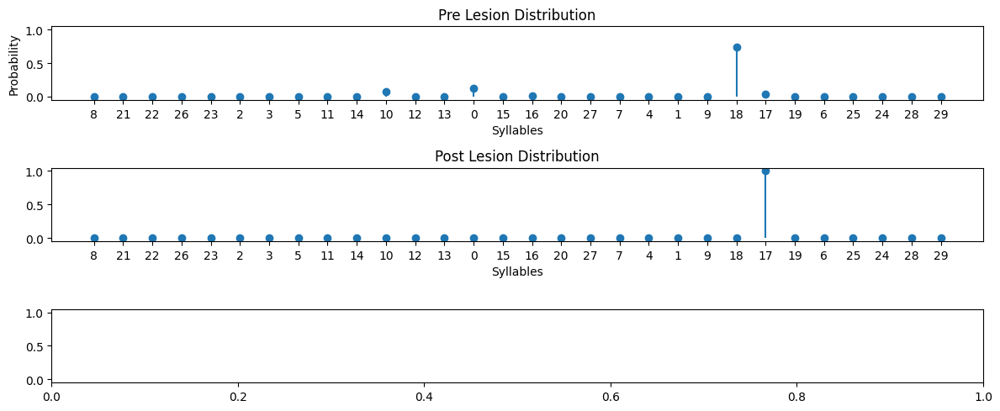

{"Earth Mover's Distance": 3.056452229190825,
 'Information Gain': 0.8918413278813516,
 'Kullback-Leibler Divergence': 15.832108978380786}
30 30


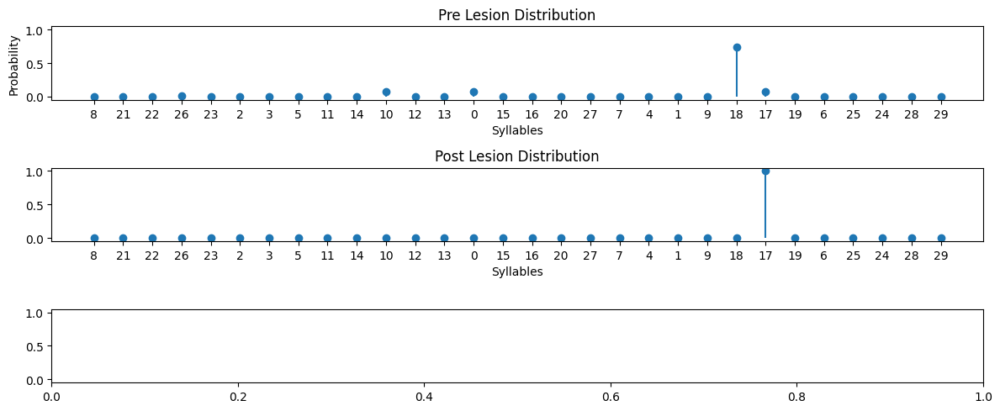

{"Earth Mover's Distance": 2.8888869290043693,
 'Information Gain': 0.8875889189164976,
 'Kullback-Leibler Divergence': 15.155981388159777}
30 30


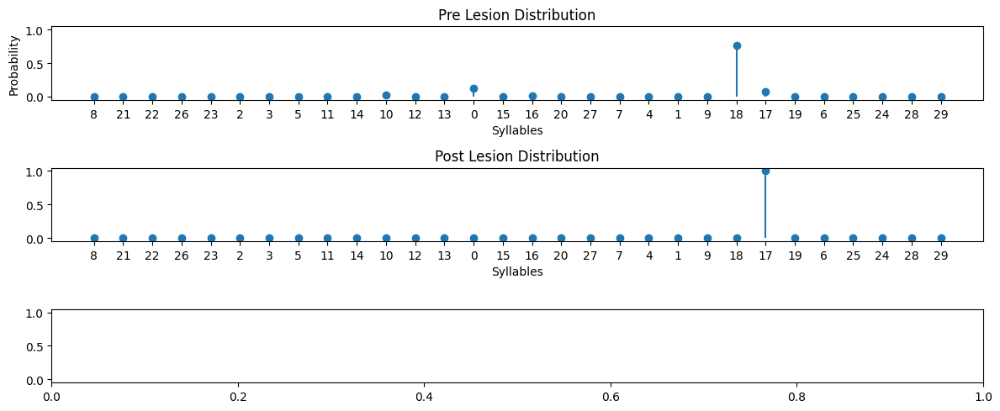

{"Earth Mover's Distance": 2.435820491461568,
 'Information Gain': 0.8002479325414149,
 'Kullback-Leibler Divergence': 15.325893553815462}
30 30


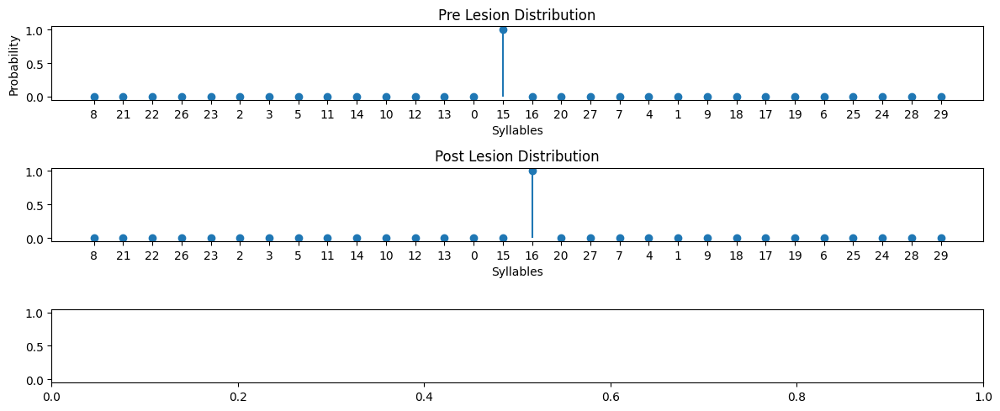

{"Earth Mover's Distance": 1.0000134845349846,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


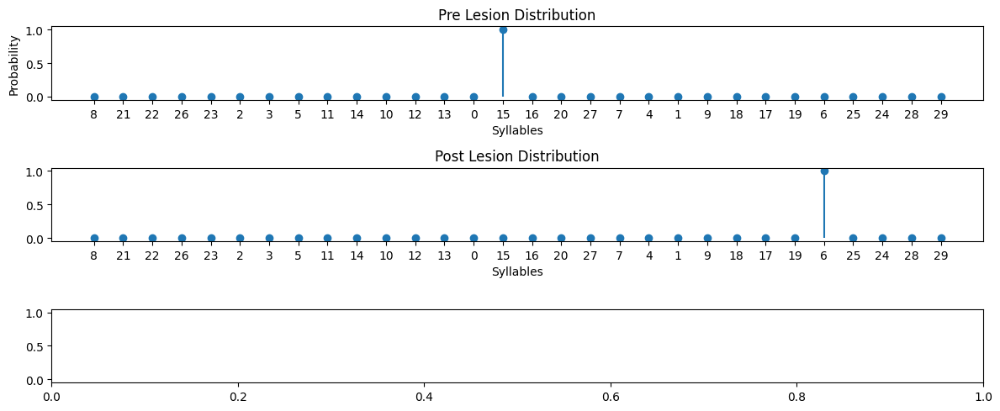

{"Earth Mover's Distance": 11.000019766917497,
 'Information Gain': 2.1259830145249686e-05,
 'Kullback-Leibler Divergence': 18.119769315231782}
30 30


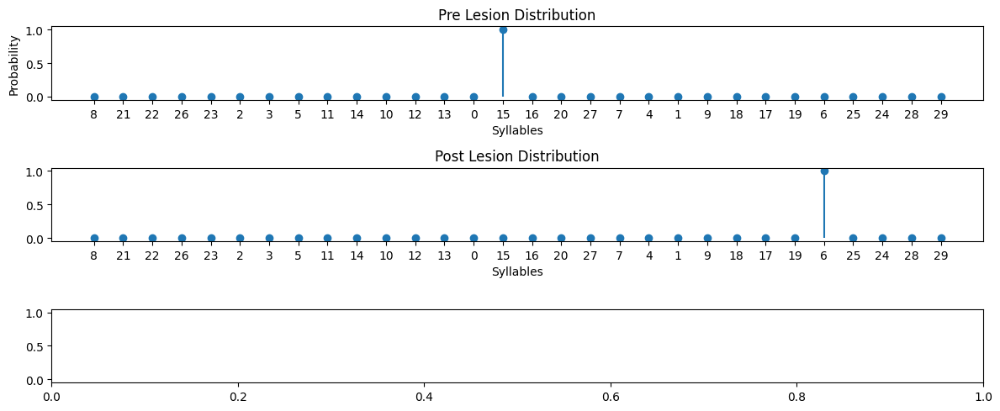

{"Earth Mover's Distance": 11.000013484534996,
 'Information Gain': 1.4311771776276148e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


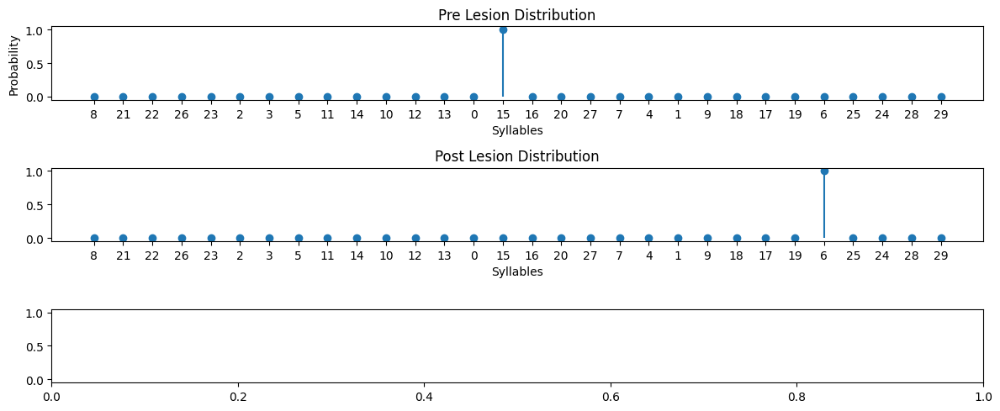

{"Earth Mover's Distance": 11.000013484534996,
 'Information Gain': 1.4311771776276148e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


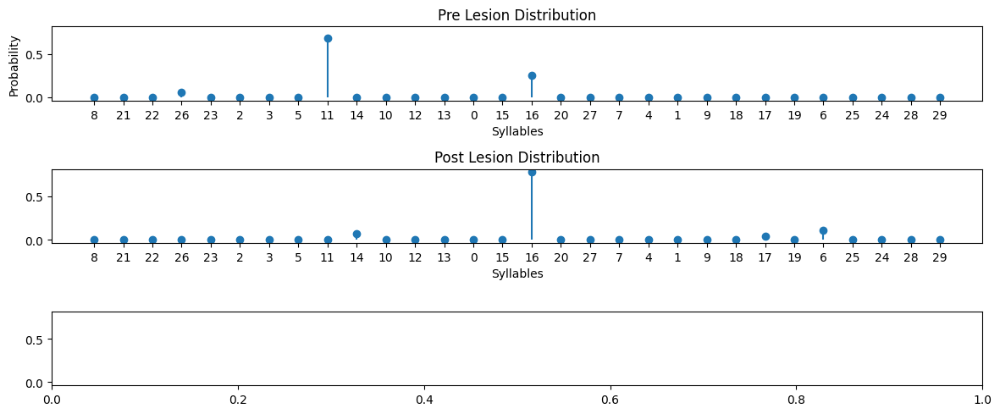

{"Earth Mover's Distance": 6.5254641256825385,
 'Information Gain': 0.023000747988902615,
 'Kullback-Leibler Divergence': 14.827231183208692}
30 30


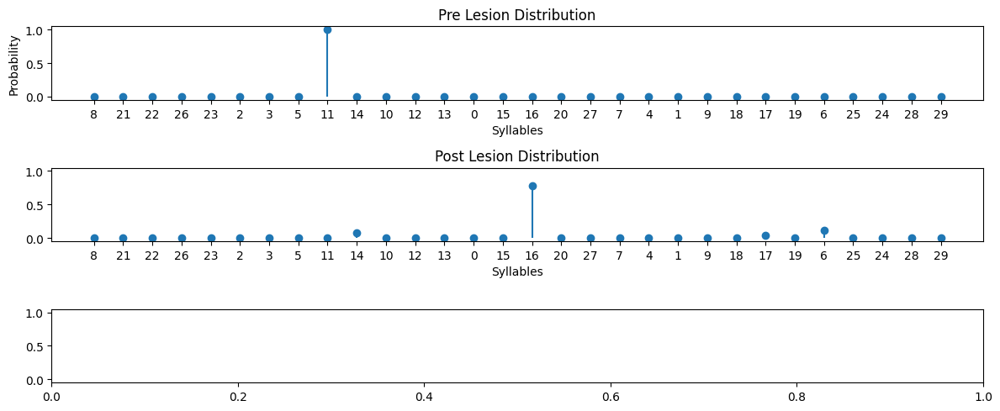

{"Earth Mover's Distance": 7.962988546901289,
 'Information Gain': -0.7544345022016341,
 'Kullback-Leibler Divergence': 20.722455464568437}
30 30


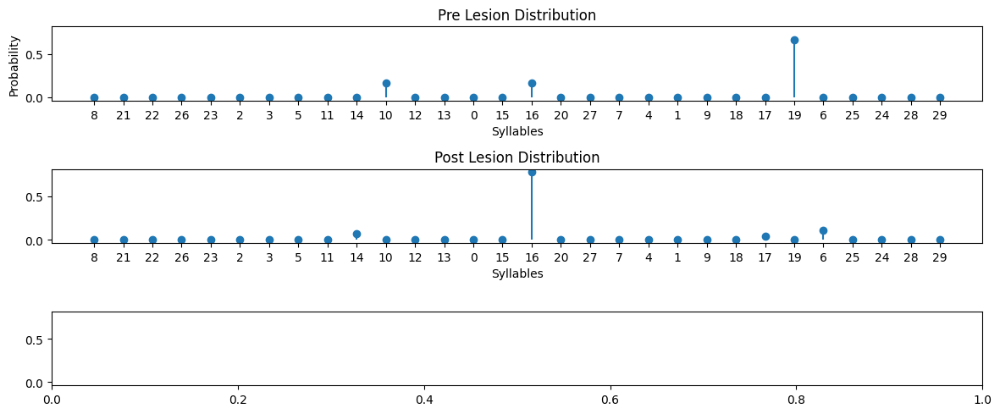

{"Earth Mover's Distance": 5.35185256040241,
 'Information Gain': 0.11310468252935557,
 'Kullback-Leibler Divergence': 16.443058392989002}
30 30


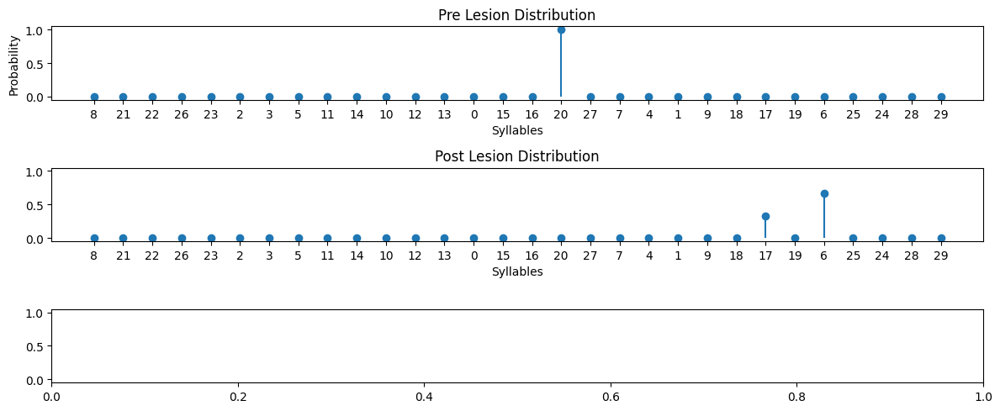

{"Earth Mover's Distance": 8.333355194378328,
 'Information Gain': -0.6364901829913666,
 'Kullback-Leibler Divergence': 18.525233311995628}
30 30


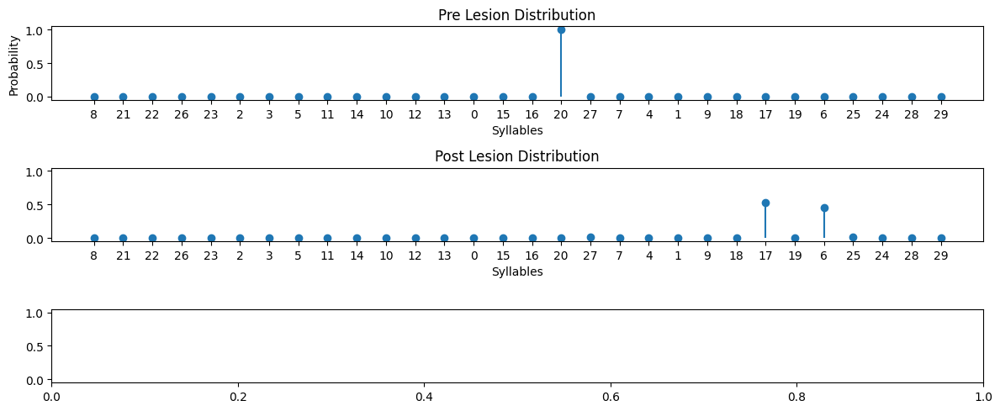

{"Earth Mover's Distance": 7.895187238293827,
 'Information Gain': -0.7735666951523167,
 'Kullback-Leibler Divergence': 22.246899951271086}
30 30


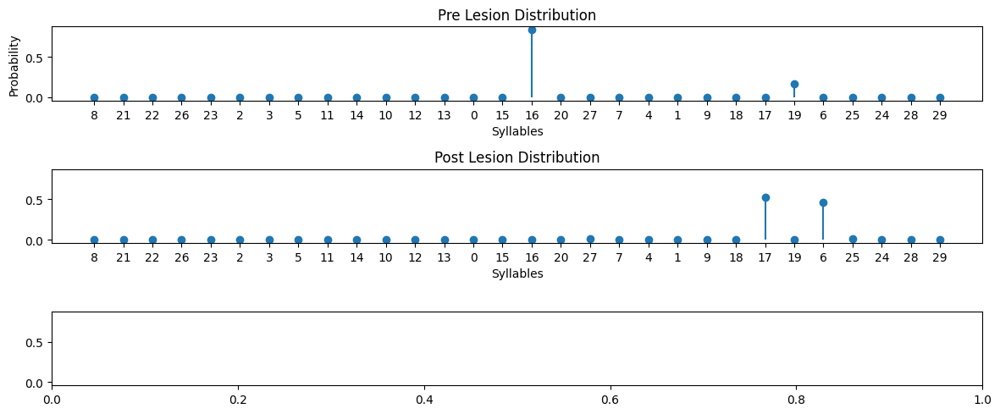

{"Earth Mover's Distance": 7.395165530543835,
 'Information Gain': -0.3230292500815218,
 'Kullback-Leibler Divergence': 21.796366143947296}
30 30


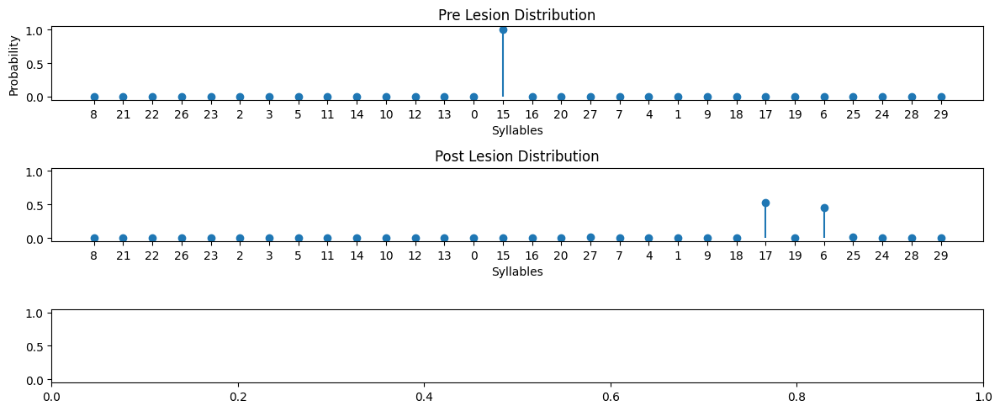

{"Earth Mover's Distance": 9.895187238293827,
 'Information Gain': -0.7735666951523167,
 'Kullback-Leibler Divergence': 22.24689995127109}
30 30


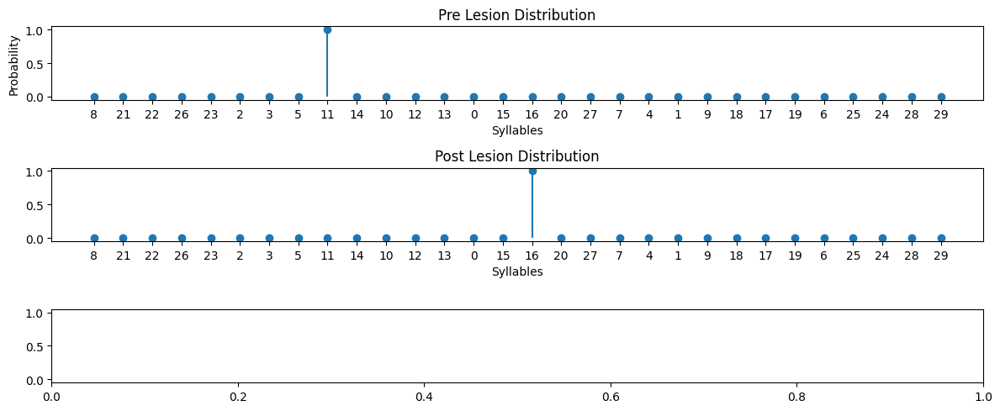

{"Earth Mover's Distance": 7.00001348453498,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


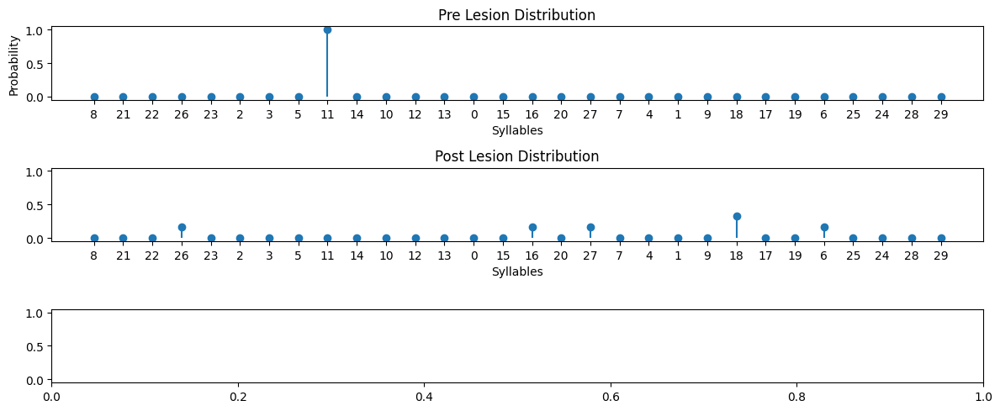

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}
30 30


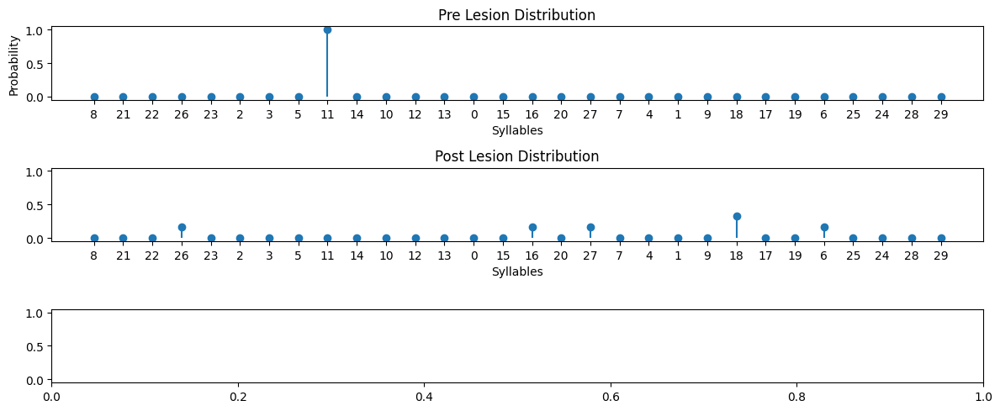

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}
30 30


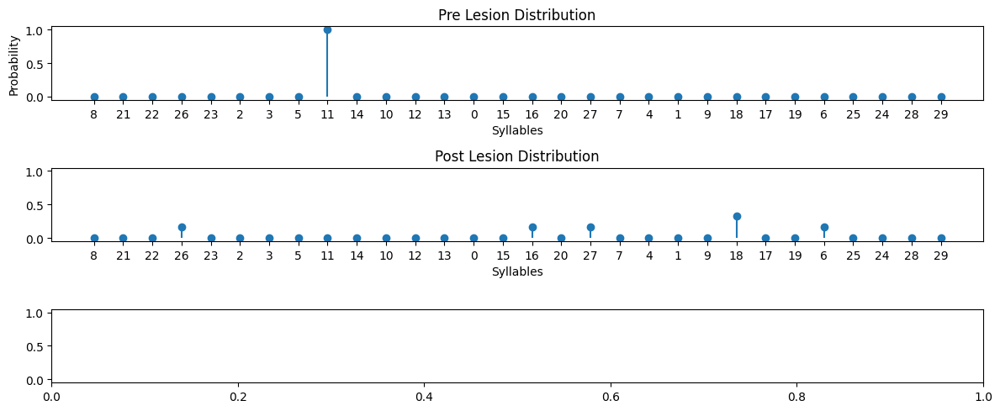

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}
30 30


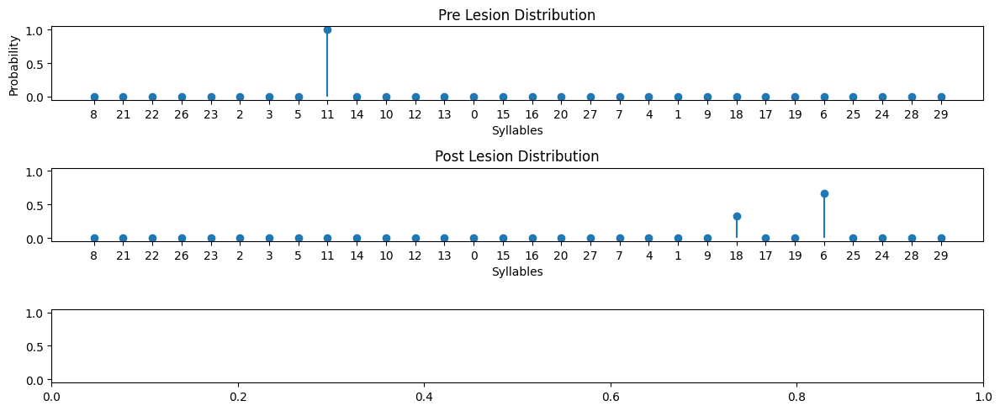

{"Earth Mover's Distance": 16.000004494844998,
 'Information Gain': -0.6365087554203263,
 'Kullback-Leibler Divergence': 18.525253211963033}
30 30


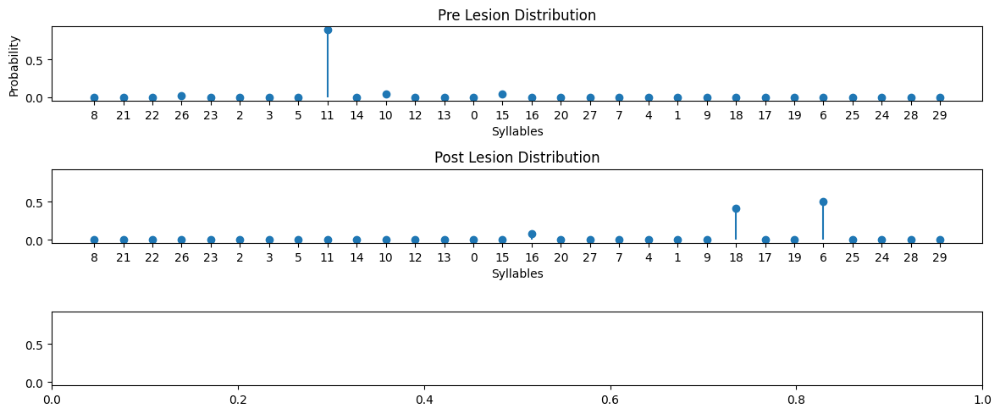

{"Earth Mover's Distance": 14.666666497374372,
 'Information Gain': -0.44449986643721306,
 'Kullback-Leibler Divergence': 19.43762900491851}
30 30


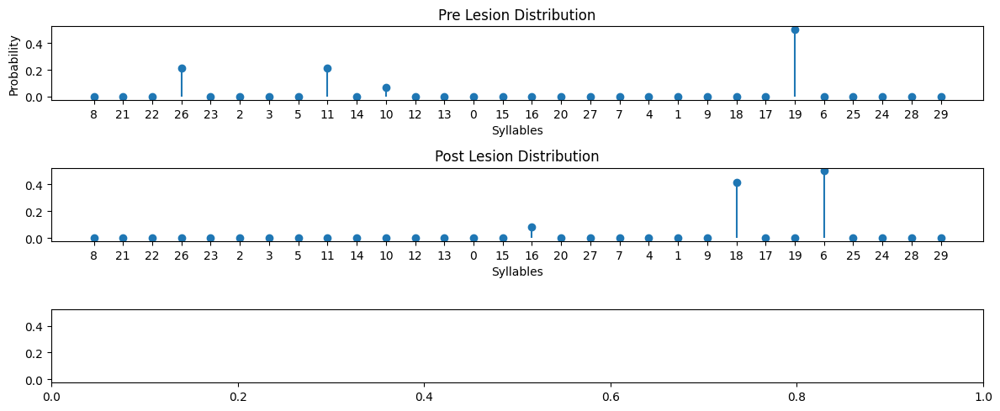

{"Earth Mover's Distance": 7.845238908838622,
 'Information Gain': 0.27684141158443987,
 'Kullback-Leibler Divergence': 18.716287574984957}
30 30


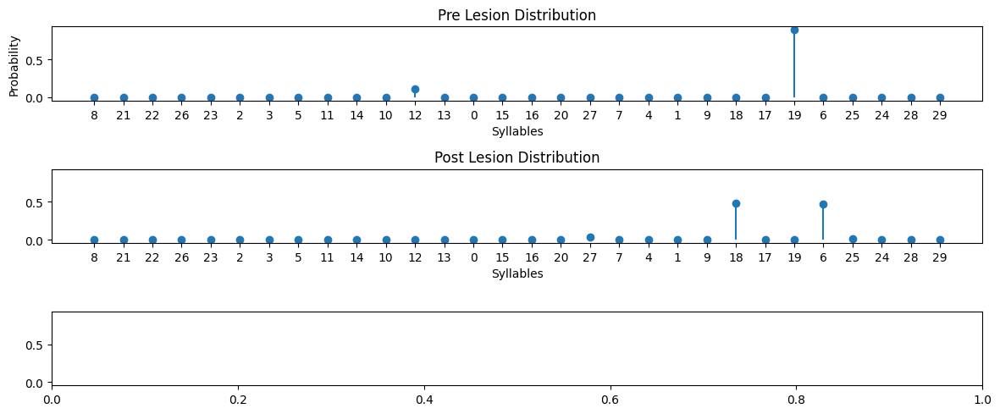

{"Earth Mover's Distance": 2.306605327922502,
 'Information Gain': -0.5668828303081331,
 'Kullback-Leibler Divergence': 23.820695627231228}
30 30


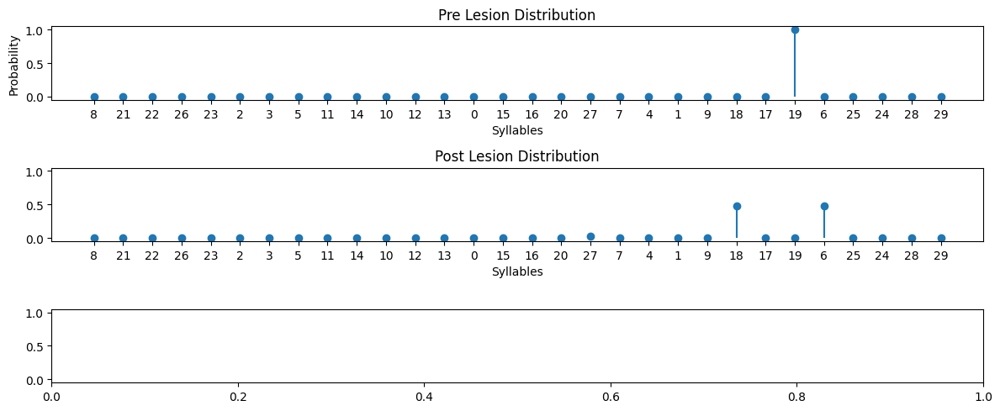

{"Earth Mover's Distance": 1.85376669836498,
 'Information Gain': -0.9156895917222155,
 'Kullback-Leibler Divergence': 24.169494448427724}
30 30


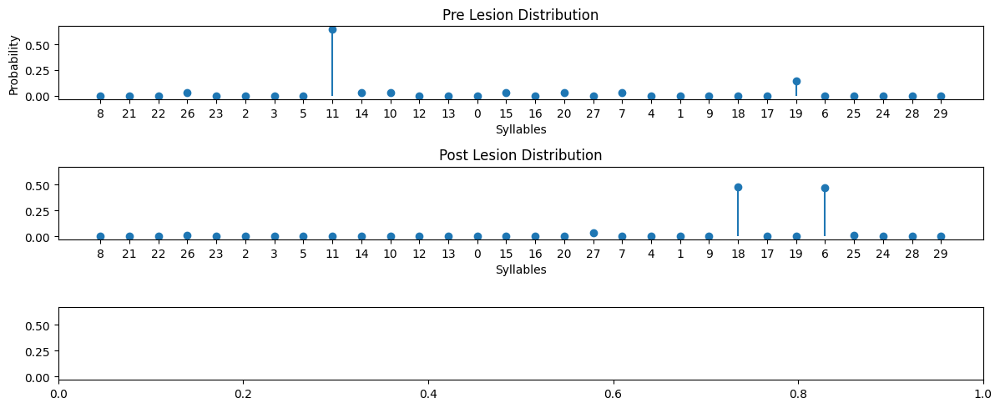

{"Earth Mover's Distance": 12.048855362954544,
 'Information Gain': 0.3603488795645021,
 'Kullback-Leibler Divergence': 20.944088292673218}
30 30


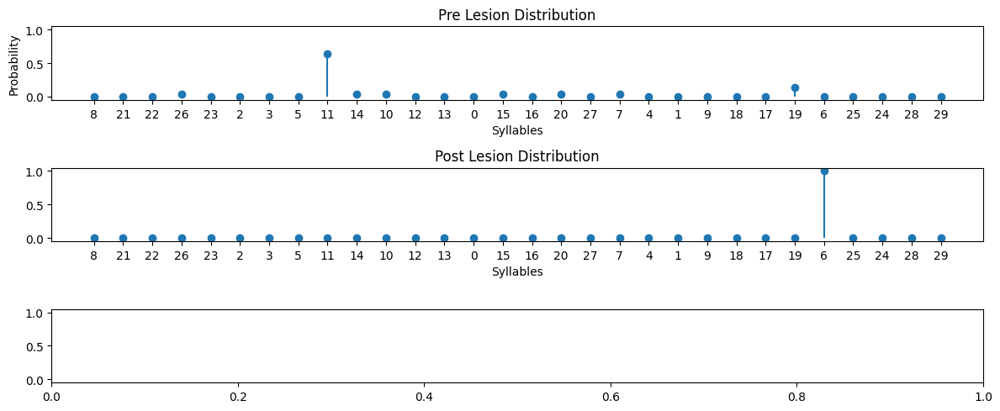

{"Earth Mover's Distance": 13.928567100061999,
 'Information Gain': 1.276052783058494,
 'Kullback-Leibler Divergence': 16.150585048903544}
30 30


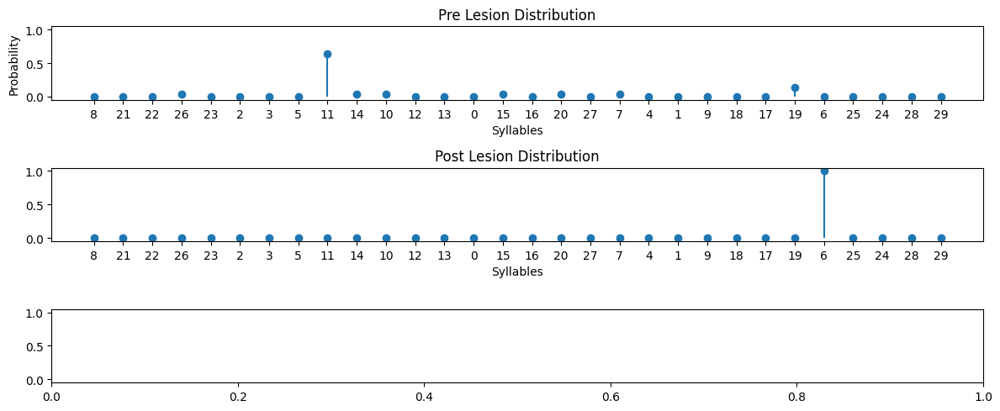

{"Earth Mover's Distance": 13.928567100061999,
 'Information Gain': 1.276052783058494,
 'Kullback-Leibler Divergence': 16.150585048903544}
30 30


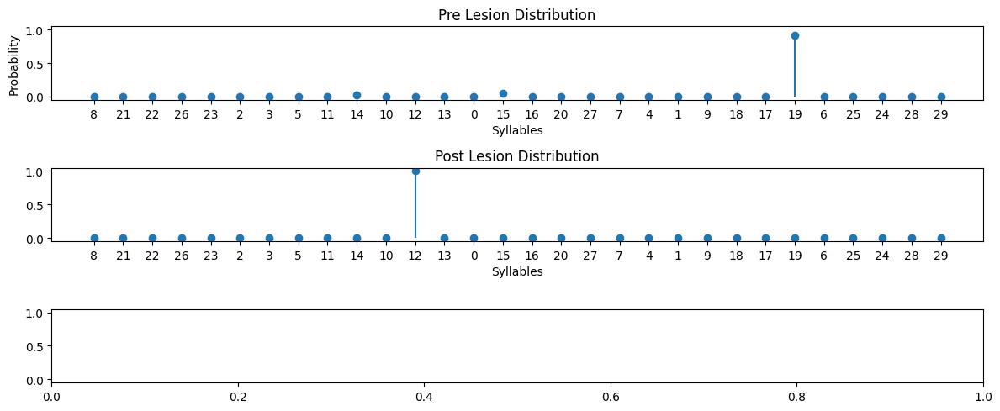

{"Earth Mover's Distance": 12.13889966053691,
 'Information Gain': 0.33986527960266943,
 'Kullback-Leibler Divergence': 17.08677256010732}
30 30


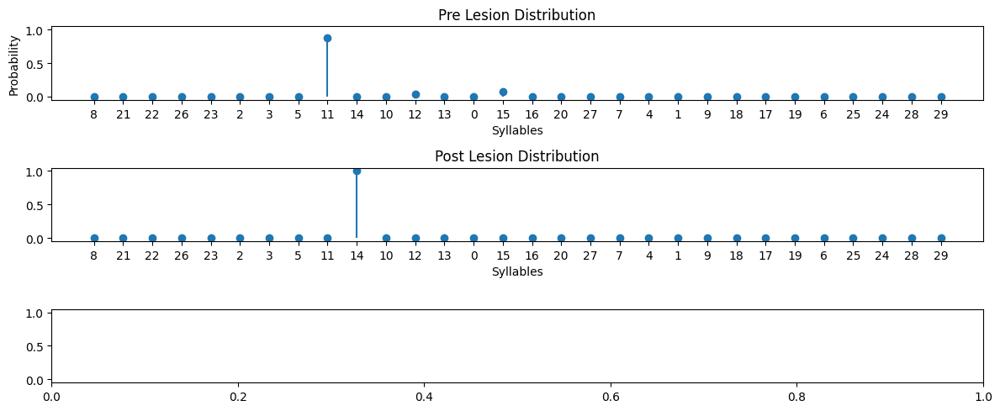

{"Earth Mover's Distance": 1.3600050375559165,
 'Information Gain': 0.44330044908356475,
 'Kullback-Leibler Divergence': 17.676491100444956}
30 30


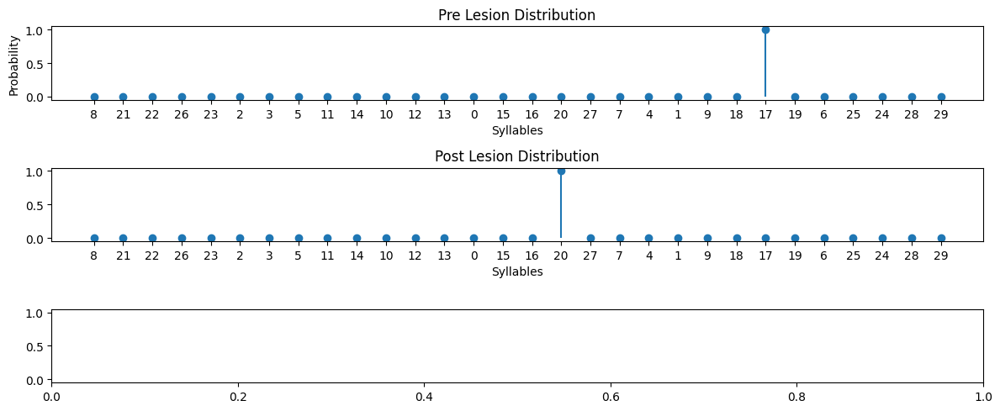

{"Earth Mover's Distance": 7.000005364814995,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}
30 30


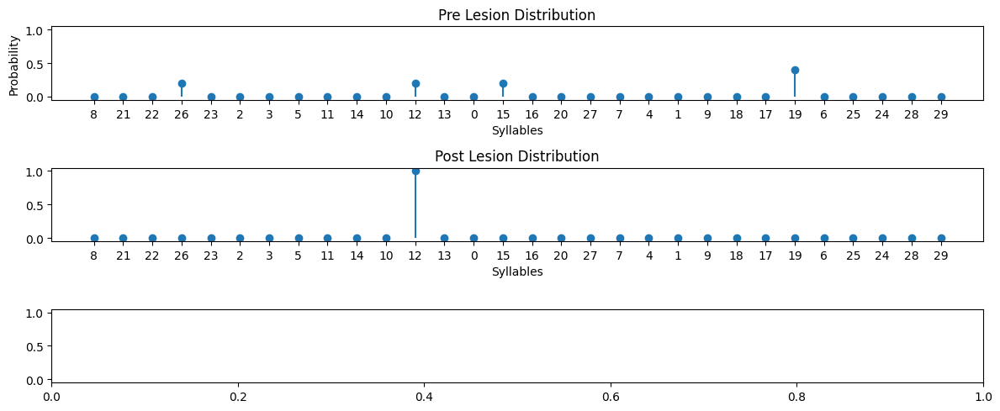

{"Earth Mover's Distance": 7.400005456865027,
 'Information Gain': 1.332169841725236,
 'Kullback-Leibler Divergence': 12.609138696843711}
30 30


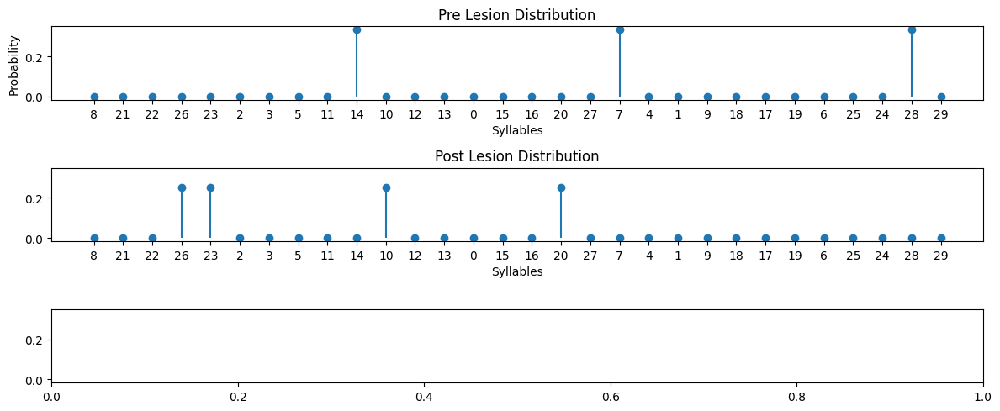

{"Earth Mover's Distance": 10.083329340775421,
 'Information Gain': -0.28767638609424173,
 'Kullback-Leibler Divergence': 17.71432354618252}
30 30


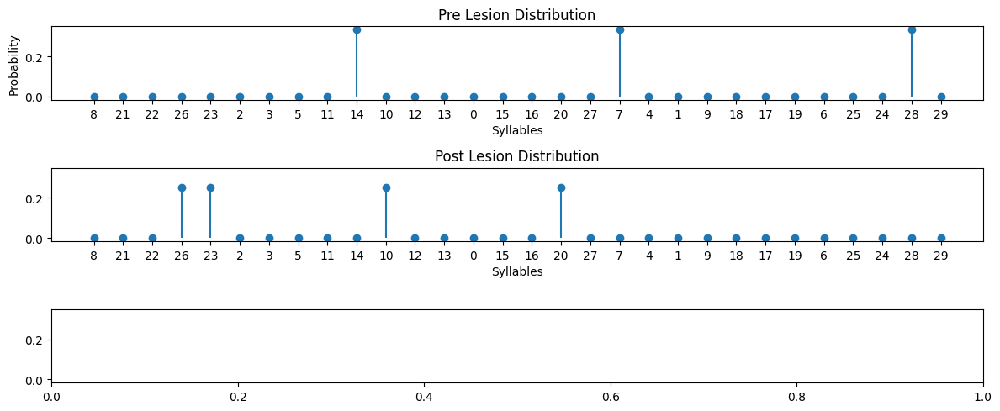

{"Earth Mover's Distance": 10.083329340775421,
 'Information Gain': -0.28767638609424173,
 'Kullback-Leibler Divergence': 17.71432354618252}
30 30


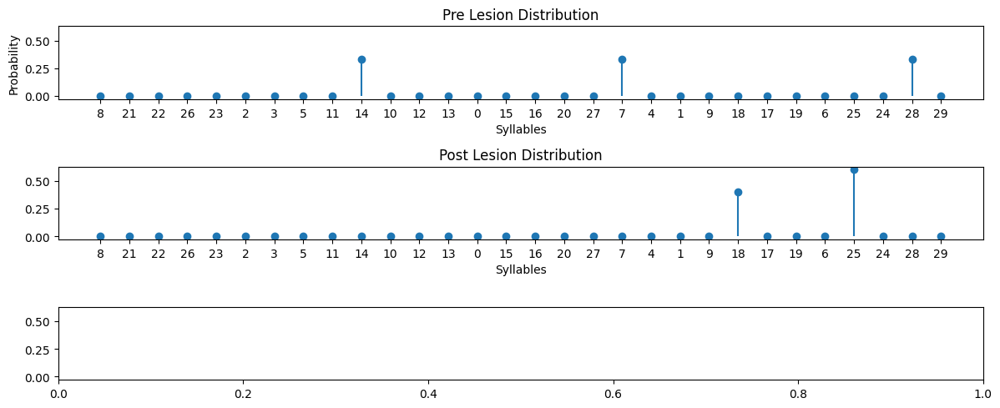

{"Earth Mover's Distance": 7.400004710542332,
 'Information Gain': 0.4256066139960991,
 'Kullback-Leibler Divergence': 17.93746767433411}
30 30


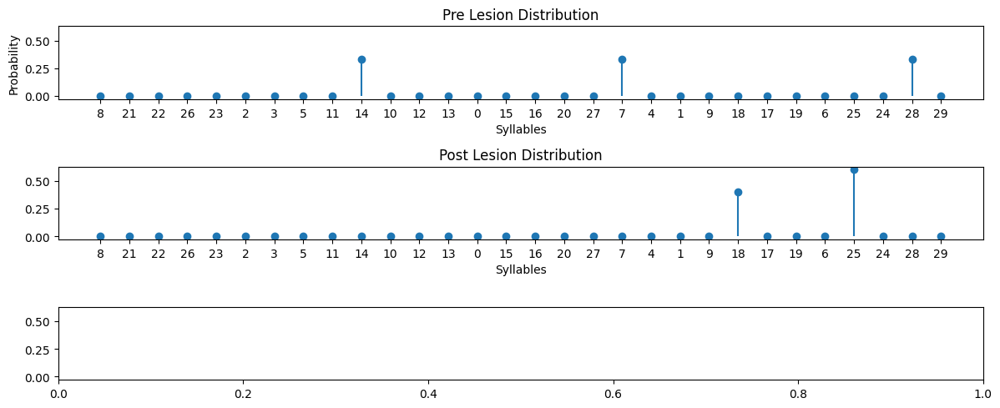

{"Earth Mover's Distance": 7.400004710542332,
 'Information Gain': 0.4256066139960991,
 'Kullback-Leibler Divergence': 17.93746767433411}
30 30


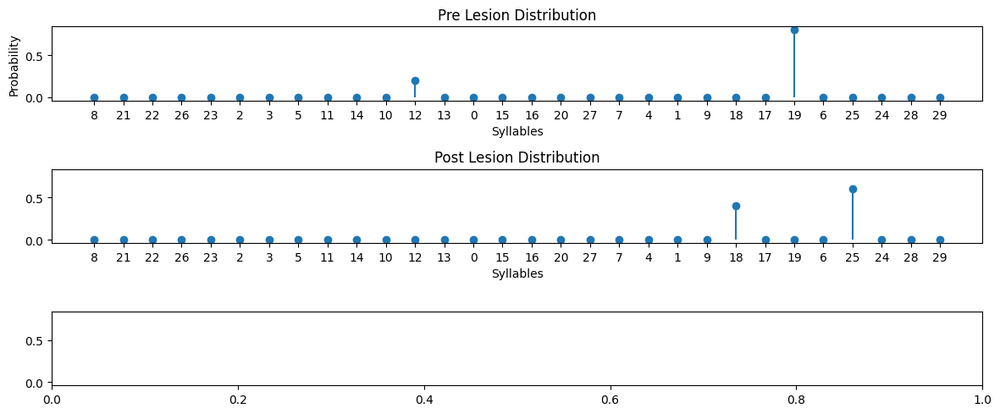

{"Earth Mover's Distance": 3.800002151725799,
 'Information Gain': -0.17260626471224283,
 'Kullback-Leibler Divergence': 18.535680826756398}
30 30


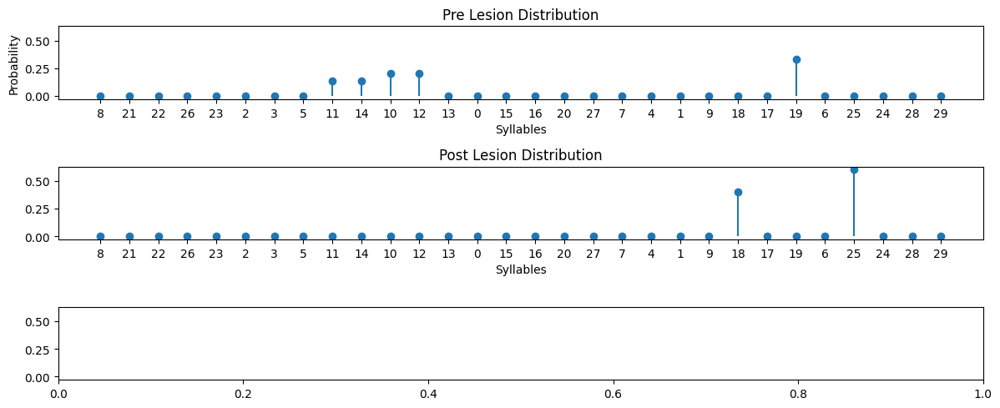

{"Earth Mover's Distance": 9.933333057860334,
 'Information Gain': 0.8742738989391544,
 'Kullback-Leibler Divergence': 17.488800936819064}
30 30


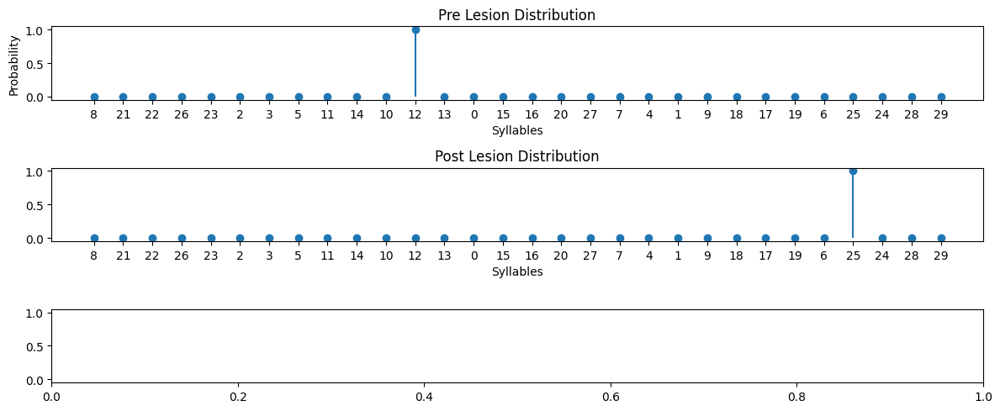

{"Earth Mover's Distance": 15.000010511697017,
 'Information Gain': 1.1798481452966996e-05,
 'Kullback-Leibler Divergence': 19.03607409826339}
30 30


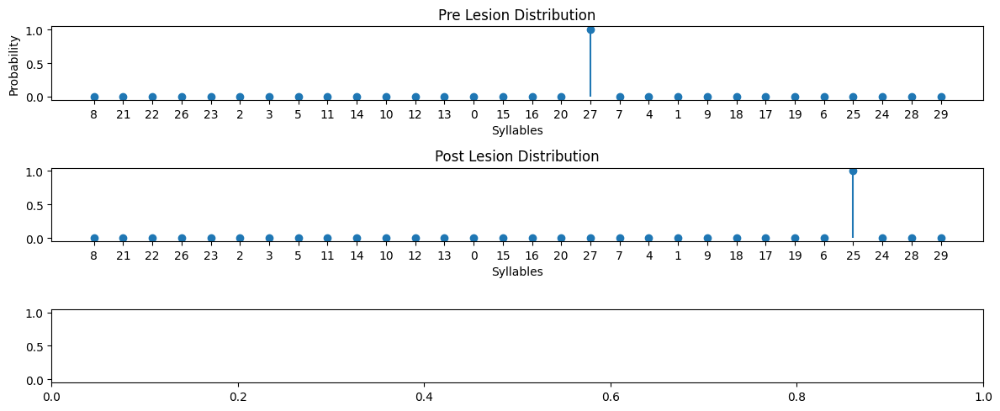

{"Earth Mover's Distance": 9.000023536346996,
 'Information Gain': 2.561095885060659e-05,
 'Kullback-Leibler Divergence': 19.0360597525865}
30 30


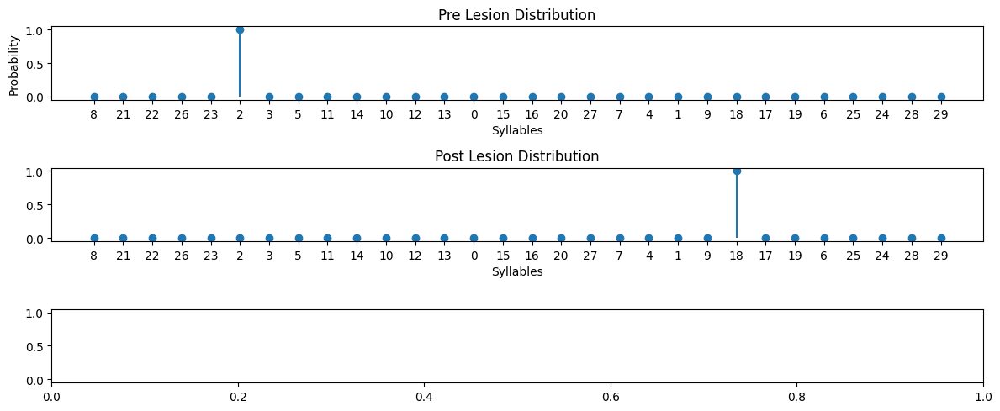

{"Earth Mover's Distance": 17.00001348453499,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}
30 30


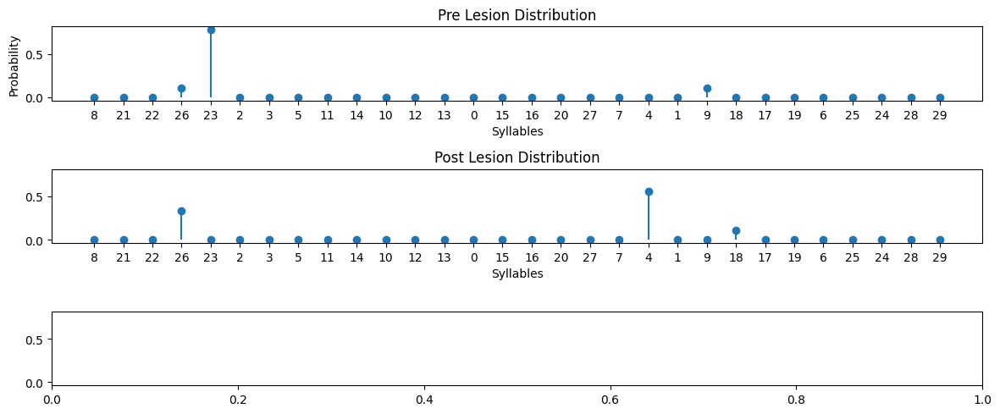

{"Earth Mover's Distance": 8.666669053882314,
 'Information Gain': -0.2531467196548718,
 'Kullback-Leibler Divergence': 17.858315610182704}
30 30


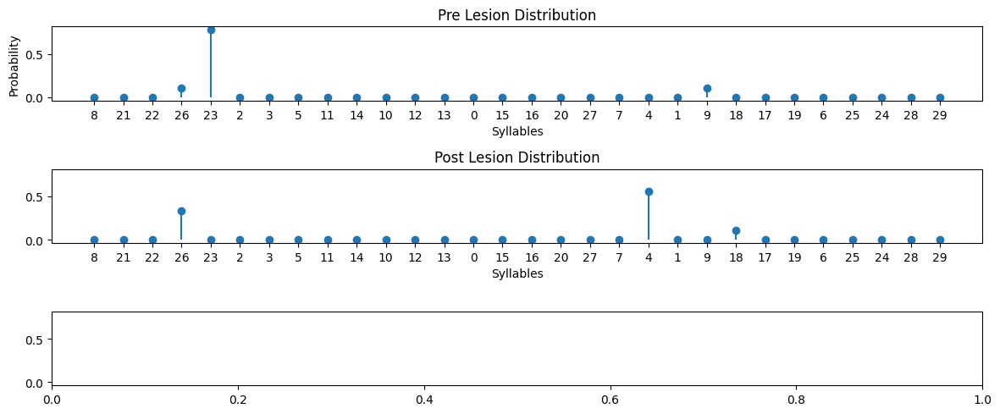

{"Earth Mover's Distance": 8.666669053882314,
 'Information Gain': -0.2531467196548718,
 'Kullback-Leibler Divergence': 17.858315610182704}
30 30


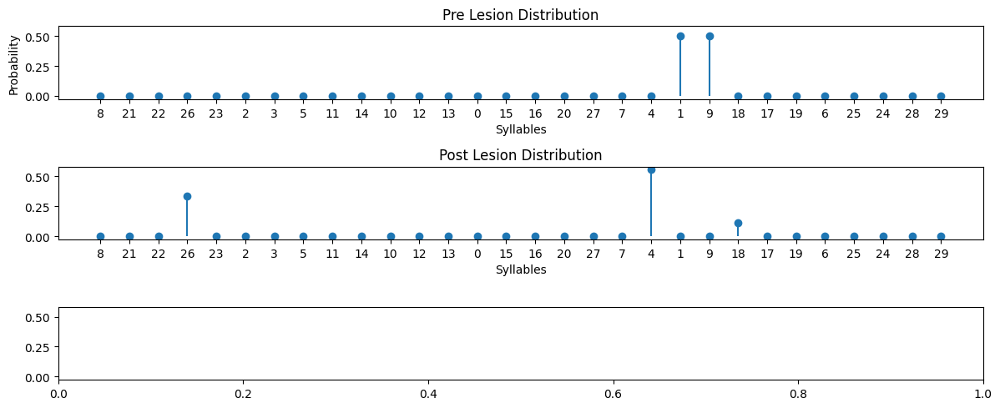

{"Earth Mover's Distance": 6.722222627360563,
 'Information Gain': -0.24372780987180165,
 'Kullback-Leibler Divergence': 20.029325698586636}
30 30


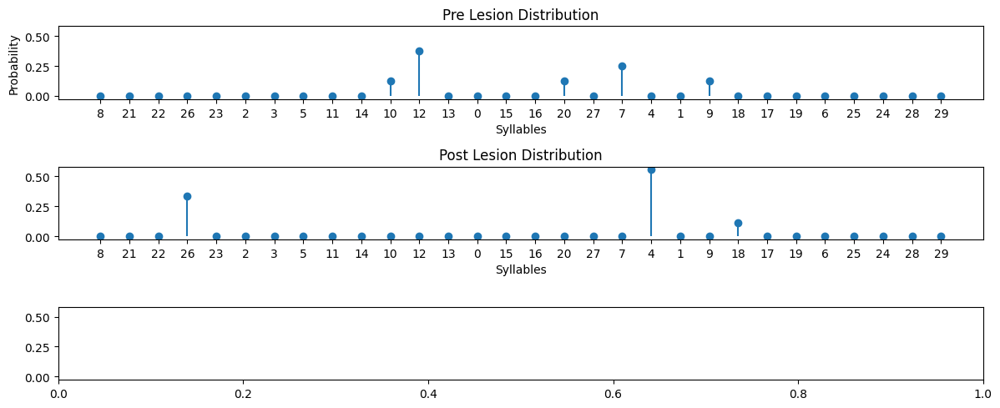

{"Earth Mover's Distance": 4.638890467341828,
 'Information Gain': 0.5572894766097922,
 'Kullback-Leibler Divergence': 19.228309636501578}
30 30


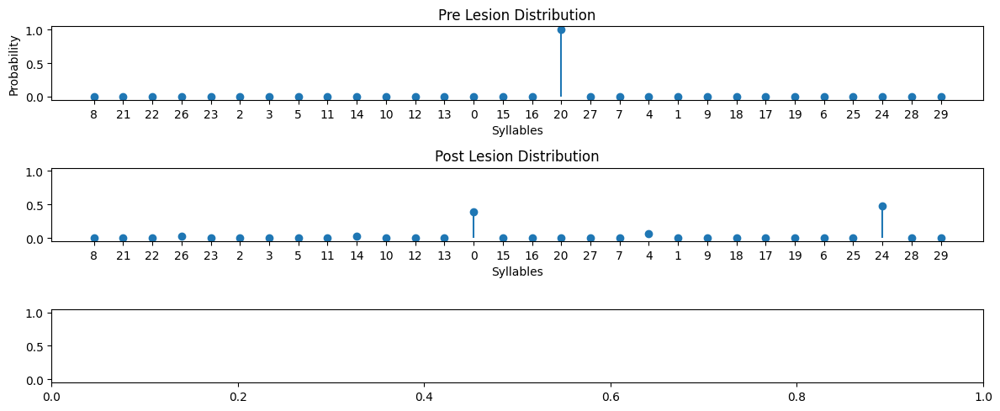

{"Earth Mover's Distance": 7.322591950574028,
 'Information Gain': -1.1169935176834267,
 'Kullback-Leibler Divergence': 20.86060476412497}
30 30


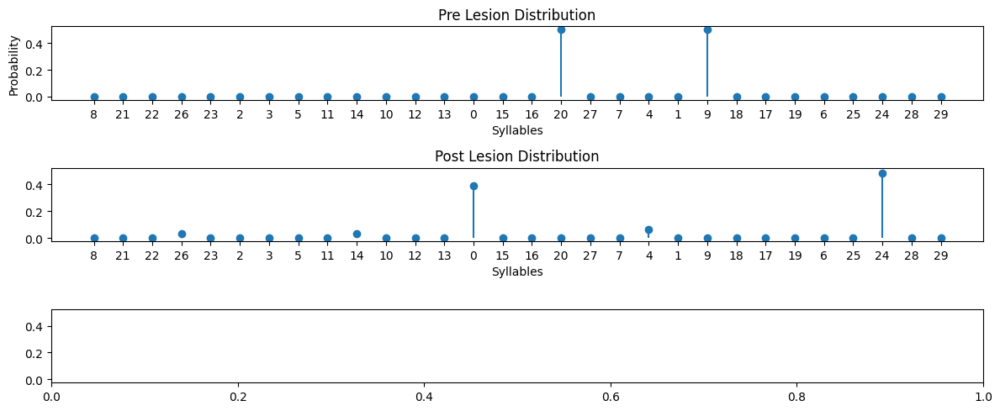

{"Earth Mover's Distance": 4.887098389596194,
 'Information Gain': -0.42386787644601154,
 'Kullback-Leibler Divergence': 20.16748303108782}
30 30


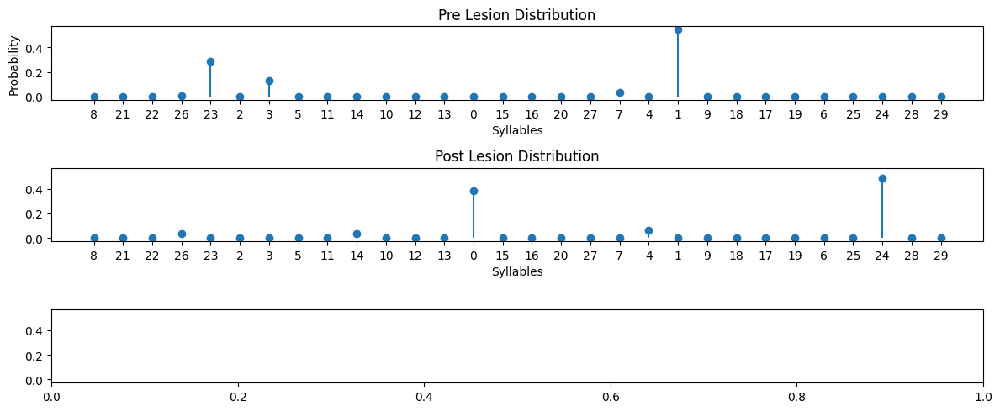

{"Earth Mover's Distance": 6.745344843253507,
 'Information Gain': -0.012627785740206177,
 'Kullback-Leibler Divergence': 19.614564109009198}
30 30


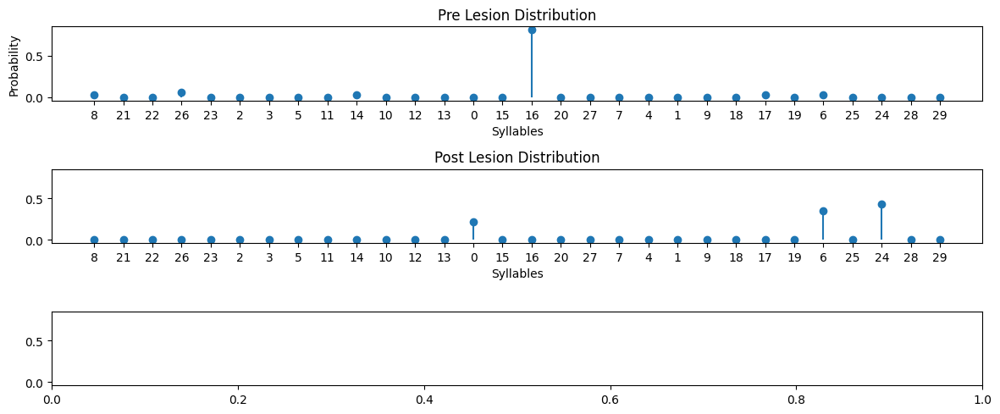

{"Earth Mover's Distance": 9.474185016958849,
 'Information Gain': -0.2859974466520838,
 'Kullback-Leibler Divergence': 19.1773686243152}
30 30


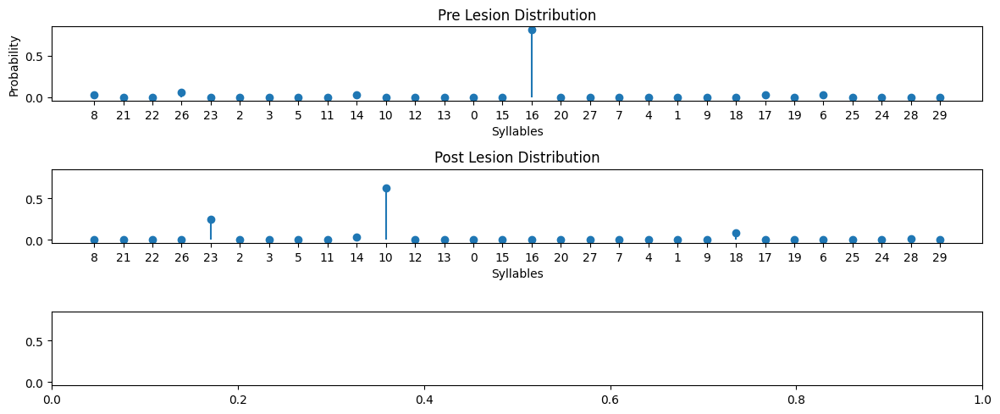

{"Earth Mover's Distance": 5.361168164860318,
 'Information Gain': -0.24906391946125317,
 'Kullback-Leibler Divergence': 20.196069881130683}
30 30


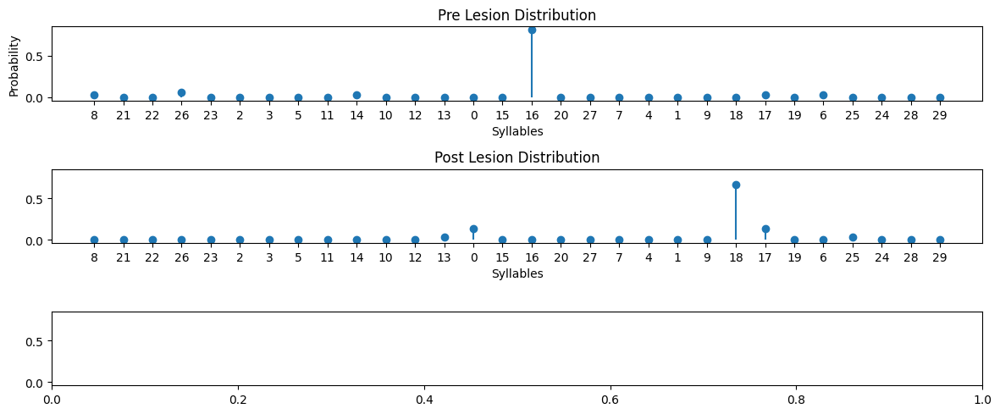

{"Earth Mover's Distance": 6.74652808679065,
 'Information Gain': -0.24253905202429604,
 'Kullback-Leibler Divergence': 19.640080884969226}
30 30


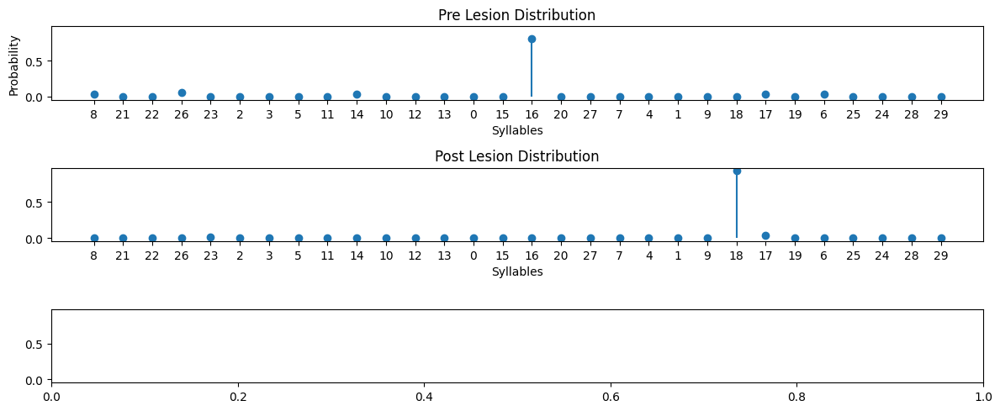

{"Earth Mover's Distance": 7.642190613389472,
 'Information Gain': 0.4562016967792966,
 'Kullback-Leibler Divergence': 22.41936090571004}
30 30


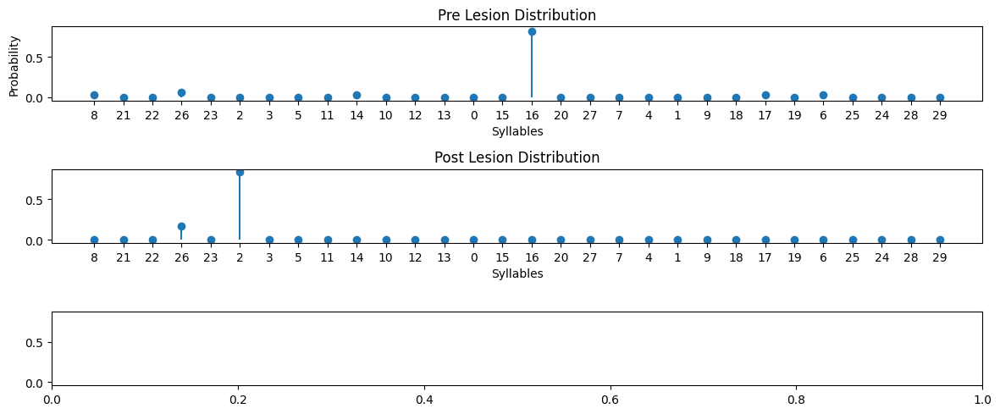

{"Earth Mover's Distance": 9.677084580385714,
 'Information Gain': 0.32464793843659806,
 'Kullback-Leibler Divergence': 17.354033728201717}
30 30


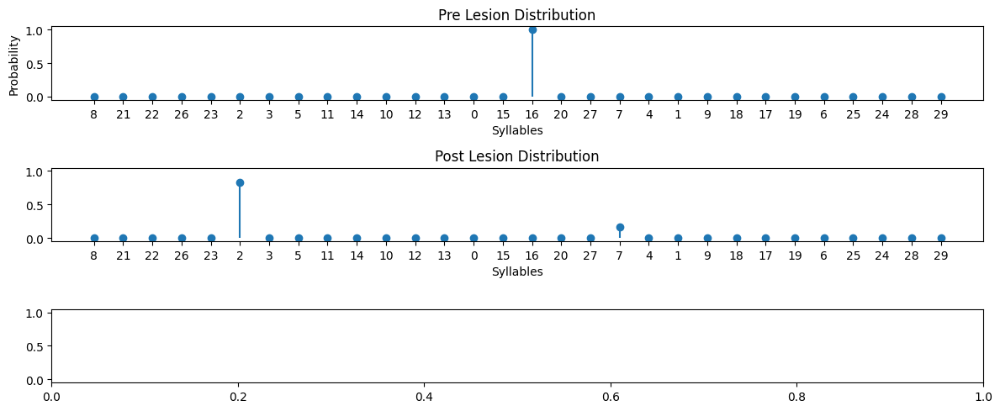

{"Earth Mover's Distance": 8.833333613450828,
 'Information Gain': -0.4505604572018012,
 'Kullback-Leibler Divergence': 19.21840764636294}
30 30


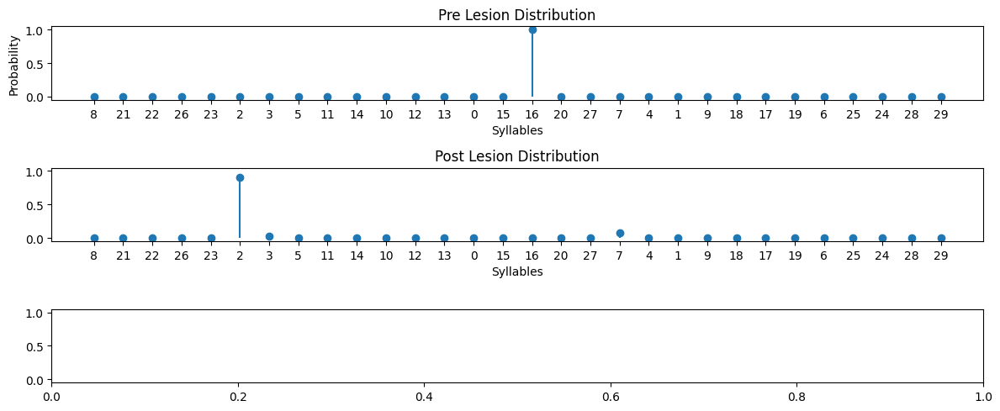

{"Earth Mover's Distance": 9.45000125625113,
 'Information Gain': -0.381313638625027,
 'Kullback-Leibler Divergence': 21.115527401572287}
30 30


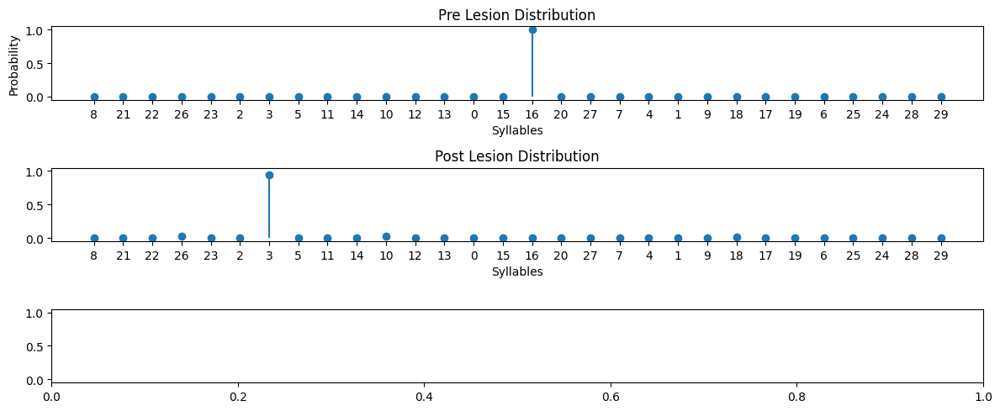

{"Earth Mover's Distance": 8.952942428803675,
 'Information Gain': -0.28576914452239993,
 'Kullback-Leibler Divergence': 21.86929908951081}
30 30


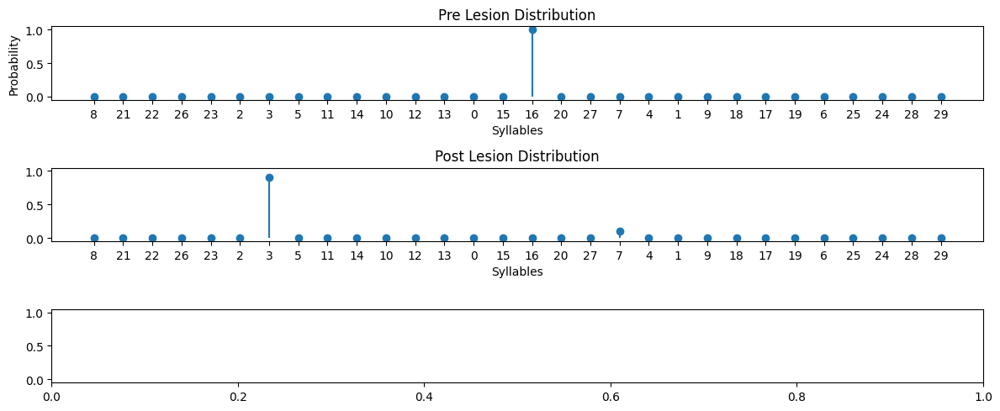

{"Earth Mover's Distance": 8.404763371866503,
 'Information Gain': -0.32333245871795063,
 'Kullback-Leibler Divergence': 22.95607709335148}
30 30


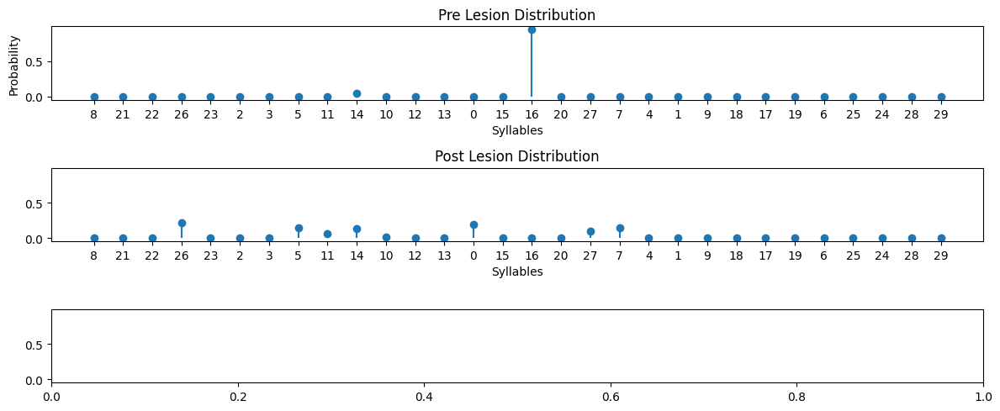

{"Earth Mover's Distance": 5.776790725866159,
 'Information Gain': -1.7619447873873961,
 'Kullback-Leibler Divergence': 6.77337030433564}
30 30


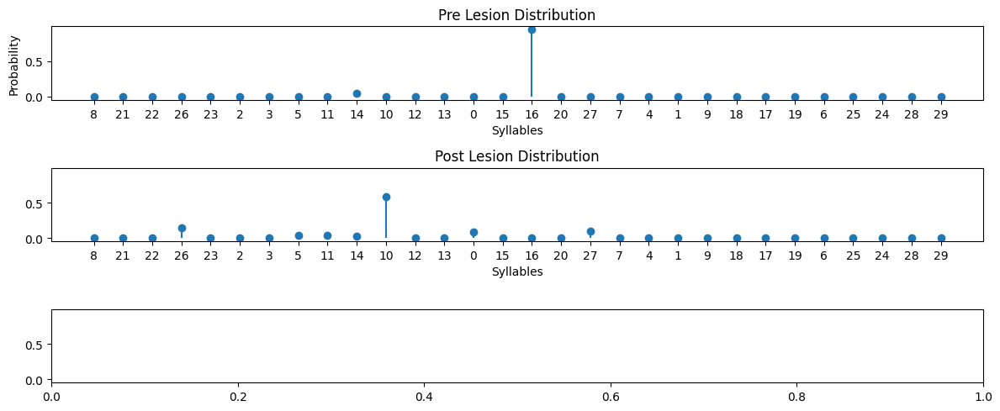

{"Earth Mover's Distance": 5.344211097012042,
 'Information Gain': -1.1530714084228133,
 'Kullback-Leibler Divergence': 20.215288279245556}
30 30


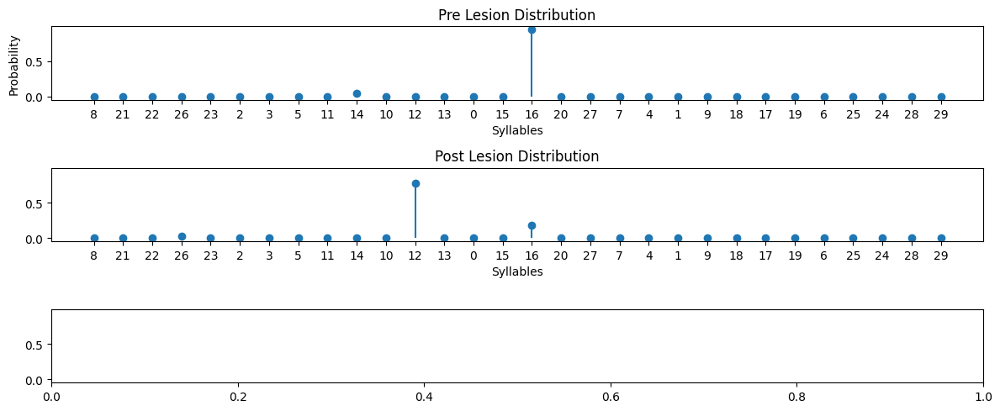

{"Earth Mover's Distance": 3.267464903174468,
 'Information Gain': -0.5328346459465845,
 'Kullback-Leibler Divergence': 1.7166925457935935}
30 30


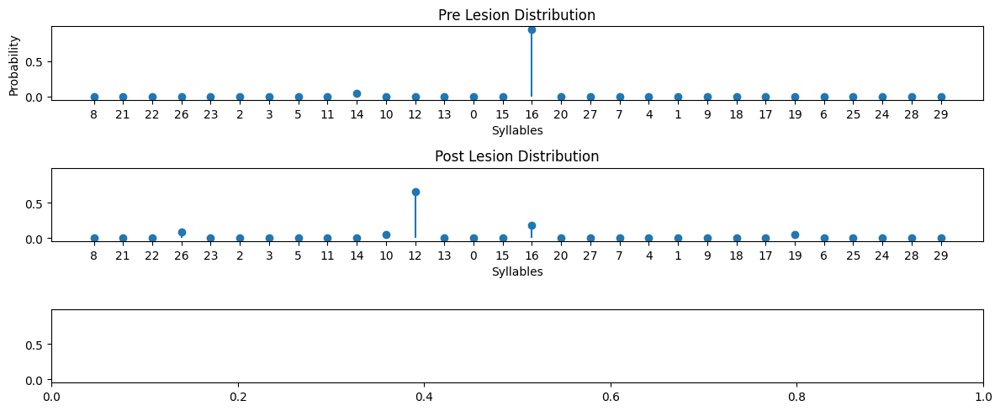

{"Earth Mover's Distance": 3.945080651092086,
 'Information Gain': -0.86181274923458,
 'Kullback-Leibler Divergence': 2.5696439528365387}
30 30


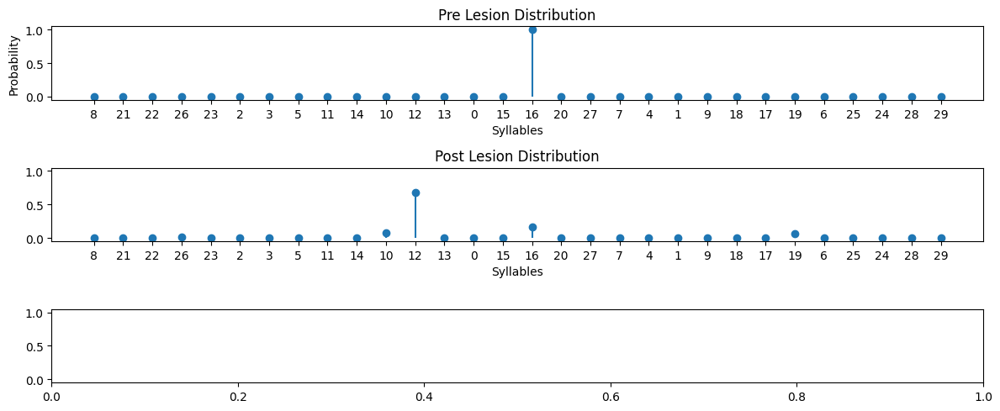

{"Earth Mover's Distance": 3.9130563736500634,
 'Information Gain': -1.0180125904117736,
 'Kullback-Leibler Divergence': 1.8362103926118032}
30 30


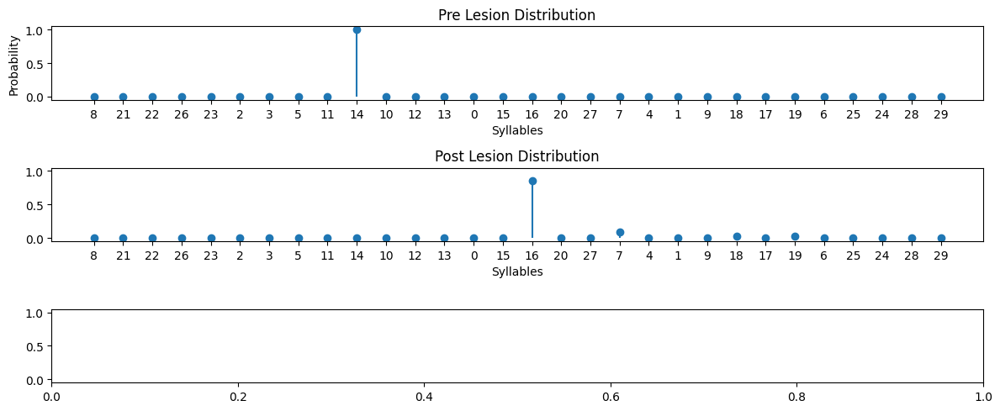

{"Earth Mover's Distance": 6.65118854779383,
 'Information Gain': -0.5251452070023888,
 'Kullback-Leibler Divergence': 21.187818694070906}
30 30


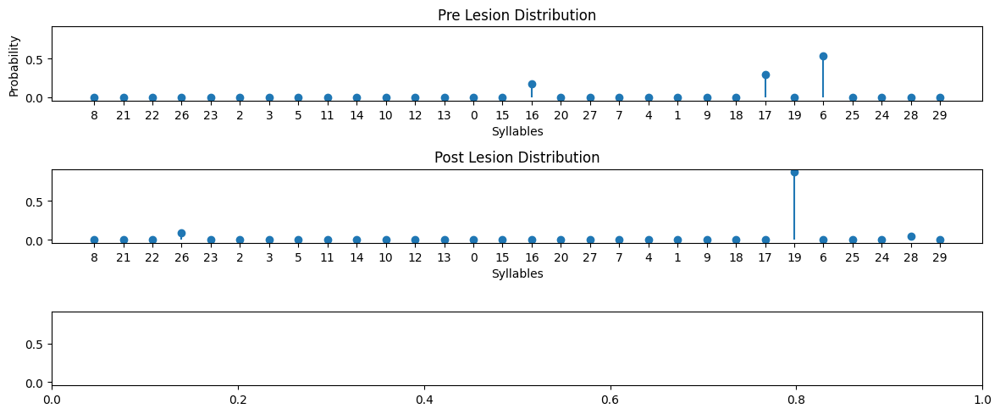

{"Earth Mover's Distance": 2.7016722229628196,
 'Information Gain': 0.5232531081857966,
 'Kullback-Leibler Divergence': 19.568655953771437}
30 30


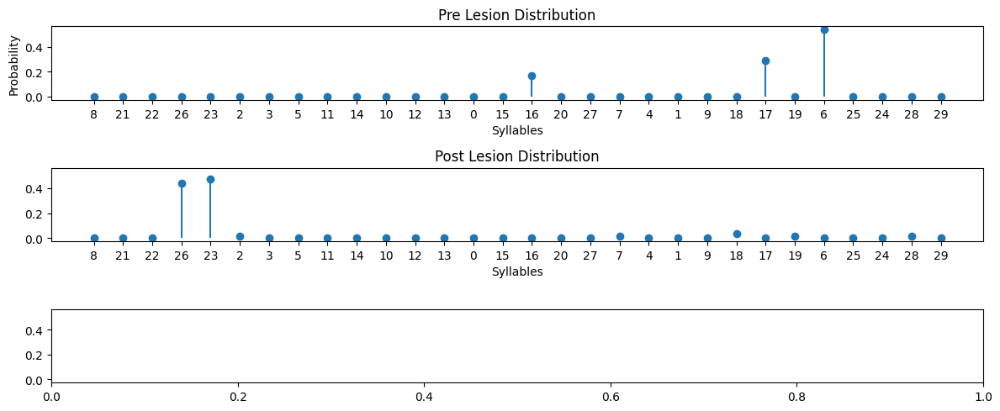

{"Earth Mover's Distance": 17.950349554371094,
 'Information Gain': -0.038882853719690025,
 'Kullback-Leibler Divergence': 20.910498462064737}
30 30


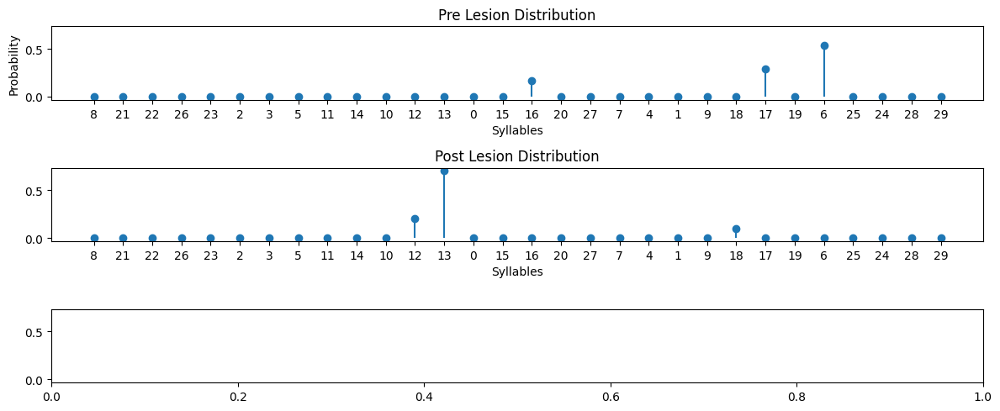

{"Earth Mover's Distance": 9.923077778794966,
 'Information Gain': 0.19166973322612335,
 'Kullback-Leibler Divergence': 18.735746877559336}
30 30


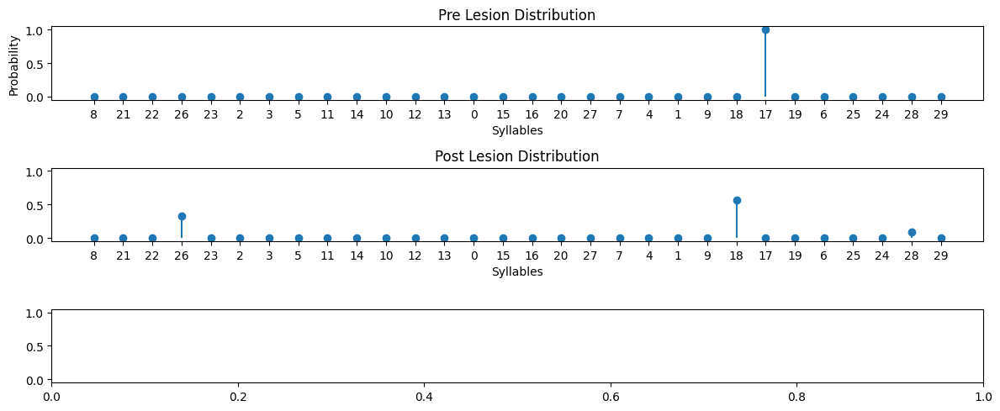

{"Earth Mover's Distance": 7.714281609289285,
 'Information Gain': -0.909897012074369,
 'Kullback-Leibler Divergence': 20.47114200498909}
30 30


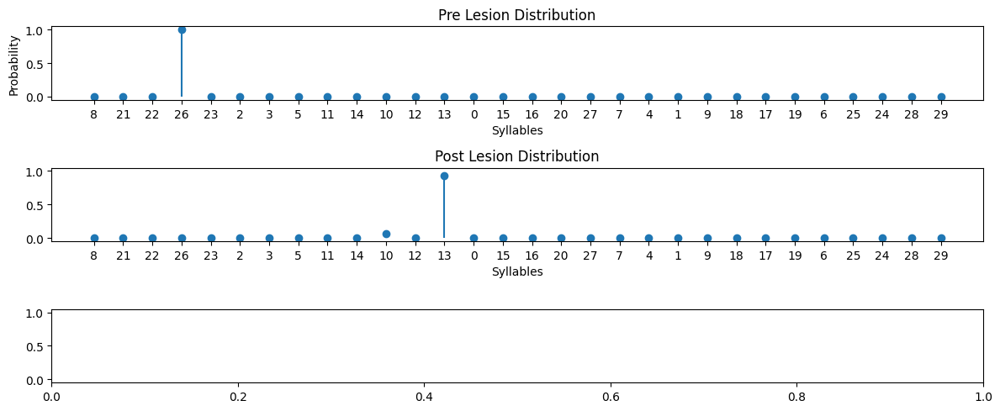

{"Earth Mover's Distance": 8.86667451211568,
 'Information Gain': -0.24492090595668975,
 'Kullback-Leibler Divergence': 20.134690871892552}
30 30


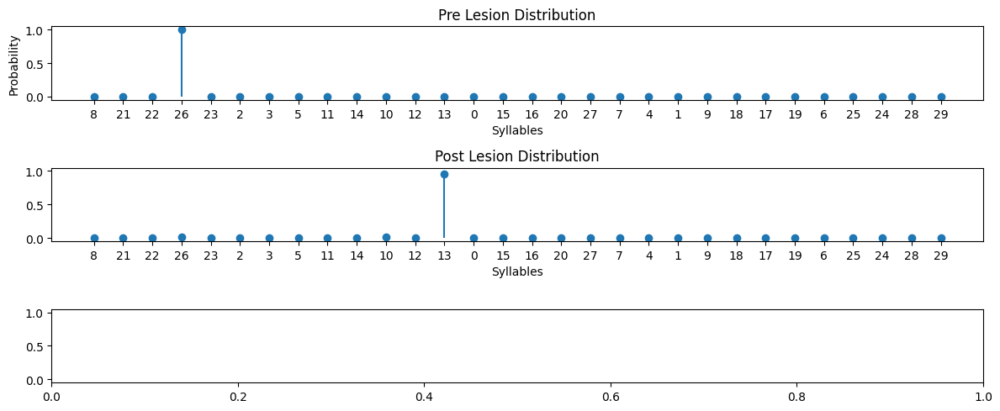

{"Earth Mover's Distance": 8.75183340890463,
 'Information Gain': -0.23804795897453157,
 'Kullback-Leibler Divergence': 4.226831965768529}
30 30


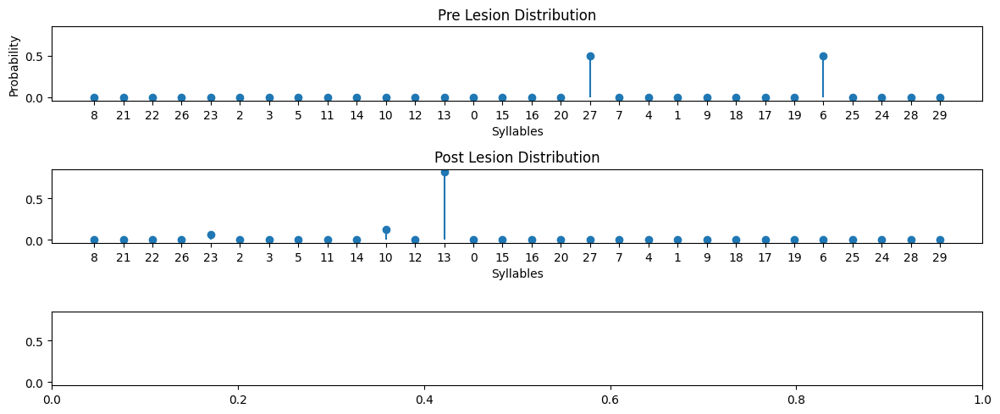

{"Earth Mover's Distance": 9.749995657004062,
 'Information Gain': 0.09123614396608526,
 'Kullback-Leibler Divergence': 19.506077652372646}
30 30


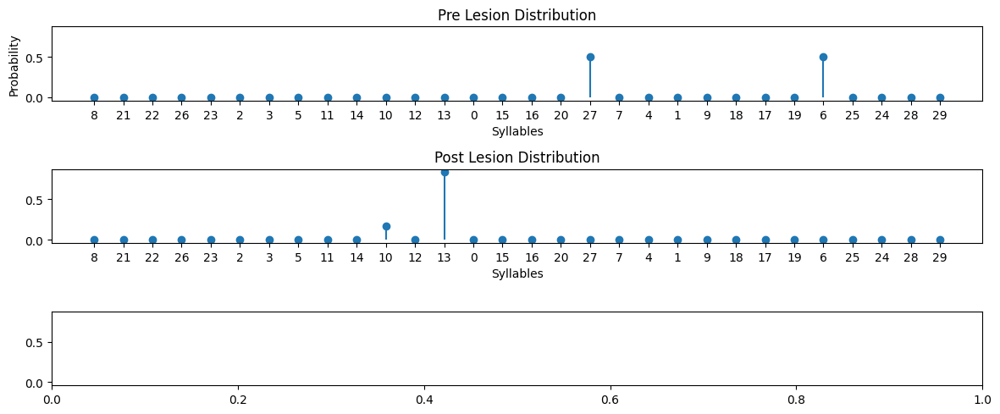

{"Earth Mover's Distance": 9.333331570345832,
 'Information Gain': 0.2425973540043262,
 'Kullback-Leibler Divergence': 18.525249018100535}
30 30


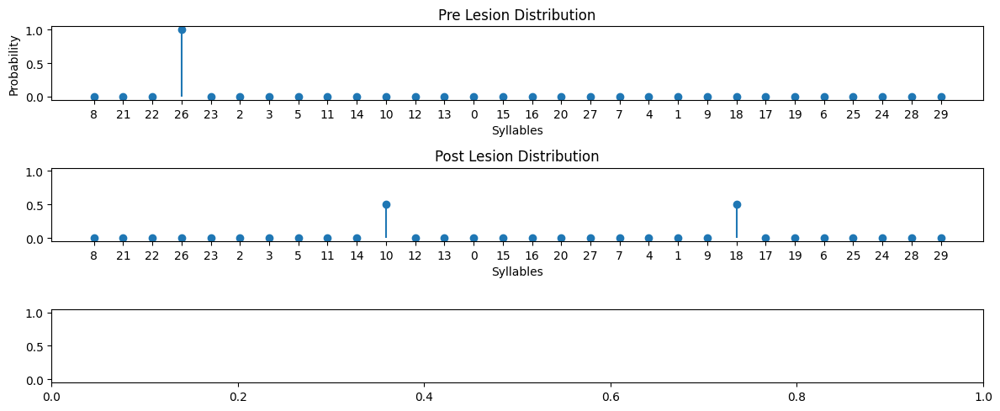

{"Earth Mover's Distance": 13.000019766917474,
 'Information Gain': -0.6931254001985515,
 'Kullback-Leibler Divergence': 18.119768377822442}
30 30


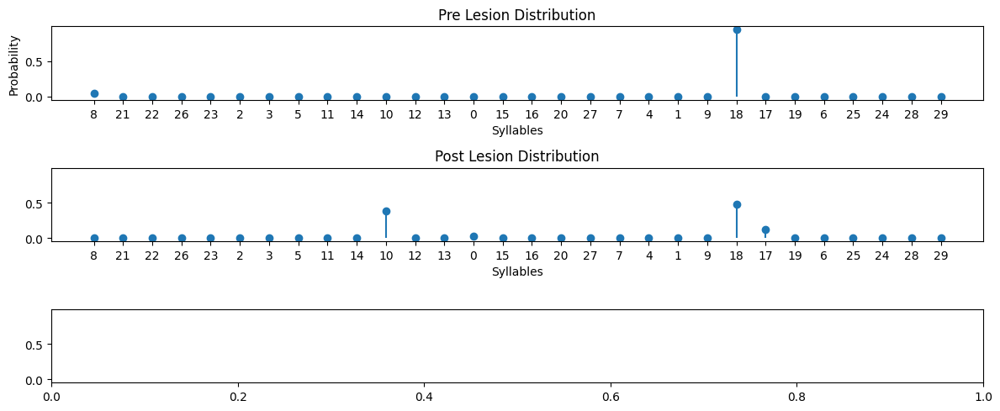

{"Earth Mover's Distance": 4.799498905916577,
 'Information Gain': -0.8571130235277495,
 'Kullback-Leibler Divergence': 1.610607405093241}
30 30


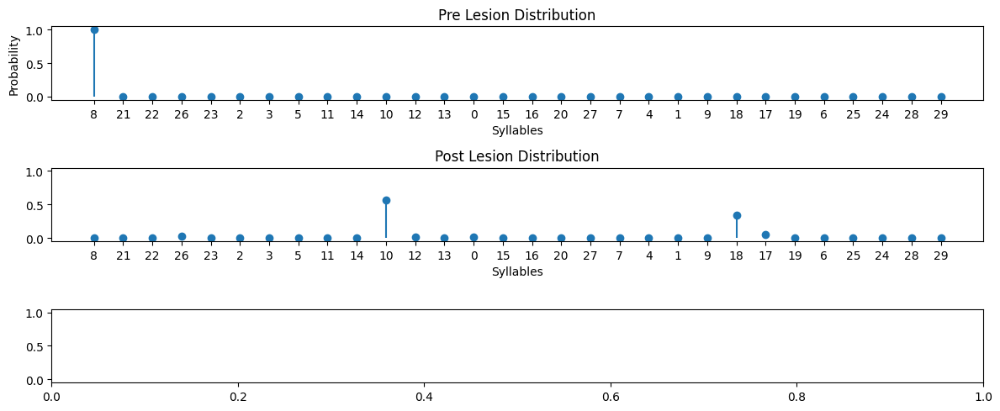

{"Earth Mover's Distance": 14.62502595113776,
 'Information Gain': -1.024993874067311,
 'Kullback-Leibler Divergence': 22.278646504925963}
30 30


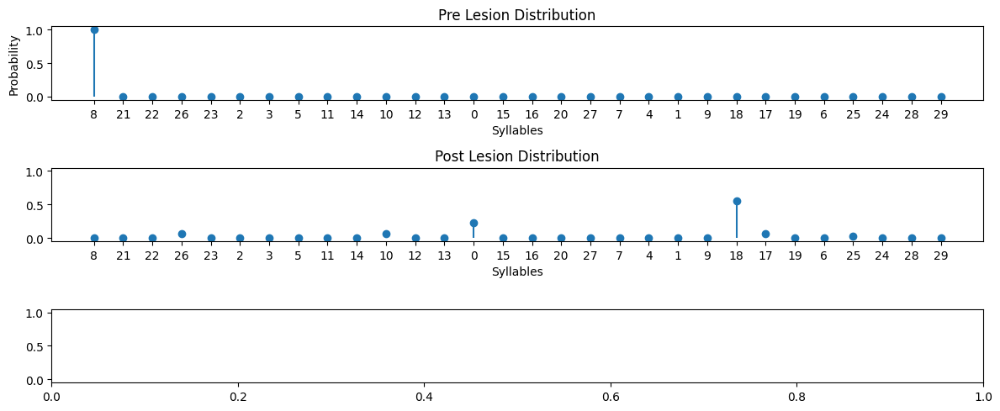

{"Earth Mover's Distance": 18.161315966565635,
 'Information Gain': -1.3067046635362505,
 'Kullback-Leibler Divergence': 20.860603733408425}
30 30


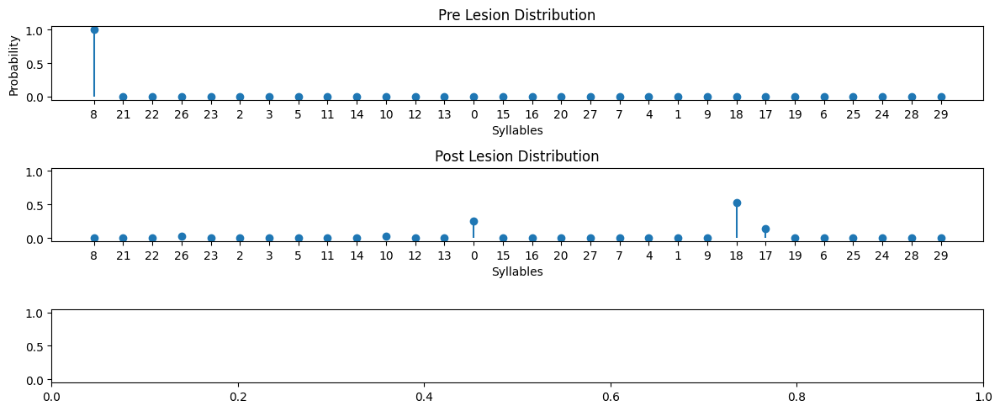

{"Earth Mover's Distance": 18.77476684801369,
 'Information Gain': -1.2919078716844767,
 'Kullback-Leibler Divergence': 5.580662202694182}
30 30


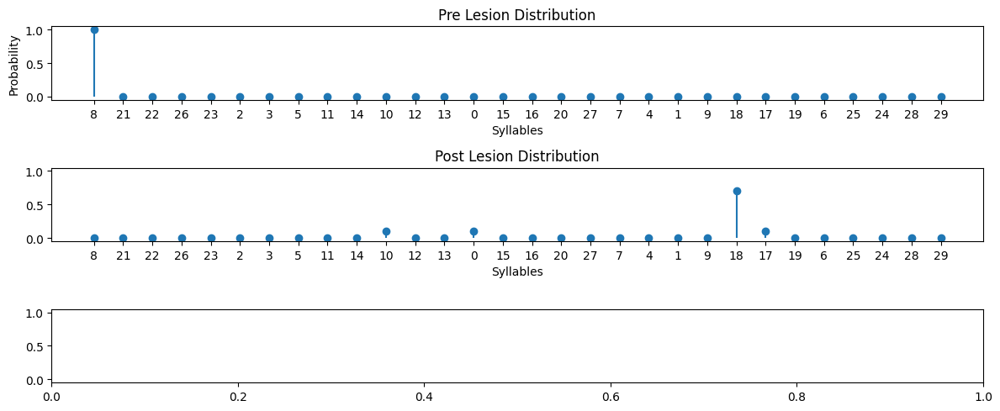

{"Earth Mover's Distance": 20.00002563047449,
 'Information Gain': -0.9404197299051194,
 'Kullback-Leibler Divergence': 20.82781589296566}
30 30


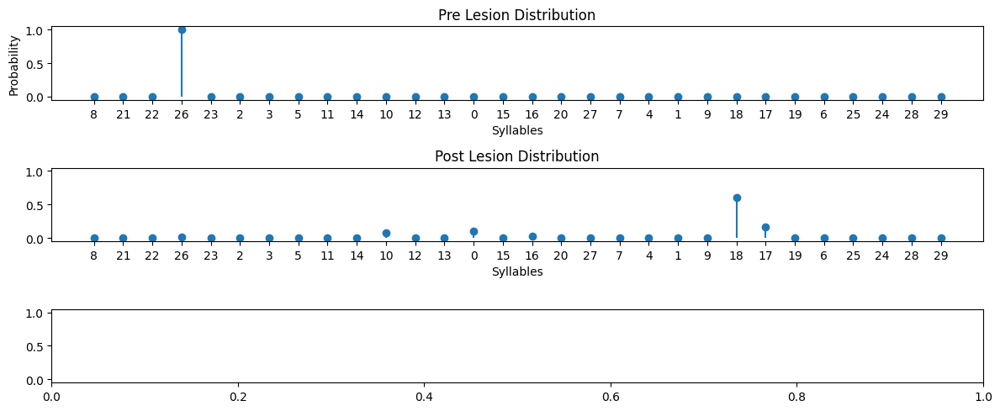

{"Earth Mover's Distance": 16.72197430813325,
 'Information Gain': -1.2309273595314947,
 'Kullback-Leibler Divergence': 4.308558914388915}
30 30


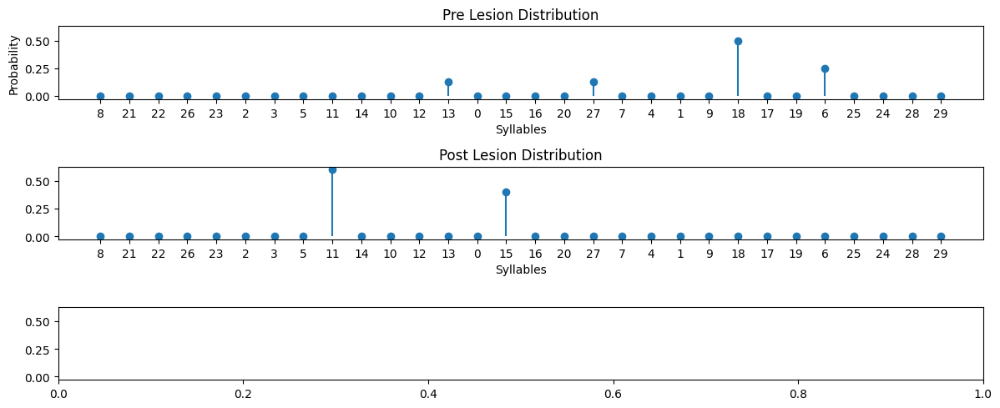

{"Earth Mover's Distance": 10.4749998193921,
 'Information Gain': 0.5399963581182802,
 'Kullback-Leibler Divergence': 17.82307835789002}
30 30


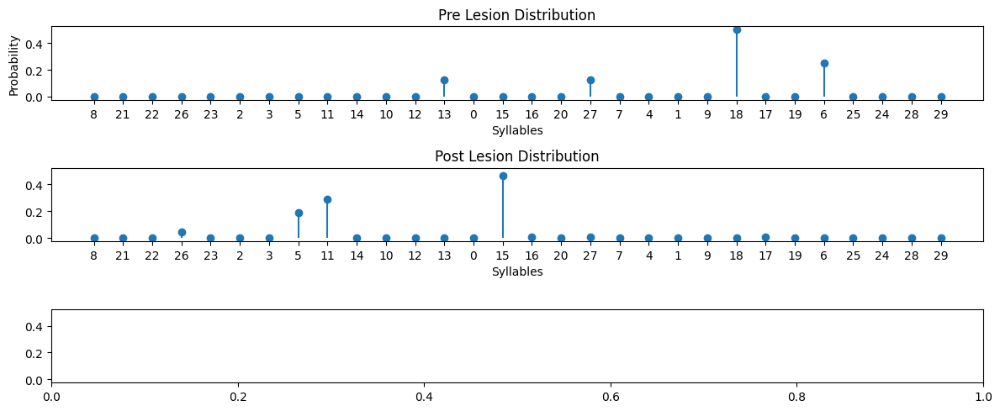

{"Earth Mover's Distance": 10.3634603450084,
 'Information Gain': -0.014969068015514786,
 'Kullback-Leibler Divergence': 19.59599022920803}
30 30


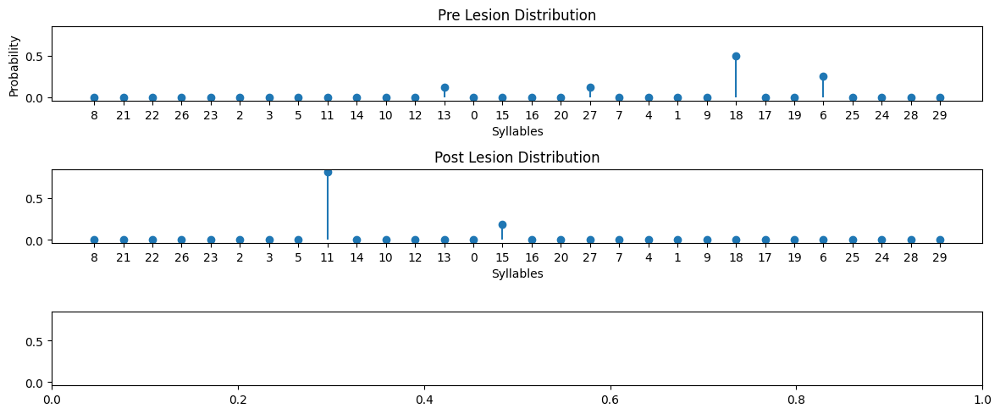

{"Earth Mover's Distance": 11.816643363301274,
 'Information Gain': 0.6733596504435008,
 'Kullback-Leibler Divergence': 22.14588504492731}
30 30


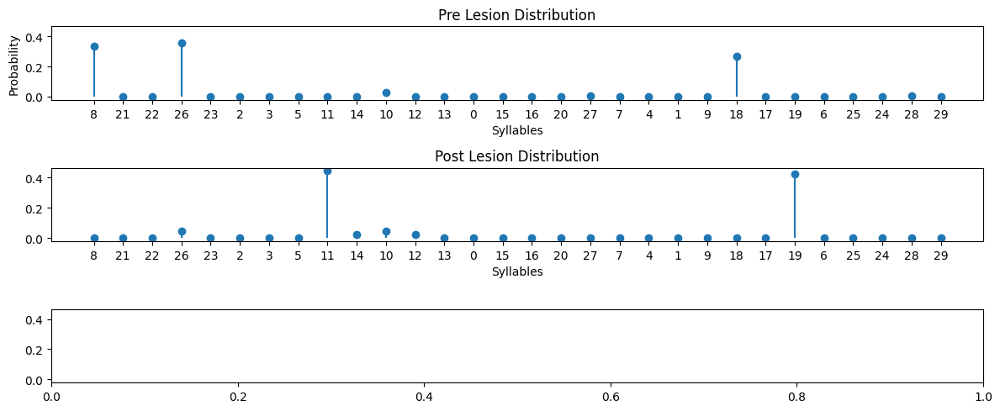

{"Earth Mover's Distance": 7.255982841079517,
 'Information Gain': 0.08092155240074916,
 'Kullback-Leibler Divergence': 12.935398502814623}
30 30


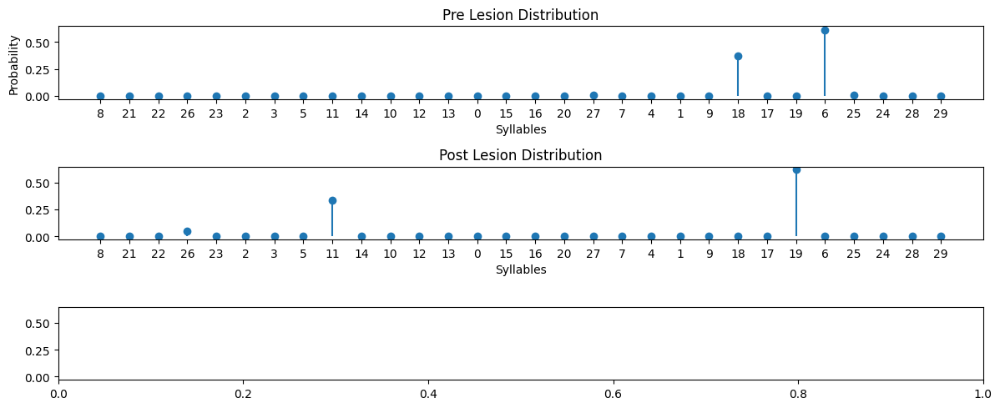

{"Earth Mover's Distance": 6.118301906767821,
 'Information Gain': -0.03247350359554957,
 'Kullback-Leibler Divergence': 20.864379272237148}
30 30


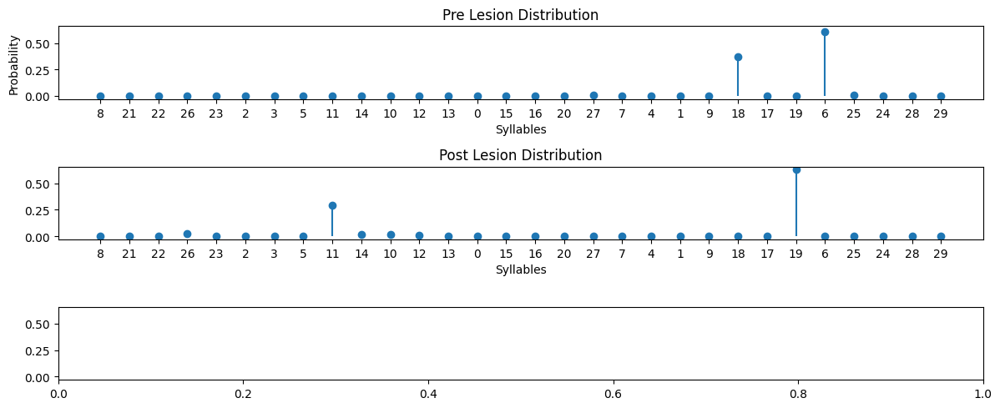

{"Earth Mover's Distance": 5.761913907290719,
 'Information Gain': -0.19014110080642133,
 'Kullback-Leibler Divergence': 16.06925293245269}
30 30


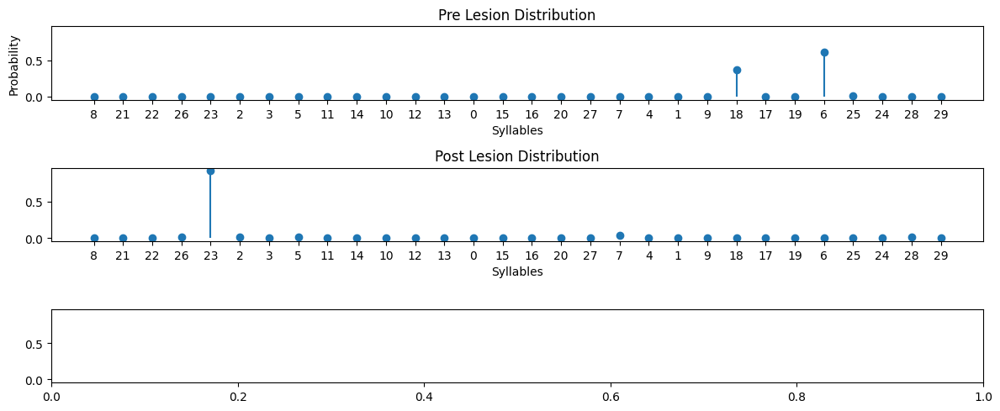

{"Earth Mover's Distance": 18.98759247715035,
 'Information Gain': 0.37825973733347684,
 'Kullback-Leibler Divergence': 21.926406060607828}
30 30


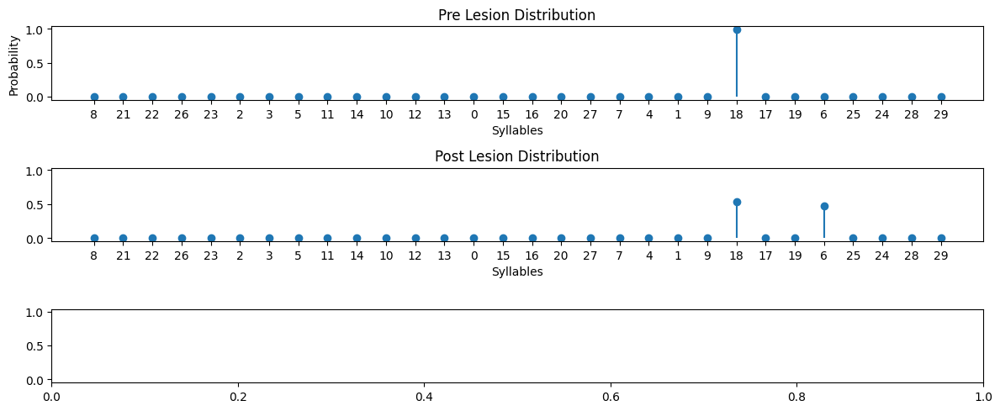

{"Earth Mover's Distance": 1.6017542726502167,
 'Information Gain': -0.6064139855375739,
 'Kullback-Leibler Divergence': 0.8098784415140463}
30 30


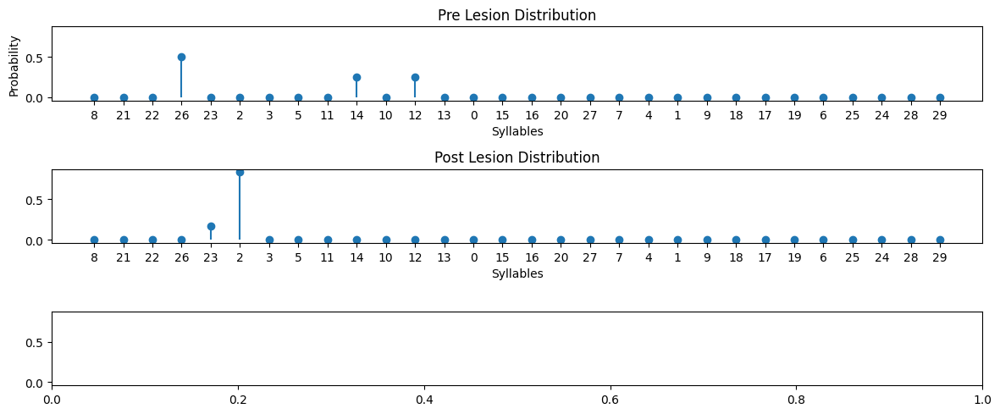

{"Earth Mover's Distance": 3.333336782377844,
 'Information Gain': 0.5891638924238818,
 'Kullback-Leibler Divergence': 18.17868299034101}
30 30


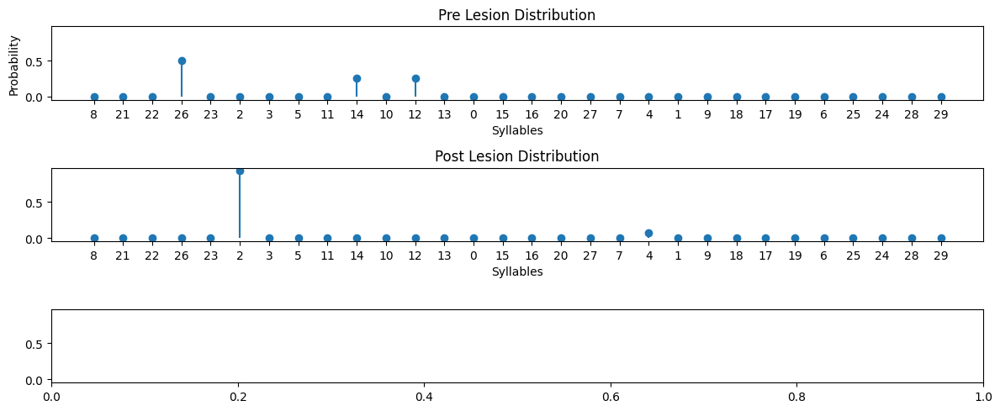

{"Earth Mover's Distance": 3.642861526056227,
 'Information Gain': 0.7824078294941392,
 'Kullback-Leibler Divergence': 19.025980760143437}
30 30


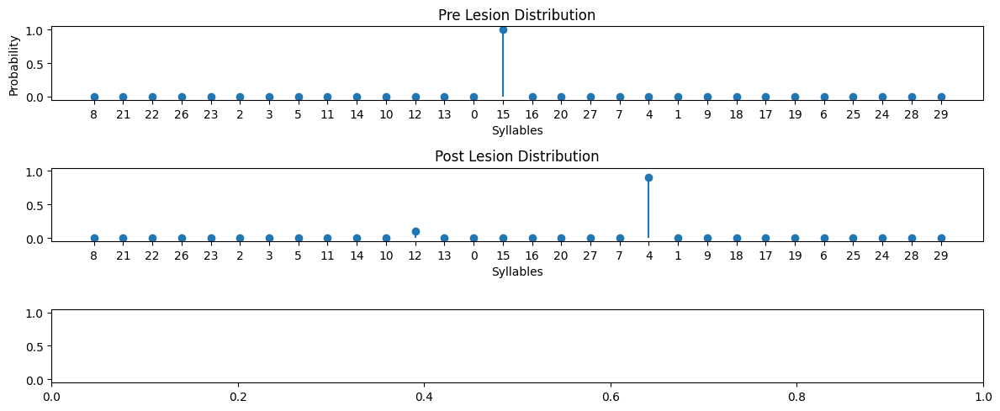

{"Earth Mover's Distance": 4.803300196836272,
 'Information Gain': -0.3214374877678679,
 'Kullback-Leibler Divergence': 21.5374943445453}
30 30


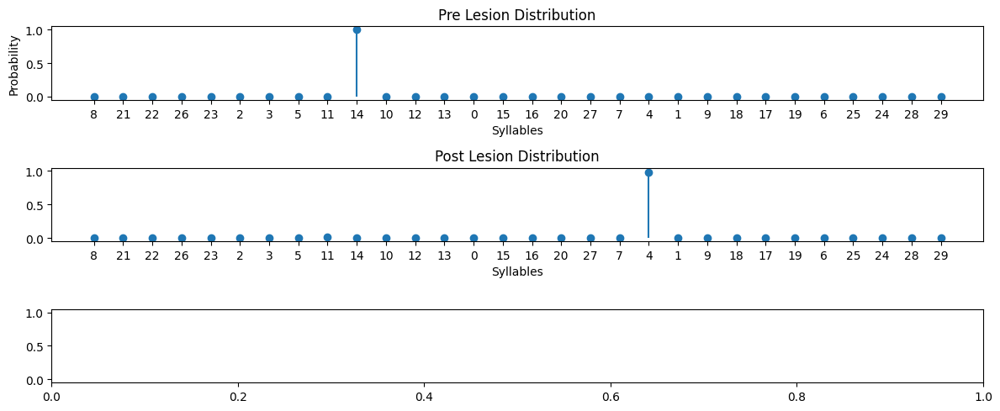

{"Earth Mover's Distance": 9.898629976329985,
 'Information Gain': -0.08170202786529938,
 'Kullback-Leibler Divergence': 22.806532280103607}
30 30


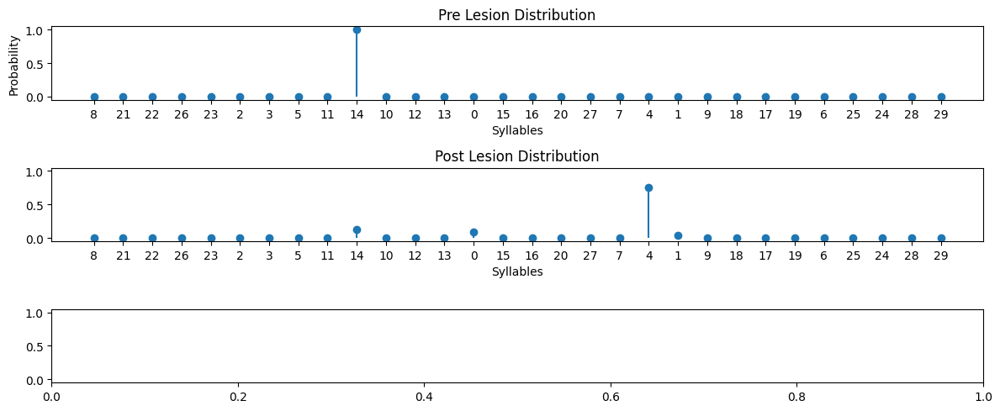

{"Earth Mover's Distance": 8.291679167784816,
 'Information Gain': -0.8151718861587474,
 'Kullback-Leibler Divergence': 2.0794401110154324}
30 30


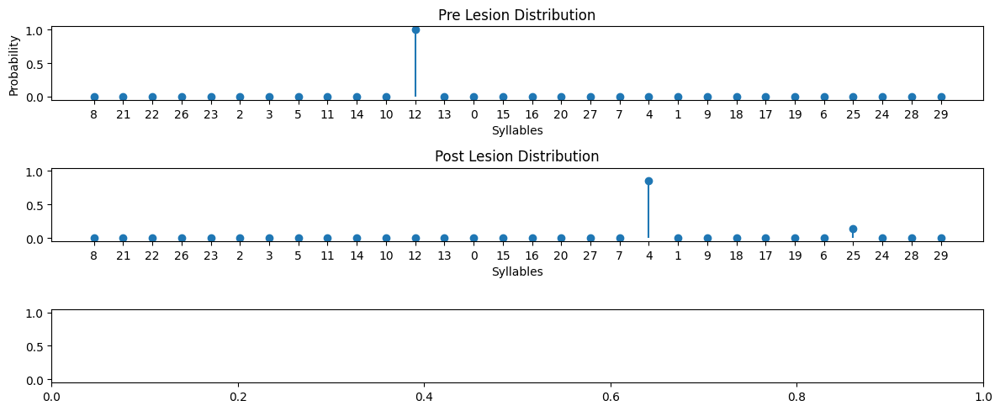

{"Earth Mover's Distance": 9.000024254333566,
 'Information Gain': -0.41008972979907393,
 'Kullback-Leibler Divergence': 19.372530956432986}
30 30


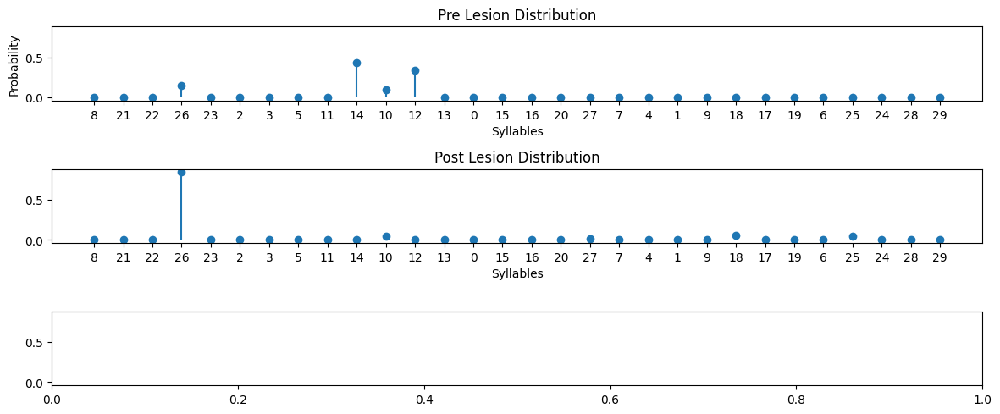

{"Earth Mover's Distance": 6.01811292755332,
 'Information Gain': 0.5781275510166067,
 'Kullback-Leibler Divergence': 16.91953856329511}
30 30


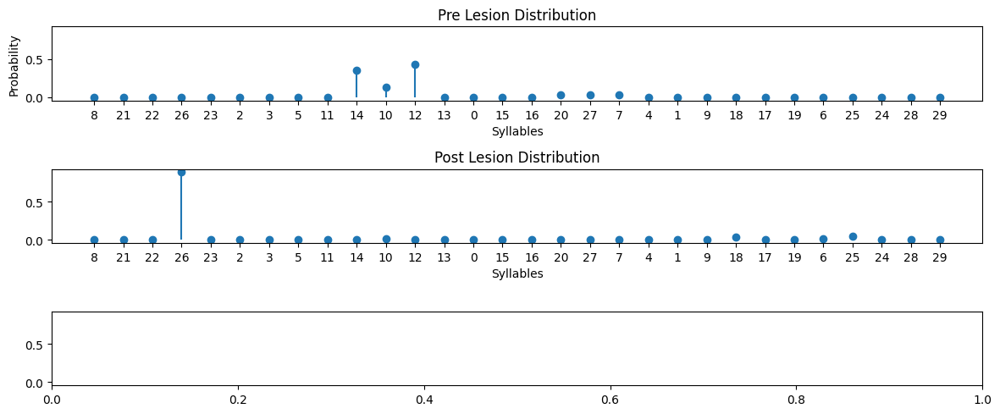

{"Earth Mover's Distance": 7.107255096328291,
 'Information Gain': 0.7708499454794294,
 'Kullback-Leibler Divergence': 18.876990151516946}
30 30


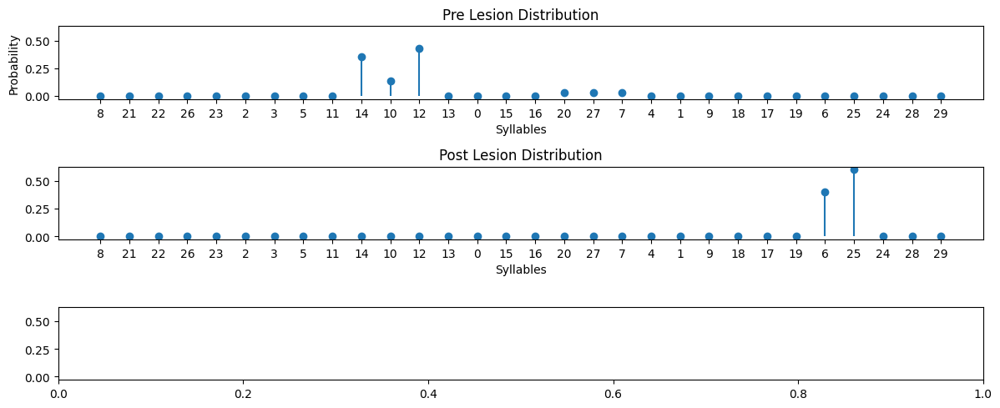

{"Earth Mover's Distance": 14.951351636560988,
 'Information Gain': 0.6202591319068107,
 'Kullback-Leibler Divergence': 19.534577510745994}
30 30


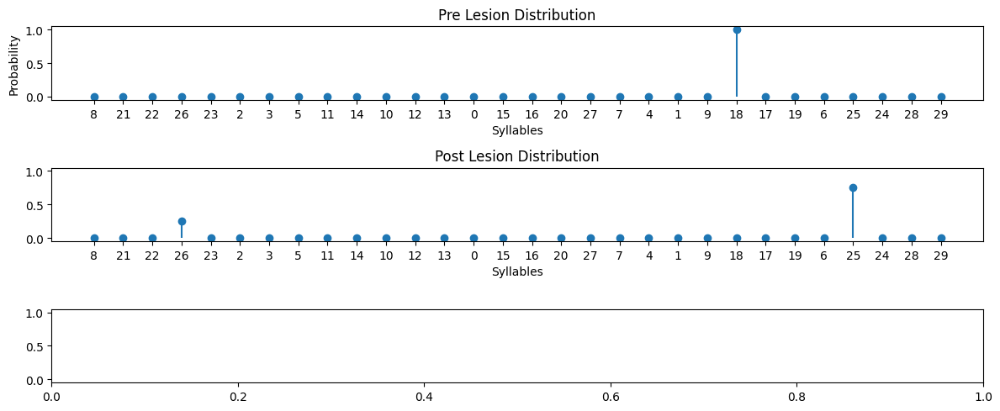

{"Earth Mover's Distance": 7.7499985713222515,
 'Information Gain': -0.562310038473703,
 'Kullback-Leibler Divergence': 18.812915294180808}
30 30


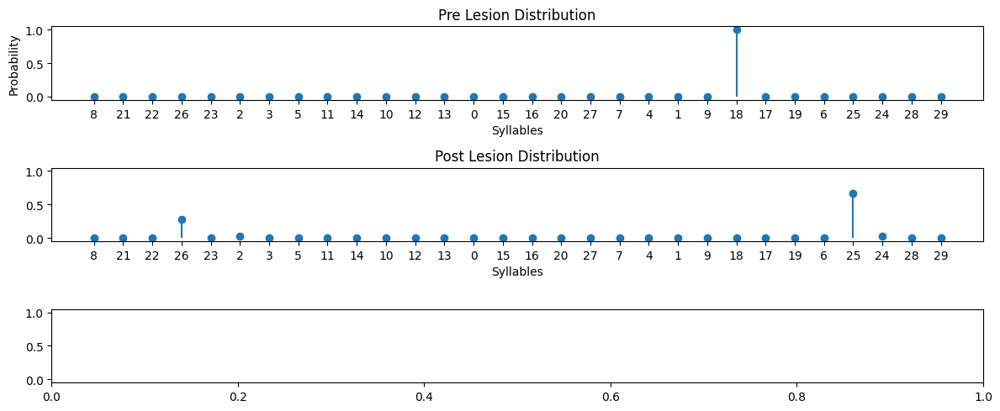

{"Earth Mover's Distance": 8.58974198525613,
 'Information Gain': -0.8151394877047382,
 'Kullback-Leibler Divergence': 21.090180189535744}
30 30


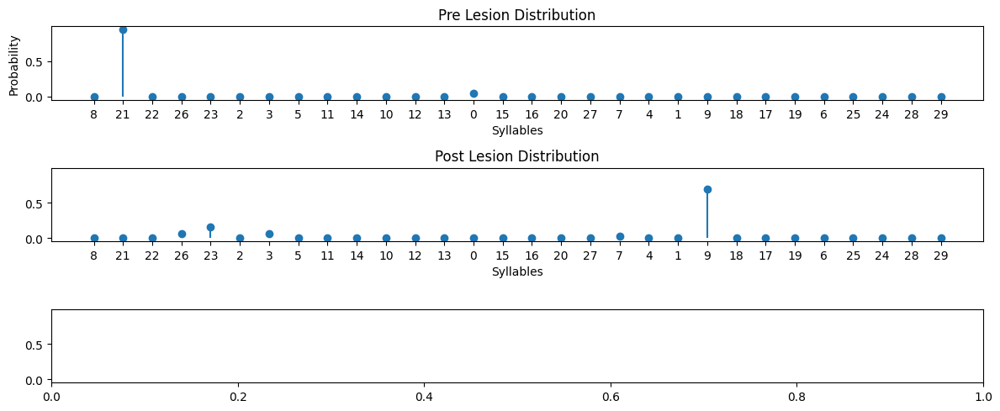

{"Earth Mover's Distance": 14.564074324413347,
 'Information Gain': -0.7720872356515569,
 'Kullback-Leibler Divergence': 21.04909888489653}
30 30


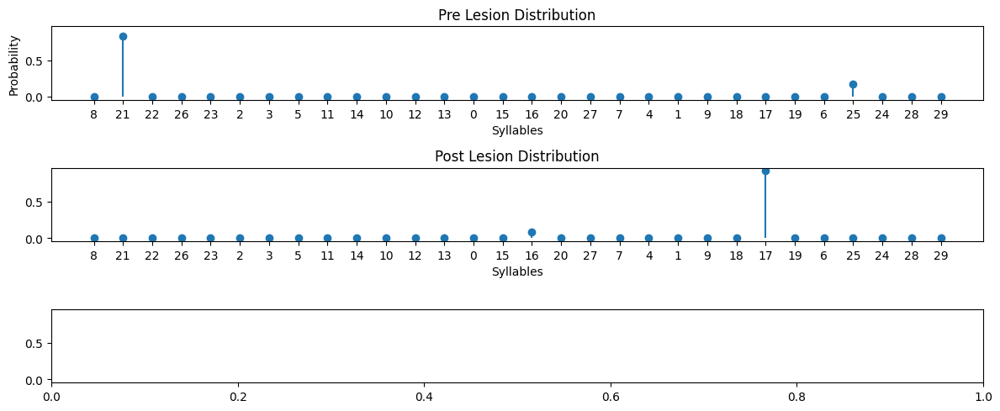

{"Earth Mover's Distance": 18.166668898415416,
 'Information Gain': 0.1637289081974137,
 'Kullback-Leibler Divergence': 19.460991668894106}
30 30


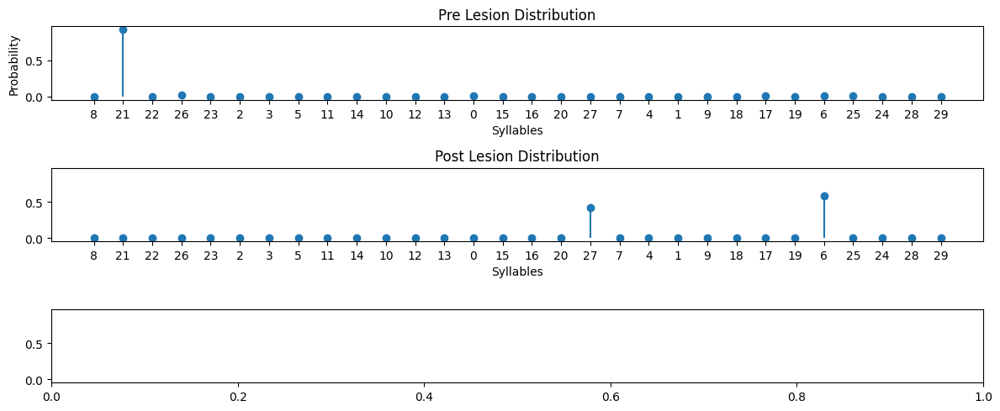

{"Earth Mover's Distance": 19.604166657455657,
 'Information Gain': -0.29575559246031347,
 'Kullback-Leibler Divergence': 20.370842637338324}
30 30


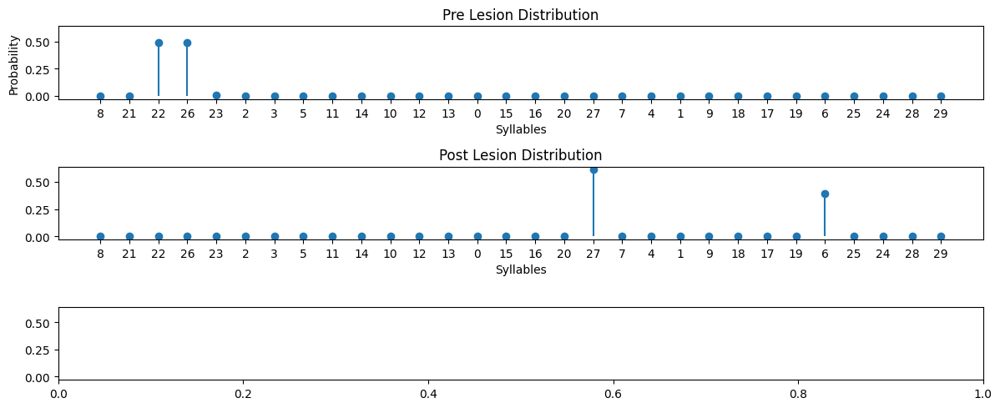

{"Earth Mover's Distance": 17.51630566550879,
 'Information Gain': 0.1187315909928639,
 'Kullback-Leibler Divergence': 19.53004235597322}
30 30


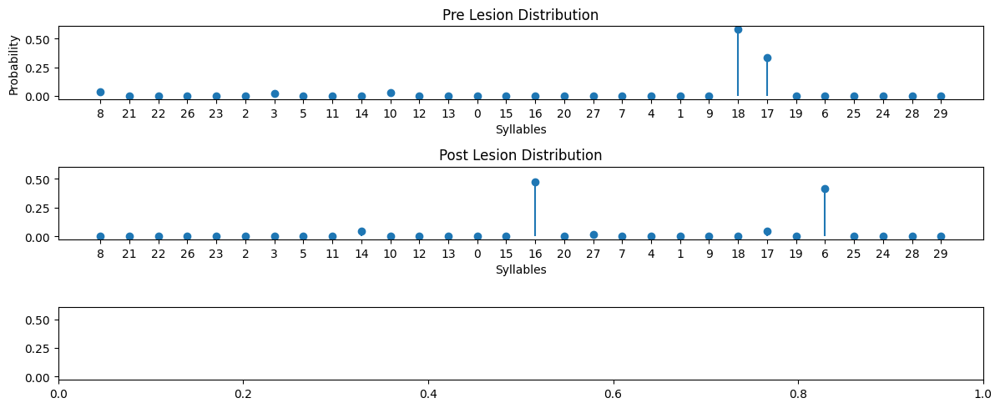

{"Earth Mover's Distance": 4.649571515864928,
 'Information Gain': -0.11353369268900138,
 'Kullback-Leibler Divergence': 16.237230334056566}
30 30


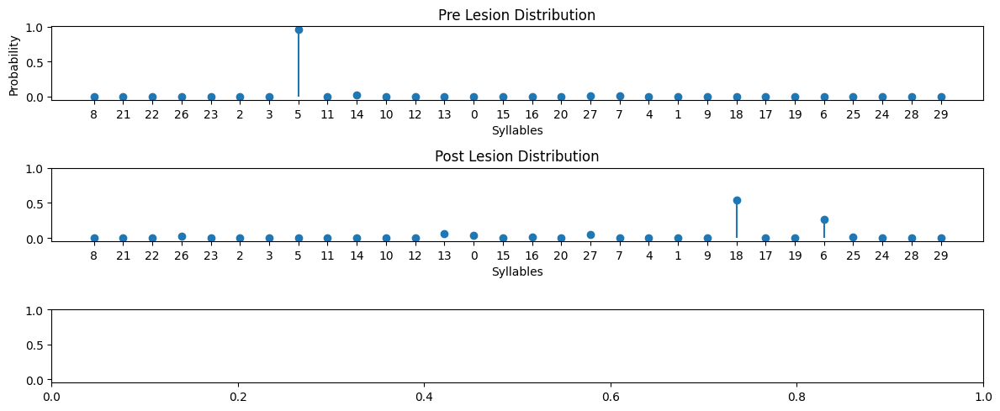

{"Earth Mover's Distance": 14.120396880171777,
 'Information Gain': -1.0805006013797815,
 'Kullback-Leibler Divergence': 22.306835190847636}
30 30


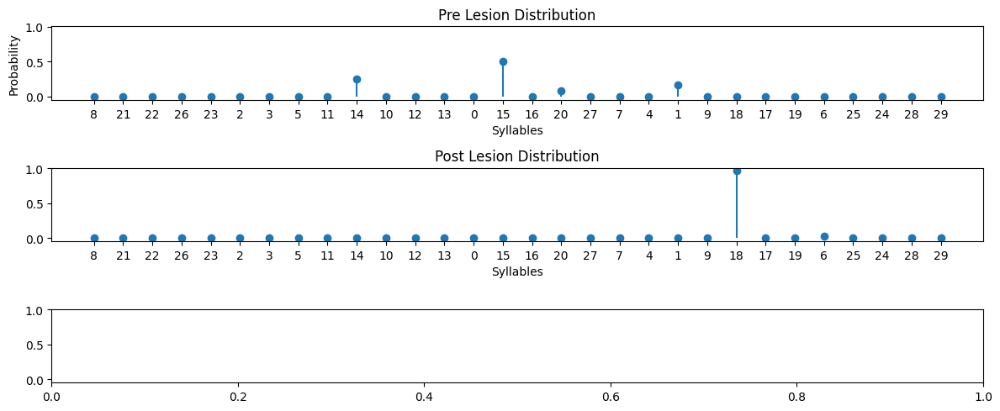

{"Earth Mover's Distance": 8.019928393187724,
 'Information Gain': 0.9632073872122418,
 'Kullback-Leibler Divergence': 22.541348718233444}
30 30


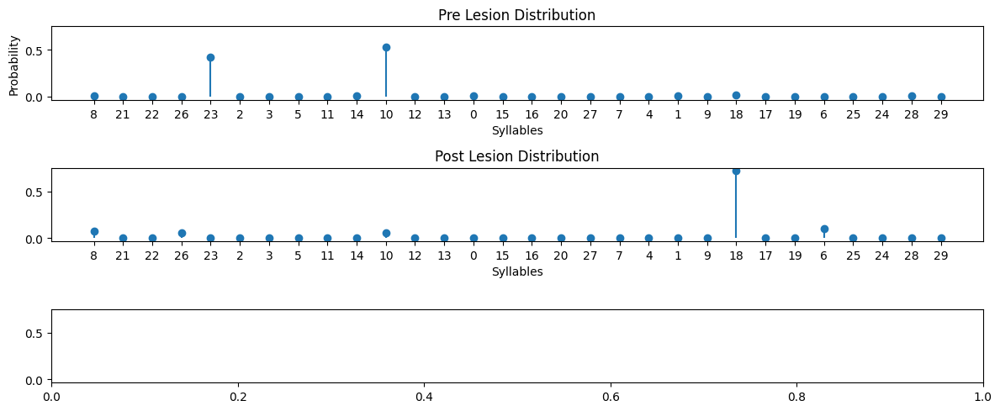

{"Earth Mover's Distance": 12.022278191742675,
 'Information Gain': -0.07759966217462622,
 'Kullback-Leibler Divergence': 10.048240861252857}
30 30


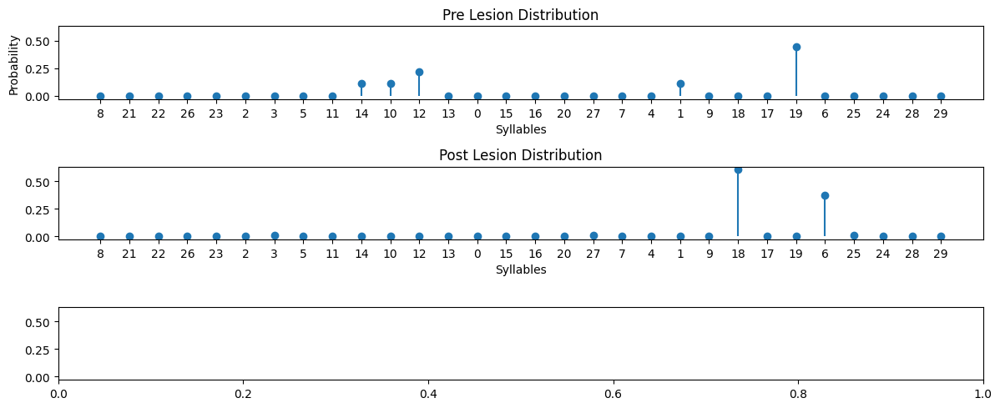

{"Earth Mover's Distance": 5.833335268589383,
 'Information Gain': 0.6314587067251516,
 'Kullback-Leibler Divergence': 20.753177173170776}
30 30


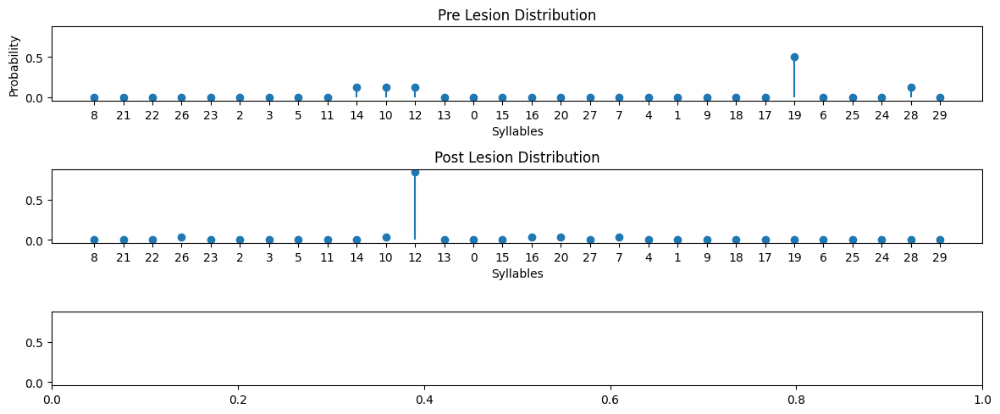

{"Earth Mover's Distance": 8.580643364949857,
 'Information Gain': 0.6849070330313773,
 'Kullback-Leibler Divergence': 14.71041643206452}
30 30


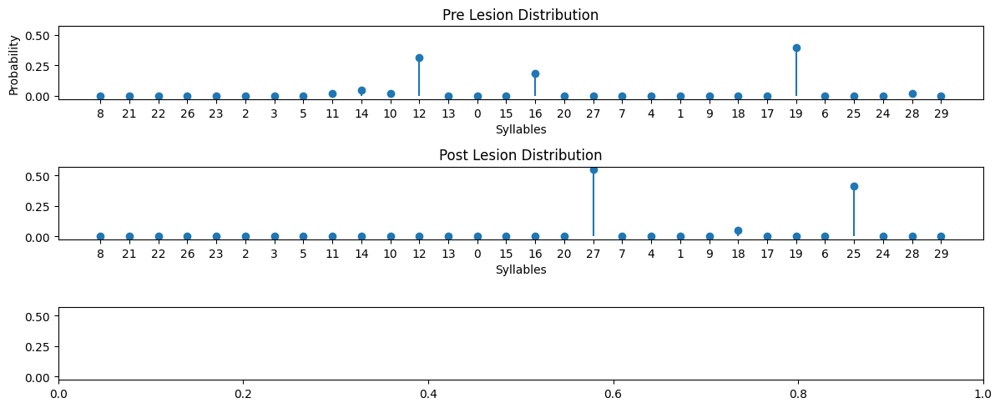

{"Earth Mover's Distance": 3.9560605851468016,
 'Information Gain': 0.5593981374443358,
 'Kullback-Leibler Divergence': 19.12152088029303}
30 30


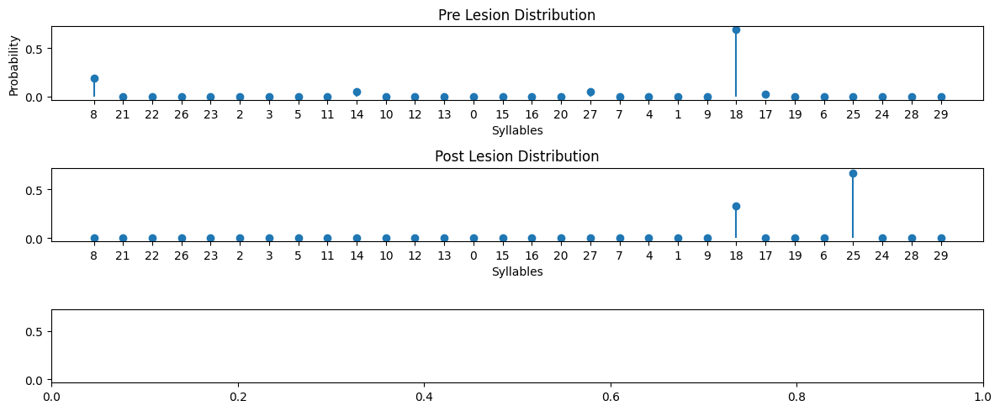

{"Earth Mover's Distance": 7.690474371930051,
 'Information Gain': 0.31401565951343957,
 'Kullback-Leibler Divergence': 5.5420419388564985}
30 30


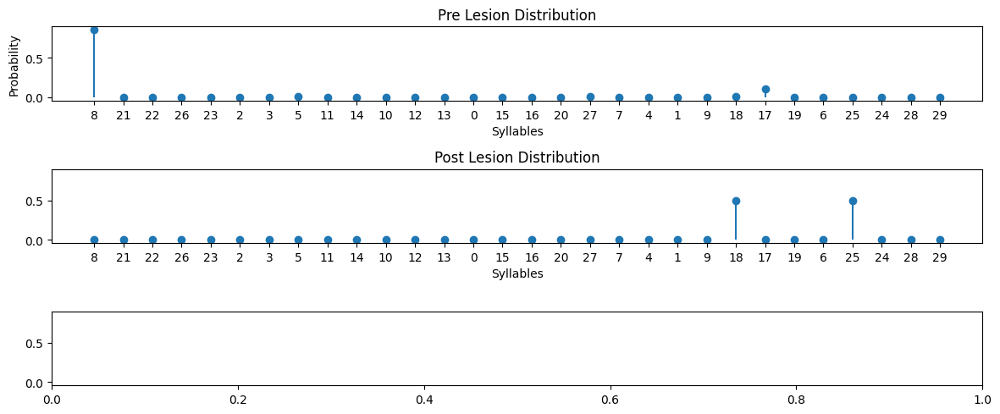

{"Earth Mover's Distance": 20.939848122891,
 'Information Gain': -0.1610421412318458,
 'Kullback-Leibler Divergence': 18.008359215870282}
30 30


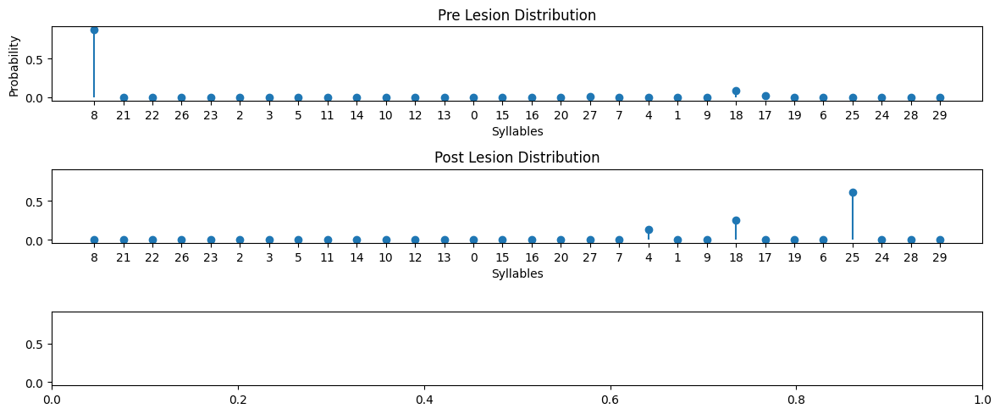

{"Earth Mover's Distance": 21.34538016096082,
 'Information Gain': -0.3953191571477649,
 'Kullback-Leibler Divergence': 18.596217364150036}
30 30


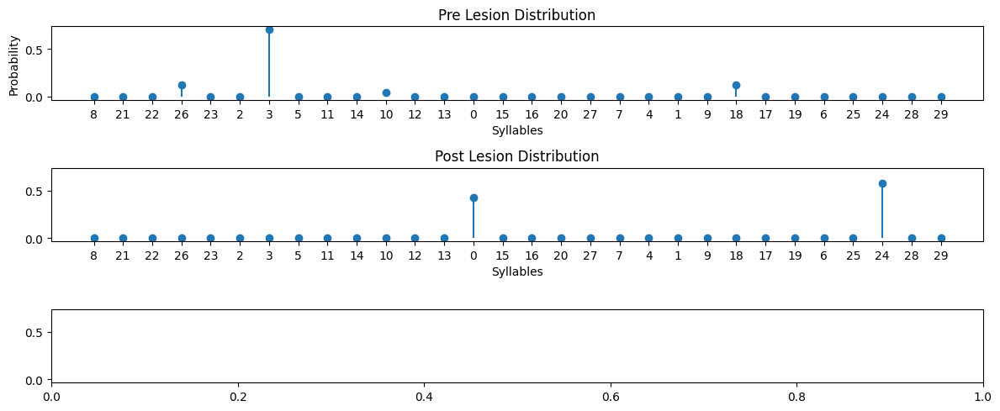

{"Earth Mover's Distance": 13.20930122597433,
 'Information Gain': 0.25220192678706255,
 'Kullback-Leibler Divergence': 18.437449597513602}
30 30


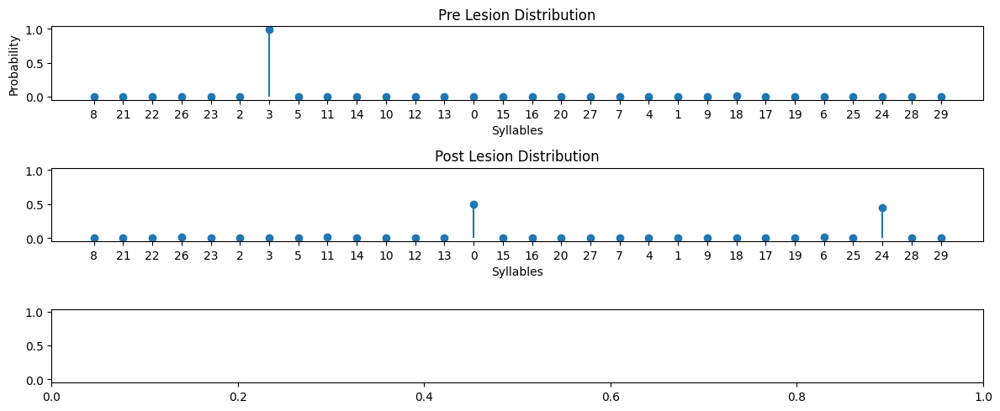

{"Earth Mover's Distance": 13.003357651859922,
 'Information Gain': -0.9335999994532101,
 'Kullback-Leibler Divergence': 6.19934650829628}
30 30


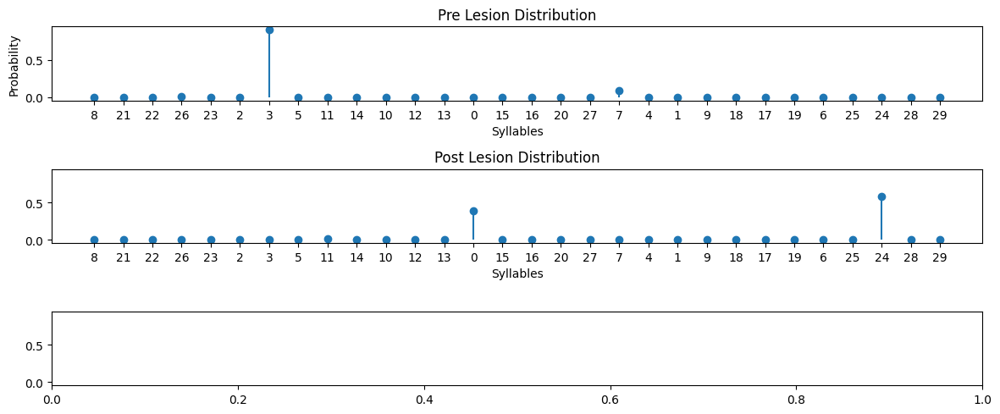

{"Earth Mover's Distance": 14.172572945728296,
 'Information Gain': -0.45297592764050354,
 'Kullback-Leibler Divergence': 21.536283400302498}


IndexError: list index out of range

In [12]:
from typing import Dict
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import entropy

def calculate_metrics(pre_dist, post_dist):
    # Calculate KL Divergence
    kld = entropy(pre_dist, post_dist)

    # Calculate Earth Mover's Distance (EMD) using cumulative difference
    emd = np.sum(np.abs(np.cumsum(pre_dist) - np.cumsum(post_dist)))

    # Calculate Information Gain (IG)
    ig_pre = entropy(pre_dist)
    ig_post = entropy(post_dist)
    ig = ig_pre - ig_post

    return {
        'Kullback-Leibler Divergence': kld,
        'Earth Mover\'s Distance': emd,
        'Information Gain': ig
    }

def plot_before_and_after_distribution(syllables, pre_dist, post_dist):
    fig, axes = plt.subplots(3, 1, figsize=(12, 5), sharey=True)
    axes[0].stem(syllables, pre_dist, basefmt=" ")
    axes[0].set_title("Pre Lesion Distribution")
    axes[0].set_xlabel("Syllables")
    axes[0].set_ylabel("Probability")
    axes[1].stem(syllables, post_dist, basefmt=" ")
    axes[1].set_title("Post Lesion Distribution")
    axes[1].set_xlabel("Syllables")
    plt.tight_layout()
    plt.show()

import pprint

order = 3

assert np.array_equal(pre_surgery_pst.alphabet, post_surgery_pst.alphabet), "Alphabets must be the same" #why is this necessary?

for idx in range(len(pre_surgery_pst.tree[order]['p'])):
    print(len(pre_surgery_pst.tree[order]['p'][idx]), len(post_surgery_pst.tree[order]['p'][idx]))

    pre_probs = pre_surgery_pst.tree[order]['p'][idx]
    post_probs = post_surgery_pst.tree[order]['p'][idx]

    norm_pre_probs = (pre_probs + (1e-12)) / np.sum(pre_probs)
    norm_post_probs = (post_probs + (1e-12)) / np.sum(post_probs)

    plot_before_and_after_distribution(alphabet, norm_pre_probs, norm_post_probs)
    metrics = calculate_metrics(norm_pre_probs, norm_post_probs)

    pprint.pprint(metrics)

Length of pre-surgery probs: 275
Length of post-surgery probs: 219


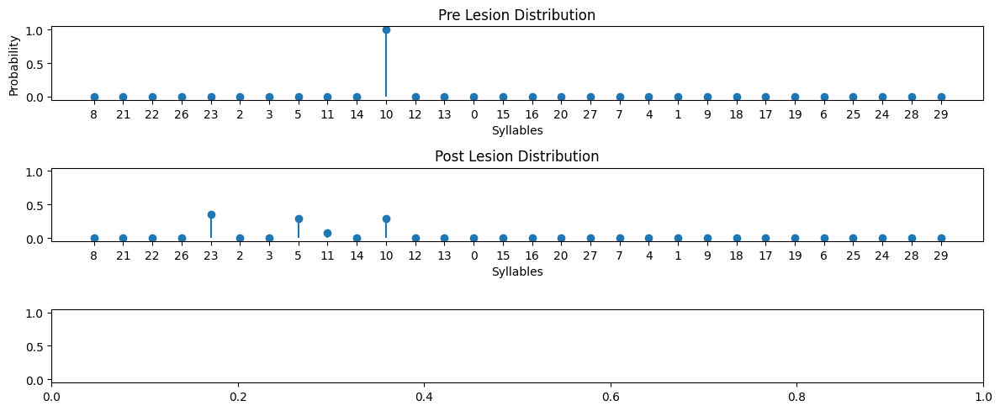

{"Earth Mover's Distance": 3.1428774265803514,
 'Information Gain': -1.272062113146192,
 'Kullback-Leibler Divergence': 1.2527617351373643}


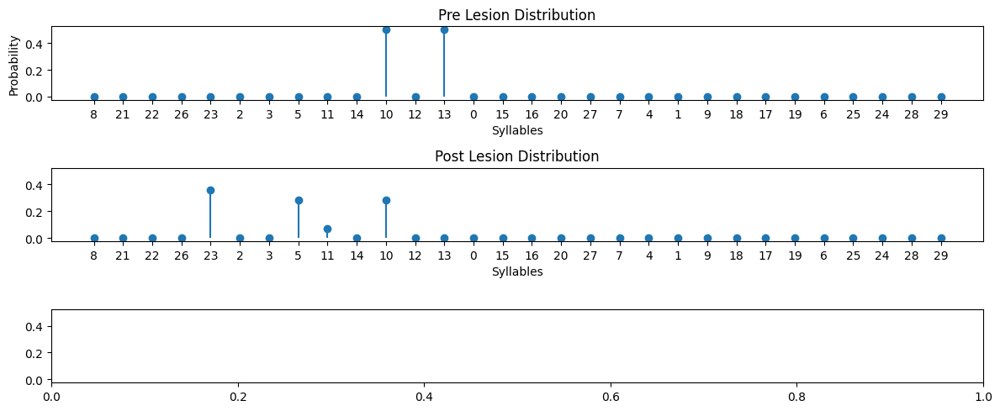

{"Earth Mover's Distance": 4.142865723153657,
 'Information Gain': -0.5789298038078534,
 'Kullback-Leibler Divergence': 9.96608071996119}


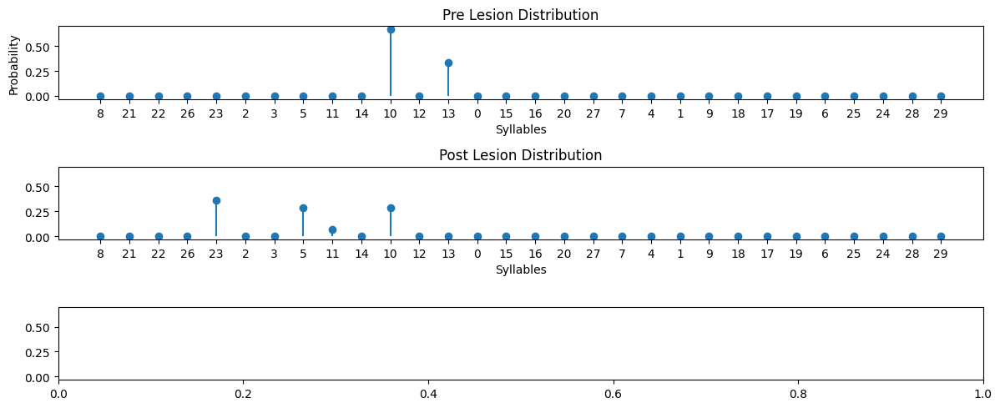

{"Earth Mover's Distance": 3.809529318056977,
 'Information Gain': -0.6355671967561931,
 'Kullback-Leibler Divergence': 6.887226949175807}


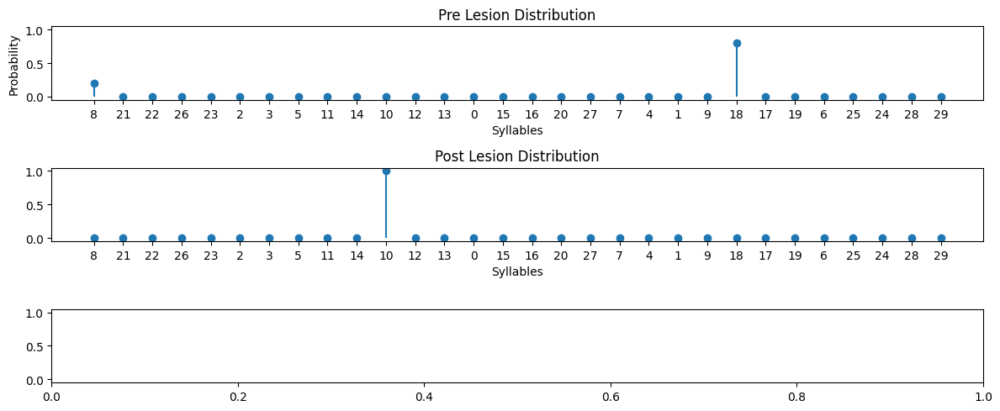

{"Earth Mover's Distance": 11.600005615035021,
 'Information Gain': 0.5003938934306709,
 'Kullback-Leibler Divergence': 16.926243778148987}


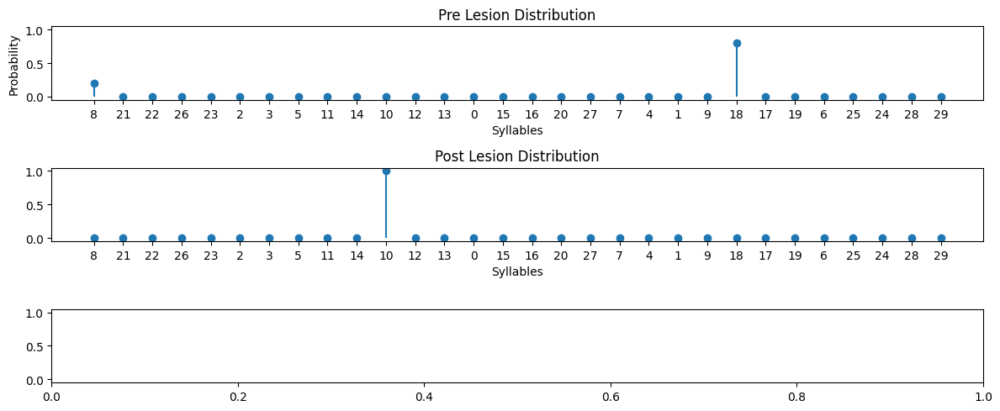

{"Earth Mover's Distance": 11.600005615035021,
 'Information Gain': 0.5003938934306709,
 'Kullback-Leibler Divergence': 16.926243778148987}


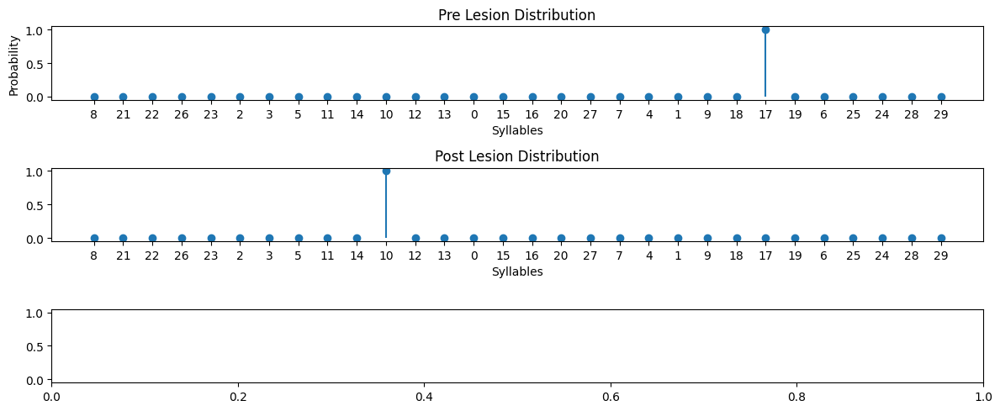

{"Earth Mover's Distance": 13.000000022746999,
 'Information Gain': 4.992943779704252e-07,
 'Kullback-Leibler Divergence': 17.426636879413305}


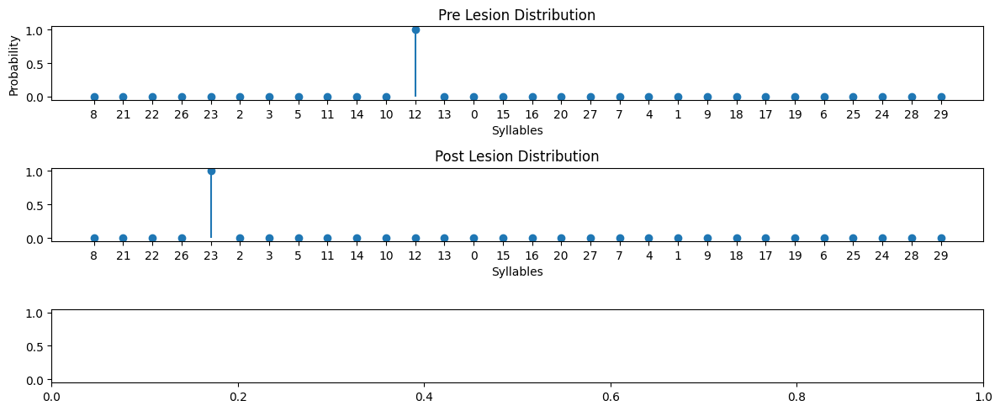

{"Earth Mover's Distance": 7.000007354905047,
 'Information Gain': -8.166129047451886e-06,
 'Kullback-Leibler Divergence': 17.426645837708705}


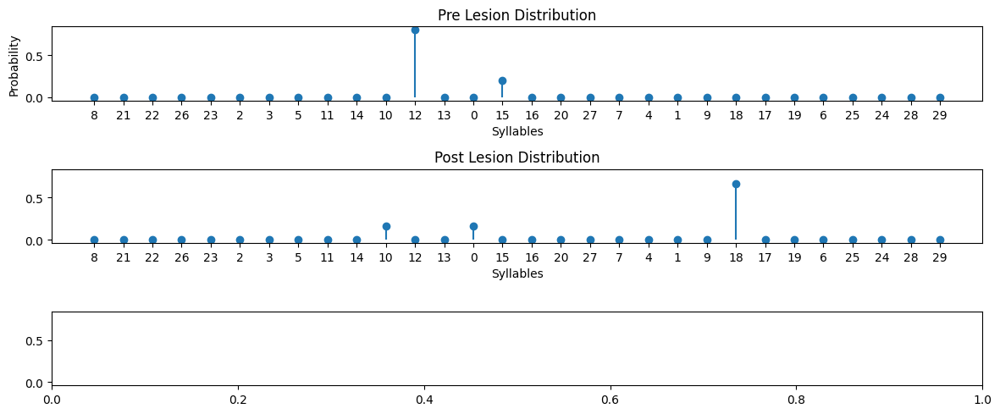

{"Earth Mover's Distance": 7.2333363016548216,
 'Information Gain': -0.36715725497173624,
 'Kullback-Leibler Divergence': 18.71800216582404}


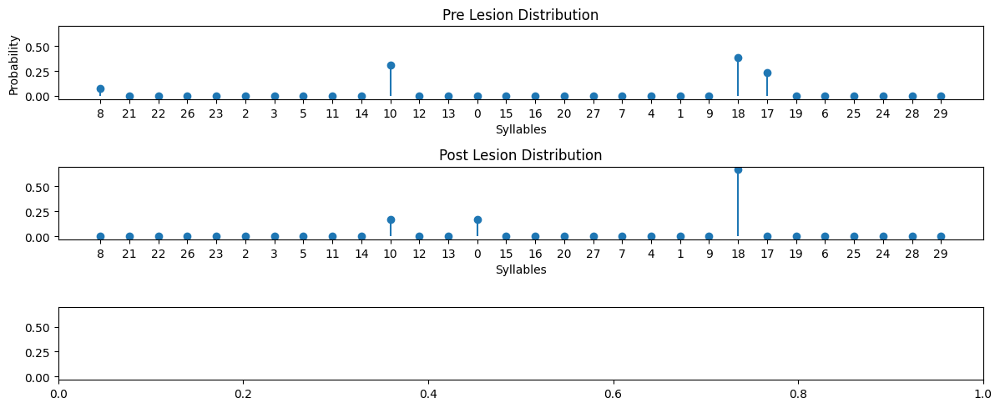

{"Earth Mover's Distance": 2.1153846074195783,
 'Information Gain': 0.3982932973249995,
 'Kullback-Leibler Divergence': 5.3547585808590465}


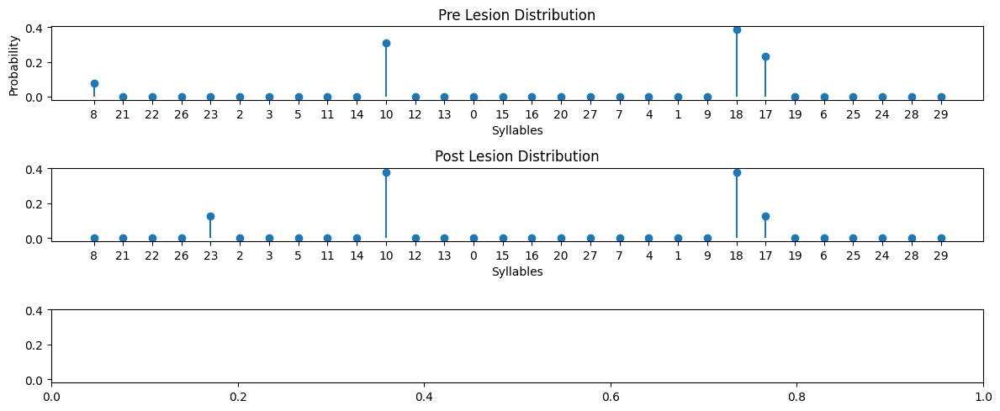

{"Earth Mover's Distance": 2.086538399120874,
 'Information Gain': 0.010374865561751268,
 'Kullback-Leibler Divergence': 1.393518528762257}


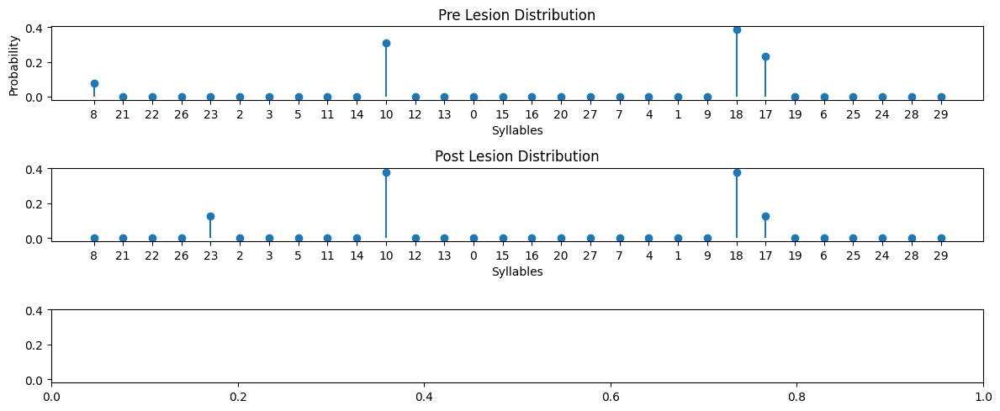

{"Earth Mover's Distance": 2.086538399120874,
 'Information Gain': 0.010374865561751268,
 'Kullback-Leibler Divergence': 1.393518528762257}


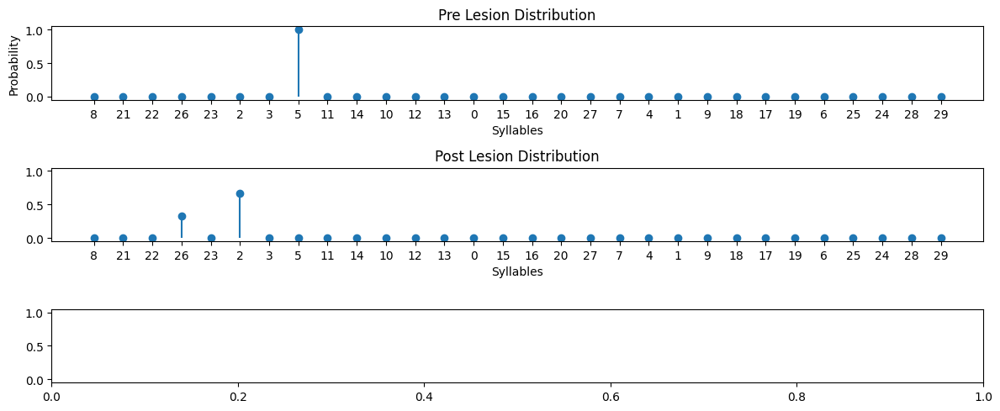

{"Earth Mover's Distance": 2.6666864591396493,
 'Information Gain': -0.6364901829913665,
 'Kullback-Leibler Divergence': 18.52523331199563}


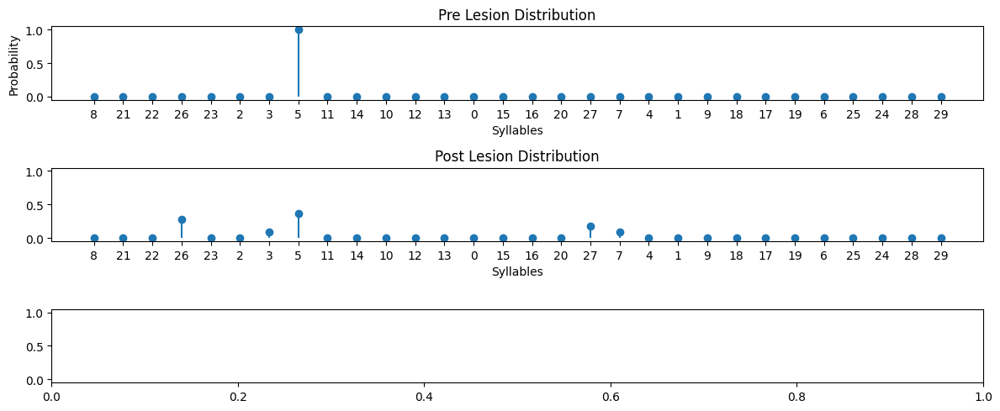

{"Earth Mover's Distance": 4.000022550252617,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 1.011598785319034}


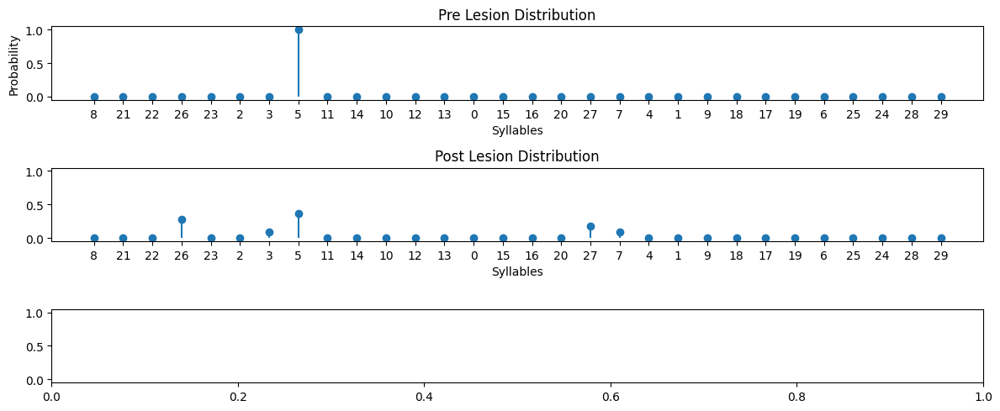

{"Earth Mover's Distance": 4.000022550252617,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 1.011598785319034}


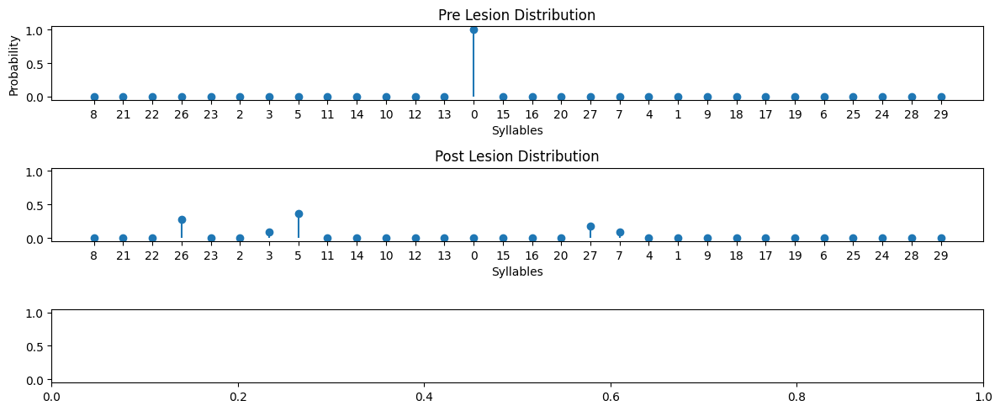

{"Earth Mover's Distance": 6.727288528518622,
 'Information Gain': -1.468112380281874,
 'Kullback-Leibler Divergence': 19.82451303168719}


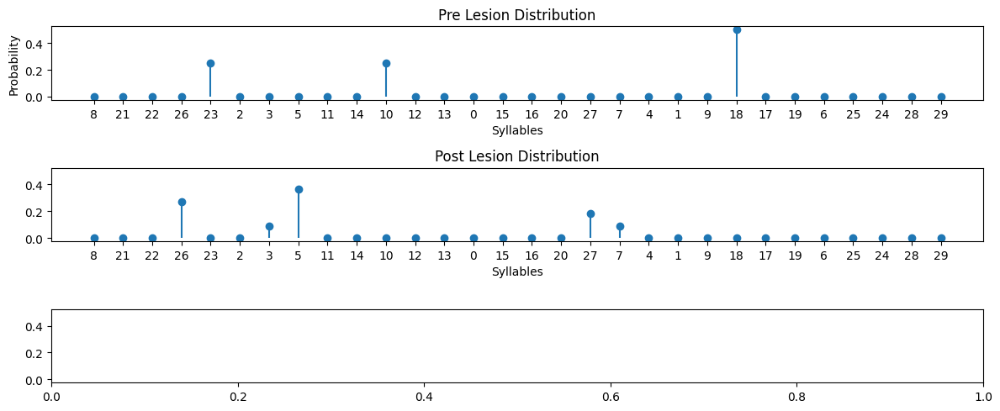

{"Earth Mover's Distance": 5.863636028728545,
 'Information Gain': -0.42841353252397996,
 'Kullback-Leibler Divergence': 18.78481797835106}


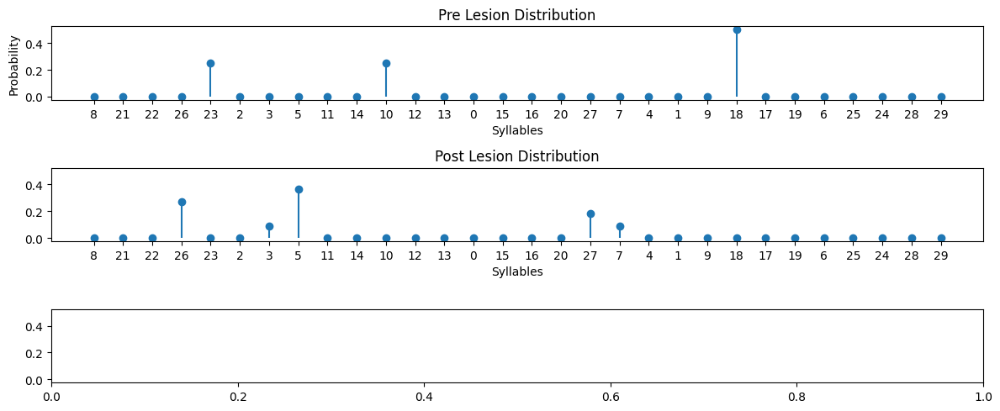

{"Earth Mover's Distance": 5.863636028728545,
 'Information Gain': -0.42841353252397996,
 'Kullback-Leibler Divergence': 18.78481797835106}


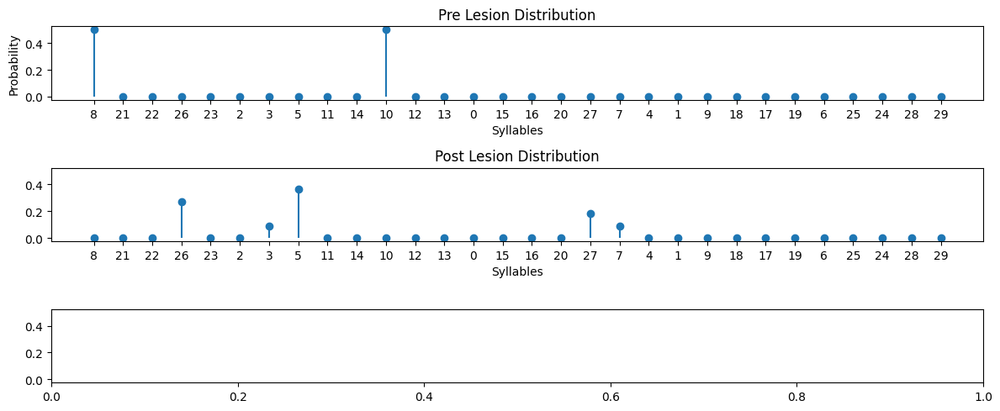

{"Earth Mover's Distance": 5.000010502507184,
 'Information Gain': -0.7749800709435355,
 'Kullback-Leibler Divergence': 19.131383251962294}


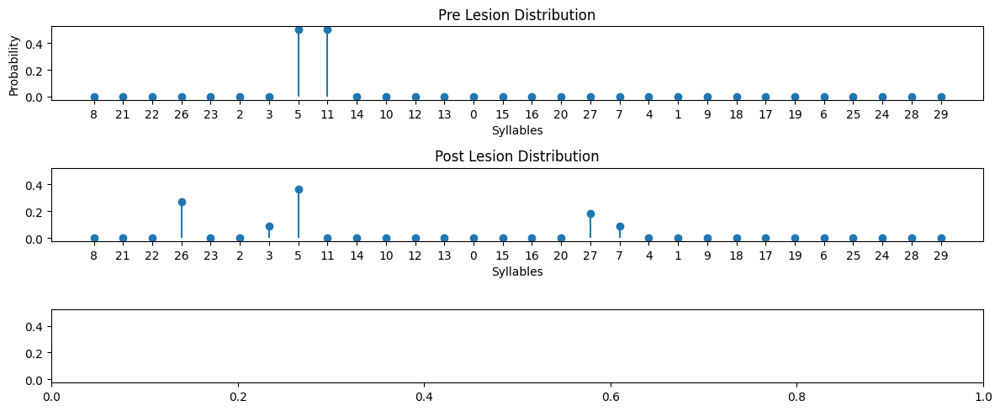

{"Earth Mover's Distance": 3.954555803731374,
 'Information Gain': -0.7749800709435355,
 'Kullback-Leibler Divergence': 9.724918224538943}


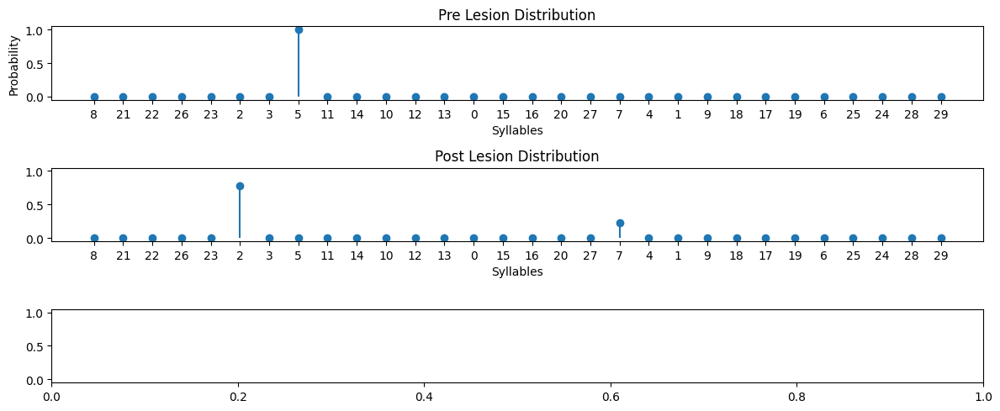

{"Earth Mover's Distance": 4.000024153438554,
 'Information Gain': -0.5296780425632384,
 'Kullback-Leibler Divergence': 20.72245741704719}


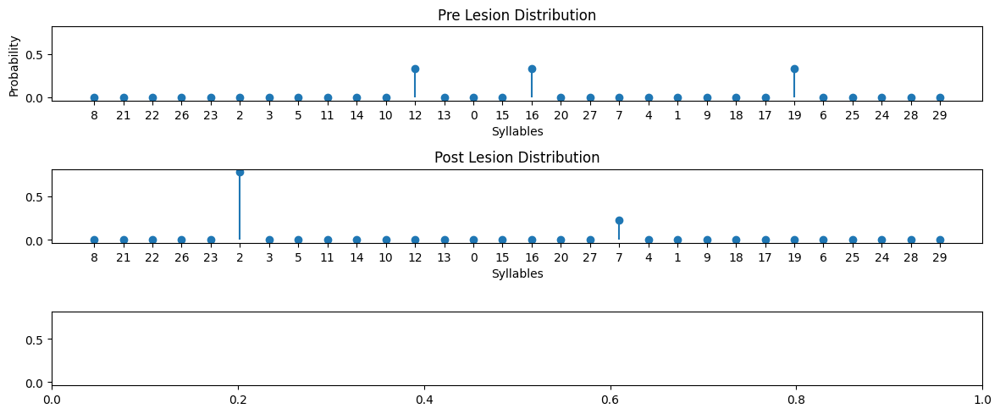

{"Earth Mover's Distance": 8.777775922159446,
 'Information Gain': 0.5689144178039991,
 'Kullback-Leibler Divergence': 19.62386643895034}


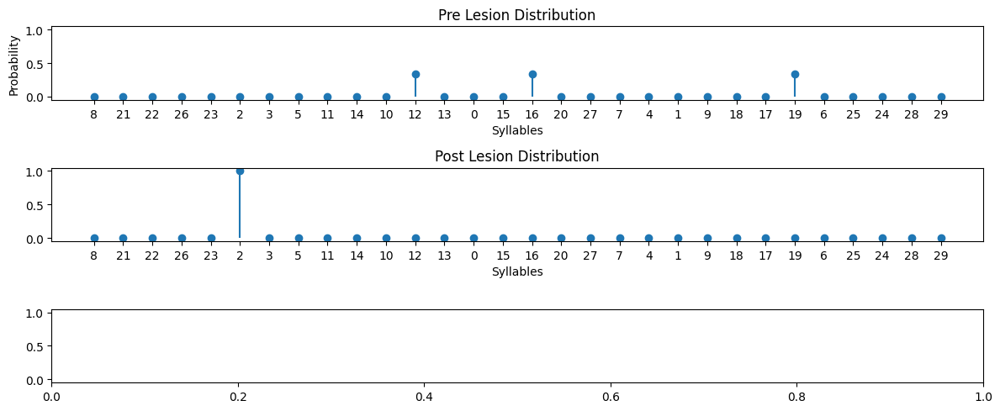

{"Earth Mover's Distance": 11.666670548331705,
 'Information Gain': 1.0986067721390134,
 'Kullback-Leibler Divergence': 16.328030769275284}


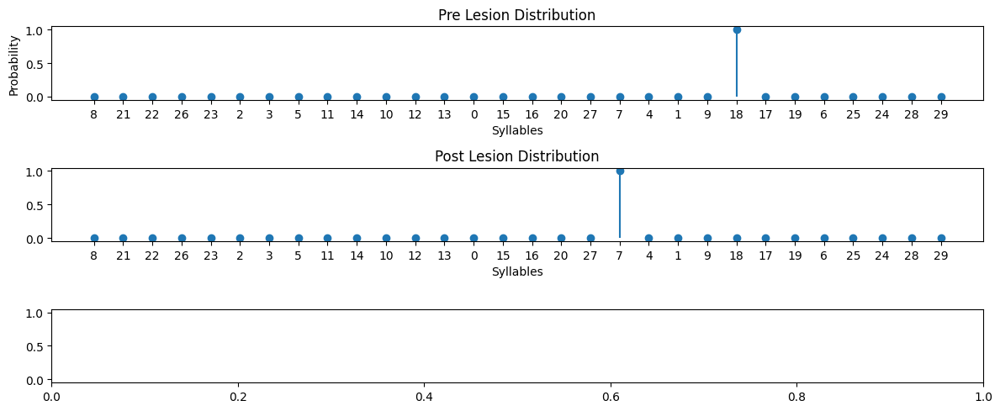

{"Earth Mover's Distance": 4.000008728698993,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}


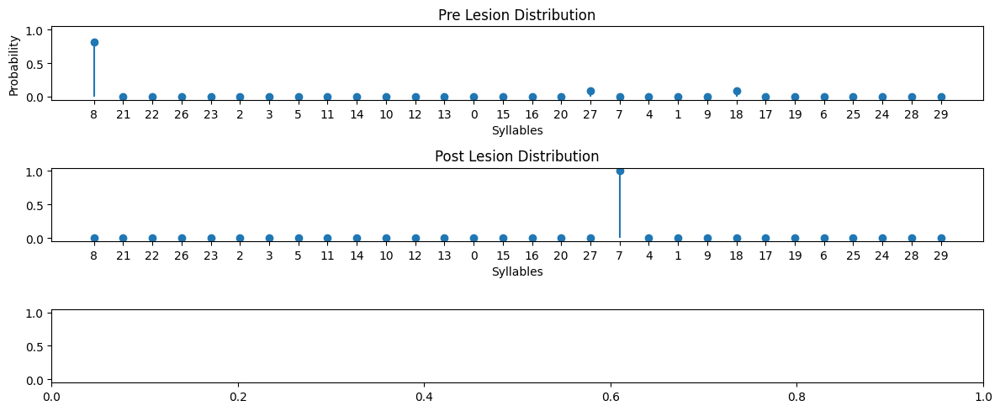

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}


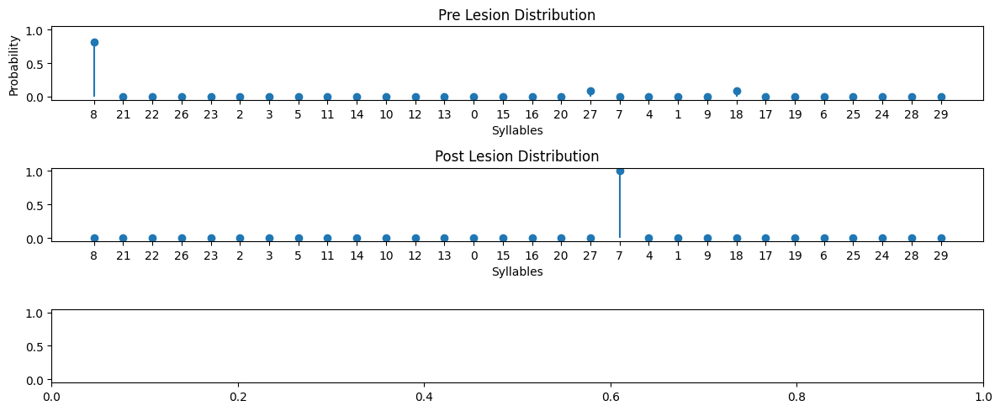

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}


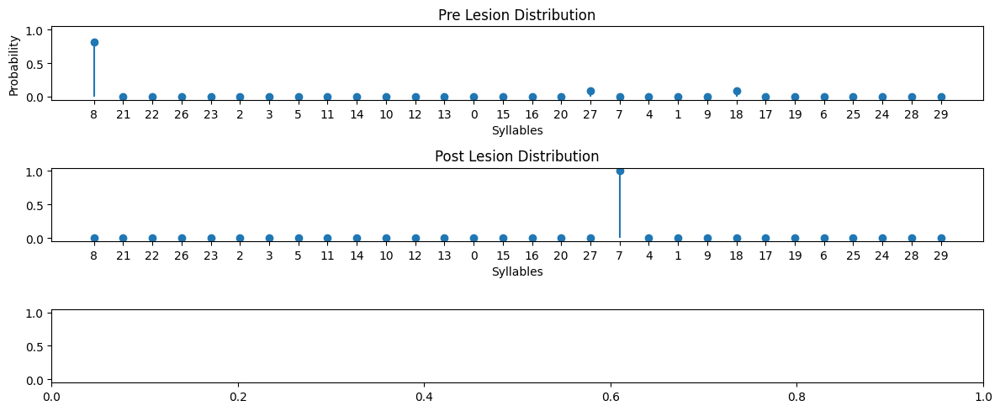

{"Earth Mover's Distance": 15.18182087899574,
 'Information Gain': 0.6001543308295912,
 'Kullback-Leibler Divergence': 16.826483447249032}


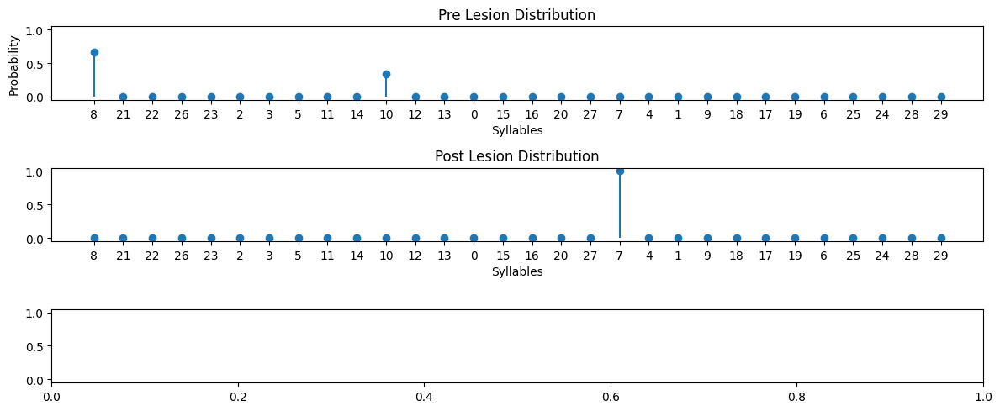

{"Earth Mover's Distance": 14.666667693429678,
 'Information Gain': 0.6365092281617749,
 'Kullback-Leibler Divergence': 16.790128313252524}


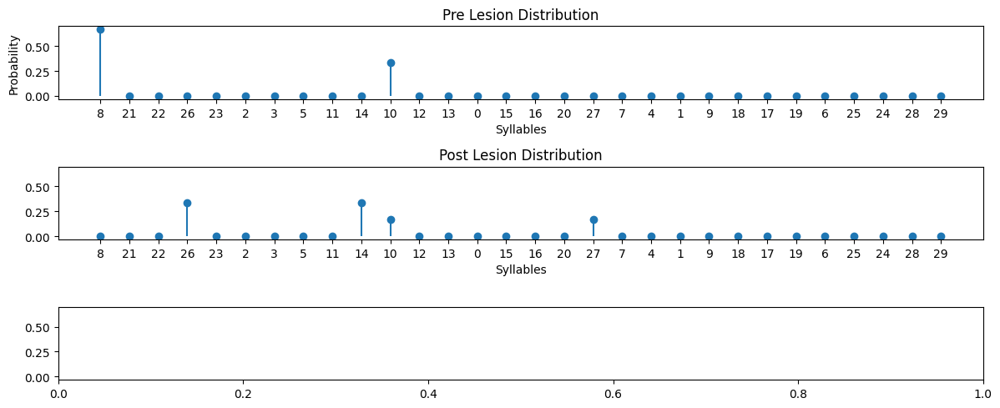

{"Earth Mover's Distance": 5.166673255639159,
 'Information Gain': -0.6931398951977573,
 'Kullback-Leibler Divergence': 12.773005518131047}


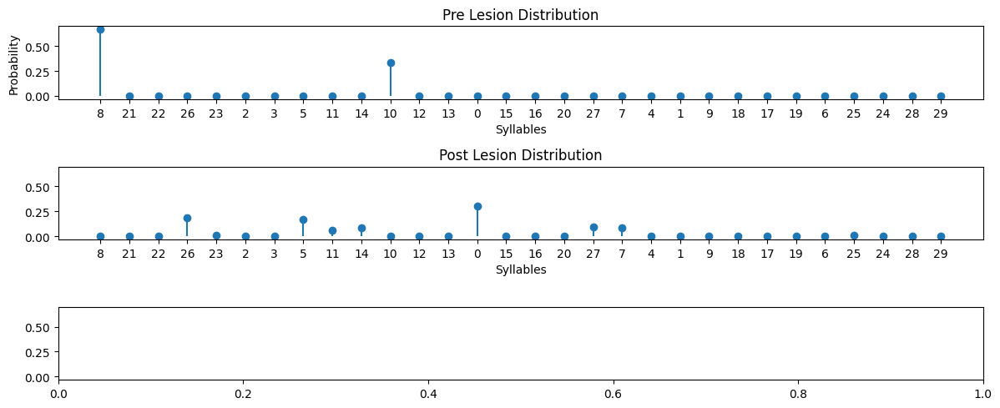

{"Earth Mover's Distance": 6.993881185925618,
 'Information Gain': -1.2349888758908718,
 'Kullback-Leibler Divergence': 22.395926477914944}


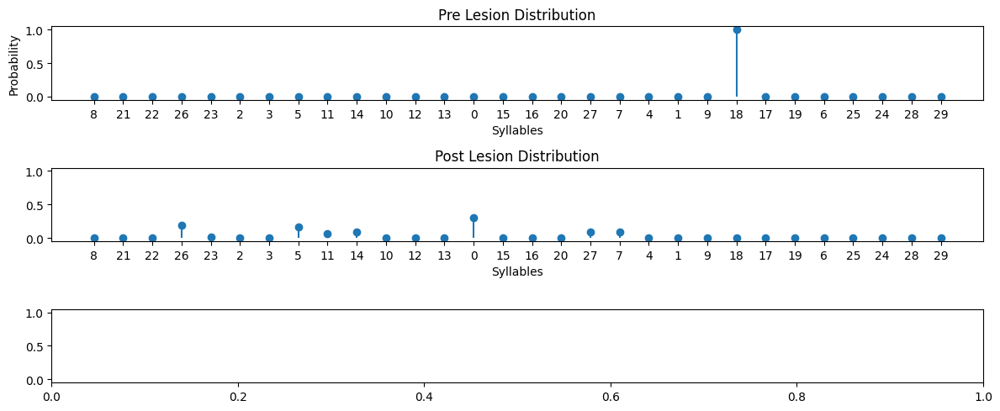

{"Earth Mover's Distance": 11.731616837649748,
 'Information Gain': -1.8714976047582685,
 'Kullback-Leibler Divergence': 23.032433497084927}


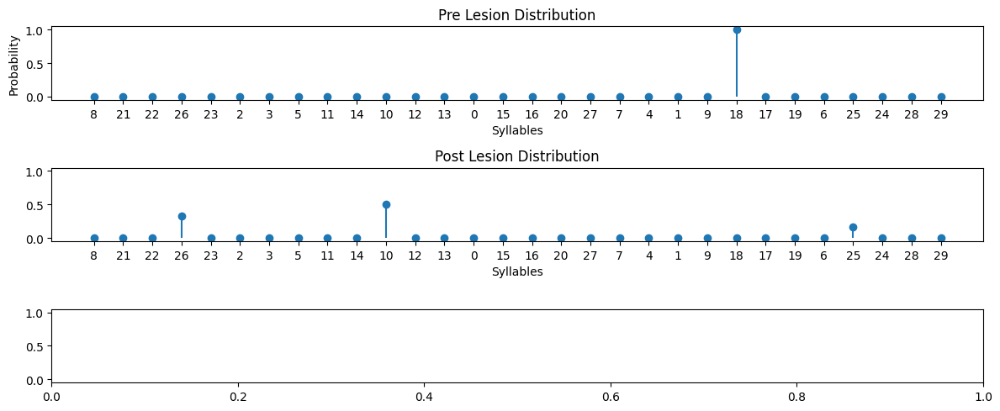

{"Earth Mover's Distance": 12.999999318311502,
 'Information Gain': -1.0113916640742673,
 'Kullback-Leibler Divergence': 19.218394646689347}


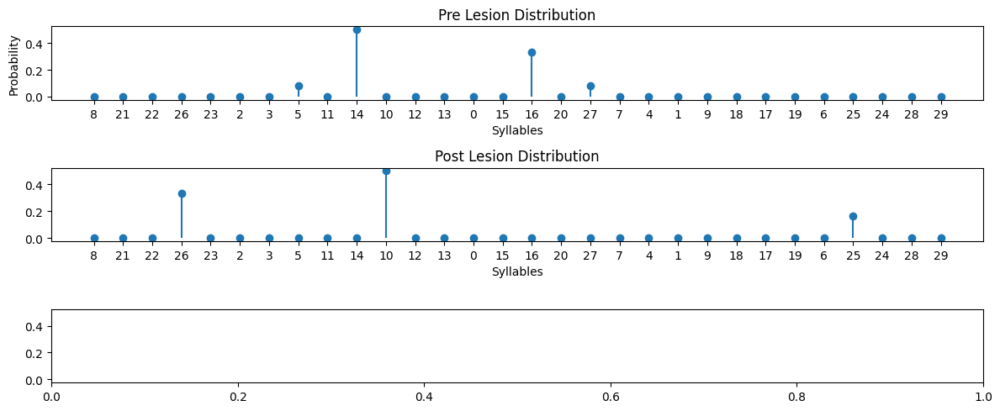

{"Earth Mover's Distance": 5.000000042362162,
 'Information Gain': 0.11552451557220778,
 'Kullback-Leibler Divergence': 18.091479729165563}


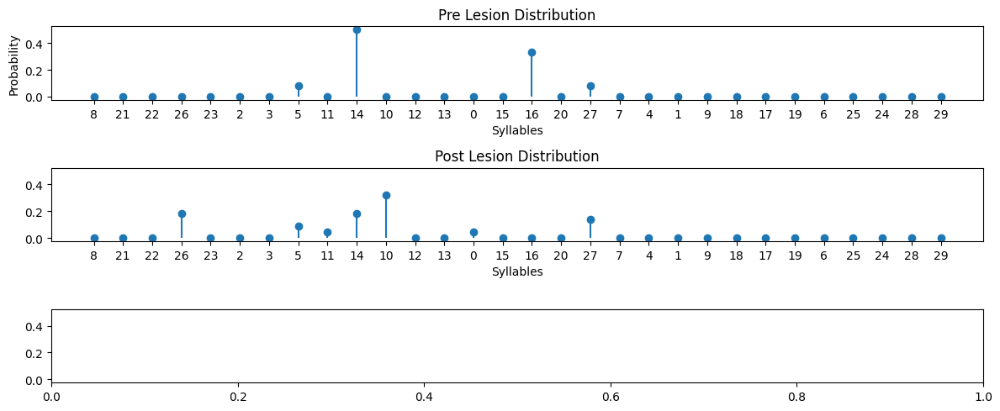

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}


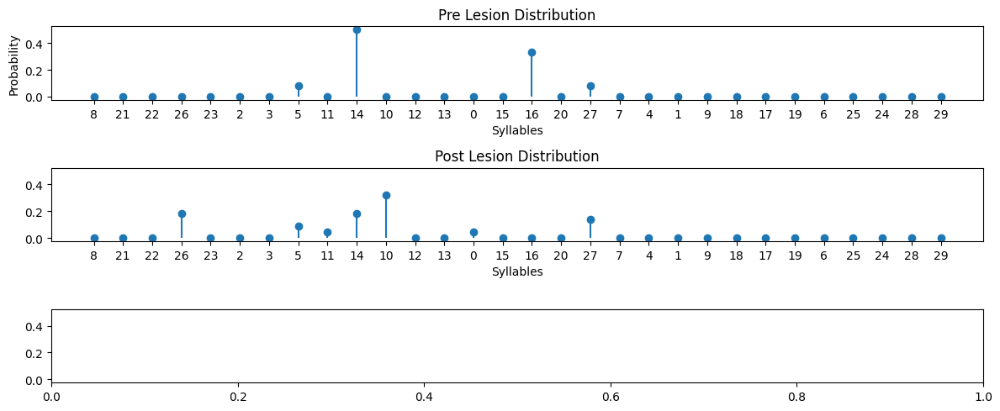

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}


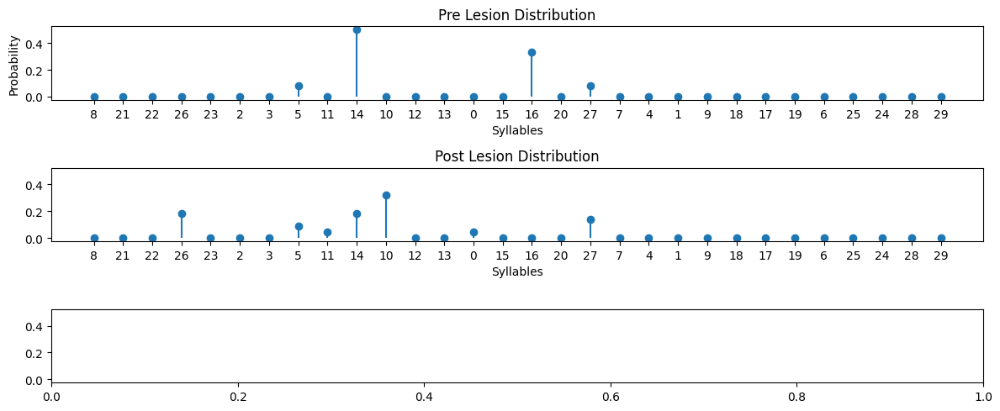

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}


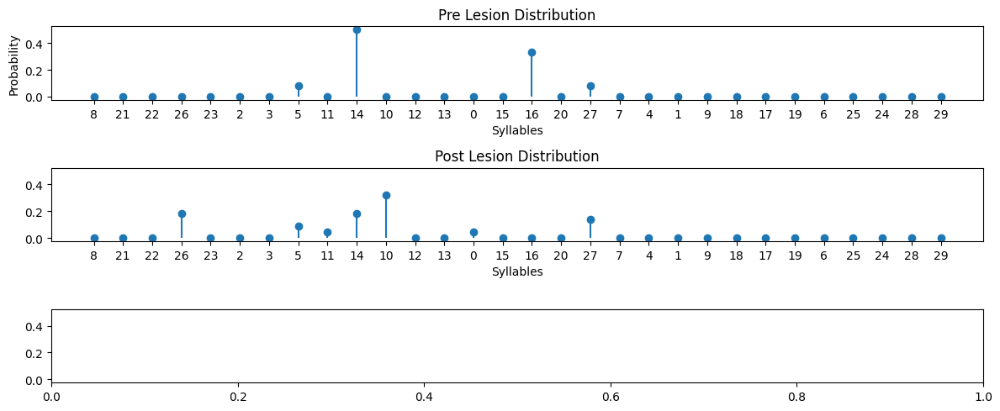

{"Earth Mover's Distance": 2.6060614901678605,
 'Information Gain': -0.6280274805723458,
 'Kullback-Leibler Divergence': 6.930535874083712}


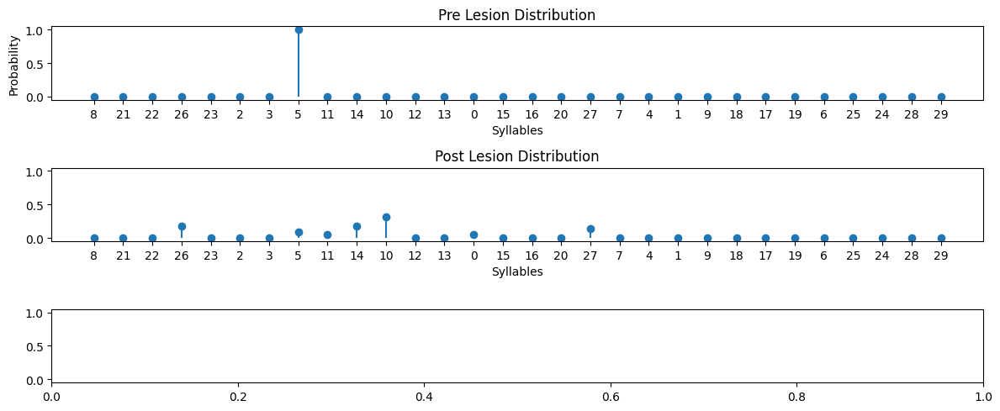

{"Earth Mover's Distance": 3.727275579391871,
 'Information Gain': -1.7549540398808456,
 'Kullback-Leibler Divergence': 2.3978940591860907}


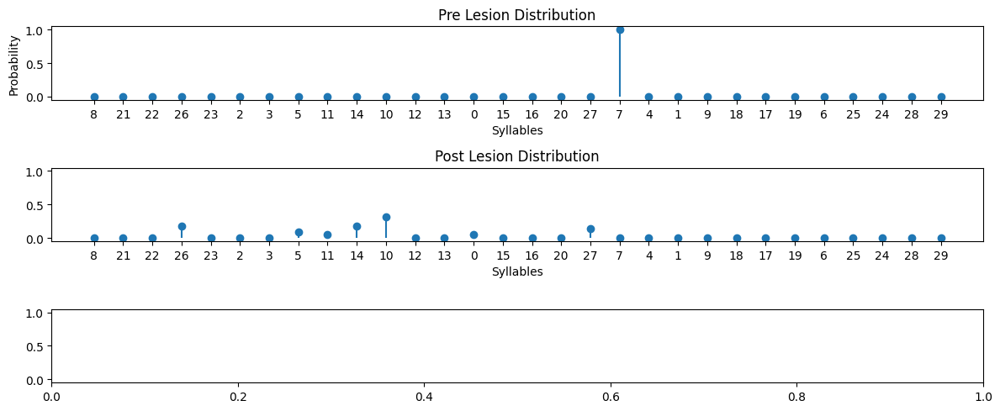

{"Earth Mover's Distance": 8.72728012416204,
 'Information Gain': -1.754929847741423,
 'Kullback-Leibler Divergence': 20.517658036251785}


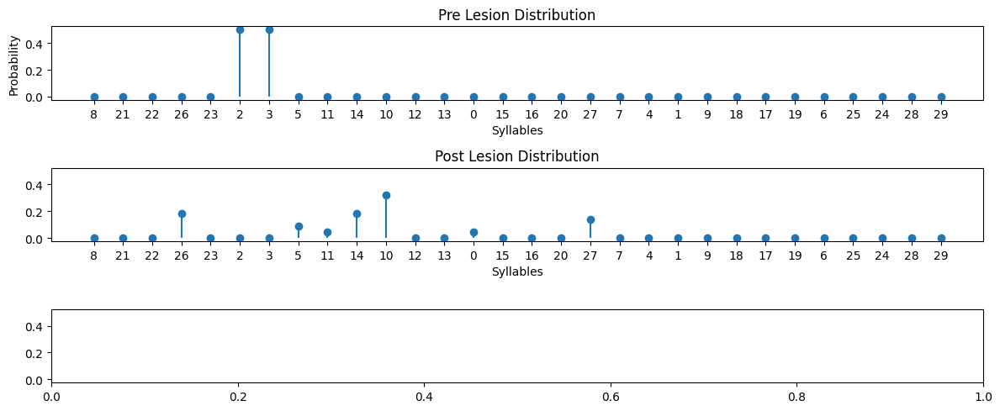

{"Earth Mover's Distance": 4.500011971452434,
 'Information Gain': -1.0617975384030844,
 'Kullback-Leibler Divergence': 19.82452932610026}


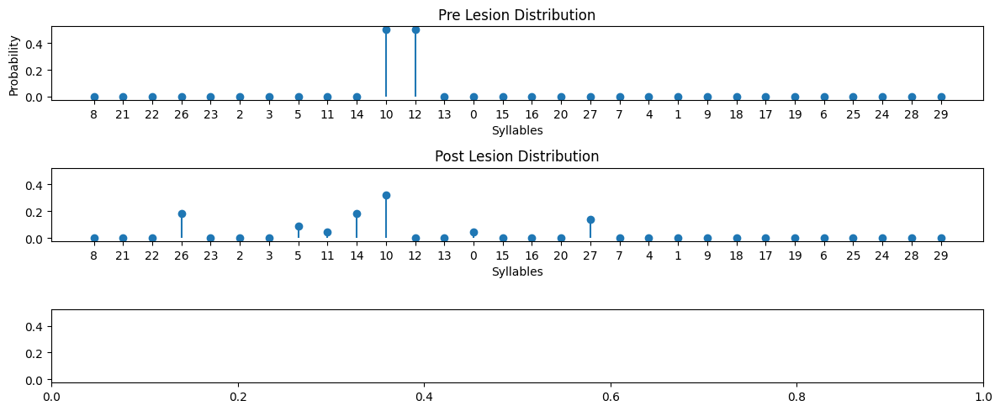

{"Earth Mover's Distance": 3.0454637851661475,
 'Information Gain': -1.0617975384030844,
 'Kullback-Leibler Divergence': 10.138256641279119}


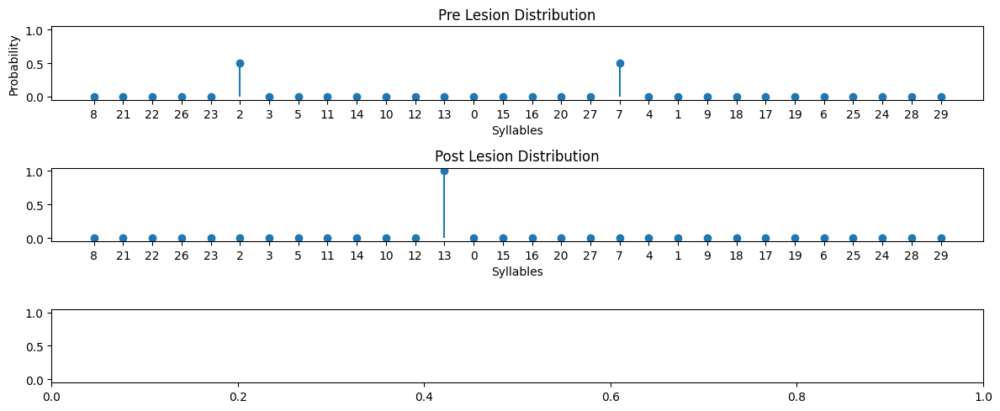

{"Earth Mover's Distance": 6.500000275930991,
 'Information Gain': 0.6931466211101145,
 'Kullback-Leibler Divergence': 16.733490757597572}


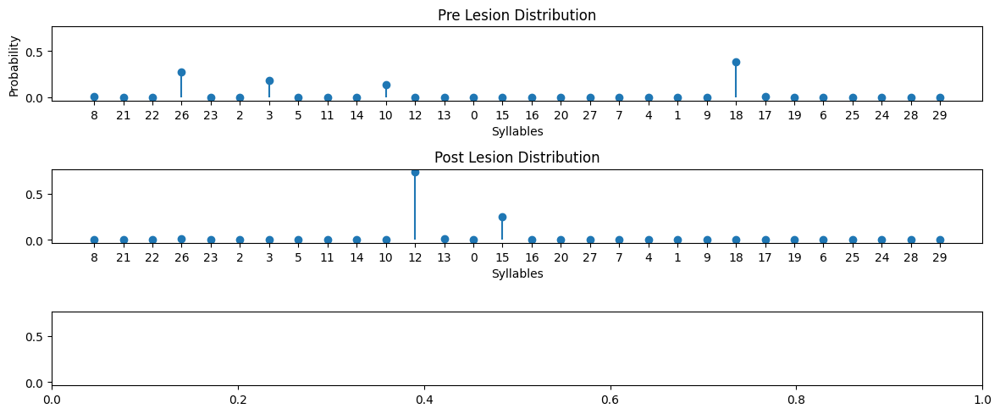

{"Earth Mover's Distance": 6.855075997322193,
 'Information Gain': 0.7383714154490462,
 'Kullback-Leibler Divergence': 16.040359735673178}


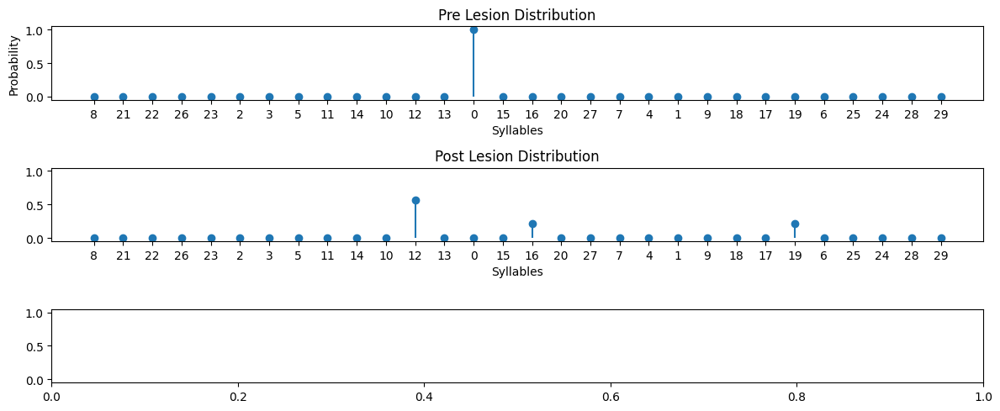

{"Earth Mover's Distance": 3.9285938758917833,
 'Information Gain': -0.9799434790916132,
 'Kullback-Leibler Divergence': 20.065676963647196}


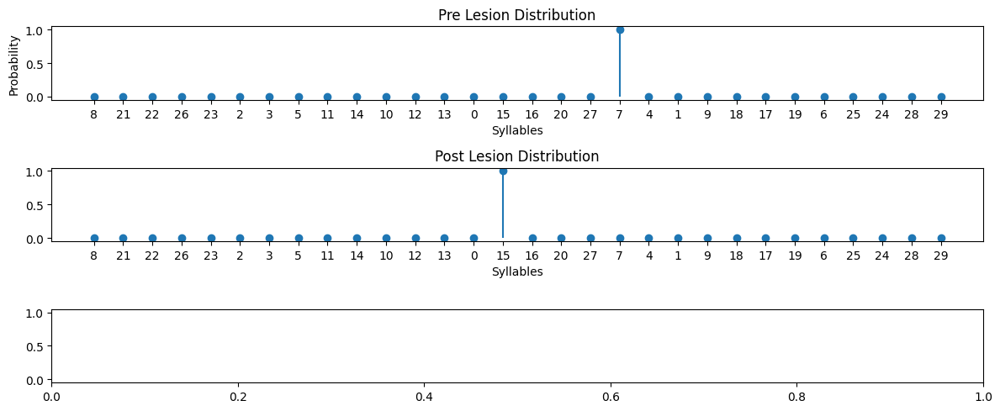

{"Earth Mover's Distance": 4.000014155663489,
 'Information Gain': 2.1259830145027644e-05,
 'Kullback-Leibler Divergence': 18.119769315231785}


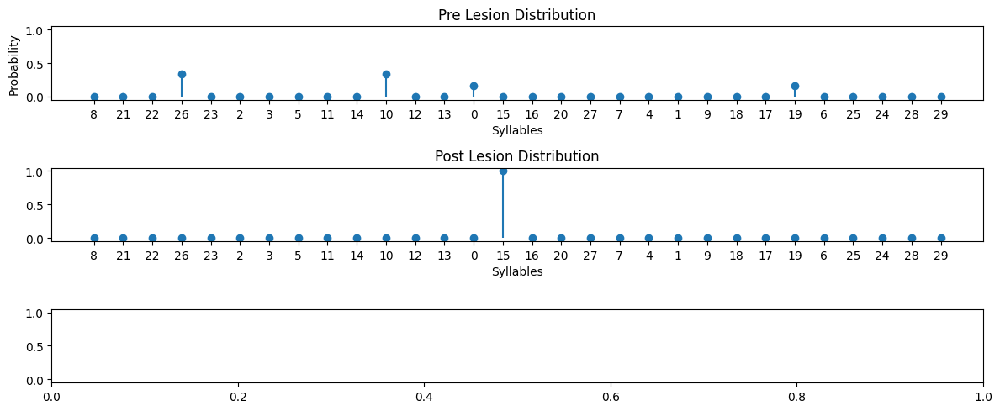

{"Earth Mover's Distance": 6.833334447746839,
 'Information Gain': 1.3296582702646391,
 'Kullback-Leibler Divergence': 16.790133150688238}


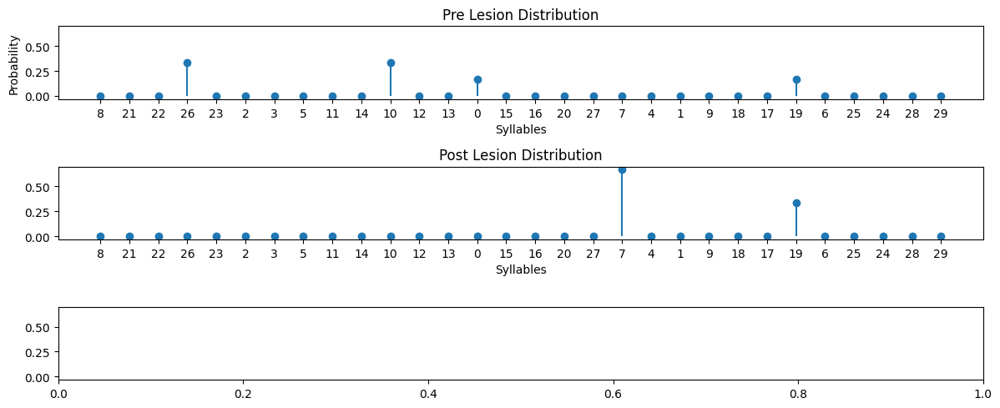

{"Earth Mover's Distance": 9.500000153295,
 'Information Gain': 0.6931468274431276,
 'Kullback-Leibler Divergence': 14.291156854102322}


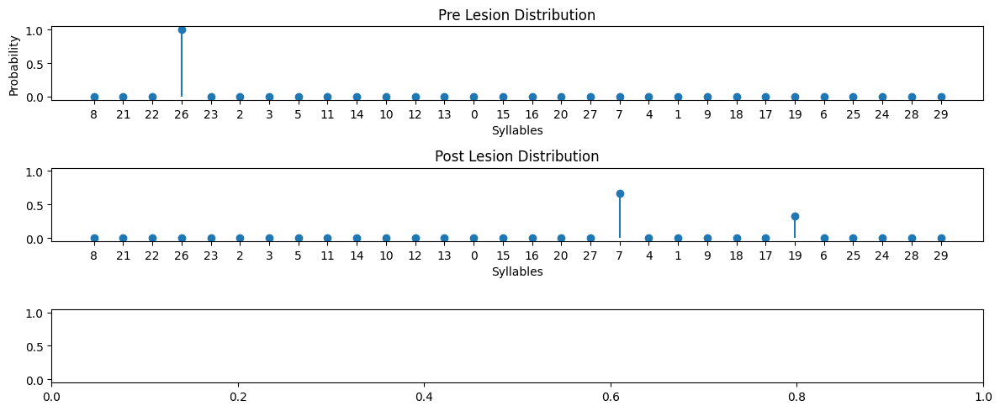

{"Earth Mover's Distance": 17.00002186104499,
 'Information Gain': -0.6364901829913665,
 'Kullback-Leibler Divergence': 18.525233311995628}


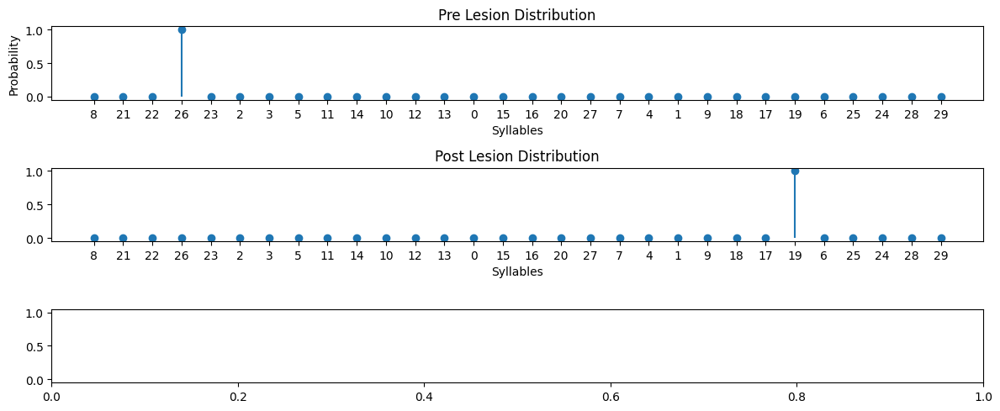

{"Earth Mover's Distance": 21.000013484534982,
 'Information Gain': 1.4311771776054103e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


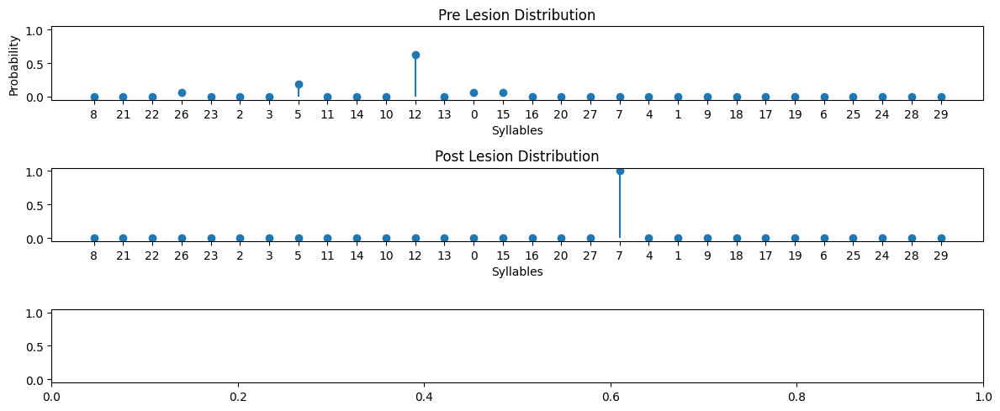

{"Earth Mover's Distance": 7.937503411500639,
 'Information Gain': 1.1274696810399392,
 'Kullback-Leibler Divergence': 16.299168155280327}


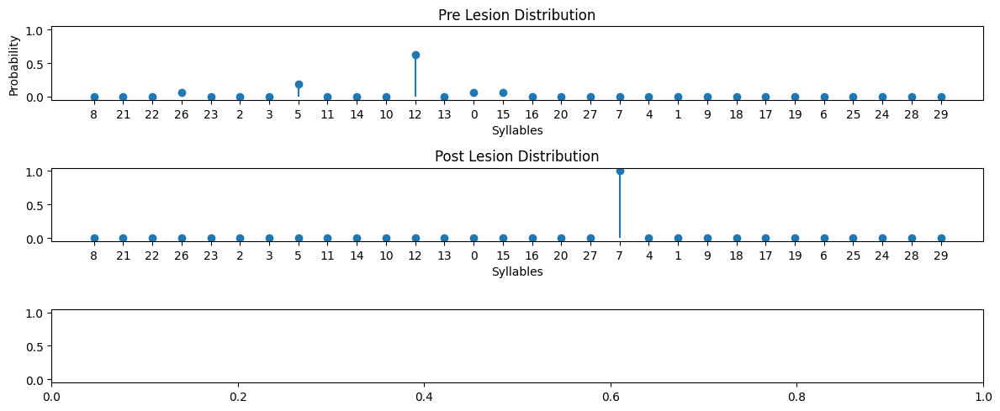

{"Earth Mover's Distance": 7.937503411500639,
 'Information Gain': 1.1274696810399392,
 'Kullback-Leibler Divergence': 16.299168155280327}


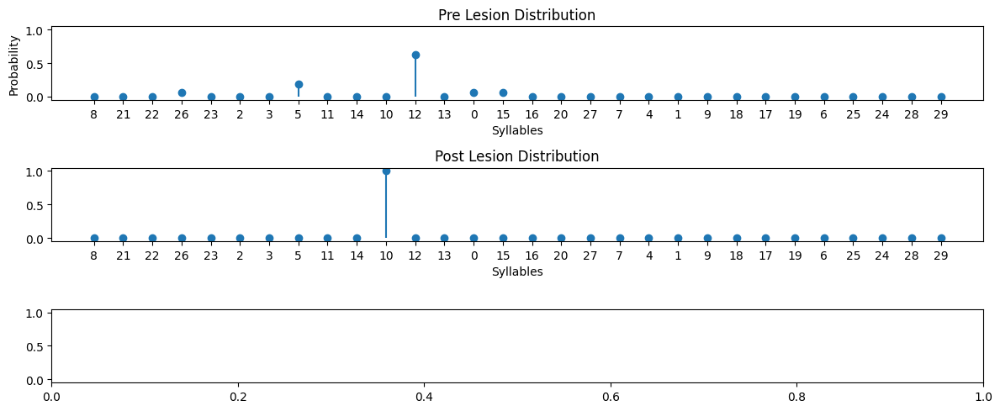

{"Earth Mover's Distance": 2.06250927422765,
 'Information Gain': 1.127469681039939,
 'Kullback-Leibler Divergence': 16.299168155280327}


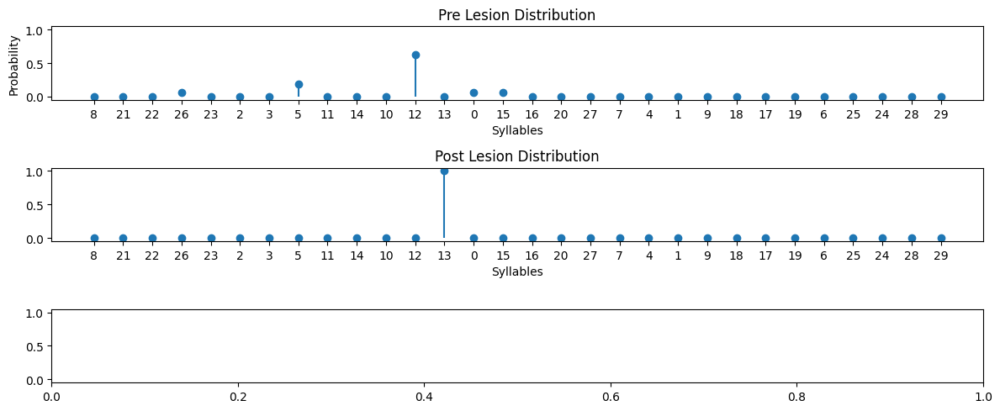

{"Earth Mover's Distance": 2.312508111790394,
 'Information Gain': 1.127469681039939,
 'Kullback-Leibler Divergence': 16.299168155280327}


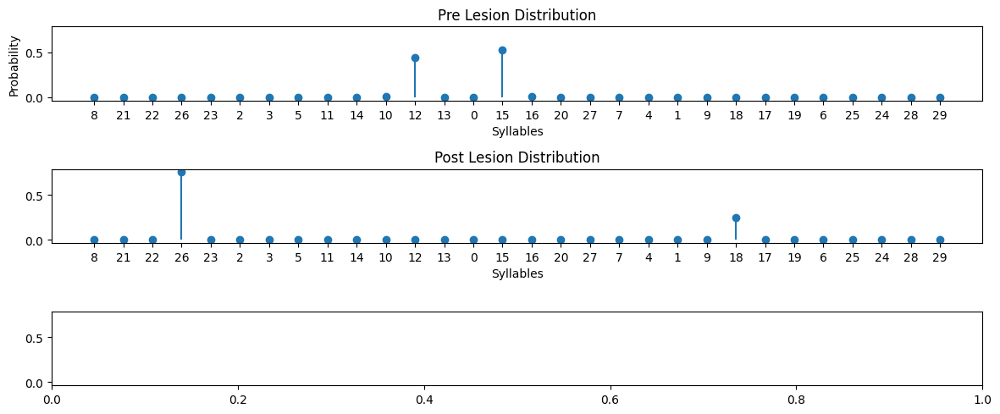

{"Earth Mover's Distance": 8.815164037041535,
 'Information Gain': 0.2702358799955942,
 'Kullback-Leibler Divergence': 17.91072753851081}


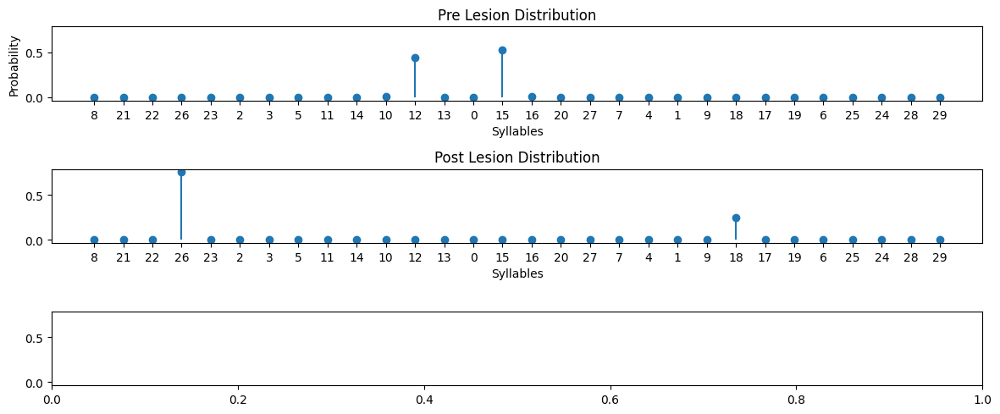

{"Earth Mover's Distance": 8.815164037041535,
 'Information Gain': 0.2702358799955942,
 'Kullback-Leibler Divergence': 17.91072753851081}


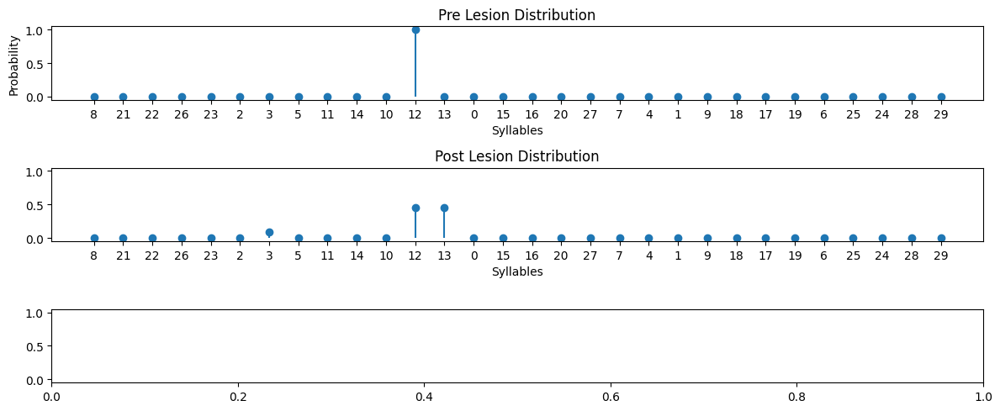

{"Earth Mover's Distance": 0.9091109954204404,
 'Information Gain': -0.9347424688580996,
 'Kullback-Leibler Divergence': 0.7884575605622037}


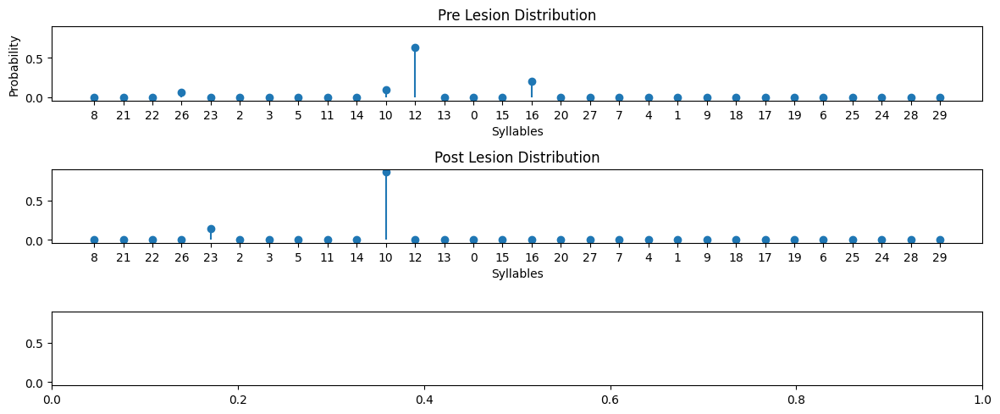

{"Earth Mover's Distance": 2.1679550860775967,
 'Information Gain': 0.6068355290052884,
 'Kullback-Leibler Divergence': 16.53764996964299}


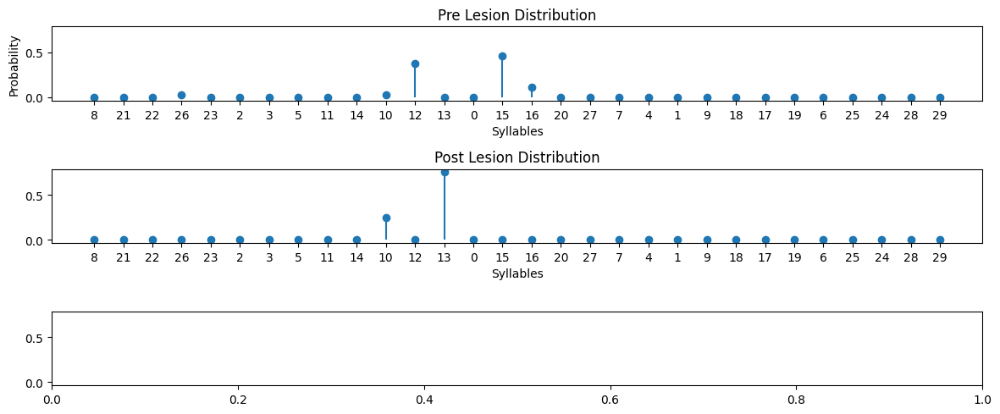

{"Earth Mover's Distance": 1.8285731966261602,
 'Information Gain': 0.6144118365057711,
 'Kullback-Leibler Divergence': 17.138291070374343}


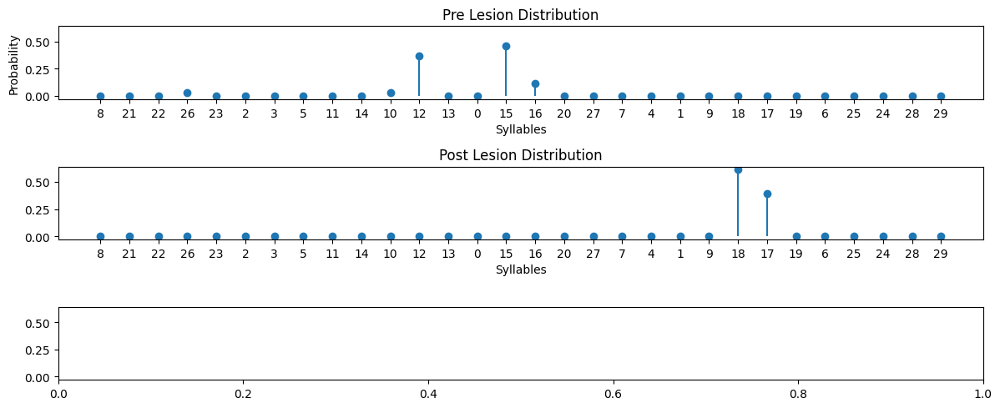

{"Earth Mover's Distance": 9.817460363683537,
 'Information Gain': 0.5085012802914783,
 'Kullback-Leibler Divergence': 19.14027260964027}


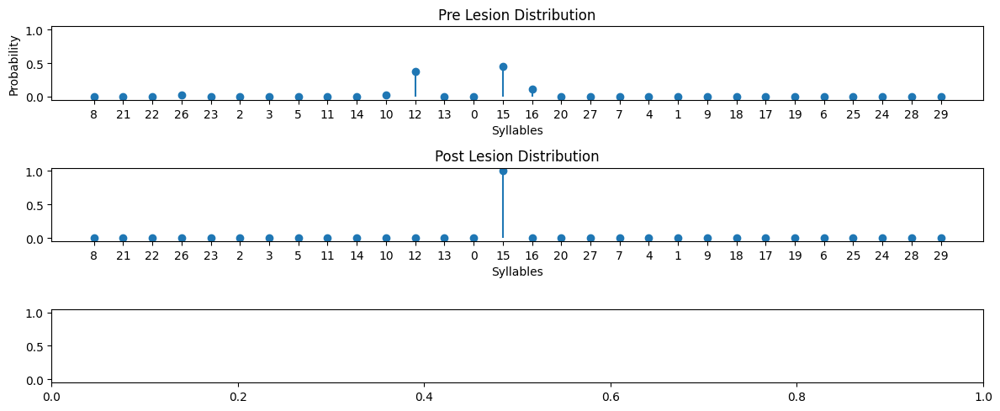

{"Earth Mover's Distance": 1.6571460370937885,
 'Information Gain': 1.176743134809619,
 'Kullback-Leibler Divergence': 8.659712280268858}


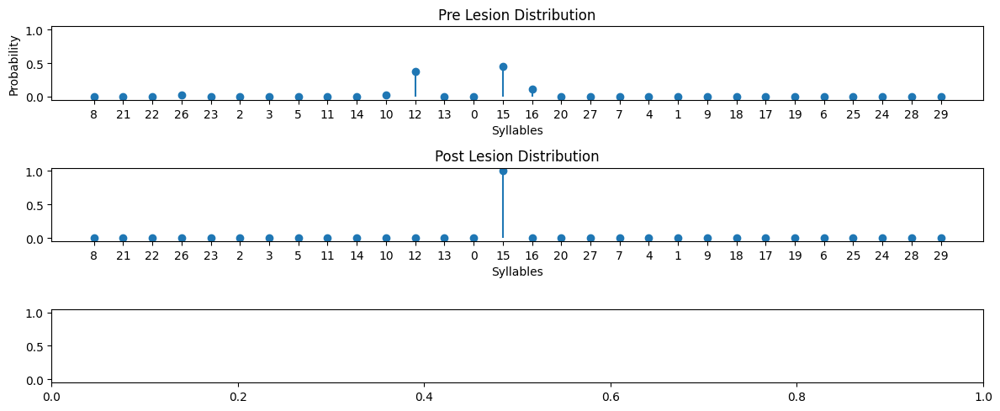

{"Earth Mover's Distance": 1.6571460370937885,
 'Information Gain': 1.176743134809619,
 'Kullback-Leibler Divergence': 8.659712280268858}


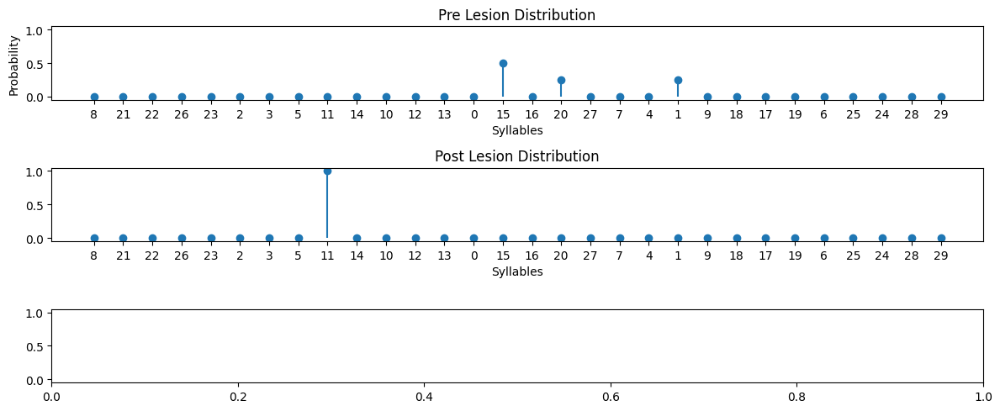

{"Earth Mover's Distance": 8.000000584766,
 'Information Gain': 1.0397224987521105,
 'Kullback-Leibler Divergence': 17.4855361961003}


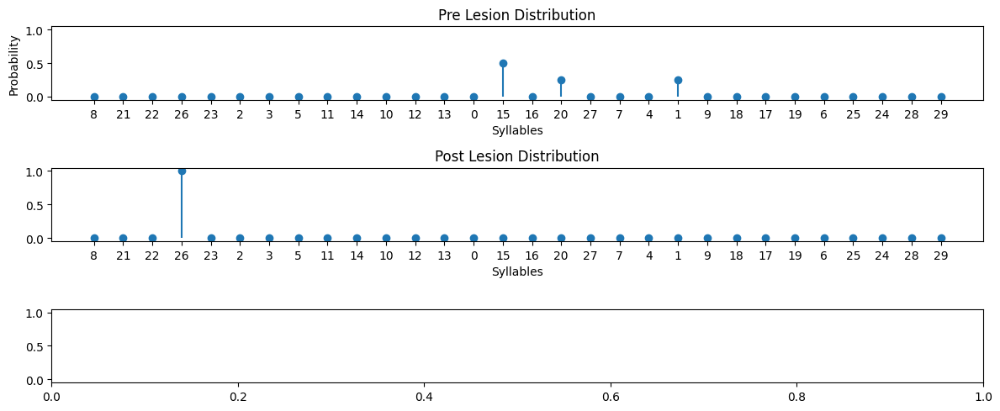

{"Earth Mover's Distance": 13.000006052440035,
 'Information Gain': 1.0397131595296698,
 'Kullback-Leibler Divergence': 16.386924463237968}


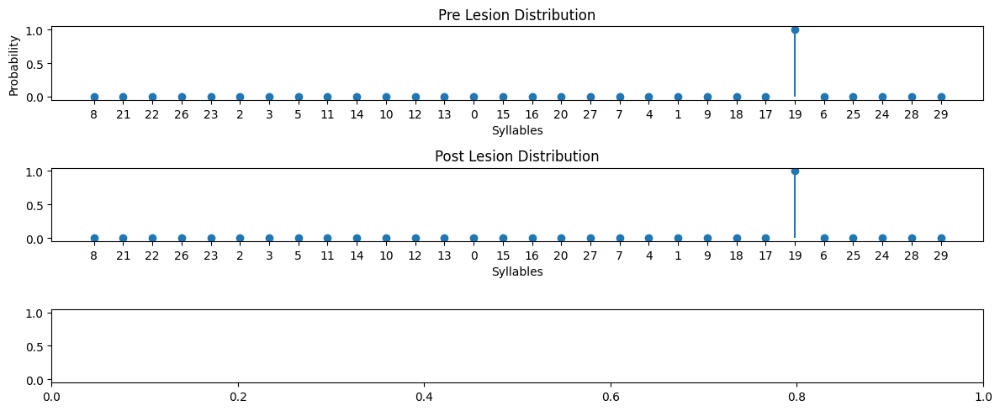

{"Earth Mover's Distance": 1.3484534996884865e-05,
 'Information Gain': 1.43117717760541e-05,
 'Kullback-Leibler Divergence': 3.435002717613748e-07}


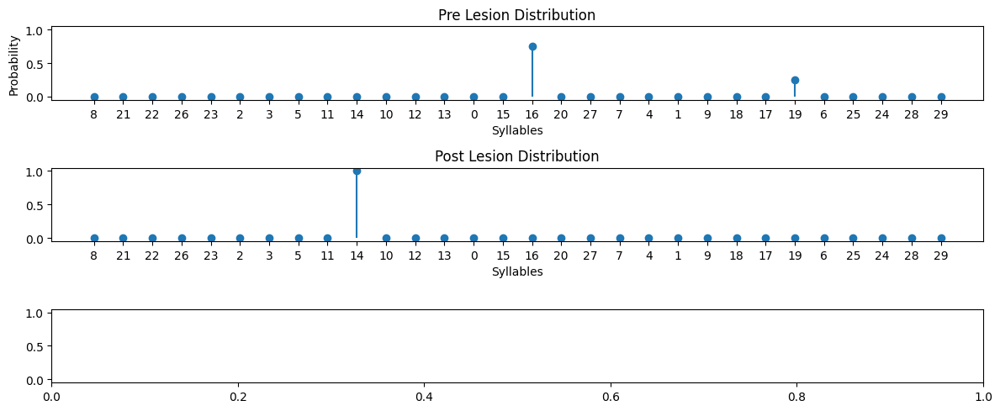

{"Earth Mover's Distance": 8.250006052440023,
 'Information Gain': 0.5623279760576936,
 'Kullback-Leibler Divergence': 16.86430964670994}


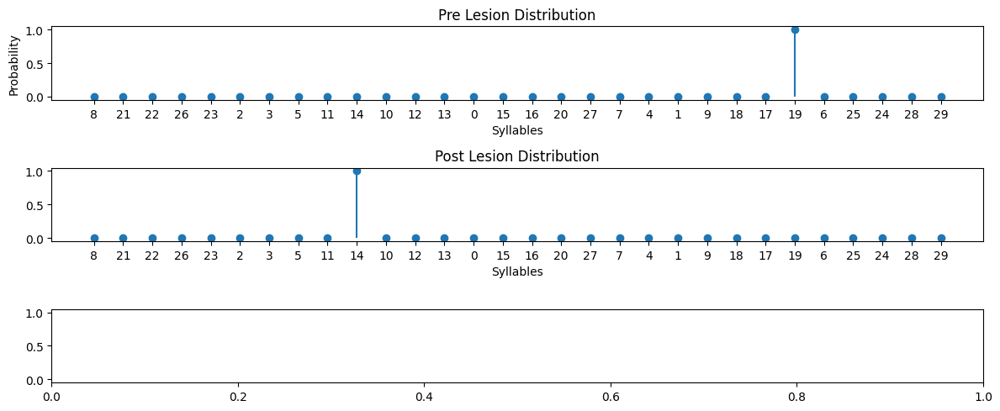

{"Earth Mover's Distance": 14.999998695045,
 'Information Gain': 1.4311771775832057e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}


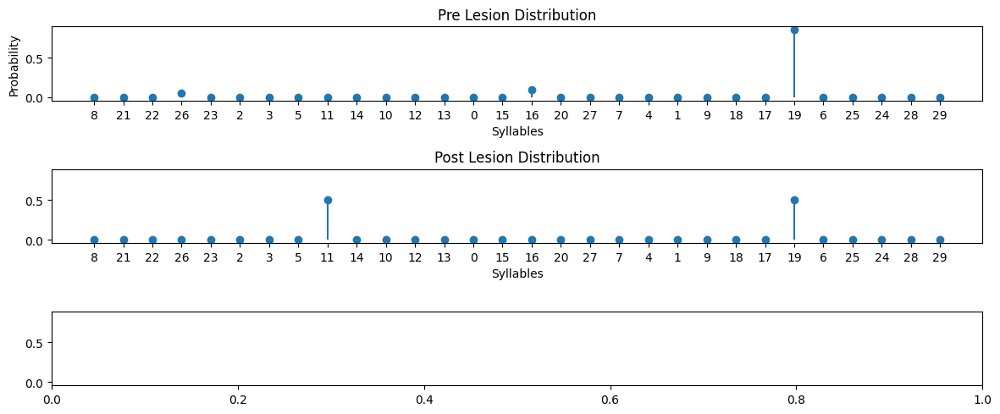

{"Earth Mover's Distance": 6.550004337347511,
 'Information Gain': -0.17496640147480746,
 'Kullback-Leibler Divergence': 2.7889586845375223}


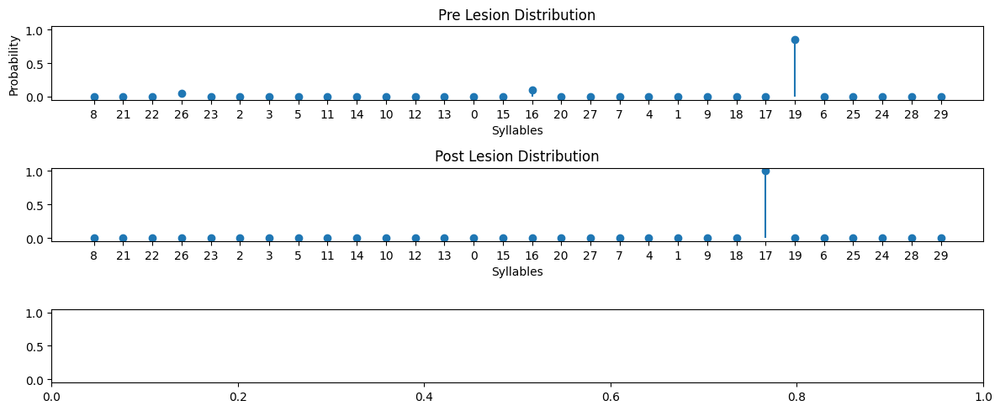

{"Earth Mover's Distance": 2.649998183500003,
 'Information Gain': 0.5181733104955201,
 'Kullback-Leibler Divergence': 16.908464507520225}


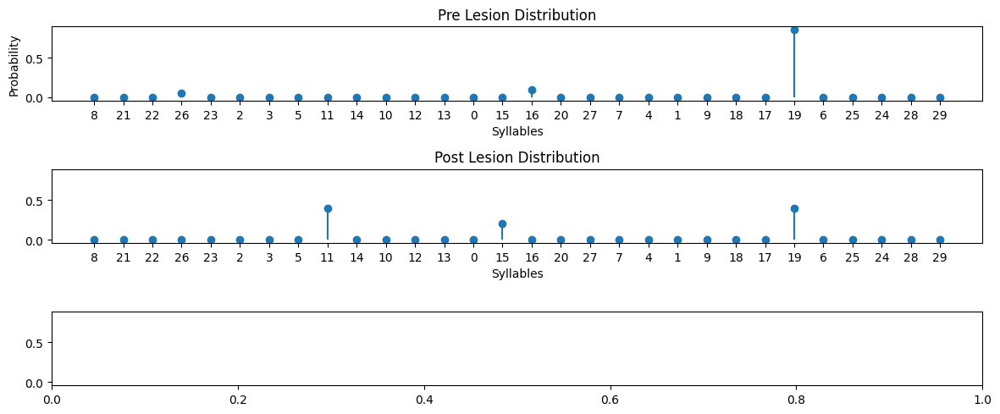

{"Earth Mover's Distance": 6.950001054295996,
 'Information Gain': -0.5367351893169149,
 'Kullback-Leibler Divergence': 3.1160740780440377}


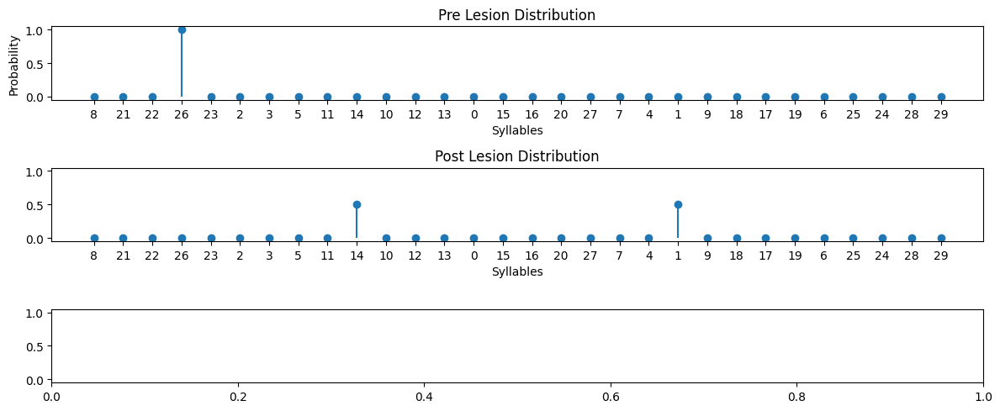

{"Earth Mover's Distance": 11.500019766917472,
 'Information Gain': -0.6931254001985515,
 'Kullback-Leibler Divergence': 18.119768377822442}


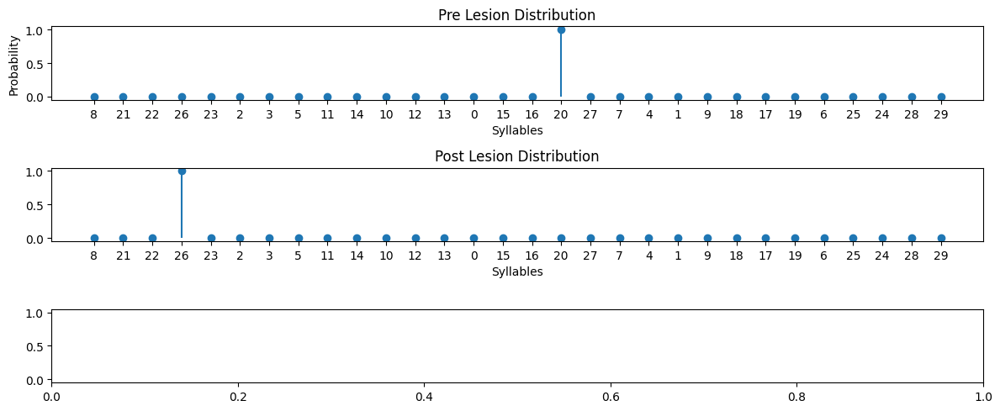

{"Earth Mover's Distance": 13.00000020274499,
 'Information Gain': 4.992943779704252e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}


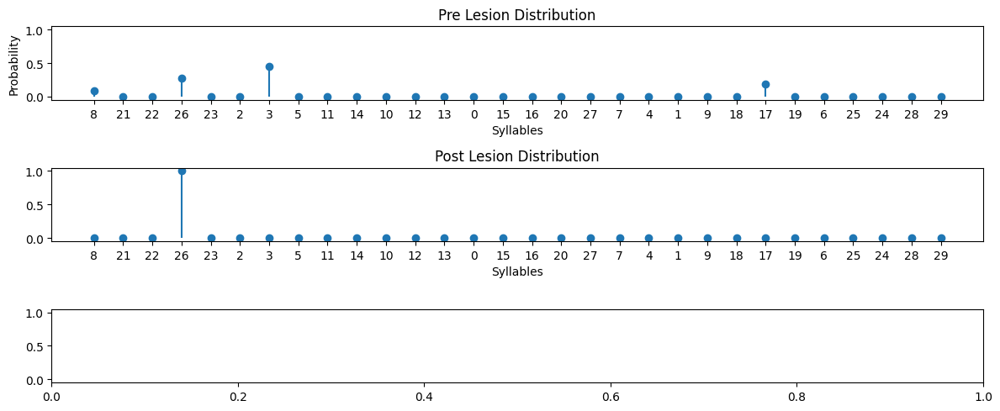

{"Earth Mover's Distance": 5.272737206234865,
 'Information Gain': 1.2406723555034957,
 'Kullback-Leibler Divergence': 11.433243006205318}


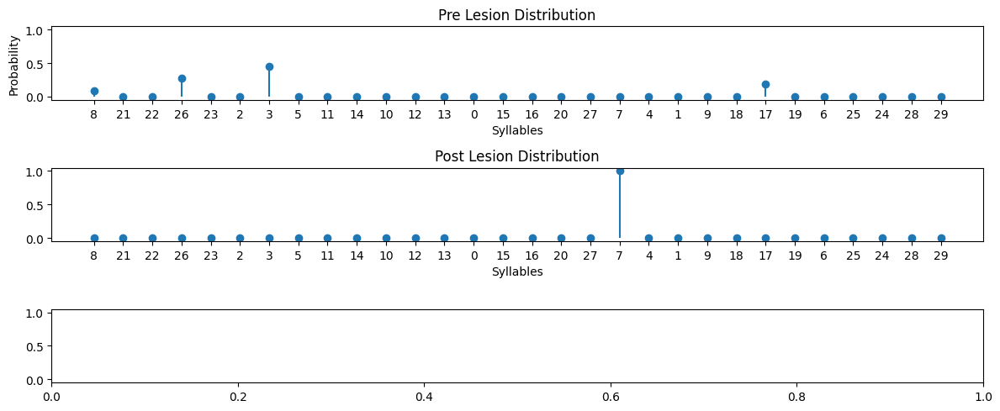

{"Earth Mover's Distance": 12.09091178808665,
 'Information Gain': 1.240672355503496,
 'Kullback-Leibler Divergence': 16.185965422575123}


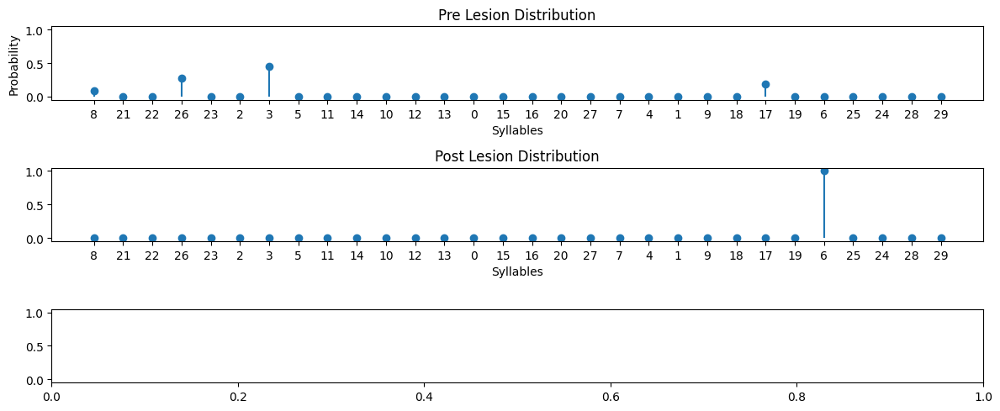

{"Earth Mover's Distance": 17.27272321599682,
 'Information Gain': 1.2406723555034962,
 'Kullback-Leibler Divergence': 16.185965422575123}


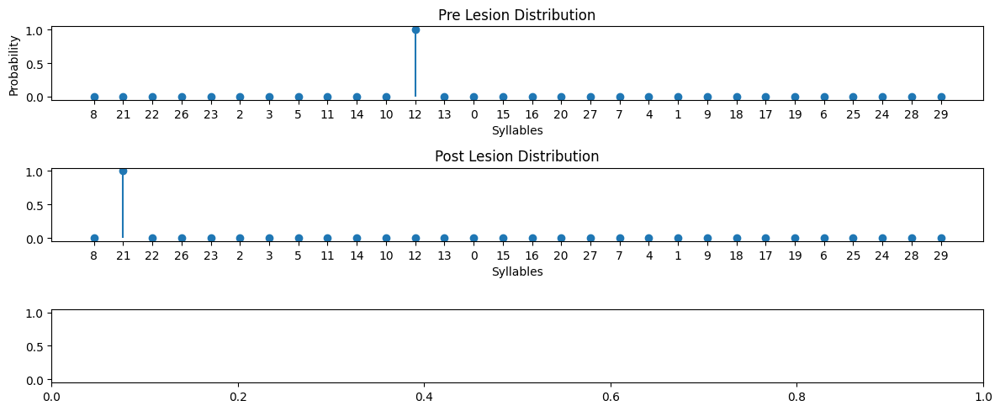

{"Earth Mover's Distance": 10.00000033131498,
 'Information Gain': 4.992943781924647e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}


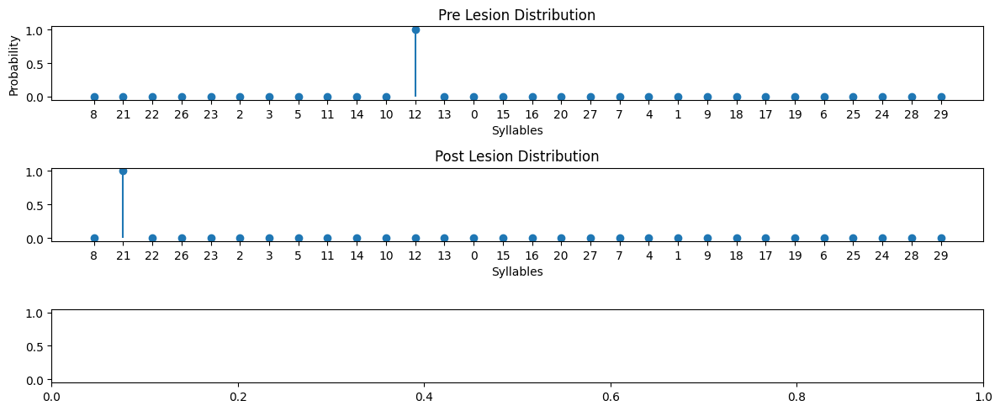

{"Earth Mover's Distance": 10.00000033131498,
 'Information Gain': 4.992943781924647e-07,
 'Kullback-Leibler Divergence': 17.42663687941331}


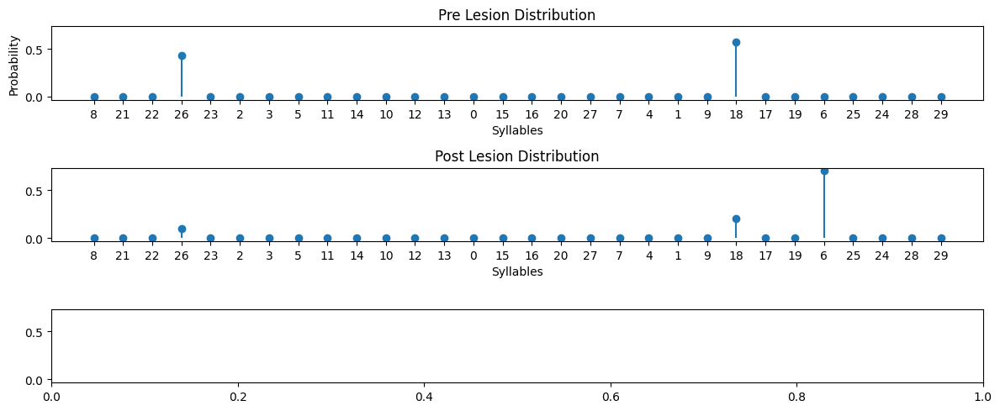

{"Earth Mover's Distance": 8.342859607709215,
 'Information Gain': -0.11890765770608624,
 'Kullback-Leibler Divergence': 1.2235925373430387}


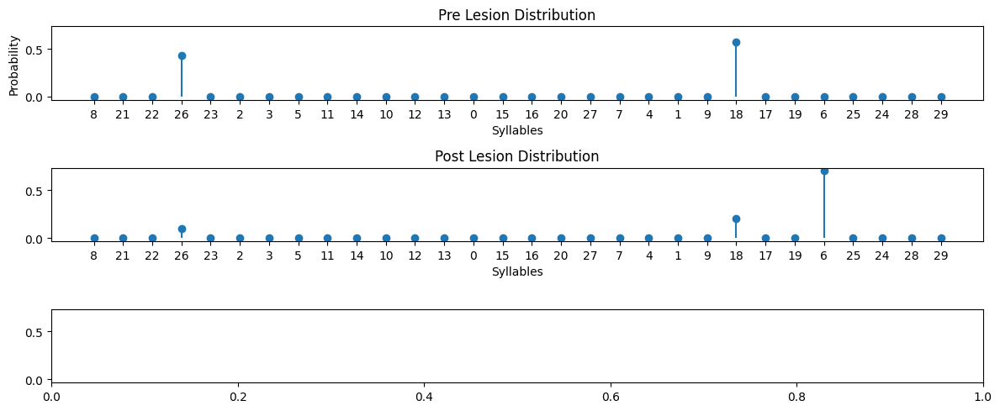

{"Earth Mover's Distance": 8.342859607709215,
 'Information Gain': -0.11890765770608624,
 'Kullback-Leibler Divergence': 1.2235925373430387}


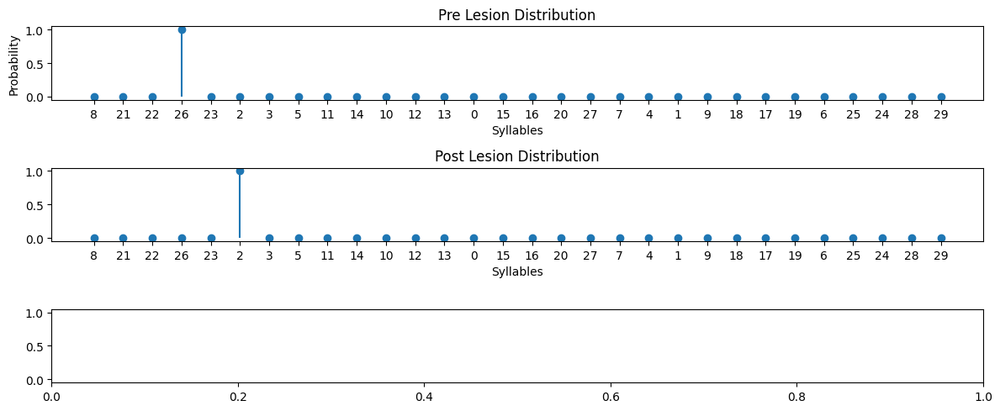

{"Earth Mover's Distance": 2.000013484534951,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


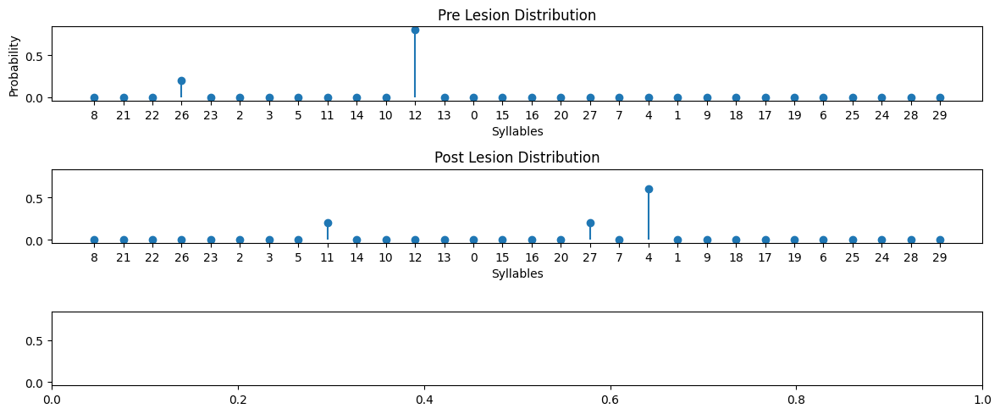

{"Earth Mover's Distance": 7.000002696906989,
 'Information Gain': -0.44986499614996767,
 'Kullback-Leibler Divergence': 18.53568063927428}


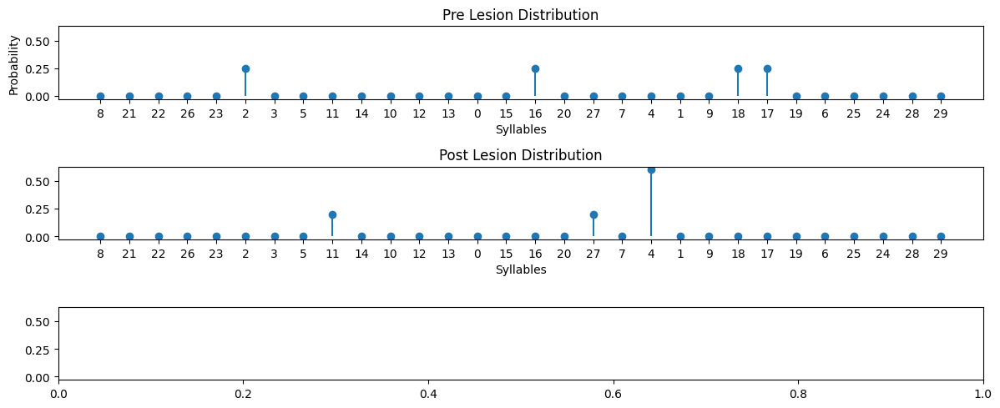

{"Earth Mover's Distance": 3.6500025200344,
 'Information Gain': 0.43602747646951046,
 'Kullback-Leibler Divergence': 17.649788017141546}


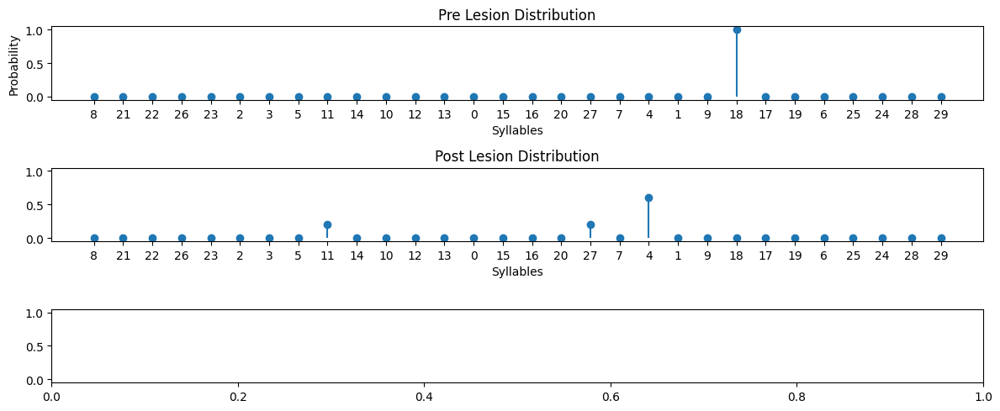

{"Earth Mover's Distance": 5.600001569089799,
 'Information Gain': -0.9502445778088626,
 'Kullback-Leibler Divergence': 19.03605782872415}


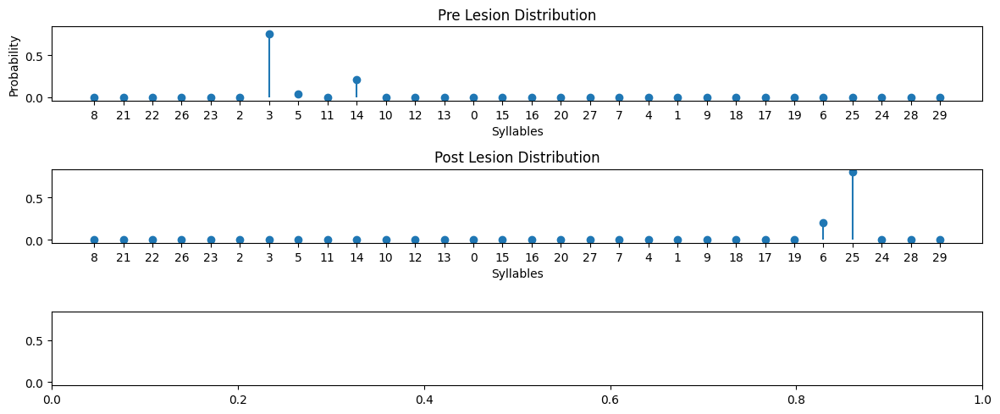

{"Earth Mover's Distance": 19.133332507095584,
 'Information Gain': 0.17457072461074352,
 'Kullback-Leibler Divergence': 18.361113419005328}


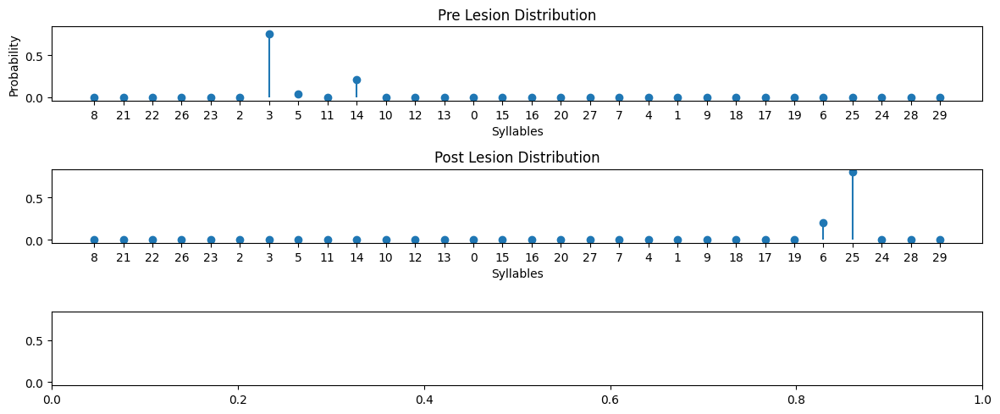

{"Earth Mover's Distance": 19.133332507095584,
 'Information Gain': 0.17457072461074352,
 'Kullback-Leibler Divergence': 18.361113419005328}


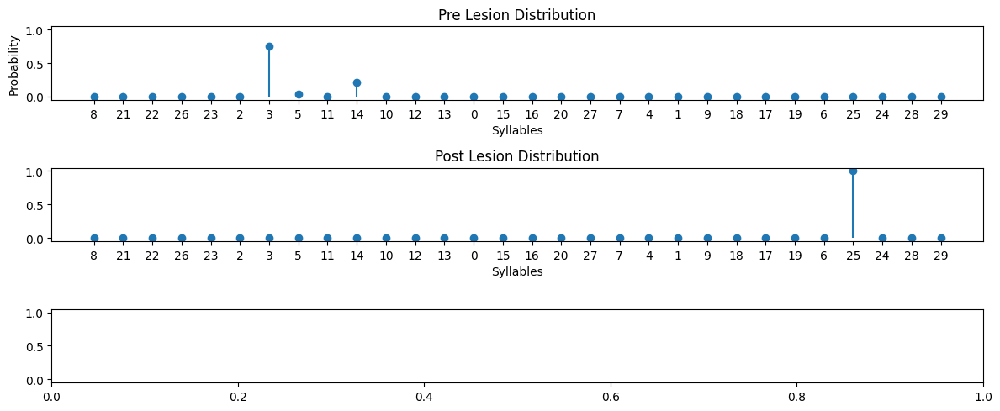

{"Earth Mover's Distance": 19.333328291819583,
 'Information Gain': 0.6749616694582451,
 'Kullback-Leibler Divergence': 16.75167617703119}


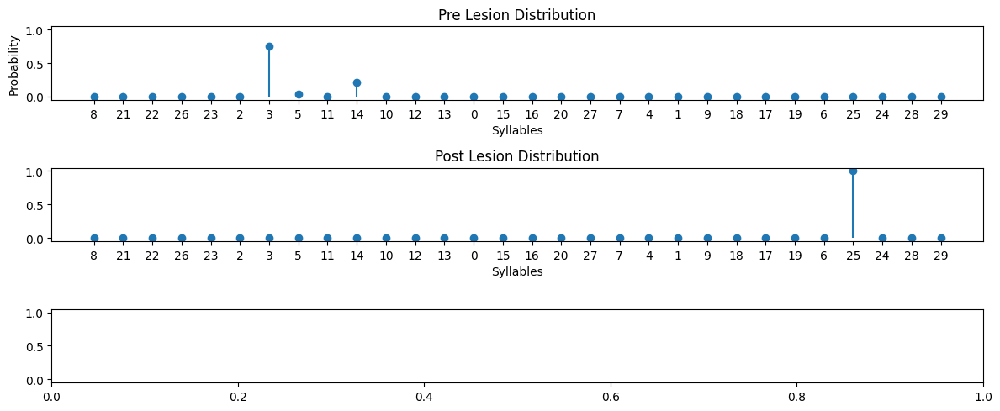

{"Earth Mover's Distance": 19.333328291819583,
 'Information Gain': 0.6749616694582451,
 'Kullback-Leibler Divergence': 16.75167617703119}


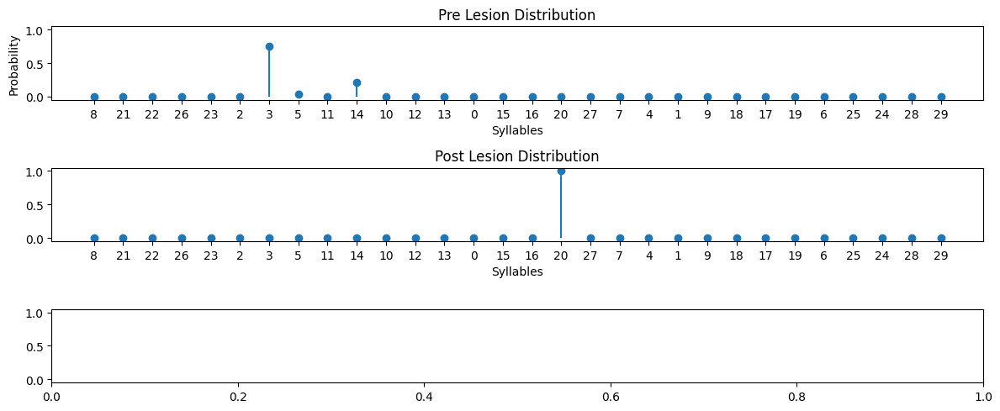

{"Earth Mover's Distance": 9.333339409003763,
 'Information Gain': 0.6749616694582449,
 'Kullback-Leibler Divergence': 16.75167617703119}


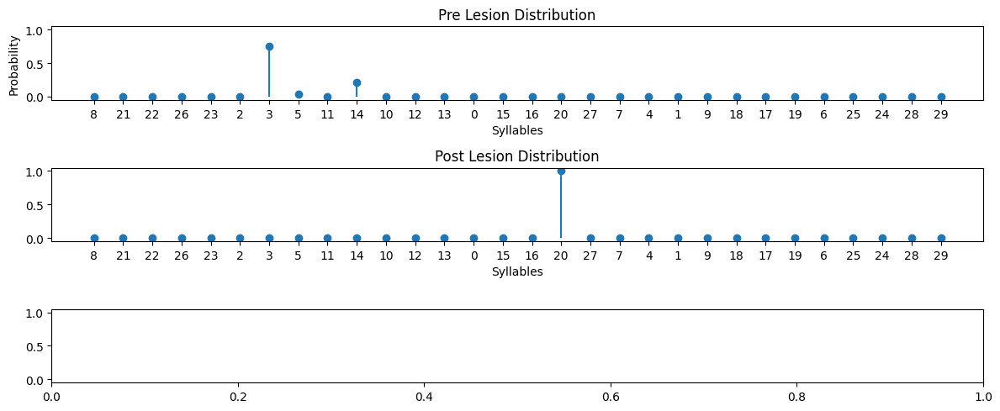

{"Earth Mover's Distance": 9.333339409003763,
 'Information Gain': 0.6749616694582449,
 'Kullback-Leibler Divergence': 16.75167617703119}


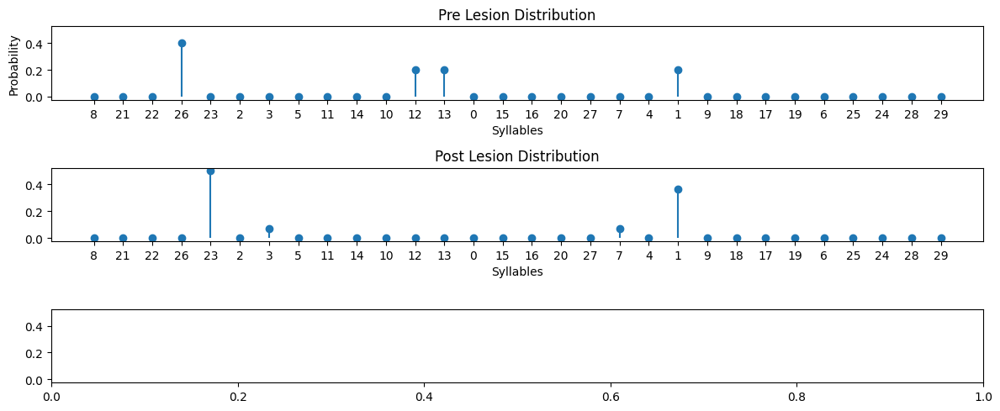

{"Earth Mover's Distance": 3.2000036370649063,
 'Information Gain': 0.2566594021467101,
 'Kullback-Leibler Divergence': 15.530755747963049}


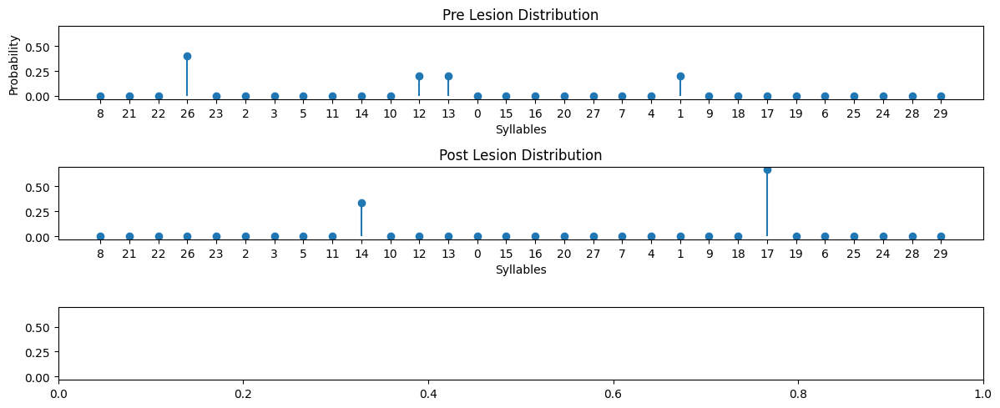

{"Earth Mover's Distance": 8.533334354938331,
 'Information Gain': 0.6956653469620935,
 'Kullback-Leibler Divergence': 17.19307937508867}


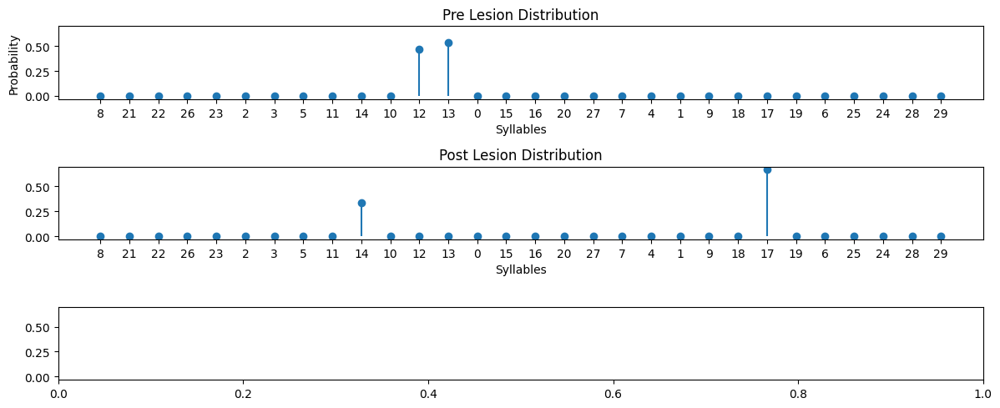

{"Earth Mover's Distance": 8.133333682628333,
 'Information Gain': 0.05440510076991023,
 'Kullback-Leibler Divergence': 17.834339975291766}


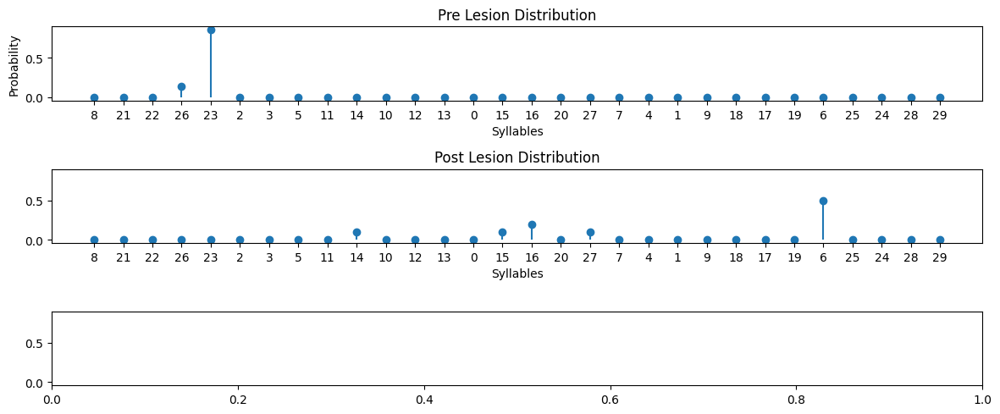

{"Earth Mover's Distance": 15.64285960770918,
 'Information Gain': -0.9491173773411624,
 'Kullback-Leibler Divergence': 19.319115315452706}


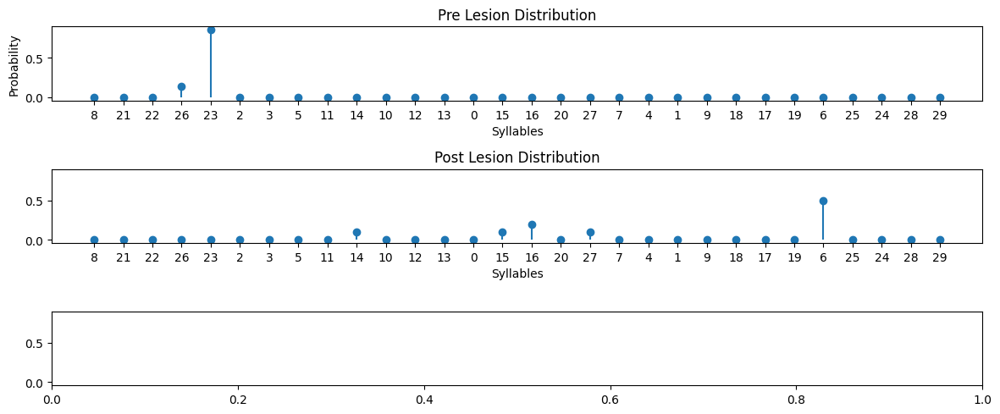

{"Earth Mover's Distance": 15.64285960770918,
 'Information Gain': -0.9491173773411624,
 'Kullback-Leibler Divergence': 19.319115315452706}


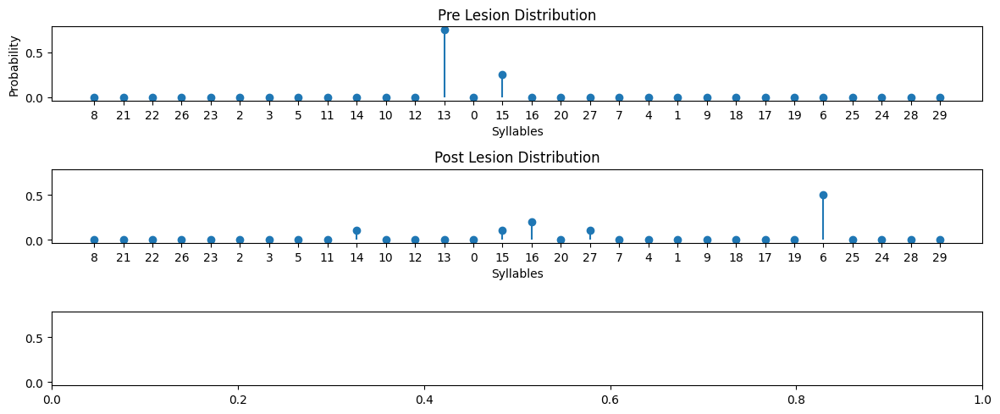

{"Earth Mover's Distance": 7.600004509857104,
 'Information Gain': -0.7968956003438445,
 'Kullback-Leibler Divergence': 14.810231951475725}


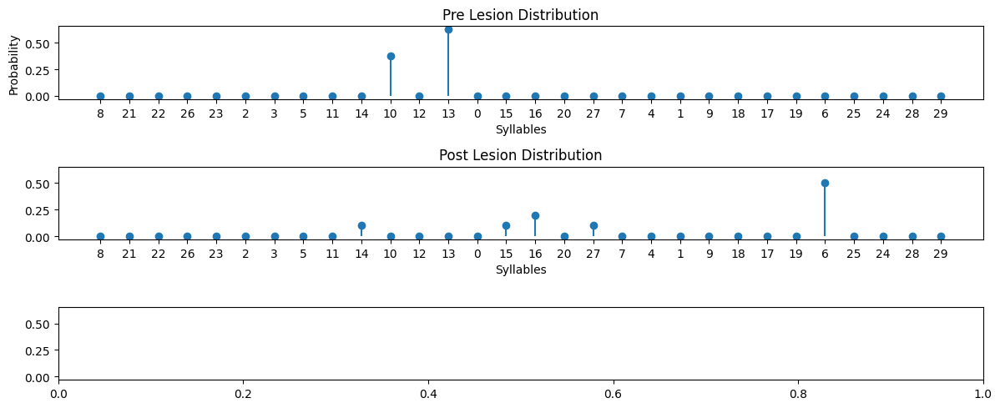

{"Earth Mover's Distance": 8.450001913677987,
 'Information Gain': -0.6976710286652202,
 'Kullback-Leibler Divergence': 19.067669056244505}


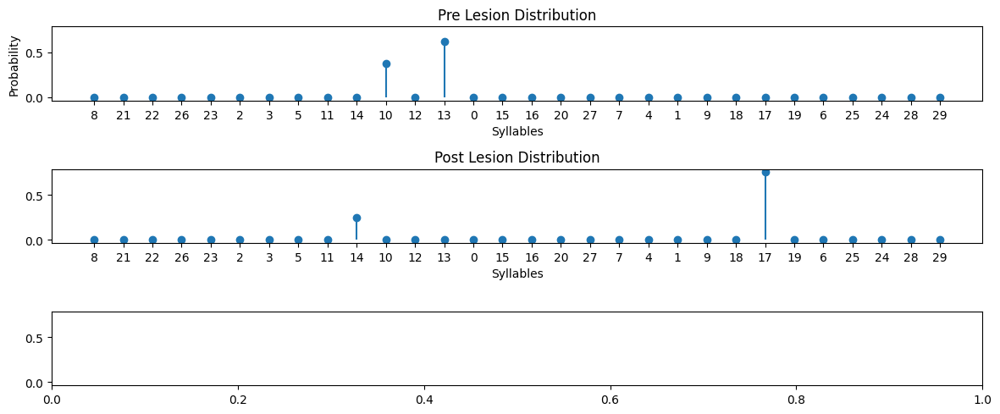

{"Earth Mover's Distance": 8.750000110026232,
 'Information Gain': 0.09922819749083922,
 'Kullback-Leibler Divergence': 18.15137882048595}


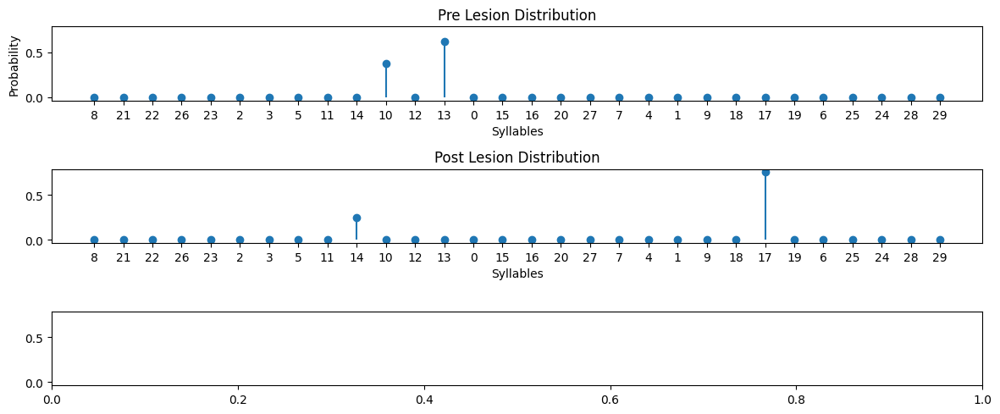

{"Earth Mover's Distance": 8.750000110026232,
 'Information Gain': 0.09922819749083922,
 'Kullback-Leibler Divergence': 18.15137882048595}


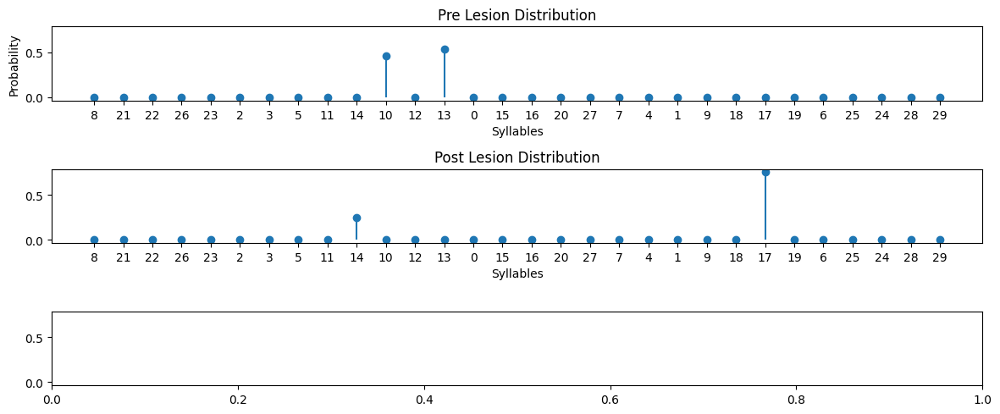

{"Earth Mover's Distance": 8.923077028891514,
 'Information Gain': 0.12784810912031275,
 'Kullback-Leibler Divergence': 18.122759083147162}


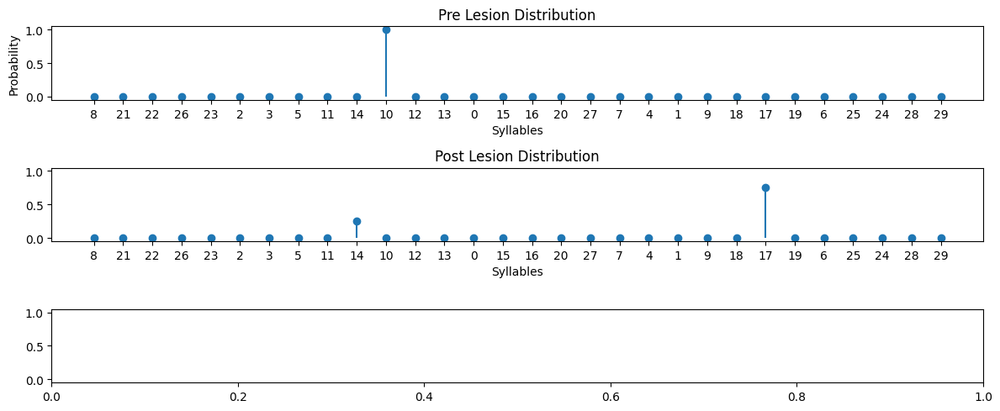

{"Earth Mover's Distance": 10.000021922813739,
 'Information Gain': -0.5623100384737028,
 'Kullback-Leibler Divergence': 18.81291529418081}


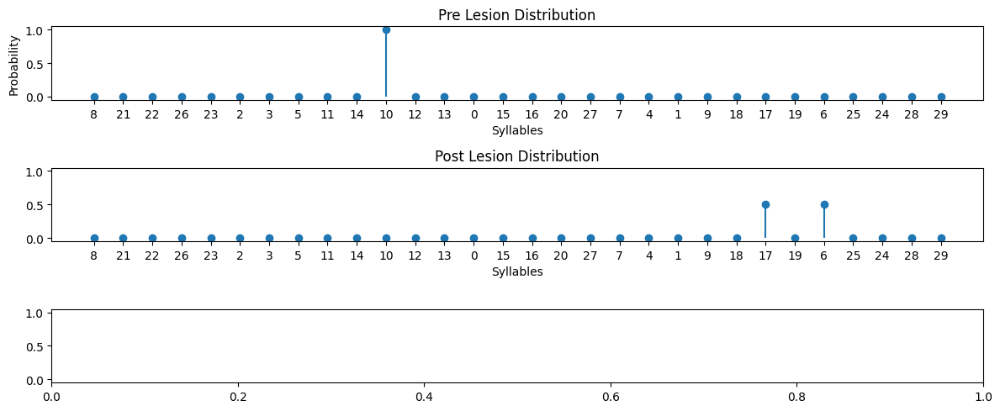

{"Earth Mover's Distance": 14.000019766917495,
 'Information Gain': -0.6931254001985513,
 'Kullback-Leibler Divergence': 18.119768377822442}


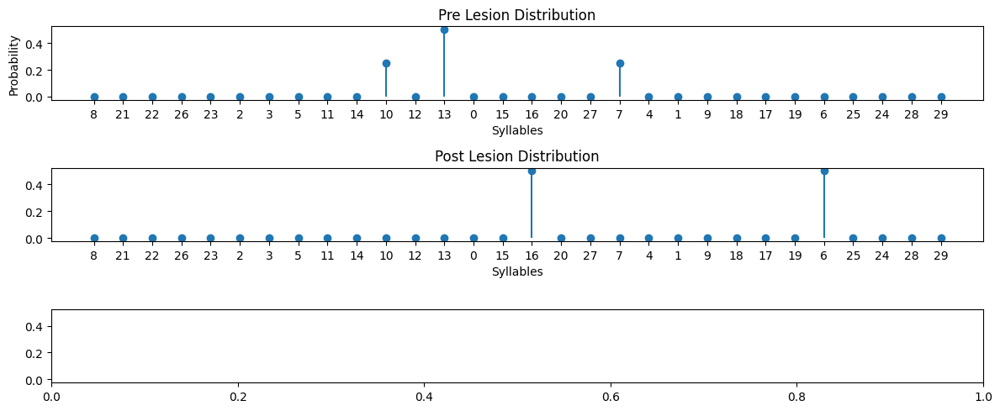

{"Earth Mover's Distance": 7.0000002299425015,
 'Information Gain': 0.3465734475593426,
 'Kullback-Leibler Divergence': 17.080070994423004}


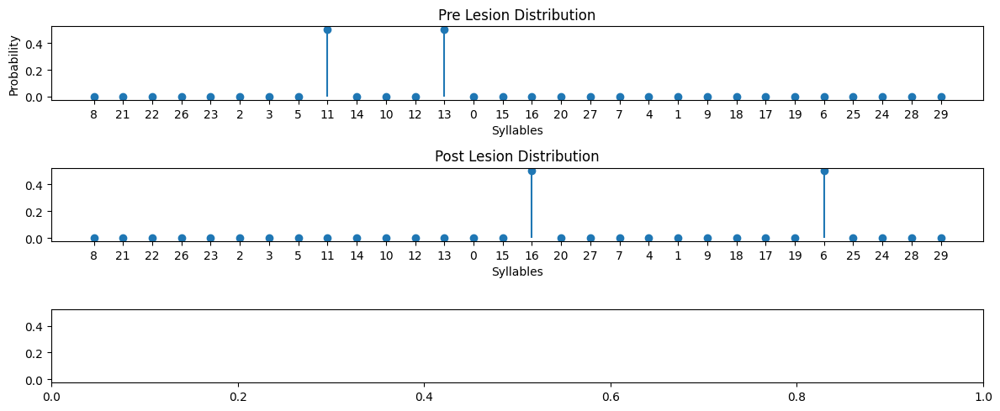

{"Earth Mover's Distance": 10.000006742267505,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}


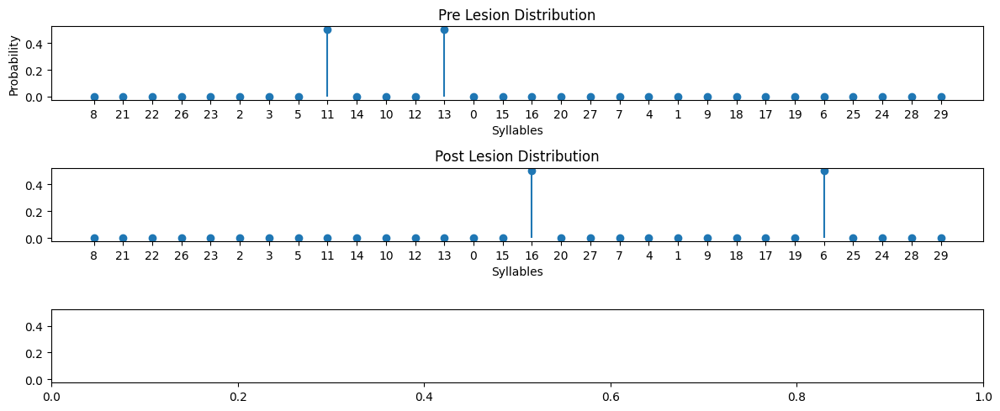

{"Earth Mover's Distance": 10.000006742267505,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}


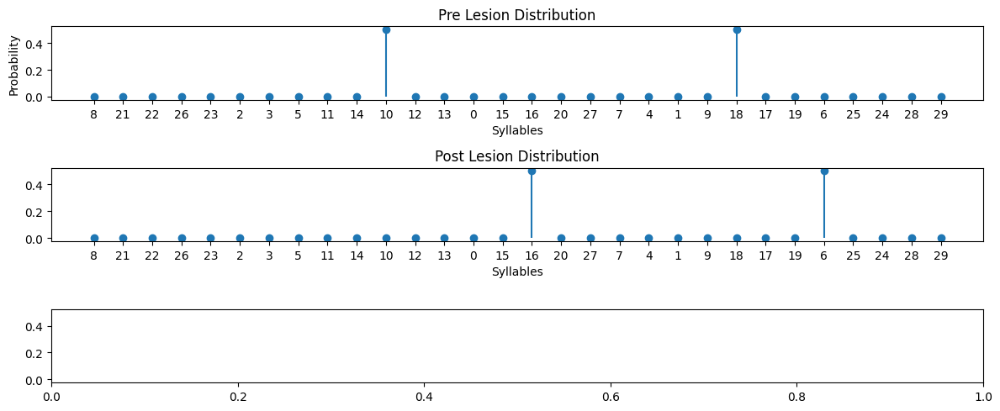

{"Earth Mover's Distance": 4.000006742267494,
 'Information Gain': 6.90913978729224e-06,
 'Kullback-Leibler Divergence': 17.426637044722657}


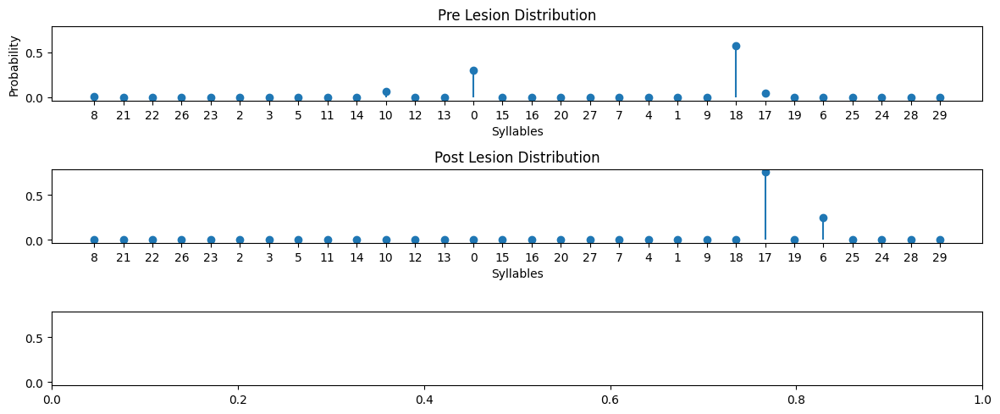

{"Earth Mover's Distance": 5.185183999437389,
 'Information Gain': 0.49267363034517786,
 'Kullback-Leibler Divergence': 16.84310579480594}


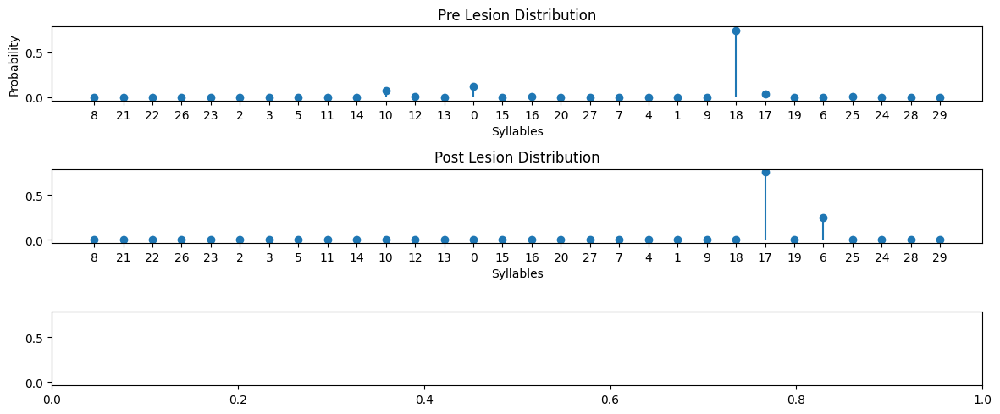

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}


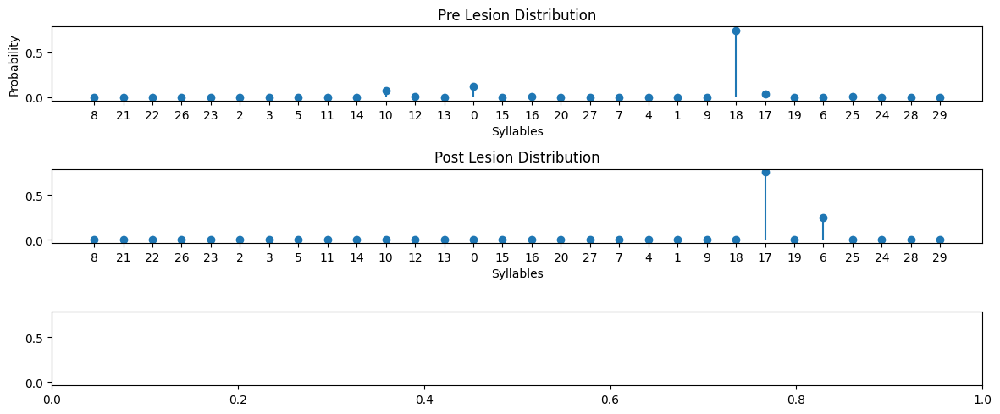

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}


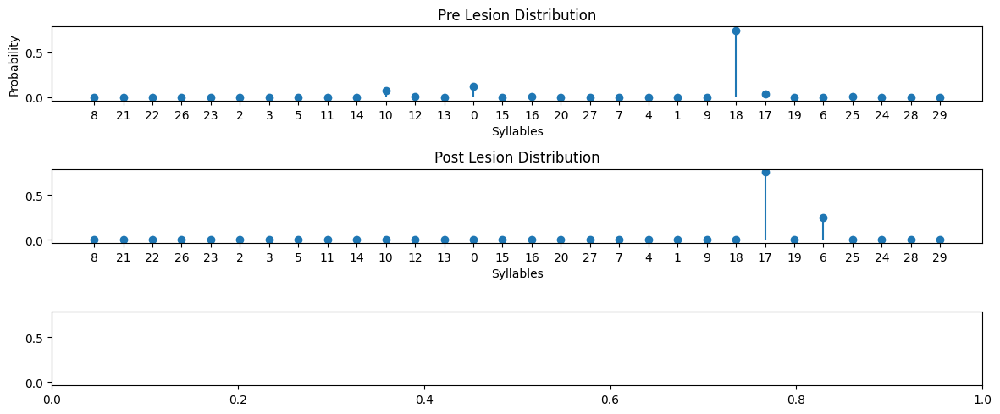

{"Earth Mover's Distance": 3.540322090942942,
 'Information Gain': 0.3295169776358726,
 'Kullback-Leibler Divergence': 17.17410384576285}


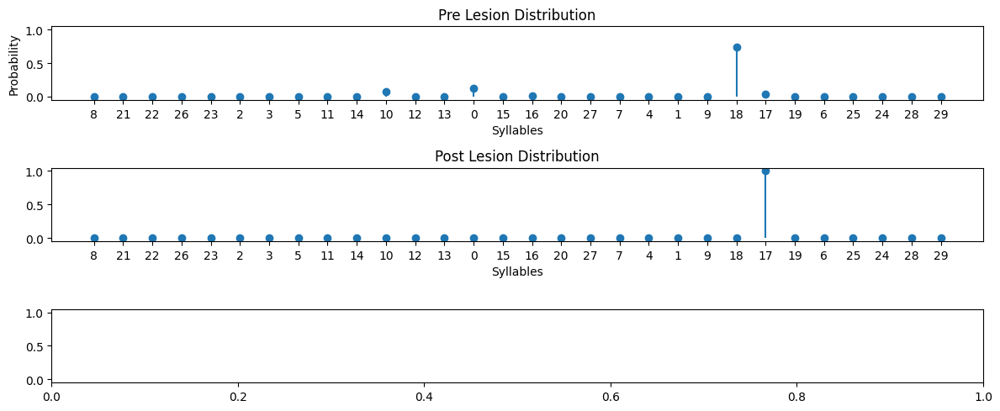

{"Earth Mover's Distance": 3.056452229190825,
 'Information Gain': 0.8918413278813516,
 'Kullback-Leibler Divergence': 15.832108978380786}


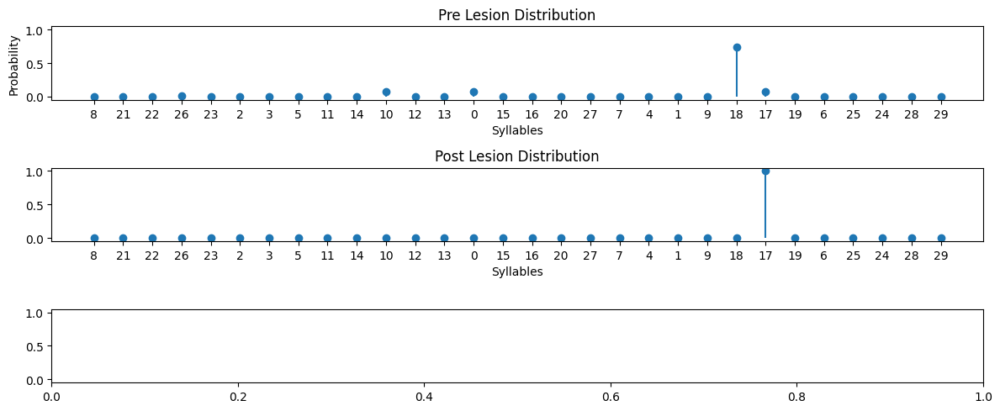

{"Earth Mover's Distance": 2.8888869290043693,
 'Information Gain': 0.8875889189164976,
 'Kullback-Leibler Divergence': 15.155981388159777}


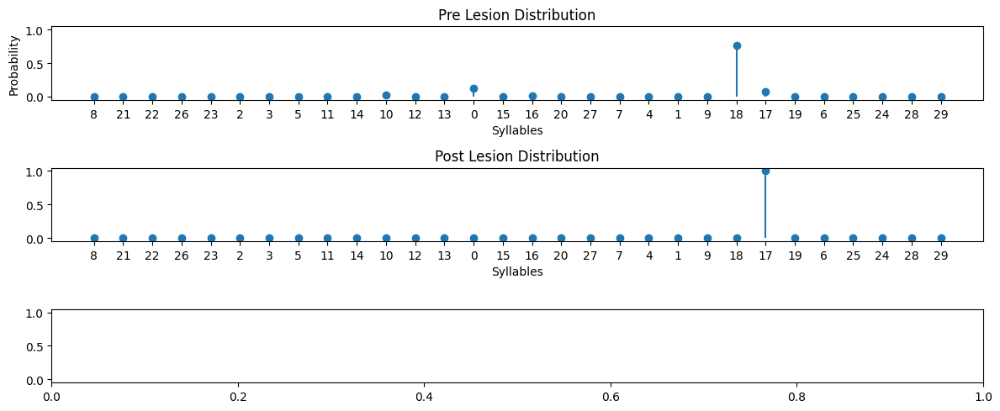

{"Earth Mover's Distance": 2.435820491461568,
 'Information Gain': 0.8002479325414149,
 'Kullback-Leibler Divergence': 15.325893553815462}


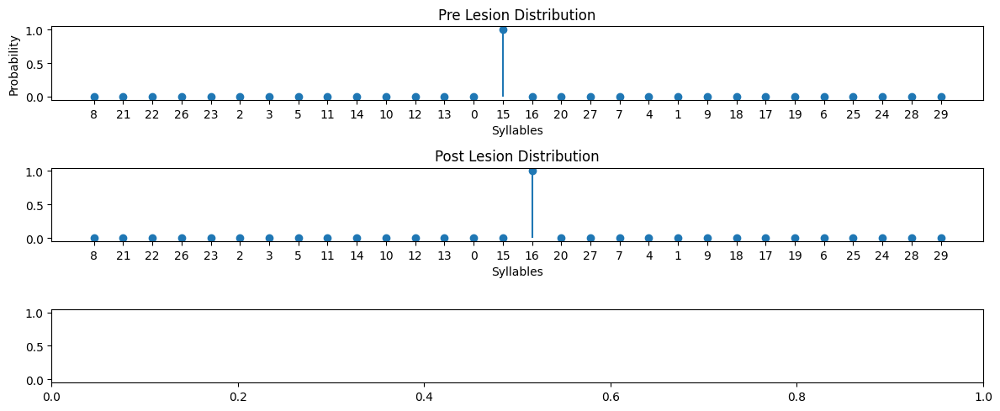

{"Earth Mover's Distance": 1.0000134845349846,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


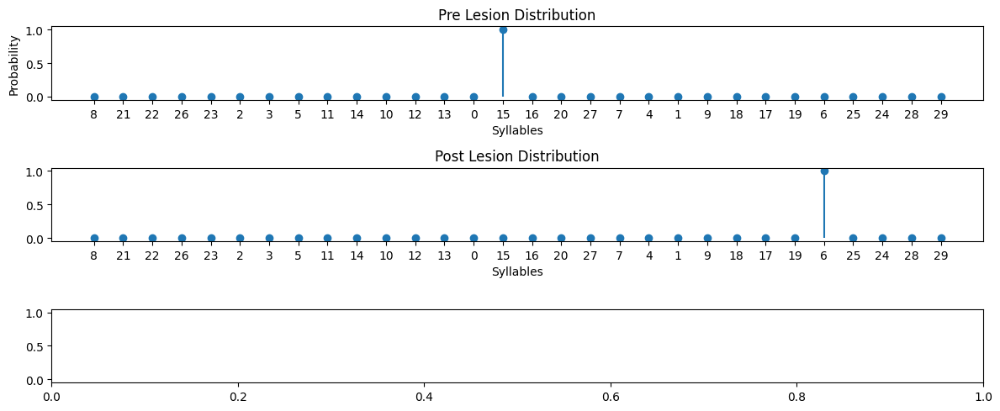

{"Earth Mover's Distance": 11.000019766917497,
 'Information Gain': 2.1259830145249686e-05,
 'Kullback-Leibler Divergence': 18.119769315231782}


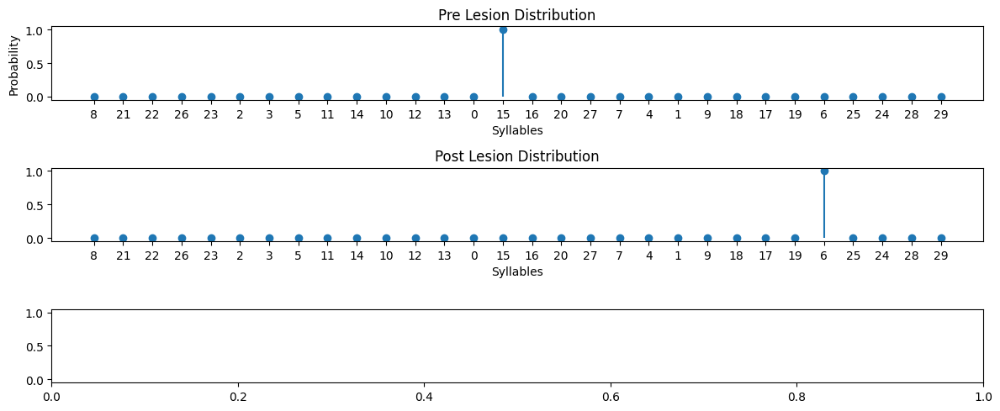

{"Earth Mover's Distance": 11.000013484534996,
 'Information Gain': 1.4311771776276148e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


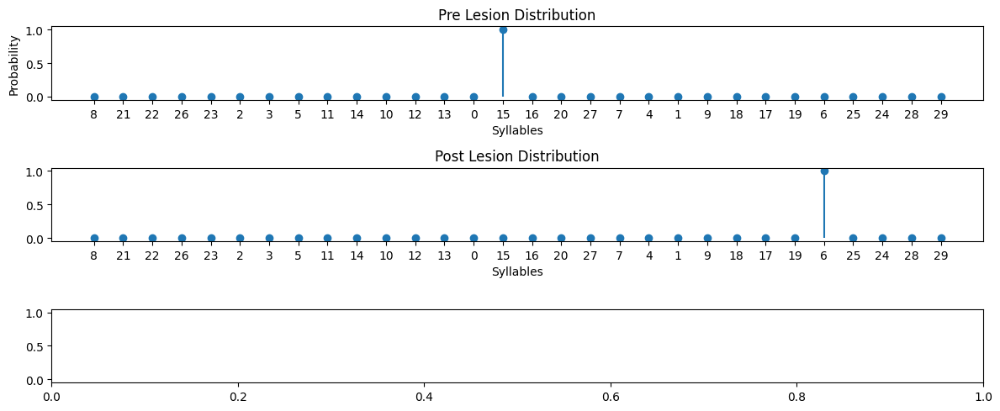

{"Earth Mover's Distance": 11.000013484534996,
 'Information Gain': 1.4311771776276148e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


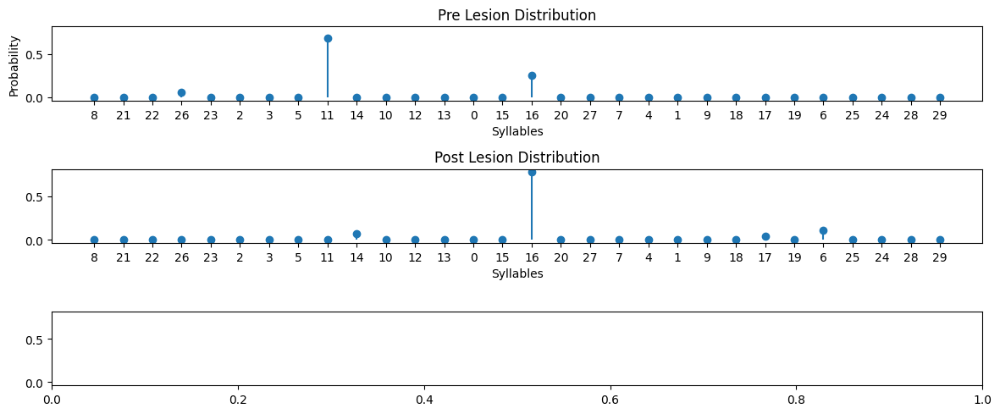

{"Earth Mover's Distance": 6.5254641256825385,
 'Information Gain': 0.023000747988902615,
 'Kullback-Leibler Divergence': 14.827231183208692}


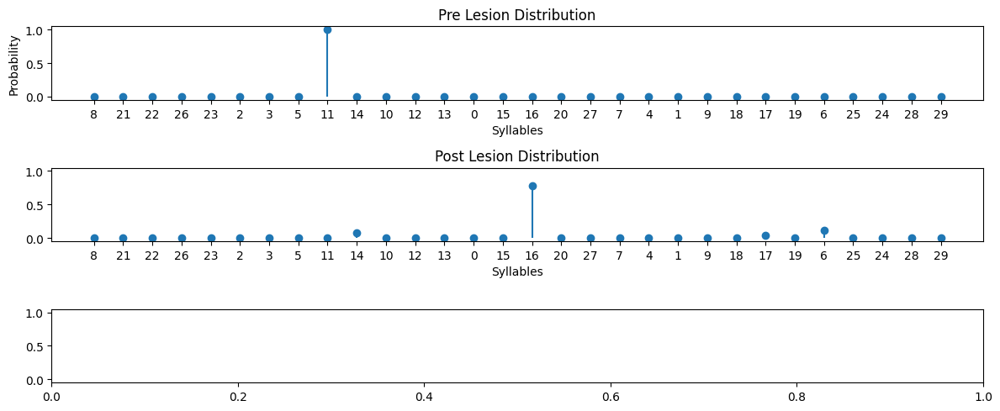

{"Earth Mover's Distance": 7.962988546901289,
 'Information Gain': -0.7544345022016341,
 'Kullback-Leibler Divergence': 20.722455464568437}


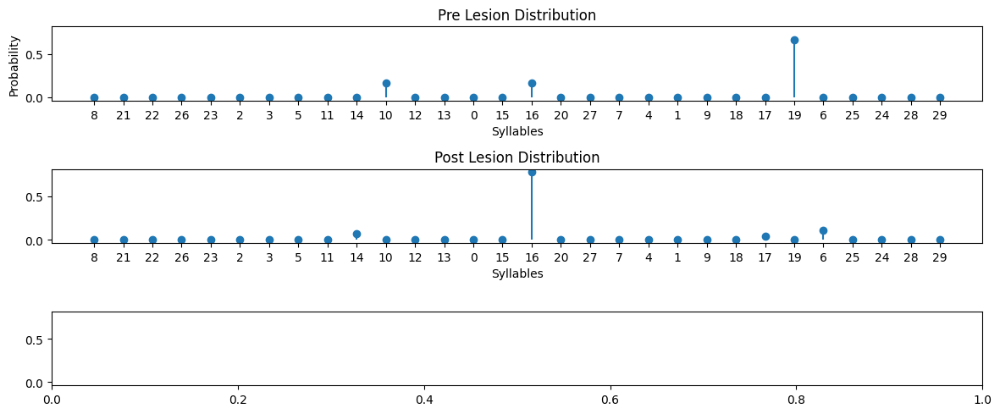

{"Earth Mover's Distance": 5.35185256040241,
 'Information Gain': 0.11310468252935557,
 'Kullback-Leibler Divergence': 16.443058392989002}


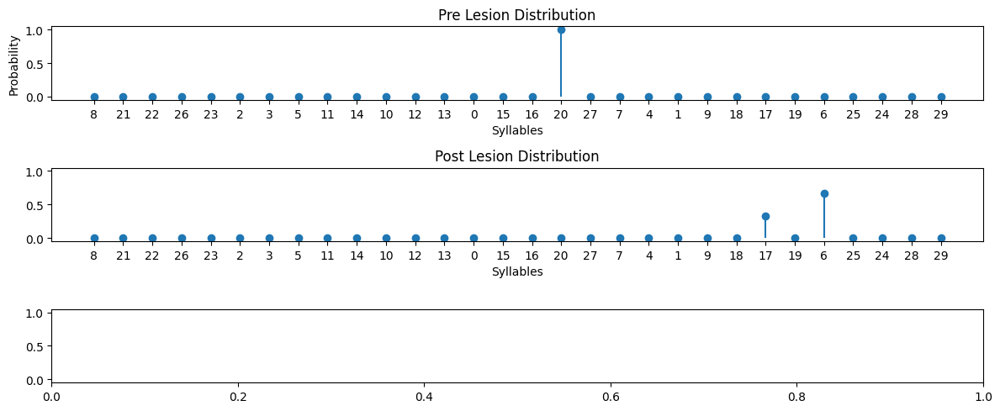

{"Earth Mover's Distance": 8.333355194378328,
 'Information Gain': -0.6364901829913666,
 'Kullback-Leibler Divergence': 18.525233311995628}


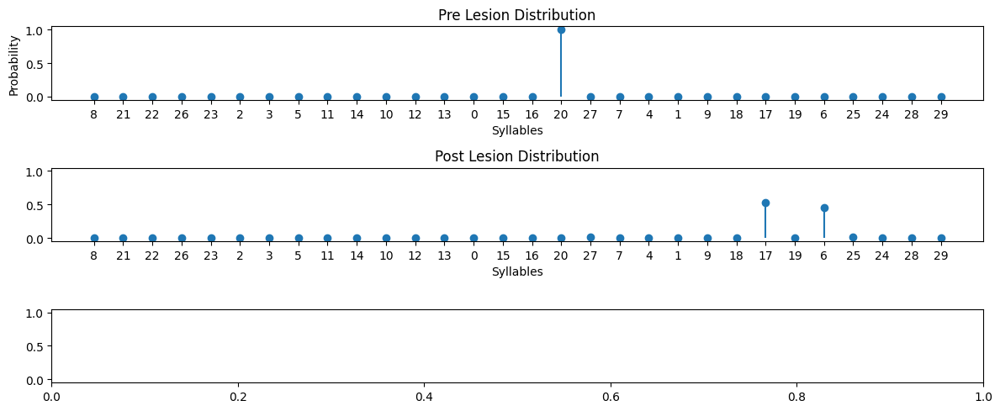

{"Earth Mover's Distance": 7.895187238293827,
 'Information Gain': -0.7735666951523167,
 'Kullback-Leibler Divergence': 22.246899951271086}


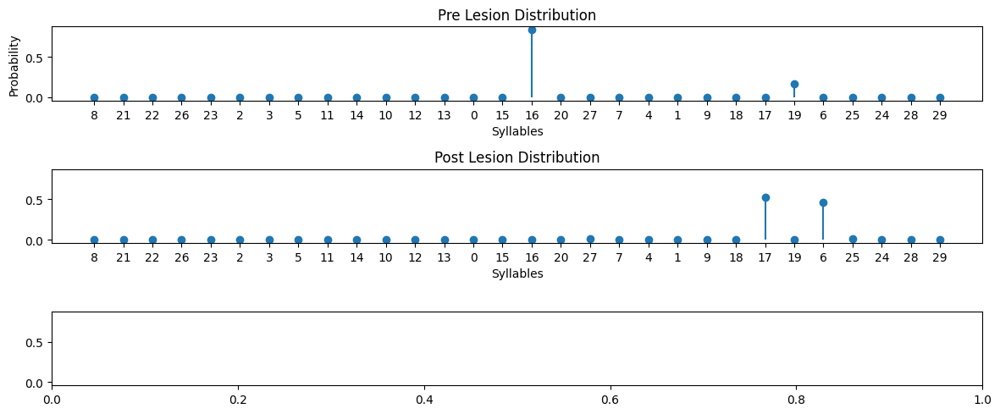

{"Earth Mover's Distance": 7.395165530543835,
 'Information Gain': -0.3230292500815218,
 'Kullback-Leibler Divergence': 21.796366143947296}


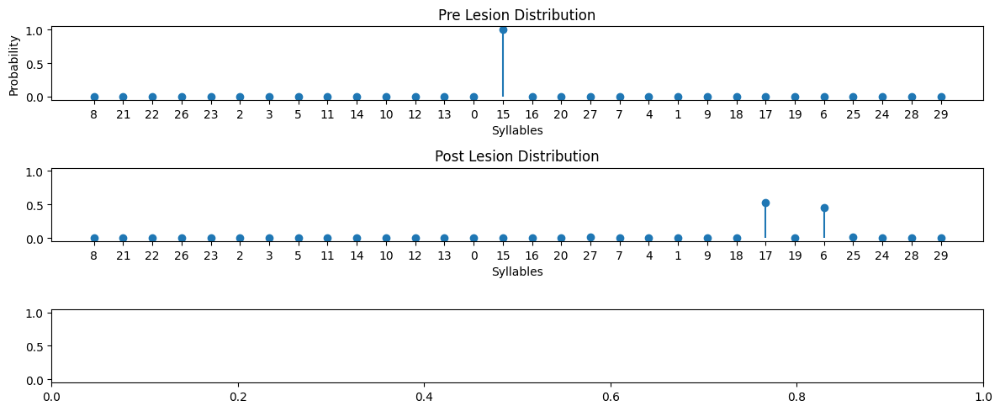

{"Earth Mover's Distance": 9.895187238293827,
 'Information Gain': -0.7735666951523167,
 'Kullback-Leibler Divergence': 22.24689995127109}


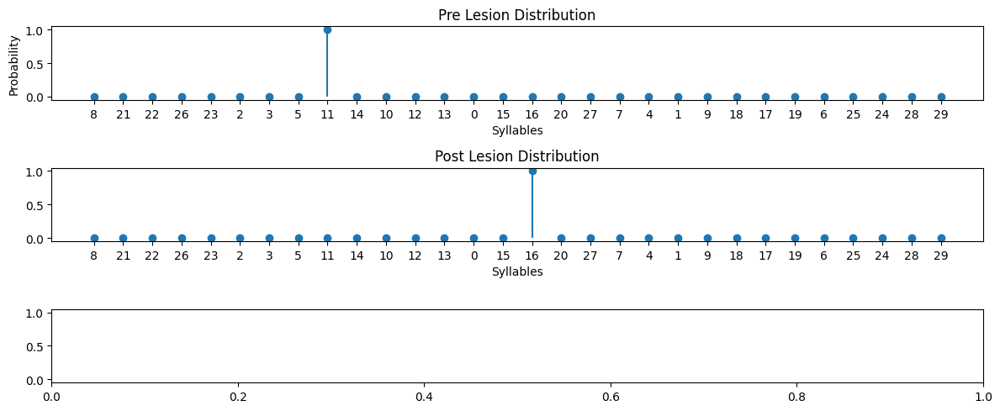

{"Earth Mover's Distance": 7.00001348453498,
 'Information Gain': 1.431177177583206e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


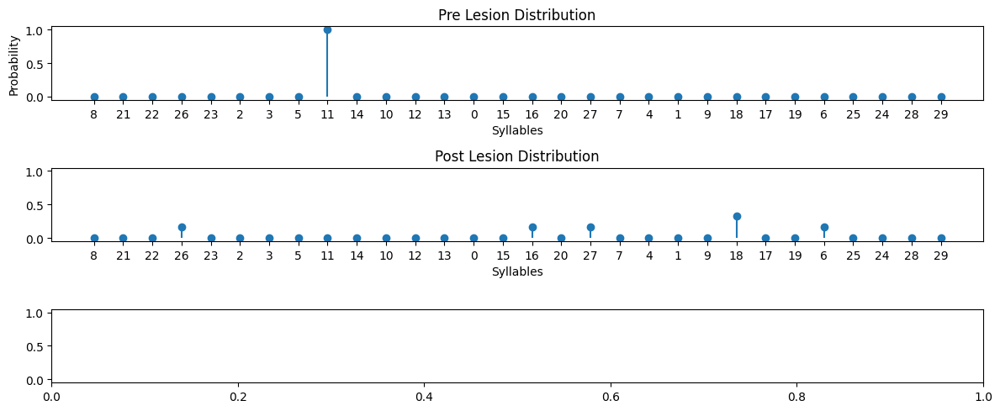

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}


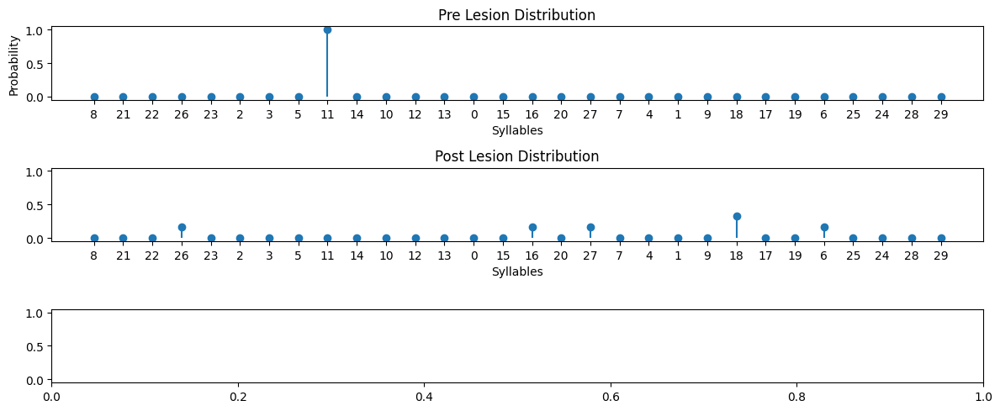

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}


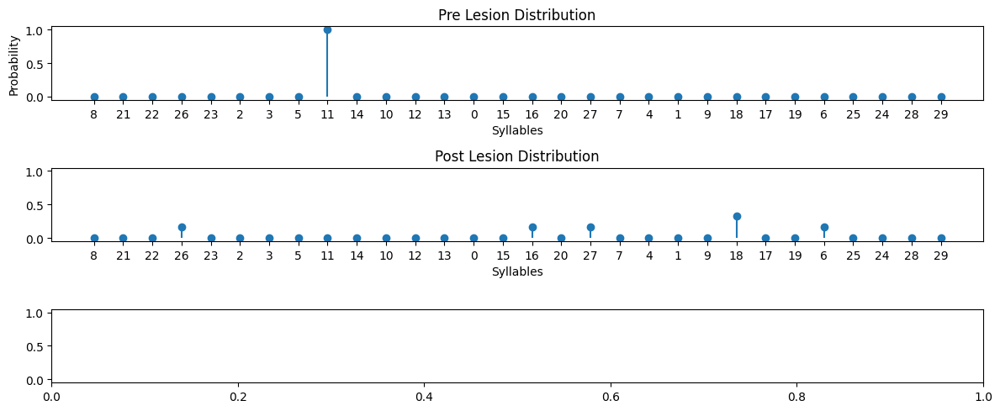

{"Earth Mover's Distance": 11.000005738782491,
 'Information Gain': -1.5607023331246594,
 'Kullback-Leibler Divergence': 19.21839928117754}


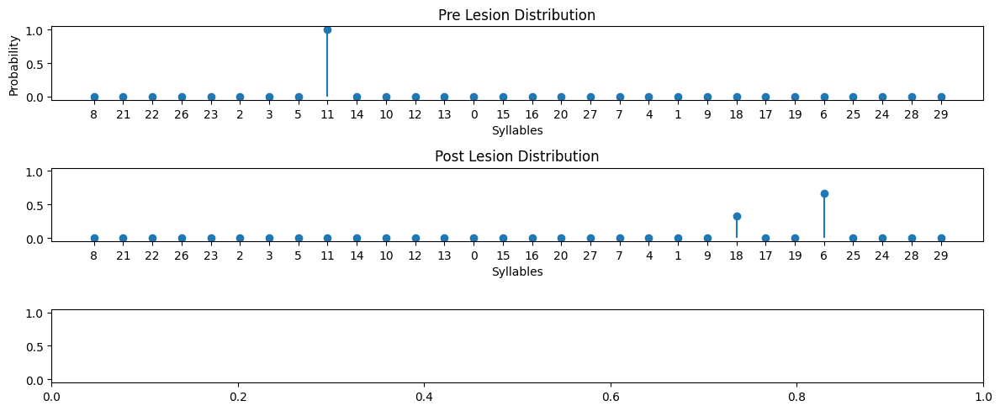

{"Earth Mover's Distance": 16.000004494844998,
 'Information Gain': -0.6365087554203263,
 'Kullback-Leibler Divergence': 18.525253211963033}


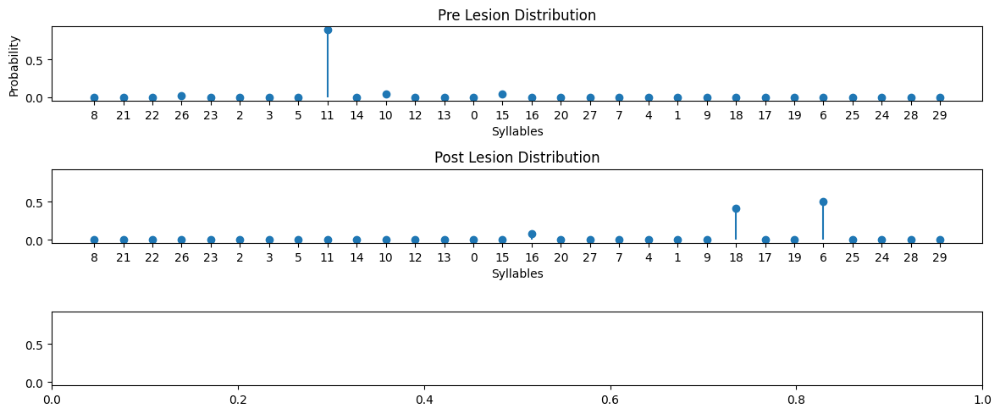

{"Earth Mover's Distance": 14.666666497374372,
 'Information Gain': -0.44449986643721306,
 'Kullback-Leibler Divergence': 19.43762900491851}


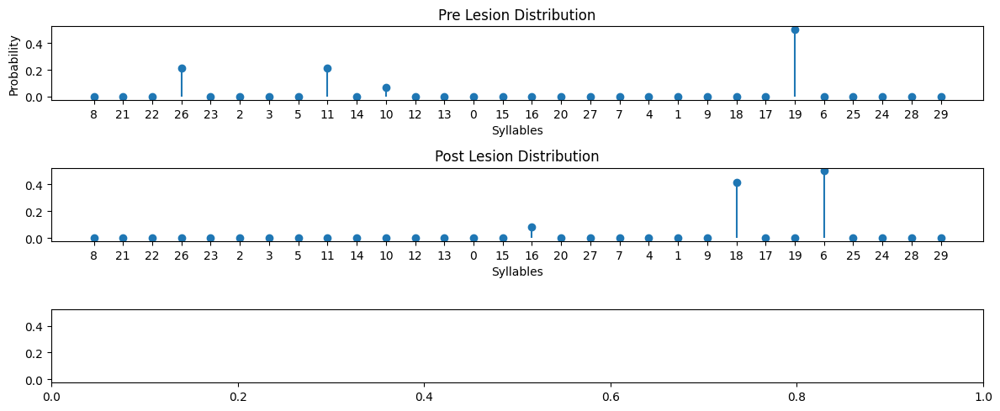

{"Earth Mover's Distance": 7.845238908838622,
 'Information Gain': 0.27684141158443987,
 'Kullback-Leibler Divergence': 18.716287574984957}


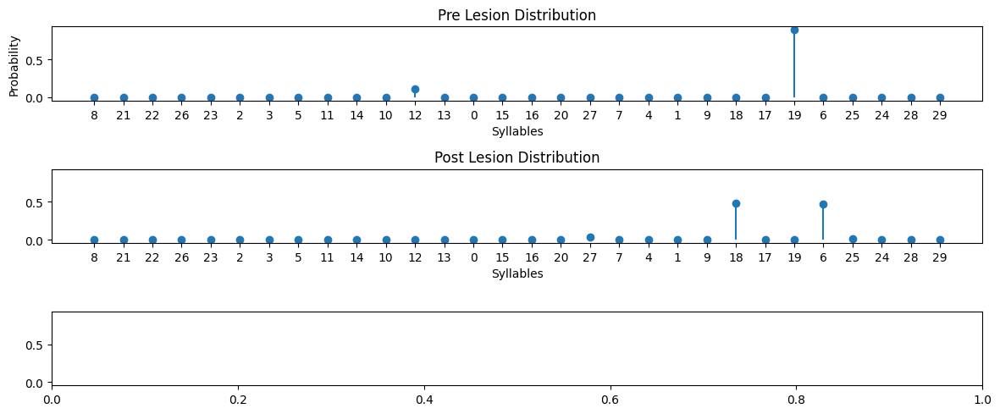

{"Earth Mover's Distance": 2.306605327922502,
 'Information Gain': -0.5668828303081331,
 'Kullback-Leibler Divergence': 23.820695627231228}


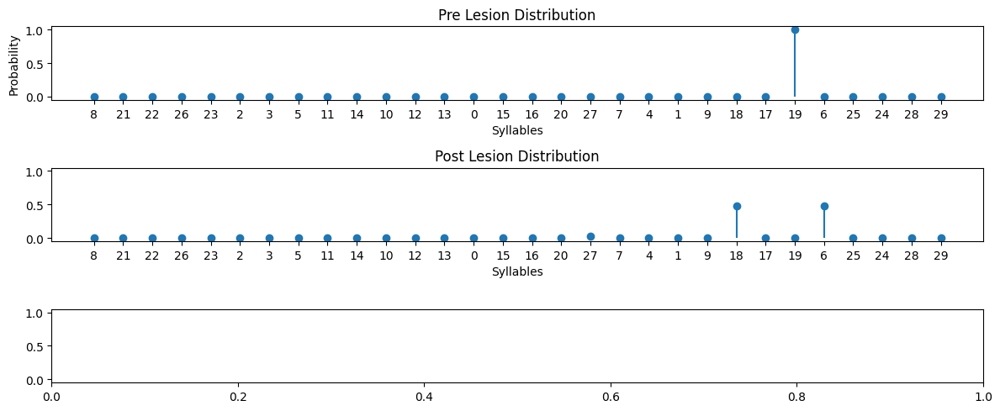

{"Earth Mover's Distance": 1.85376669836498,
 'Information Gain': -0.9156895917222155,
 'Kullback-Leibler Divergence': 24.169494448427724}


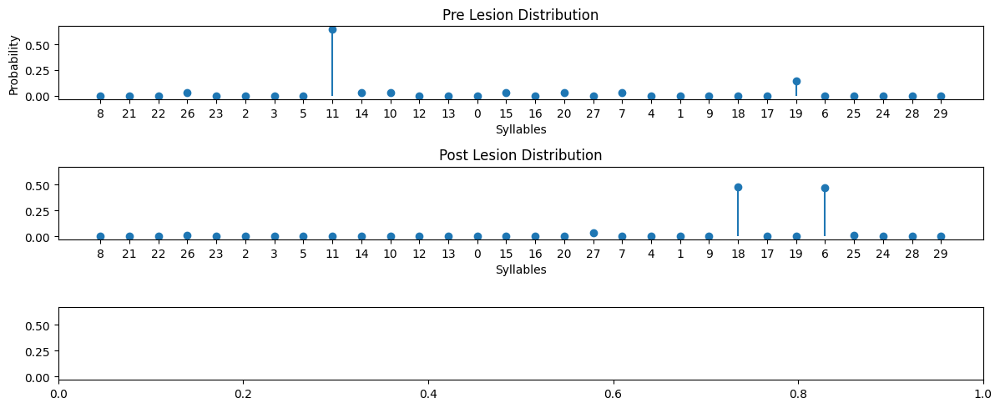

{"Earth Mover's Distance": 12.048855362954544,
 'Information Gain': 0.3603488795645021,
 'Kullback-Leibler Divergence': 20.944088292673218}


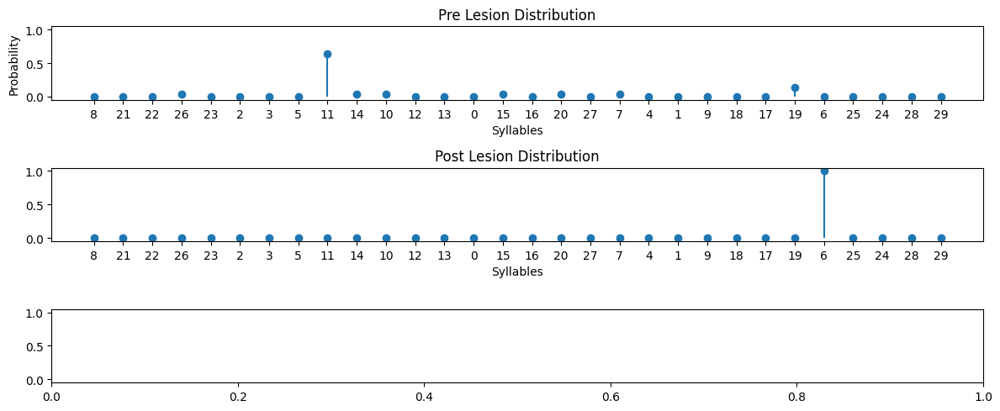

{"Earth Mover's Distance": 13.928567100061999,
 'Information Gain': 1.276052783058494,
 'Kullback-Leibler Divergence': 16.150585048903544}


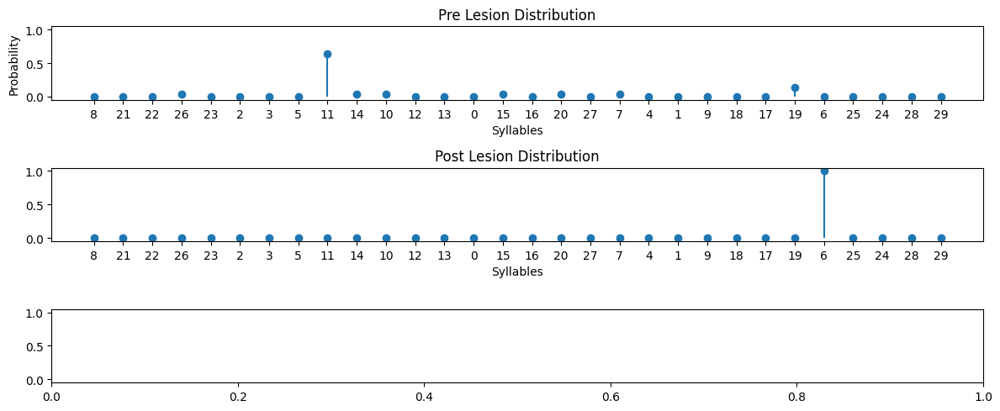

{"Earth Mover's Distance": 13.928567100061999,
 'Information Gain': 1.276052783058494,
 'Kullback-Leibler Divergence': 16.150585048903544}


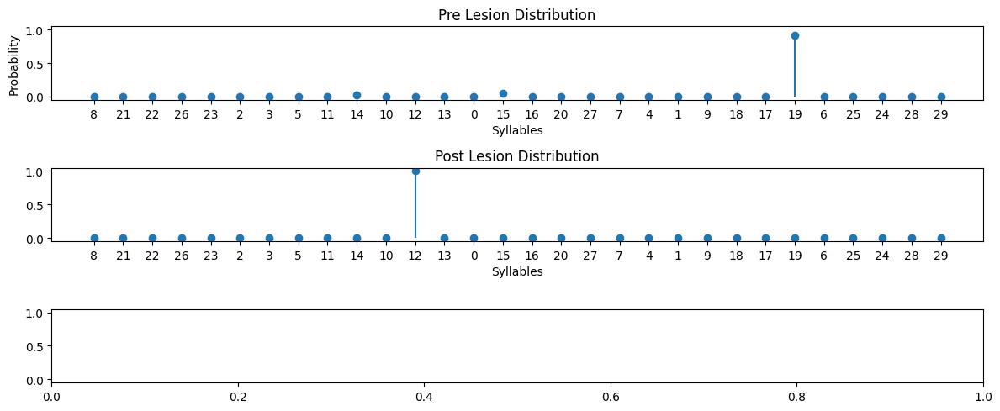

{"Earth Mover's Distance": 12.13889966053691,
 'Information Gain': 0.33986527960266943,
 'Kullback-Leibler Divergence': 17.08677256010732}


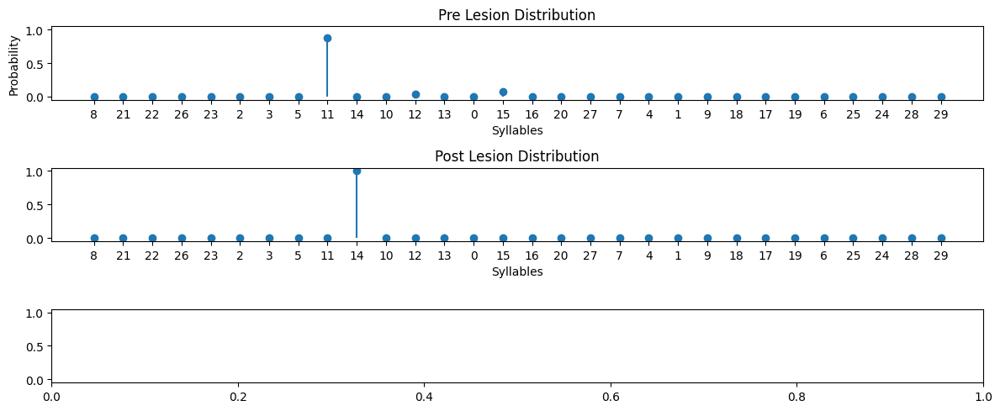

{"Earth Mover's Distance": 1.3600050375559165,
 'Information Gain': 0.44330044908356475,
 'Kullback-Leibler Divergence': 17.676491100444956}


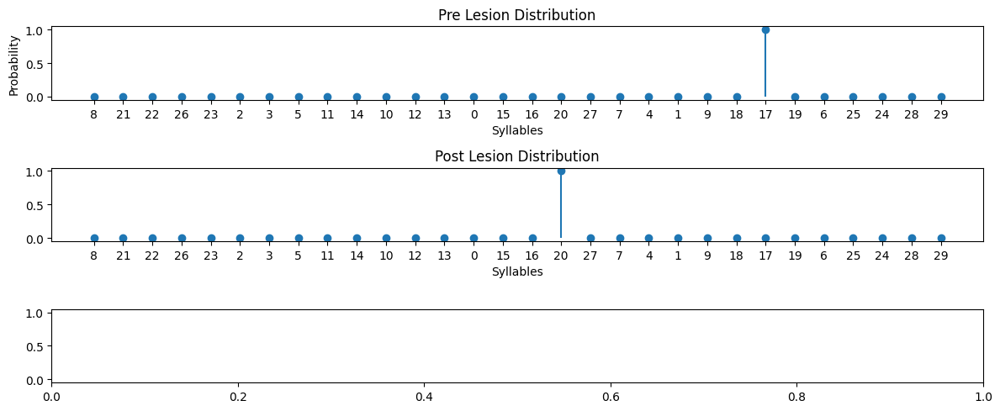

{"Earth Mover's Distance": 7.000005364814995,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816637}


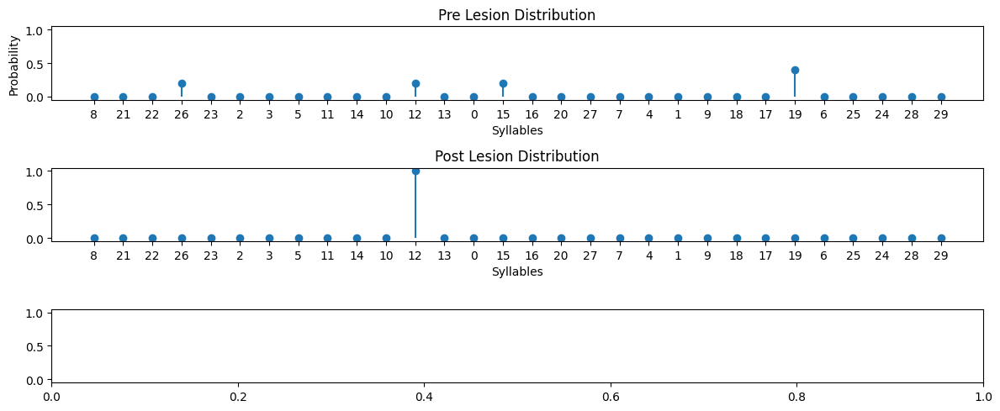

{"Earth Mover's Distance": 7.400005456865027,
 'Information Gain': 1.332169841725236,
 'Kullback-Leibler Divergence': 12.609138696843711}


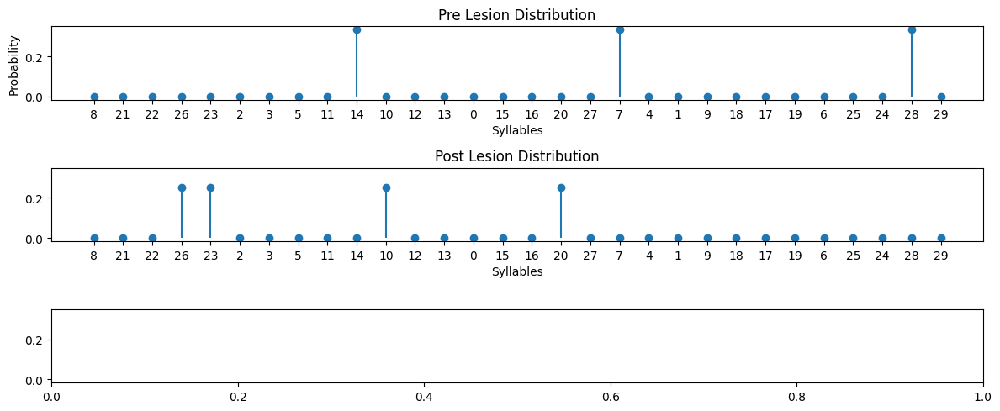

{"Earth Mover's Distance": 10.083329340775421,
 'Information Gain': -0.28767638609424173,
 'Kullback-Leibler Divergence': 17.71432354618252}


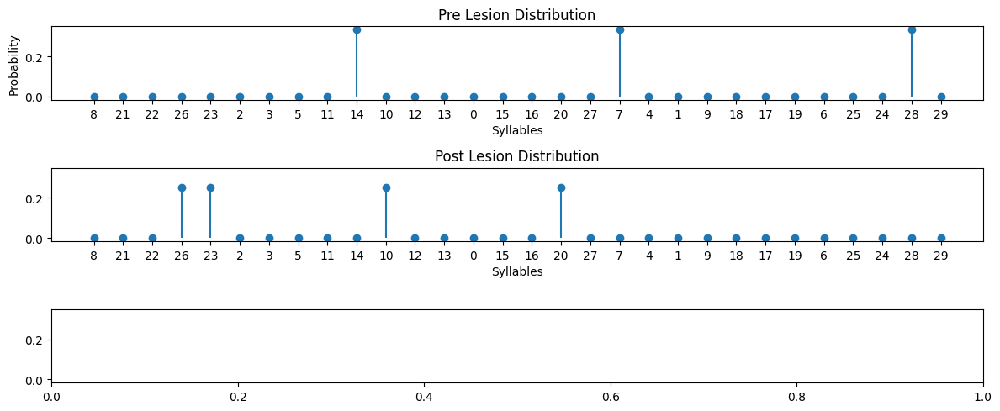

{"Earth Mover's Distance": 10.083329340775421,
 'Information Gain': -0.28767638609424173,
 'Kullback-Leibler Divergence': 17.71432354618252}


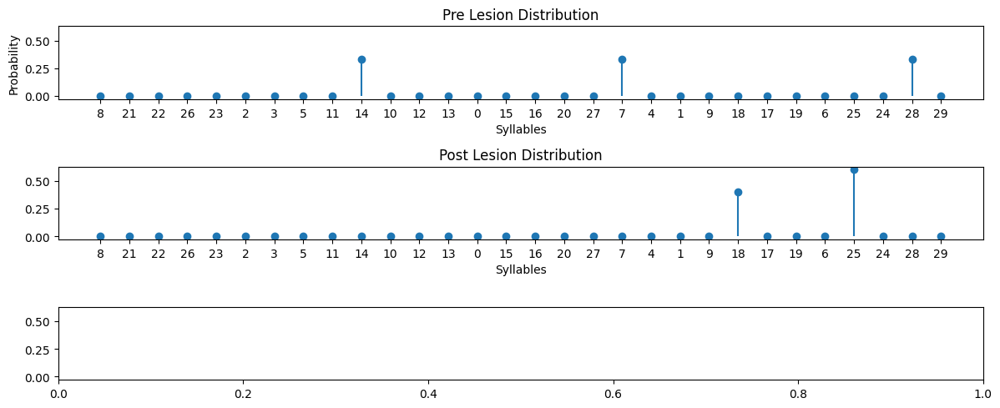

{"Earth Mover's Distance": 7.400004710542332,
 'Information Gain': 0.4256066139960991,
 'Kullback-Leibler Divergence': 17.93746767433411}


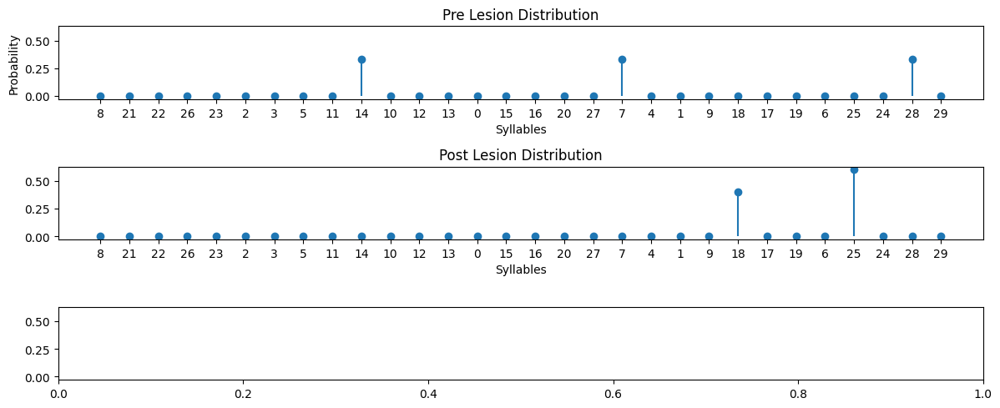

{"Earth Mover's Distance": 7.400004710542332,
 'Information Gain': 0.4256066139960991,
 'Kullback-Leibler Divergence': 17.93746767433411}


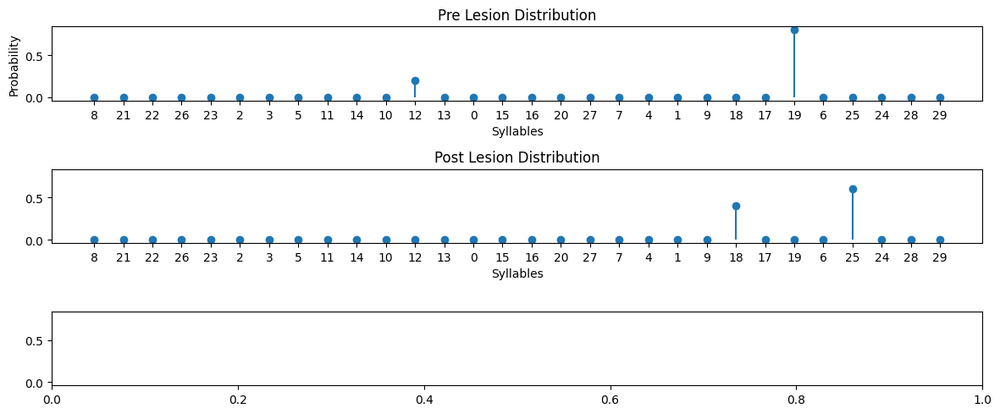

{"Earth Mover's Distance": 3.800002151725799,
 'Information Gain': -0.17260626471224283,
 'Kullback-Leibler Divergence': 18.535680826756398}


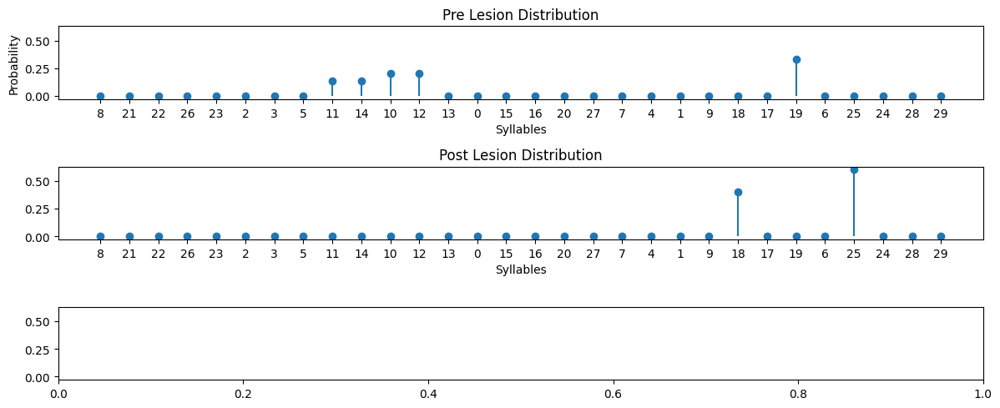

{"Earth Mover's Distance": 9.933333057860334,
 'Information Gain': 0.8742738989391544,
 'Kullback-Leibler Divergence': 17.488800936819064}


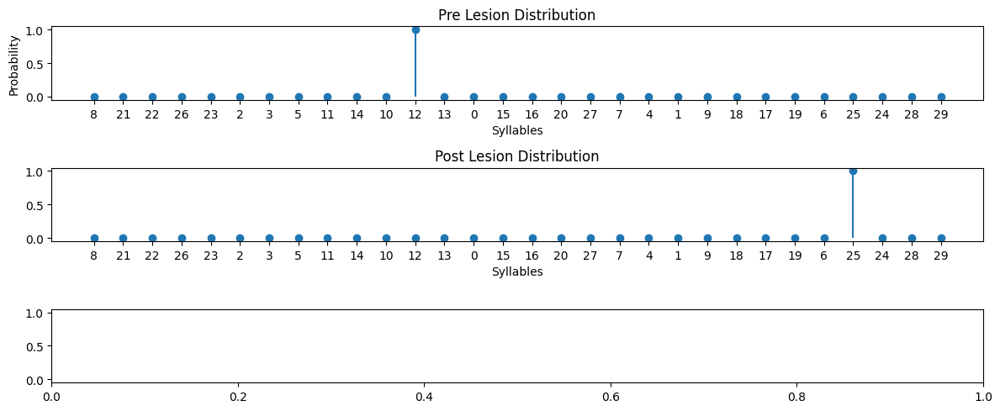

{"Earth Mover's Distance": 15.000010511697017,
 'Information Gain': 1.1798481452966996e-05,
 'Kullback-Leibler Divergence': 19.03607409826339}


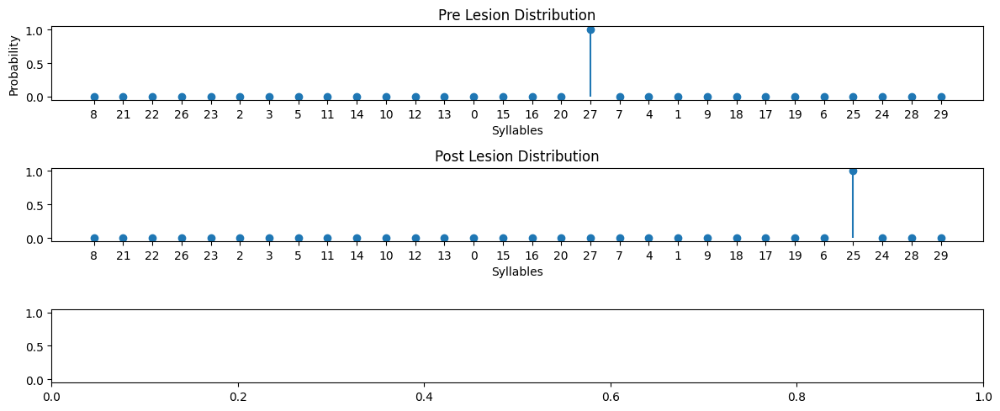

{"Earth Mover's Distance": 9.000023536346996,
 'Information Gain': 2.561095885060659e-05,
 'Kullback-Leibler Divergence': 19.0360597525865}


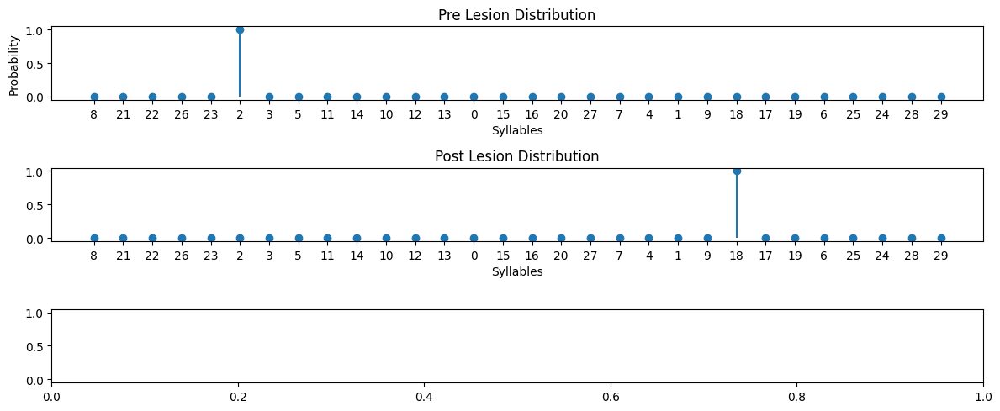

{"Earth Mover's Distance": 17.00001348453499,
 'Information Gain': 1.4311771776054105e-05,
 'Kullback-Leibler Divergence': 17.426622578816634}


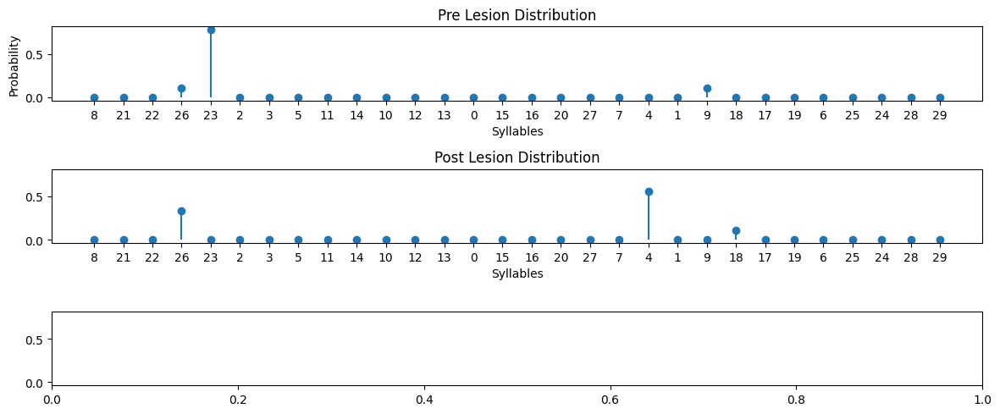

{"Earth Mover's Distance": 8.666669053882314,
 'Information Gain': -0.2531467196548718,
 'Kullback-Leibler Divergence': 17.858315610182704}


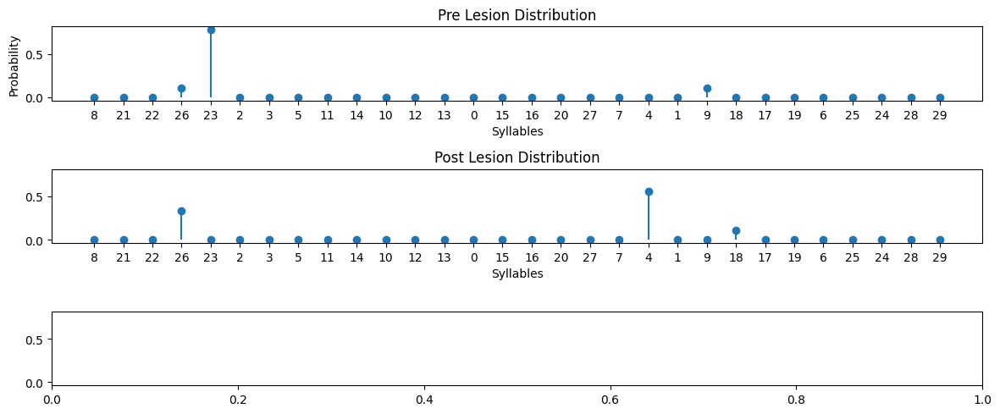

{"Earth Mover's Distance": 8.666669053882314,
 'Information Gain': -0.2531467196548718,
 'Kullback-Leibler Divergence': 17.858315610182704}


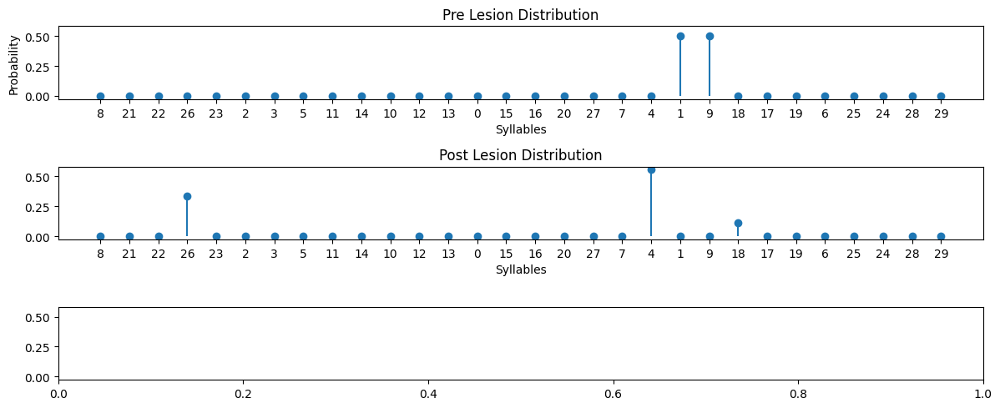

{"Earth Mover's Distance": 6.722222627360563,
 'Information Gain': -0.24372780987180165,
 'Kullback-Leibler Divergence': 20.029325698586636}


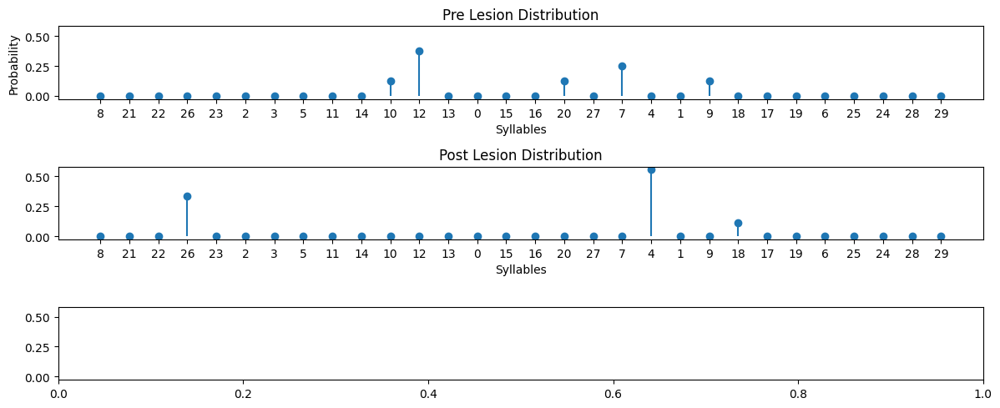

{"Earth Mover's Distance": 4.638890467341828,
 'Information Gain': 0.5572894766097922,
 'Kullback-Leibler Divergence': 19.228309636501578}


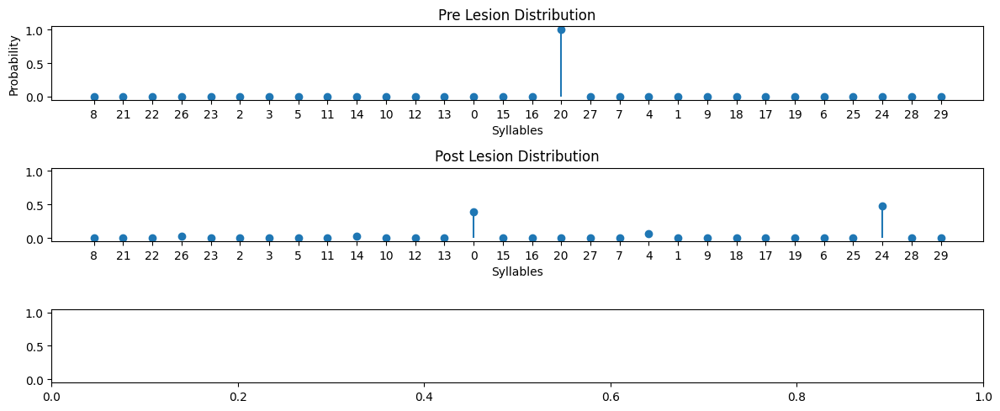

{"Earth Mover's Distance": 7.322591950574028,
 'Information Gain': -1.1169935176834267,
 'Kullback-Leibler Divergence': 20.86060476412497}


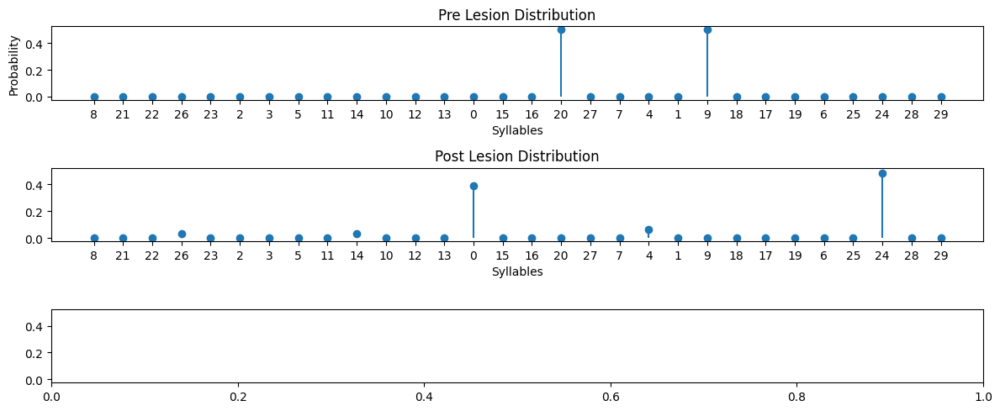

{"Earth Mover's Distance": 4.887098389596194,
 'Information Gain': -0.42386787644601154,
 'Kullback-Leibler Divergence': 20.16748303108782}


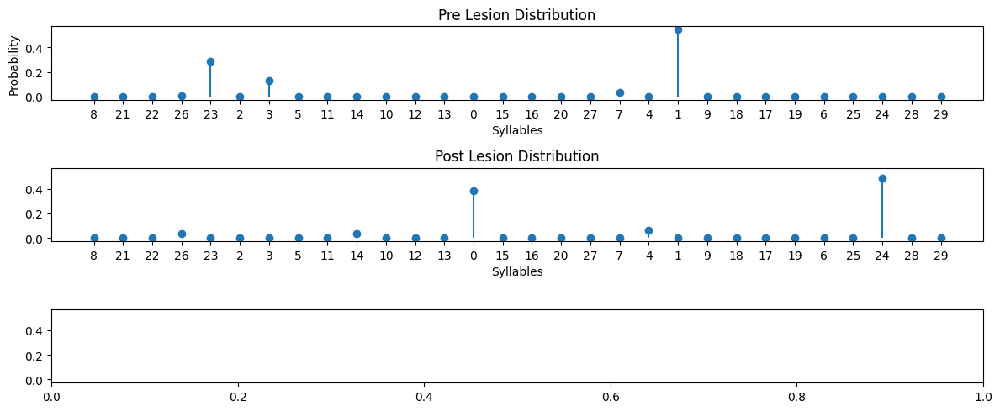

{"Earth Mover's Distance": 6.745344843253507,
 'Information Gain': -0.012627785740206177,
 'Kullback-Leibler Divergence': 19.614564109009198}


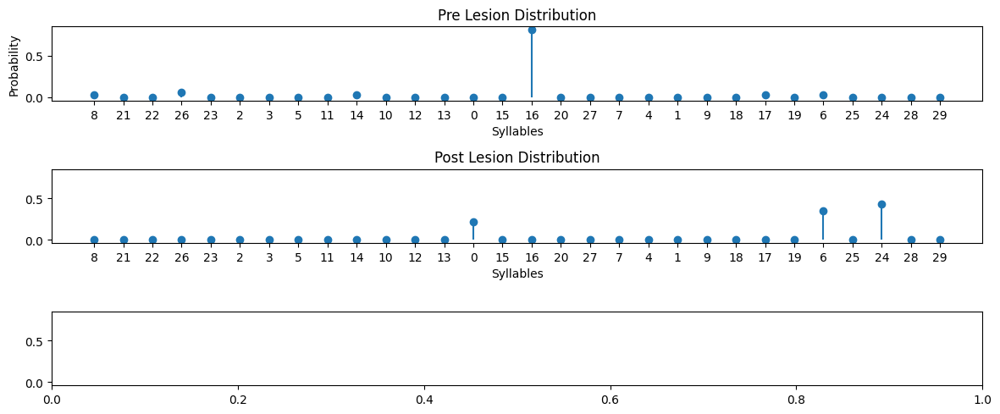

{"Earth Mover's Distance": 9.474185016958849,
 'Information Gain': -0.2859974466520838,
 'Kullback-Leibler Divergence': 19.1773686243152}


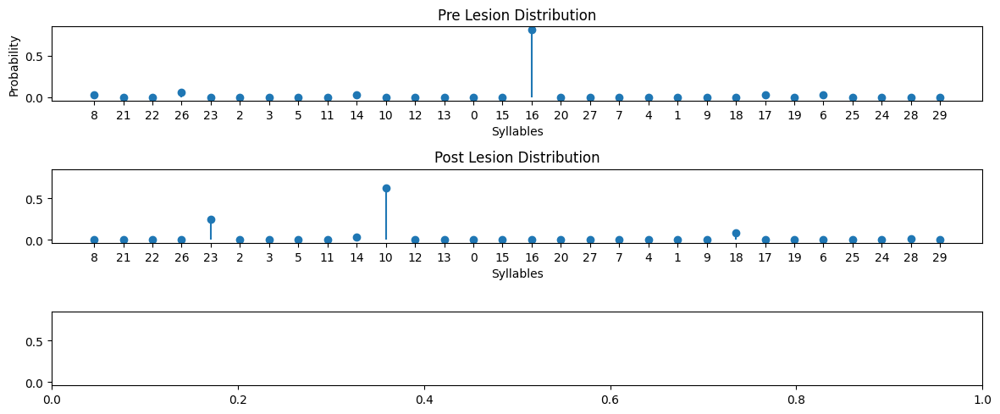

{"Earth Mover's Distance": 5.361168164860318,
 'Information Gain': -0.24906391946125317,
 'Kullback-Leibler Divergence': 20.196069881130683}


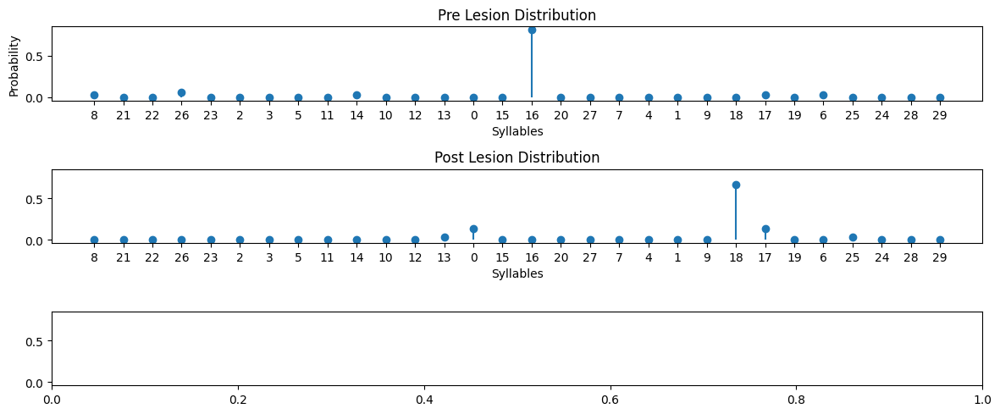

{"Earth Mover's Distance": 6.74652808679065,
 'Information Gain': -0.24253905202429604,
 'Kullback-Leibler Divergence': 19.640080884969226}


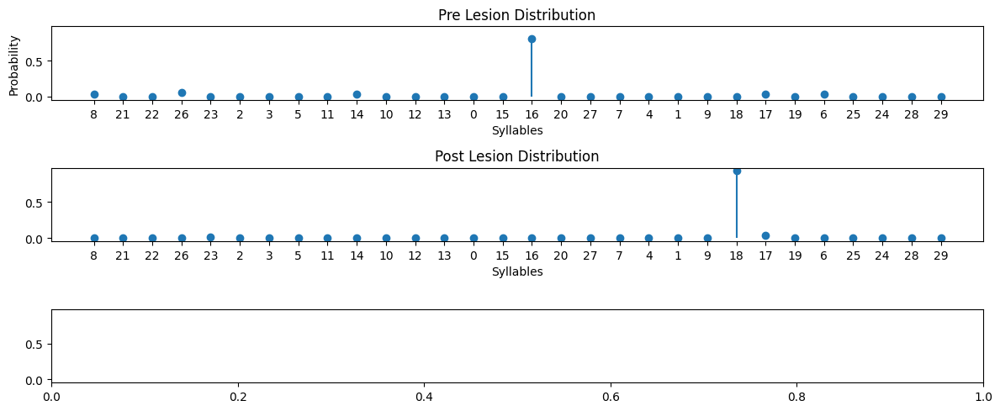

{"Earth Mover's Distance": 7.642190613389472,
 'Information Gain': 0.4562016967792966,
 'Kullback-Leibler Divergence': 22.41936090571004}


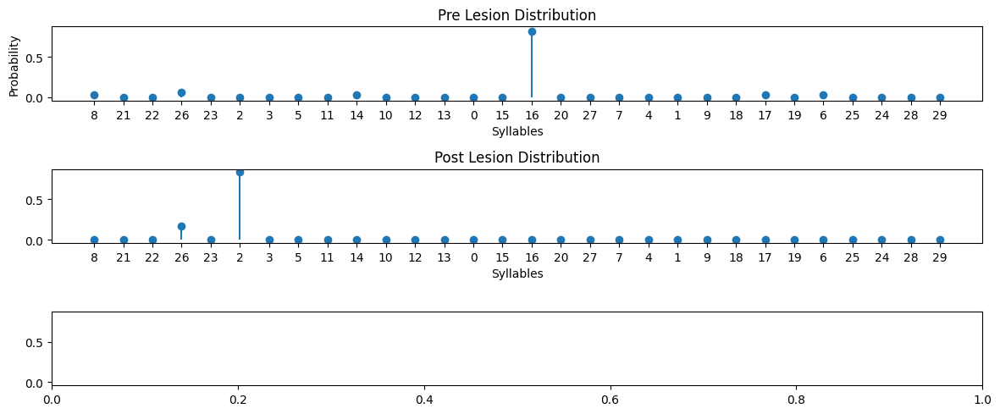

{"Earth Mover's Distance": 9.677084580385714,
 'Information Gain': 0.32464793843659806,
 'Kullback-Leibler Divergence': 17.354033728201717}


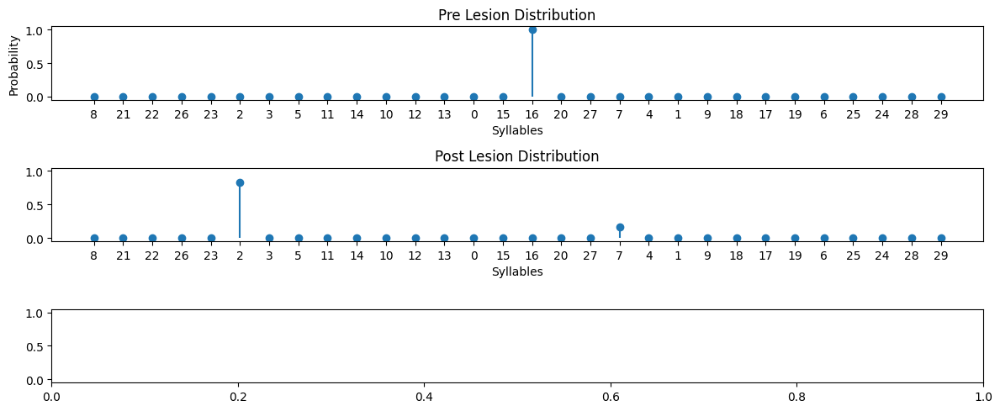

{"Earth Mover's Distance": 8.833333613450828,
 'Information Gain': -0.4505604572018012,
 'Kullback-Leibler Divergence': 19.21840764636294}


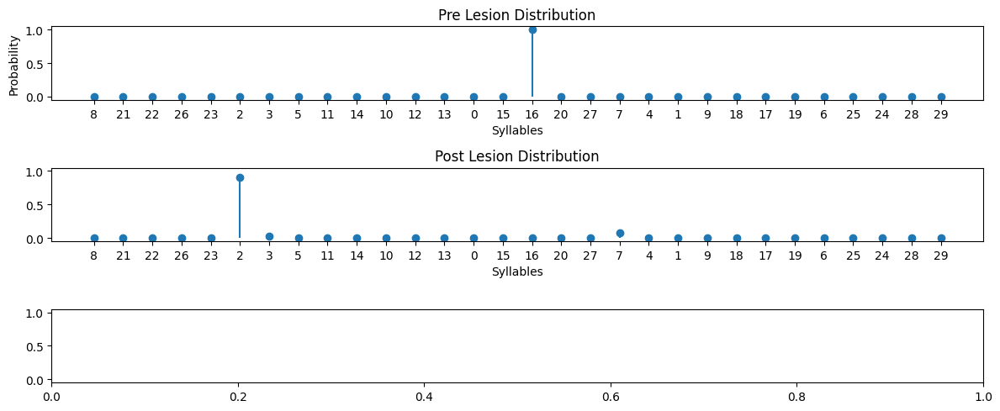

{"Earth Mover's Distance": 9.45000125625113,
 'Information Gain': -0.381313638625027,
 'Kullback-Leibler Divergence': 21.115527401572287}


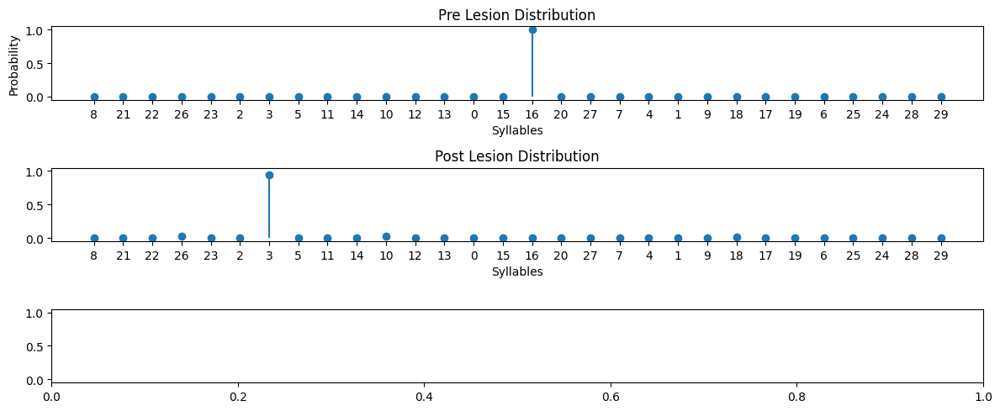

{"Earth Mover's Distance": 8.952942428803675,
 'Information Gain': -0.28576914452239993,
 'Kullback-Leibler Divergence': 21.86929908951081}


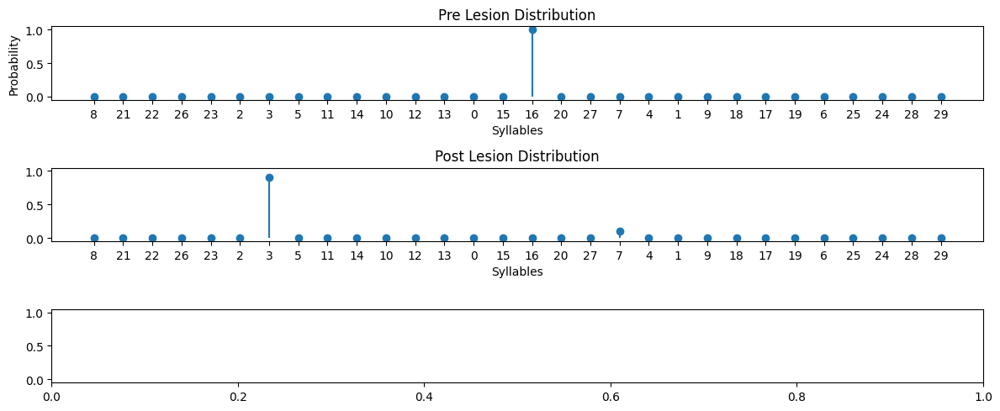

{"Earth Mover's Distance": 8.404763371866503,
 'Information Gain': -0.32333245871795063,
 'Kullback-Leibler Divergence': 22.95607709335148}


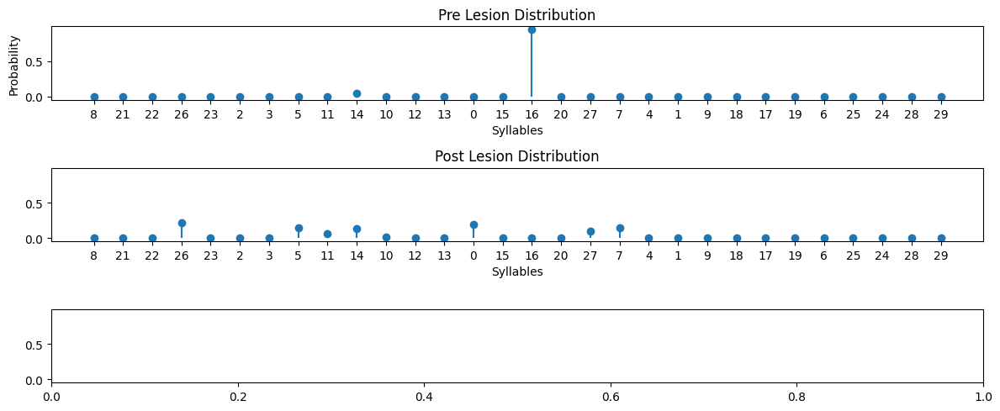

{"Earth Mover's Distance": 5.776790725866159,
 'Information Gain': -1.7619447873873961,
 'Kullback-Leibler Divergence': 6.77337030433564}


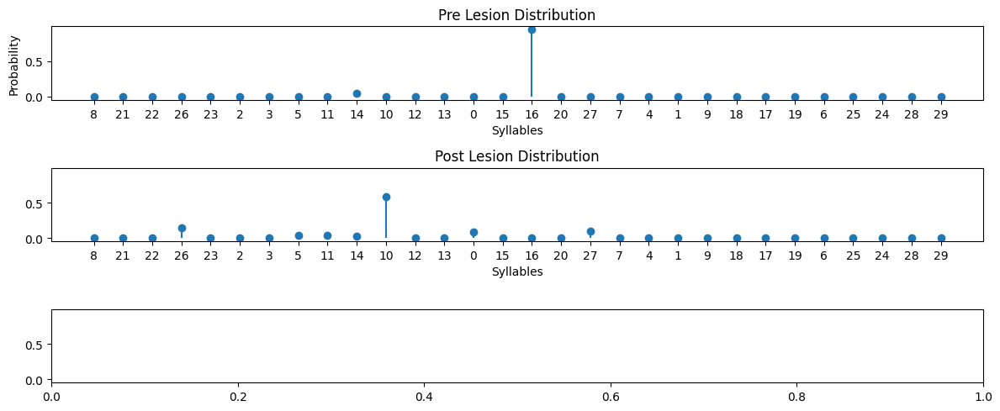

{"Earth Mover's Distance": 5.344211097012042,
 'Information Gain': -1.1530714084228133,
 'Kullback-Leibler Divergence': 20.215288279245556}


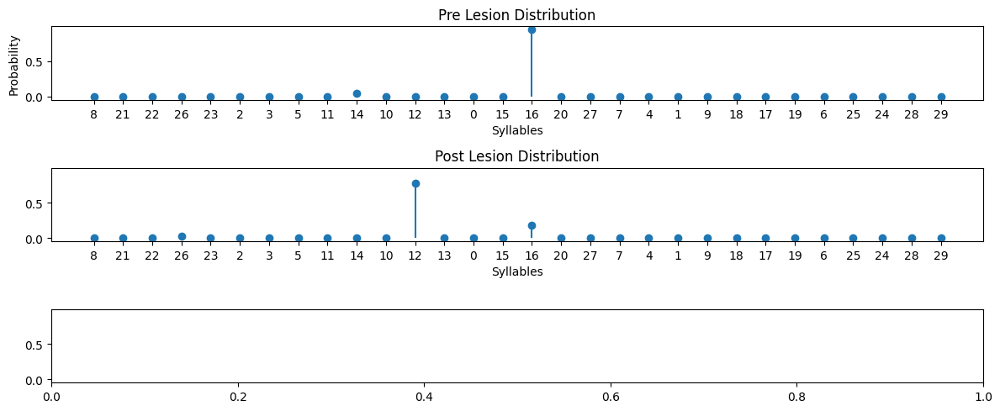

{"Earth Mover's Distance": 3.267464903174468,
 'Information Gain': -0.5328346459465845,
 'Kullback-Leibler Divergence': 1.7166925457935935}


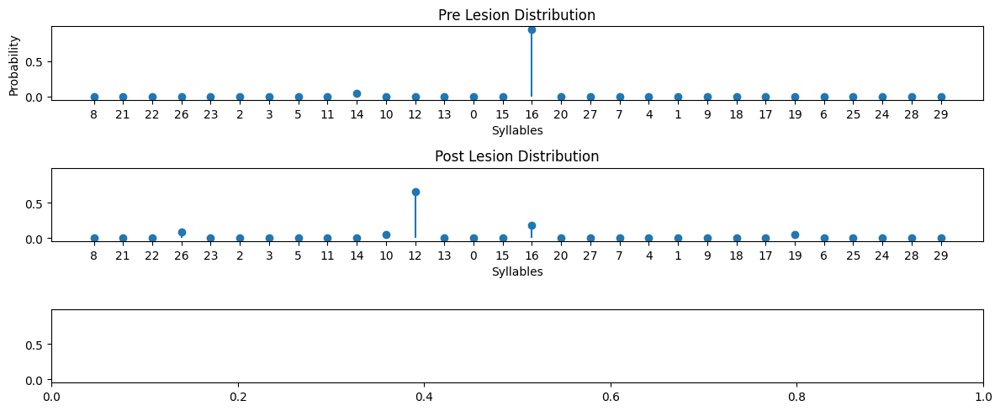

{"Earth Mover's Distance": 3.945080651092086,
 'Information Gain': -0.86181274923458,
 'Kullback-Leibler Divergence': 2.5696439528365387}


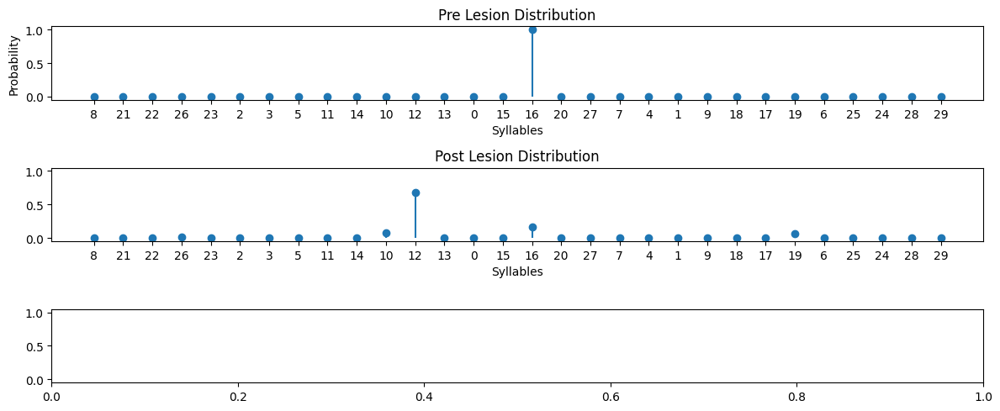

{"Earth Mover's Distance": 3.9130563736500634,
 'Information Gain': -1.0180125904117736,
 'Kullback-Leibler Divergence': 1.8362103926118032}


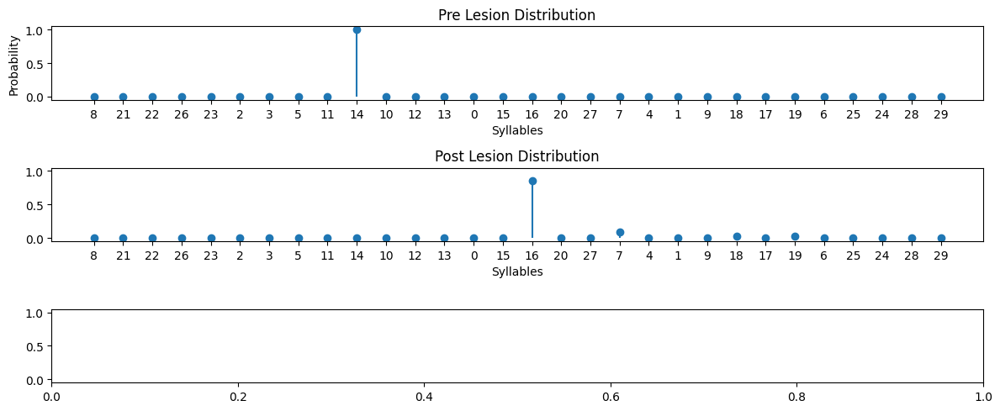

{"Earth Mover's Distance": 6.65118854779383,
 'Information Gain': -0.5251452070023888,
 'Kullback-Leibler Divergence': 21.187818694070906}


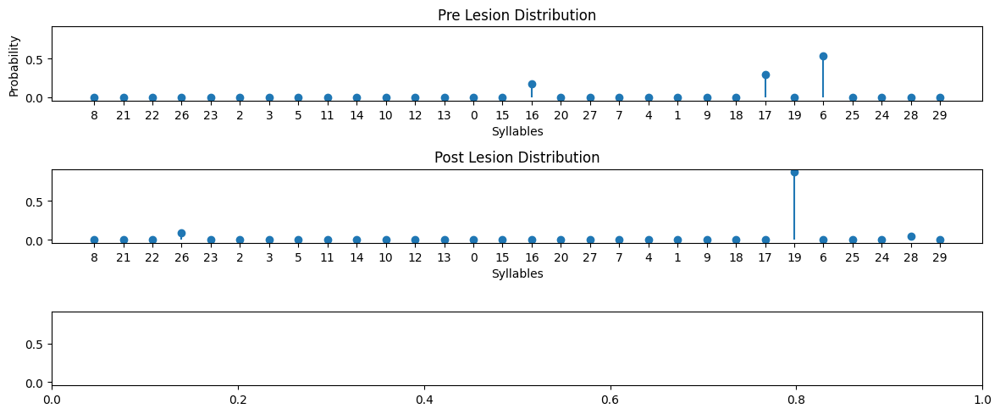

{"Earth Mover's Distance": 2.7016722229628196,
 'Information Gain': 0.5232531081857966,
 'Kullback-Leibler Divergence': 19.568655953771437}


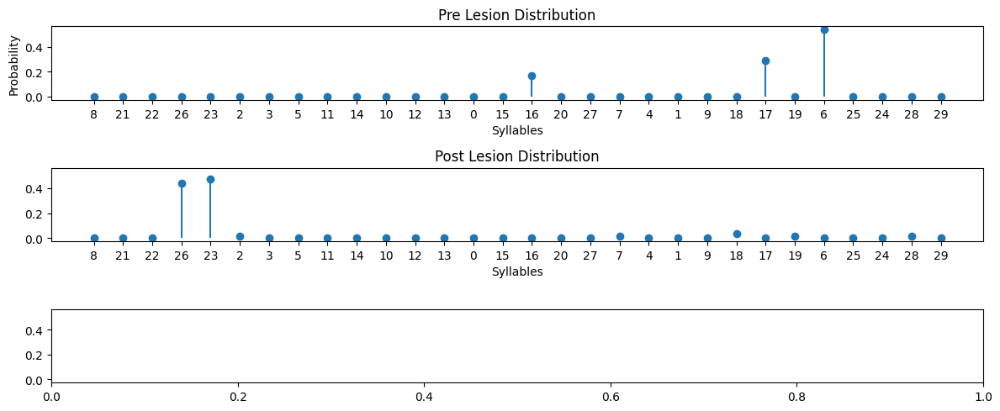

{"Earth Mover's Distance": 17.950349554371094,
 'Information Gain': -0.038882853719690025,
 'Kullback-Leibler Divergence': 20.910498462064737}


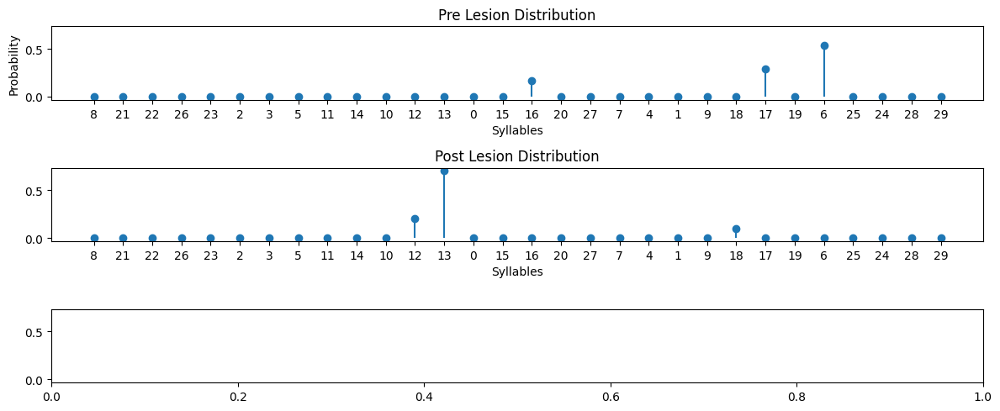

{"Earth Mover's Distance": 9.923077778794966,
 'Information Gain': 0.19166973322612335,
 'Kullback-Leibler Divergence': 18.735746877559336}


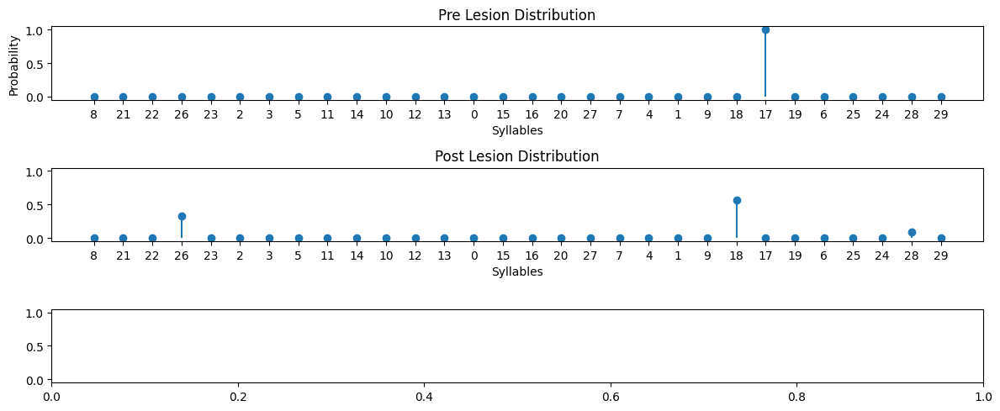

{"Earth Mover's Distance": 7.714281609289285,
 'Information Gain': -0.909897012074369,
 'Kullback-Leibler Divergence': 20.47114200498909}


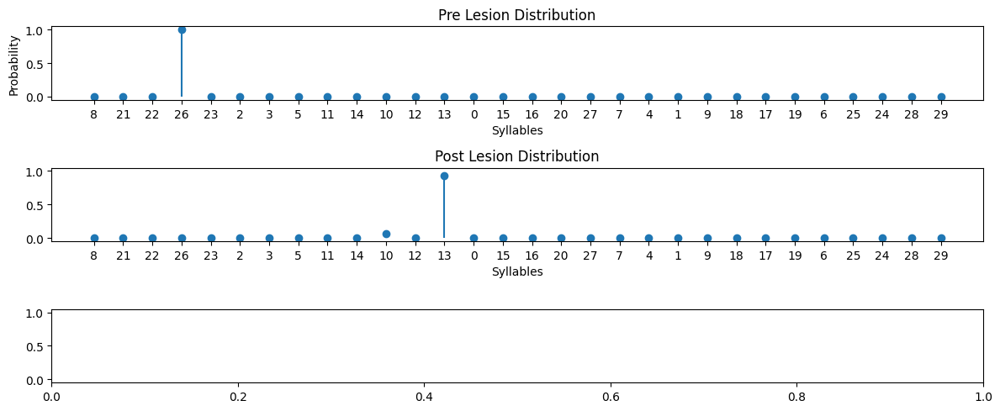

{"Earth Mover's Distance": 8.86667451211568,
 'Information Gain': -0.24492090595668975,
 'Kullback-Leibler Divergence': 20.134690871892552}


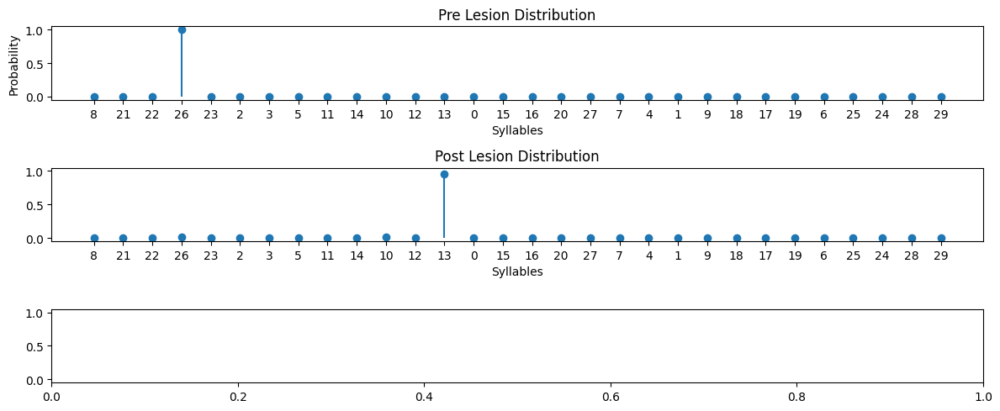

{"Earth Mover's Distance": 8.75183340890463,
 'Information Gain': -0.23804795897453157,
 'Kullback-Leibler Divergence': 4.226831965768529}


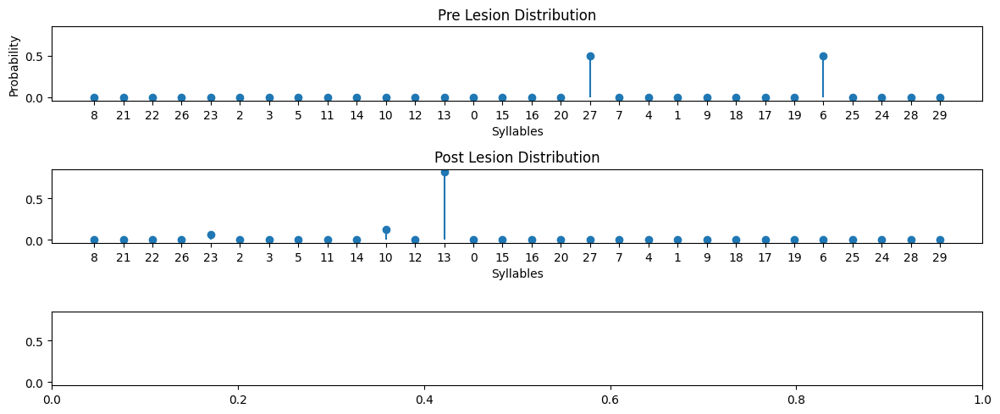

{"Earth Mover's Distance": 9.749995657004062,
 'Information Gain': 0.09123614396608526,
 'Kullback-Leibler Divergence': 19.506077652372646}


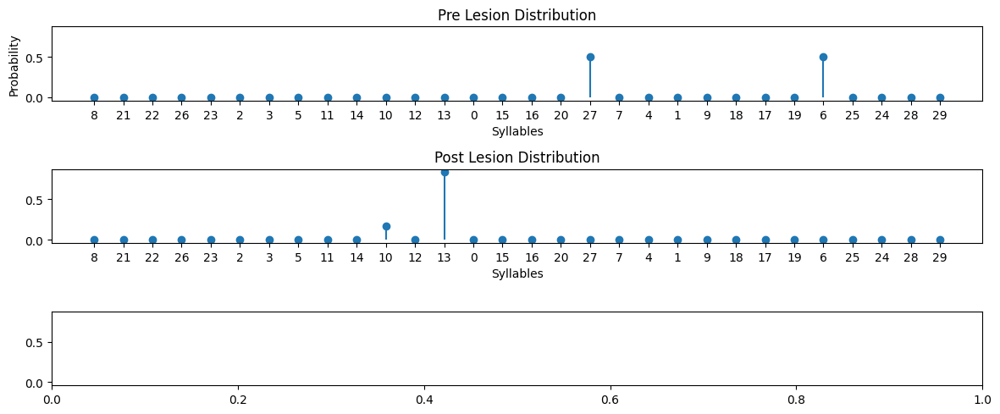

{"Earth Mover's Distance": 9.333331570345832,
 'Information Gain': 0.2425973540043262,
 'Kullback-Leibler Divergence': 18.525249018100535}


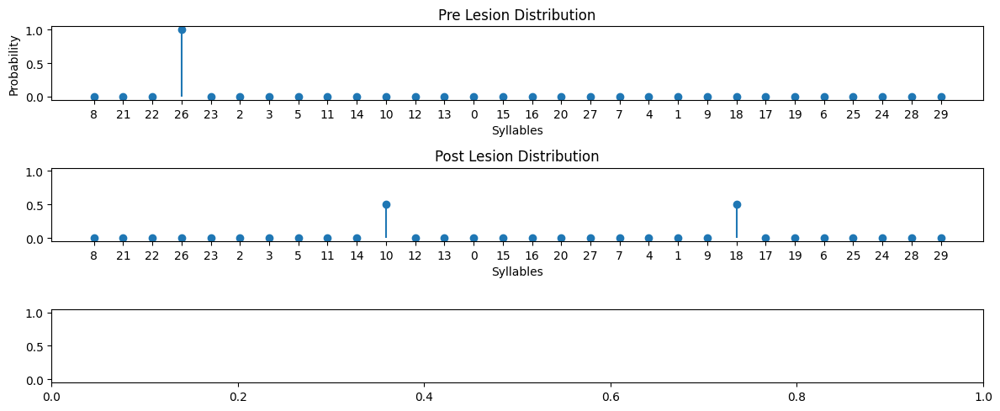

{"Earth Mover's Distance": 13.000019766917474,
 'Information Gain': -0.6931254001985515,
 'Kullback-Leibler Divergence': 18.119768377822442}


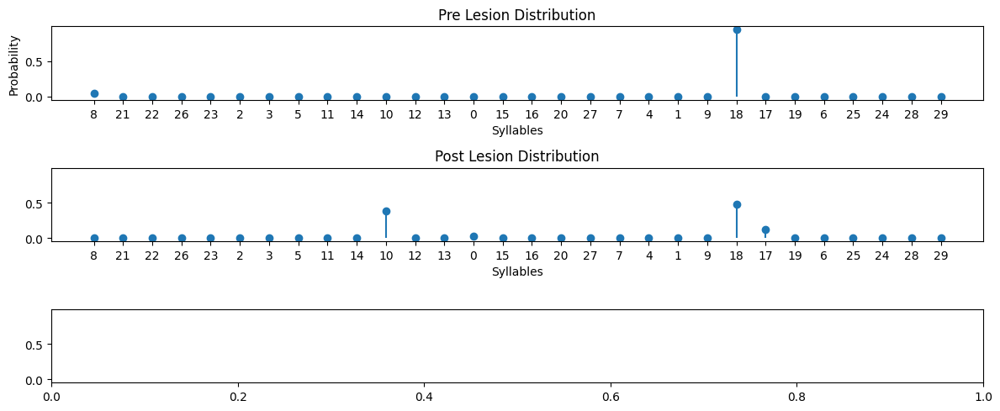

{"Earth Mover's Distance": 4.799498905916577,
 'Information Gain': -0.8571130235277495,
 'Kullback-Leibler Divergence': 1.610607405093241}


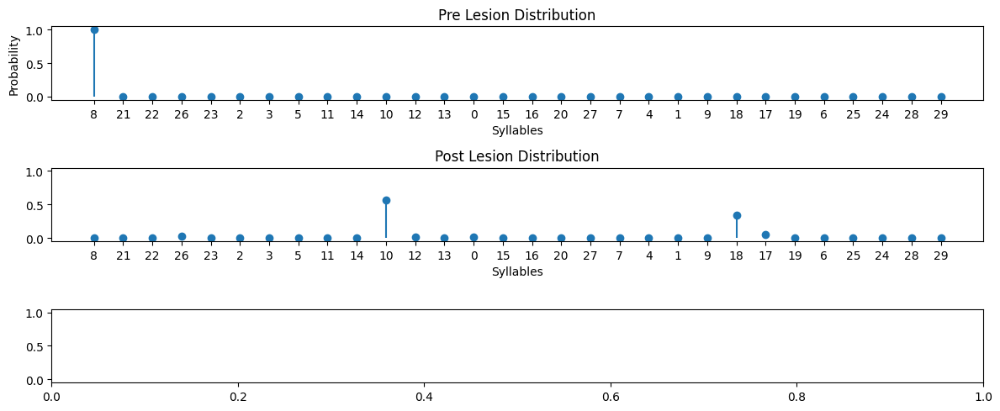

{"Earth Mover's Distance": 14.62502595113776,
 'Information Gain': -1.024993874067311,
 'Kullback-Leibler Divergence': 22.278646504925963}


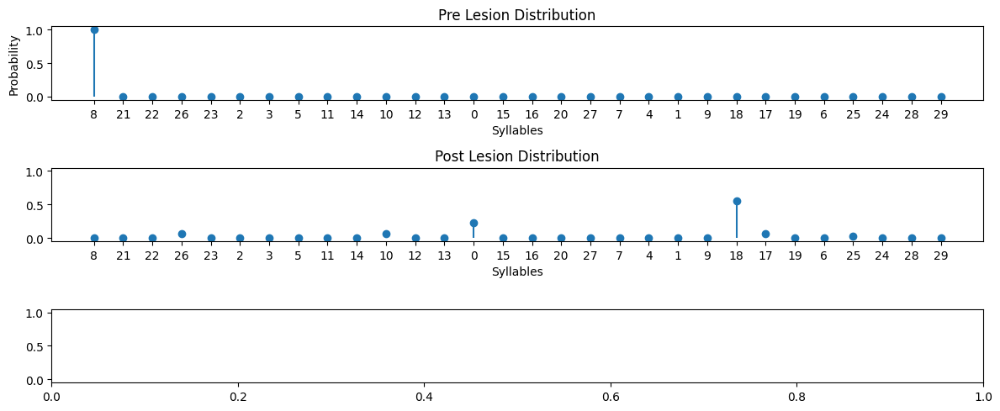

{"Earth Mover's Distance": 18.161315966565635,
 'Information Gain': -1.3067046635362505,
 'Kullback-Leibler Divergence': 20.860603733408425}


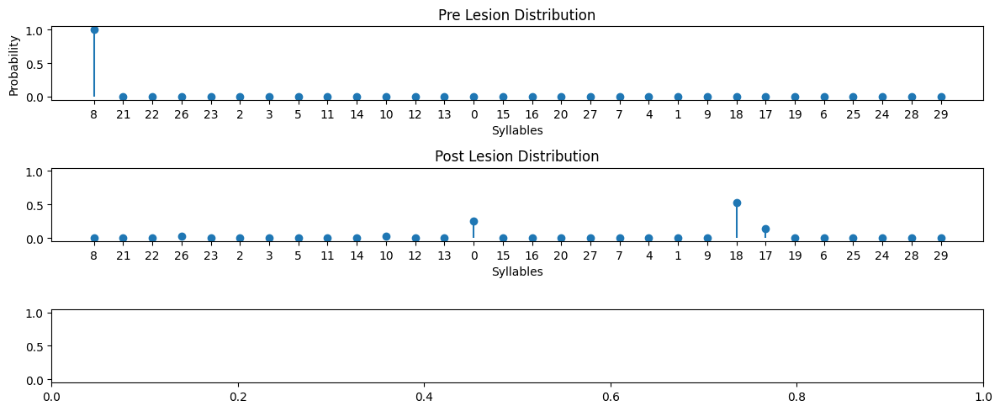

{"Earth Mover's Distance": 18.77476684801369,
 'Information Gain': -1.2919078716844767,
 'Kullback-Leibler Divergence': 5.580662202694182}


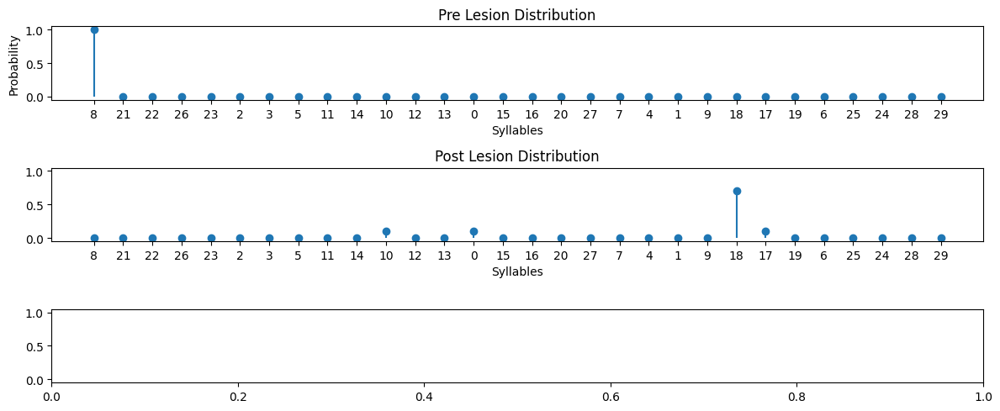

{"Earth Mover's Distance": 20.00002563047449,
 'Information Gain': -0.9404197299051194,
 'Kullback-Leibler Divergence': 20.82781589296566}


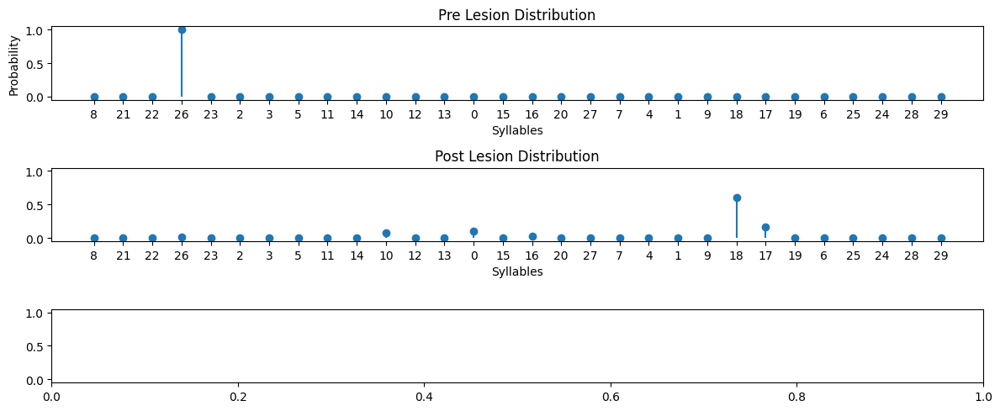

{"Earth Mover's Distance": 16.72197430813325,
 'Information Gain': -1.2309273595314947,
 'Kullback-Leibler Divergence': 4.308558914388915}


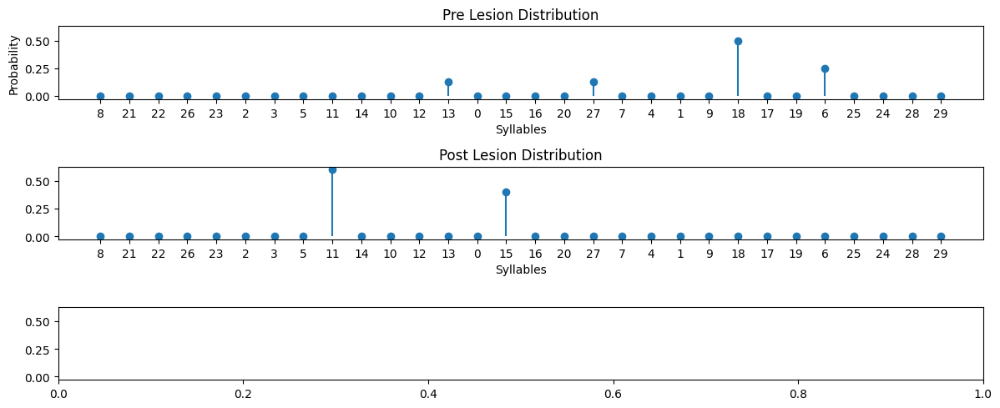

{"Earth Mover's Distance": 10.4749998193921,
 'Information Gain': 0.5399963581182802,
 'Kullback-Leibler Divergence': 17.82307835789002}


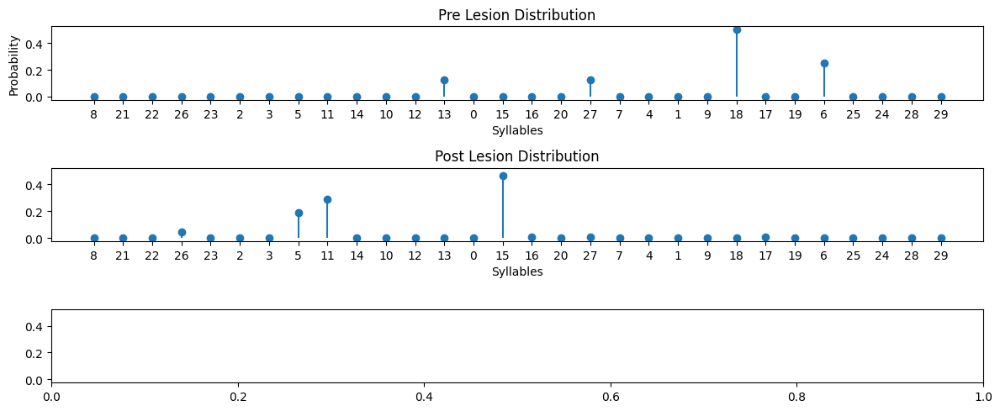

{"Earth Mover's Distance": 10.3634603450084,
 'Information Gain': -0.014969068015514786,
 'Kullback-Leibler Divergence': 19.59599022920803}


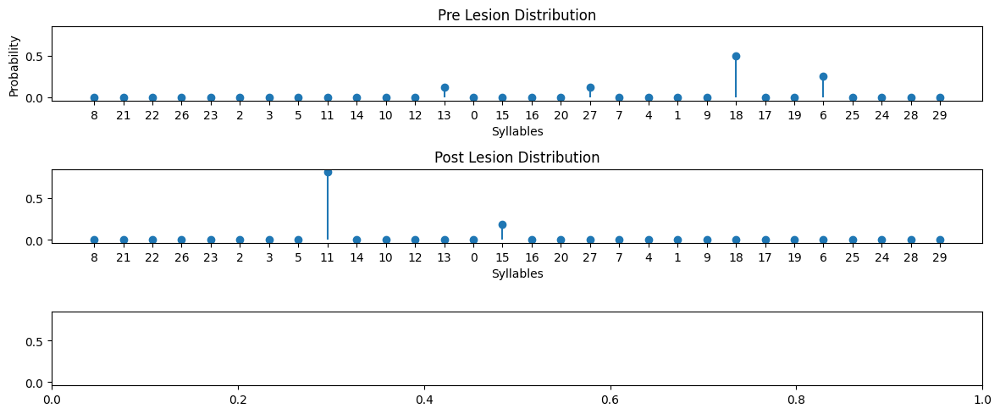

{"Earth Mover's Distance": 11.816643363301274,
 'Information Gain': 0.6733596504435008,
 'Kullback-Leibler Divergence': 22.14588504492731}


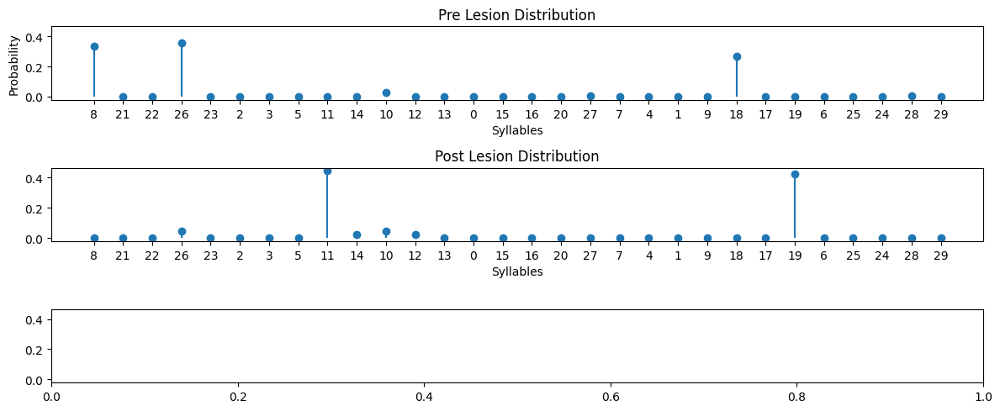

{"Earth Mover's Distance": 7.255982841079517,
 'Information Gain': 0.08092155240074916,
 'Kullback-Leibler Divergence': 12.935398502814623}


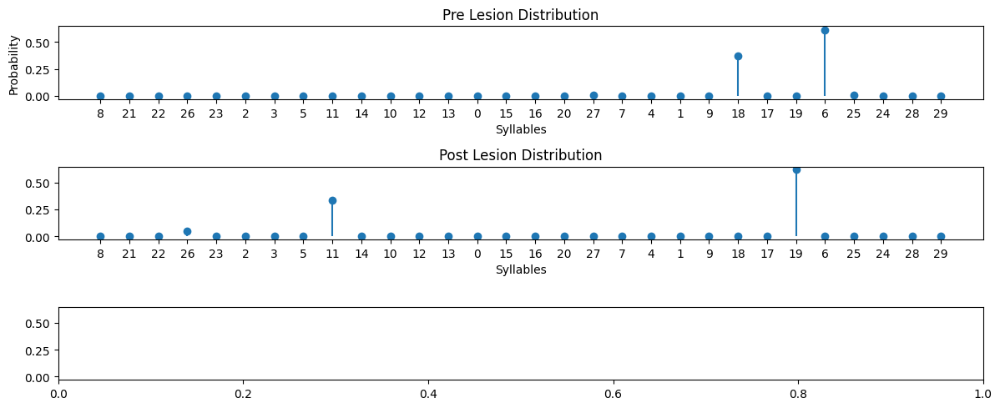

{"Earth Mover's Distance": 6.118301906767821,
 'Information Gain': -0.03247350359554957,
 'Kullback-Leibler Divergence': 20.864379272237148}


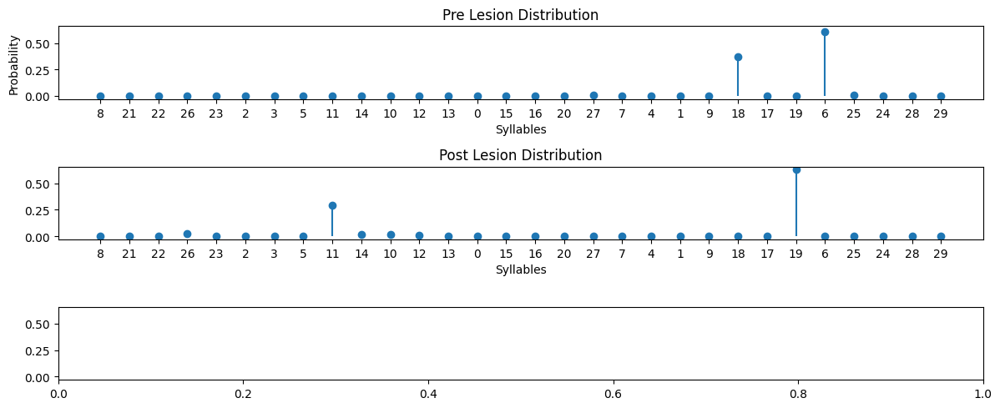

{"Earth Mover's Distance": 5.761913907290719,
 'Information Gain': -0.19014110080642133,
 'Kullback-Leibler Divergence': 16.06925293245269}


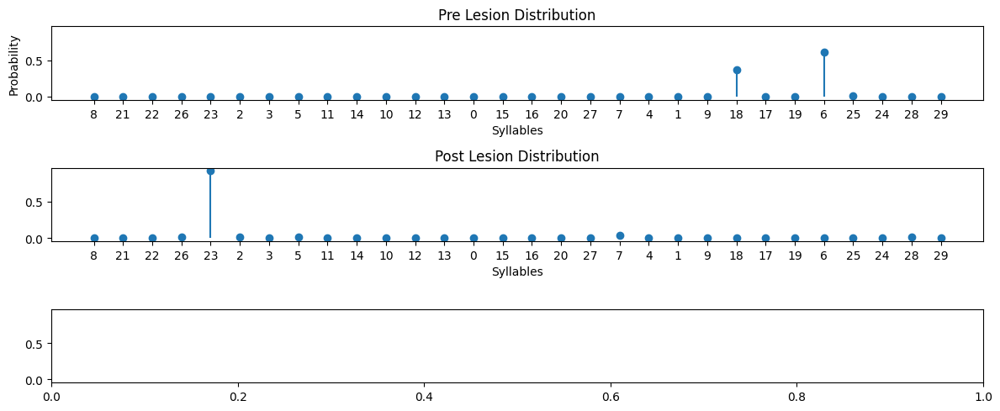

{"Earth Mover's Distance": 18.98759247715035,
 'Information Gain': 0.37825973733347684,
 'Kullback-Leibler Divergence': 21.926406060607828}


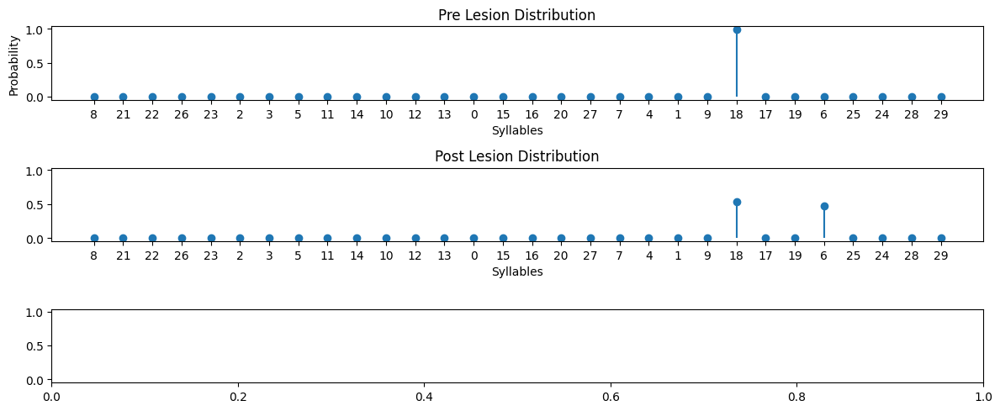

{"Earth Mover's Distance": 1.6017542726502167,
 'Information Gain': -0.6064139855375739,
 'Kullback-Leibler Divergence': 0.8098784415140463}


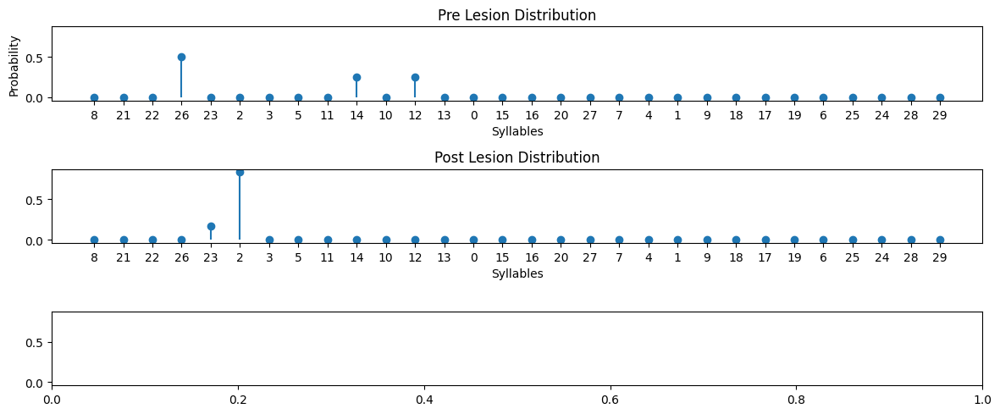

{"Earth Mover's Distance": 3.333336782377844,
 'Information Gain': 0.5891638924238818,
 'Kullback-Leibler Divergence': 18.17868299034101}


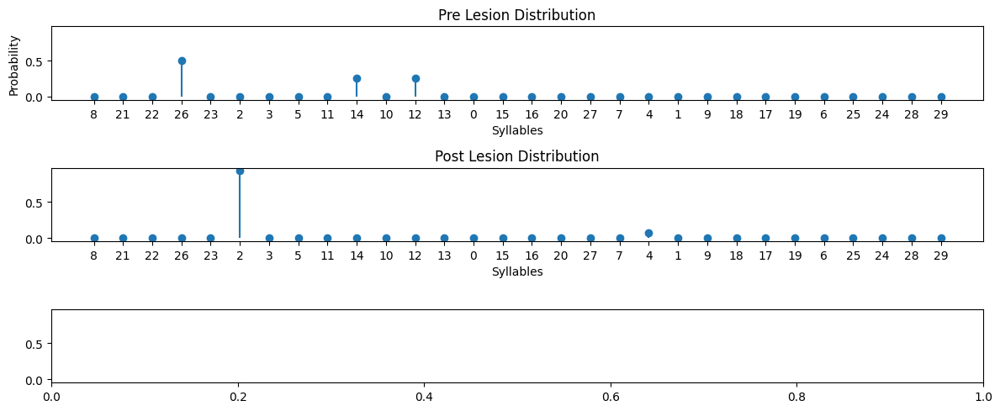

{"Earth Mover's Distance": 3.642861526056227,
 'Information Gain': 0.7824078294941392,
 'Kullback-Leibler Divergence': 19.025980760143437}


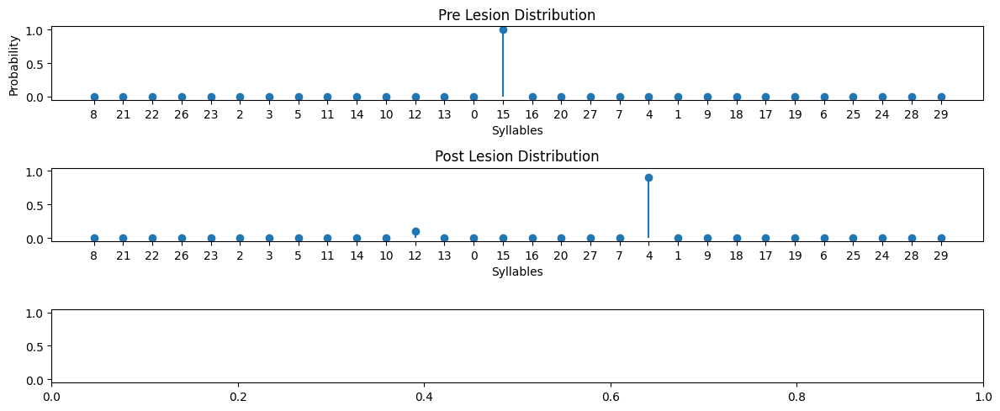

{"Earth Mover's Distance": 4.803300196836272,
 'Information Gain': -0.3214374877678679,
 'Kullback-Leibler Divergence': 21.5374943445453}


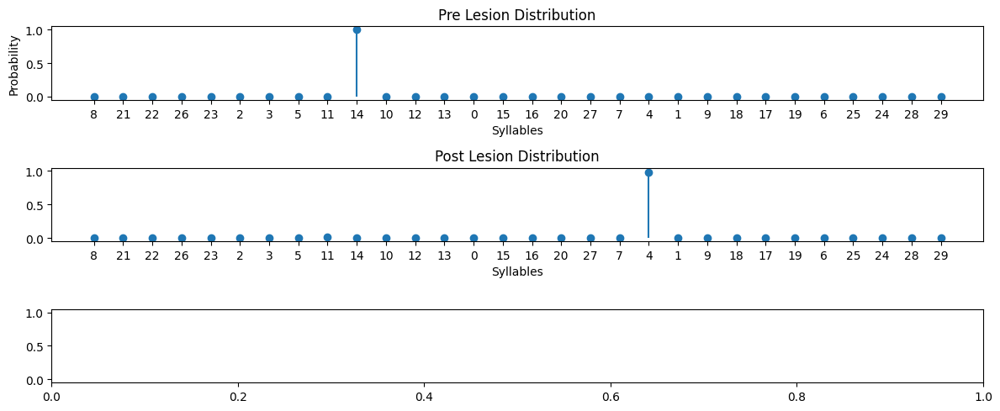

{"Earth Mover's Distance": 9.898629976329985,
 'Information Gain': -0.08170202786529938,
 'Kullback-Leibler Divergence': 22.806532280103607}


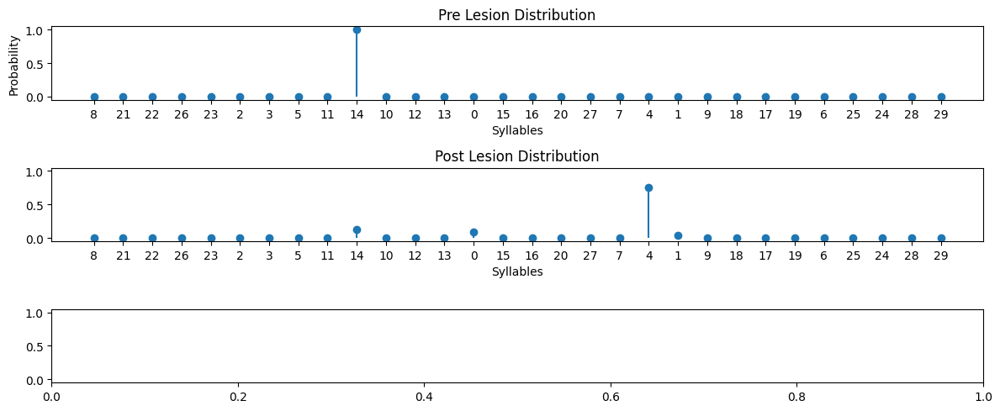

{"Earth Mover's Distance": 8.291679167784816,
 'Information Gain': -0.8151718861587474,
 'Kullback-Leibler Divergence': 2.0794401110154324}


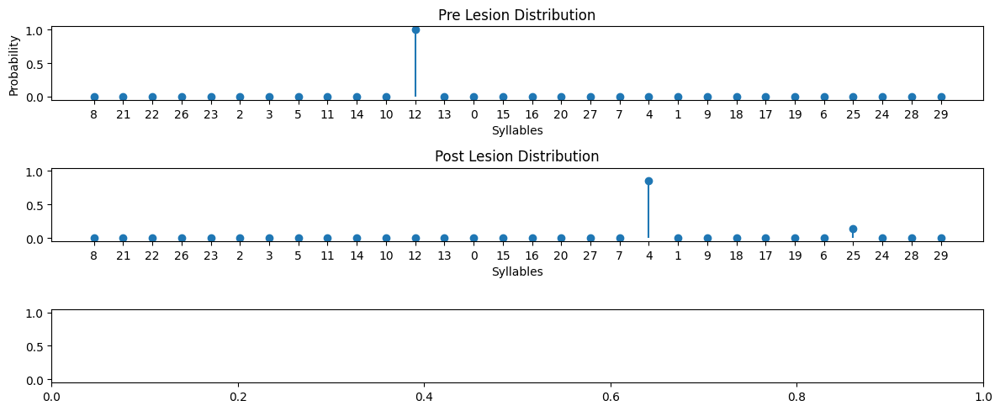

{"Earth Mover's Distance": 9.000024254333566,
 'Information Gain': -0.41008972979907393,
 'Kullback-Leibler Divergence': 19.372530956432986}


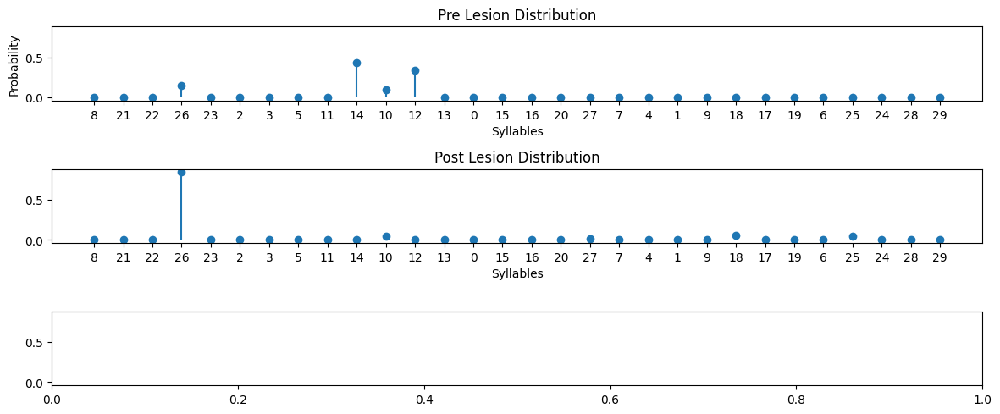

{"Earth Mover's Distance": 6.01811292755332,
 'Information Gain': 0.5781275510166067,
 'Kullback-Leibler Divergence': 16.91953856329511}


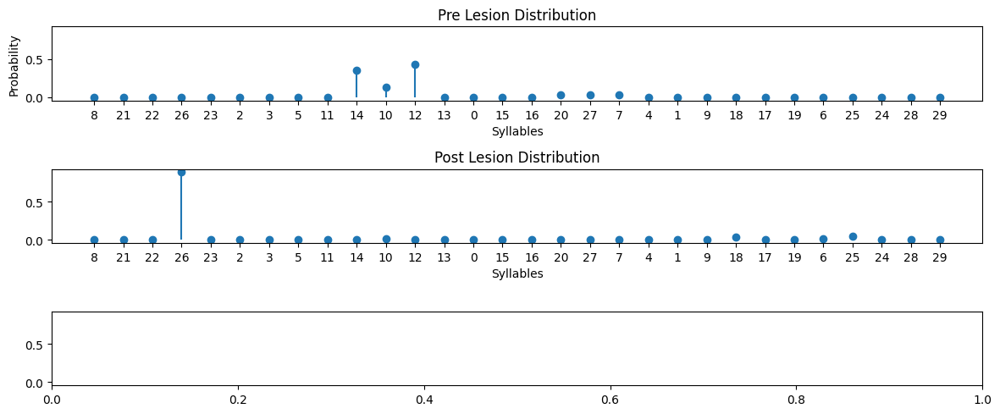

{"Earth Mover's Distance": 7.107255096328291,
 'Information Gain': 0.7708499454794294,
 'Kullback-Leibler Divergence': 18.876990151516946}


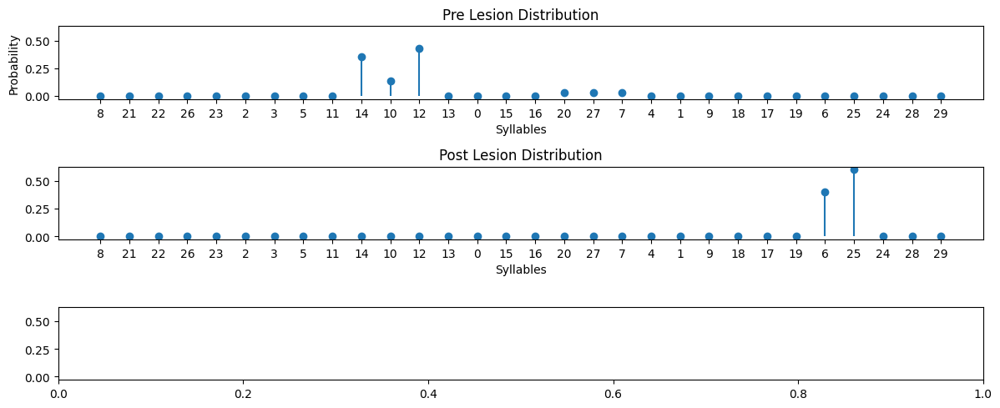

{"Earth Mover's Distance": 14.951351636560988,
 'Information Gain': 0.6202591319068107,
 'Kullback-Leibler Divergence': 19.534577510745994}


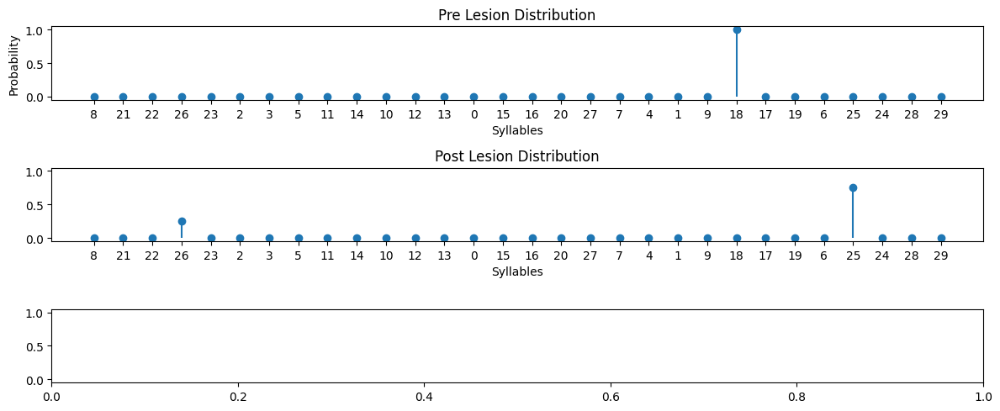

{"Earth Mover's Distance": 7.7499985713222515,
 'Information Gain': -0.562310038473703,
 'Kullback-Leibler Divergence': 18.812915294180808}


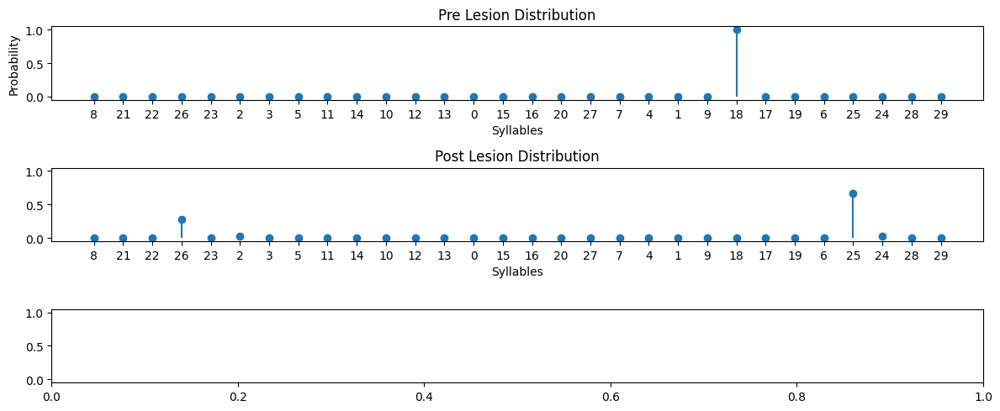

{"Earth Mover's Distance": 8.58974198525613,
 'Information Gain': -0.8151394877047382,
 'Kullback-Leibler Divergence': 21.090180189535744}


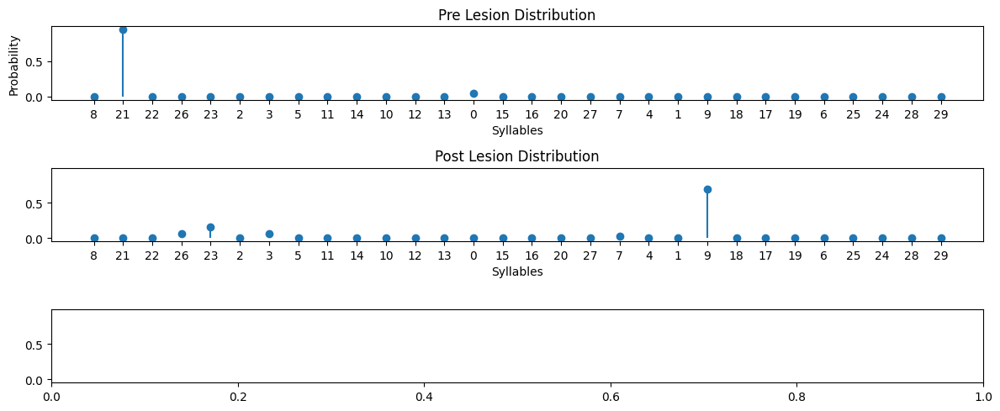

{"Earth Mover's Distance": 14.564074324413347,
 'Information Gain': -0.7720872356515569,
 'Kullback-Leibler Divergence': 21.04909888489653}


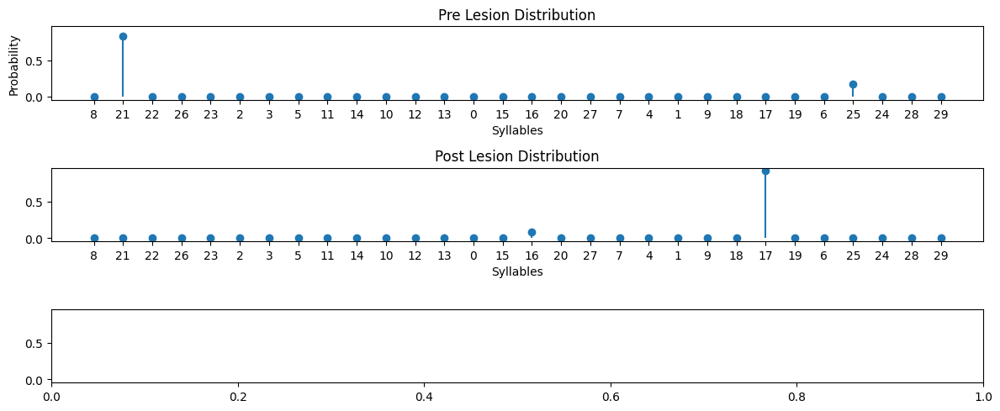

{"Earth Mover's Distance": 18.166668898415416,
 'Information Gain': 0.1637289081974137,
 'Kullback-Leibler Divergence': 19.460991668894106}


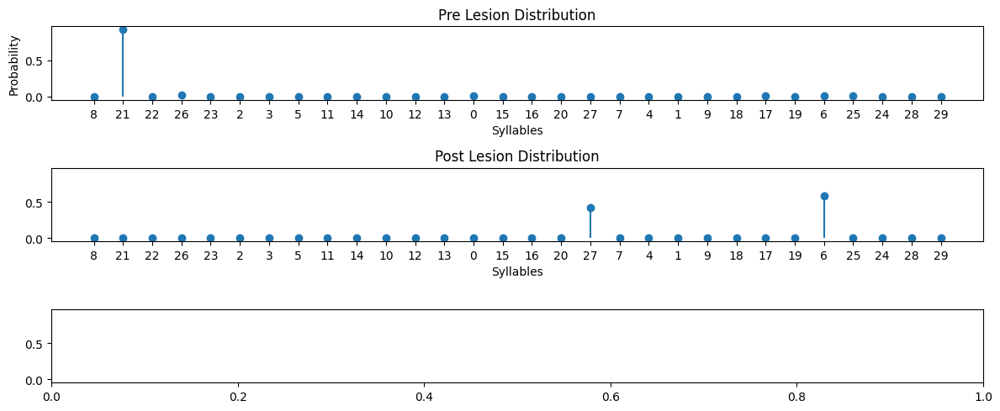

{"Earth Mover's Distance": 19.604166657455657,
 'Information Gain': -0.29575559246031347,
 'Kullback-Leibler Divergence': 20.370842637338324}


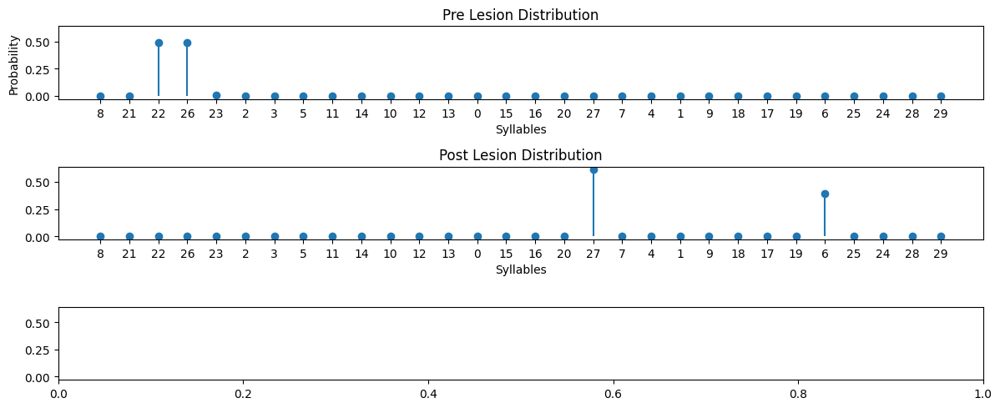

{"Earth Mover's Distance": 17.51630566550879,
 'Information Gain': 0.1187315909928639,
 'Kullback-Leibler Divergence': 19.53004235597322}


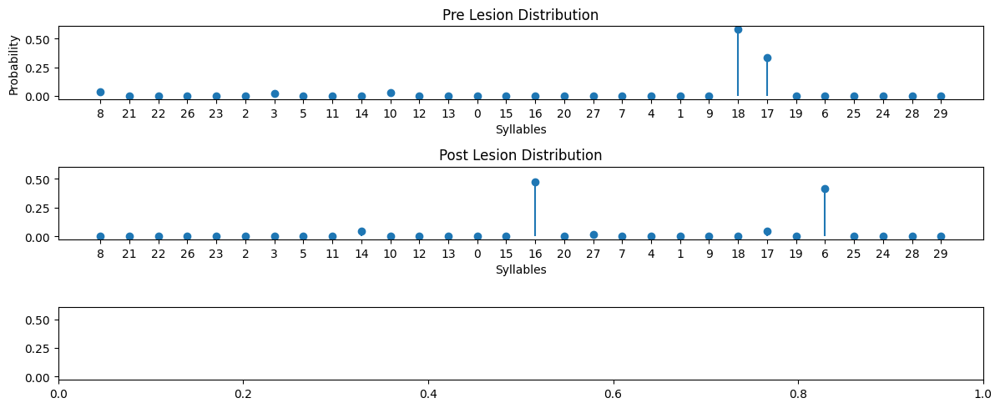

{"Earth Mover's Distance": 4.649571515864928,
 'Information Gain': -0.11353369268900138,
 'Kullback-Leibler Divergence': 16.237230334056566}


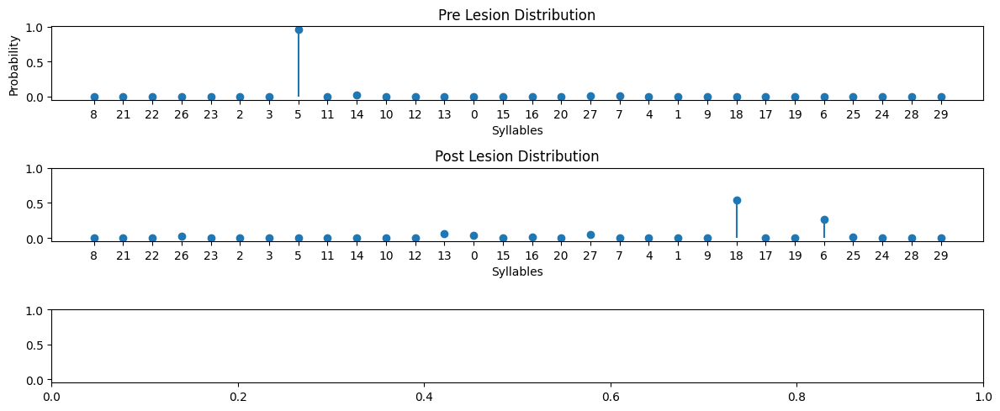

{"Earth Mover's Distance": 14.120396880171777,
 'Information Gain': -1.0805006013797815,
 'Kullback-Leibler Divergence': 22.306835190847636}


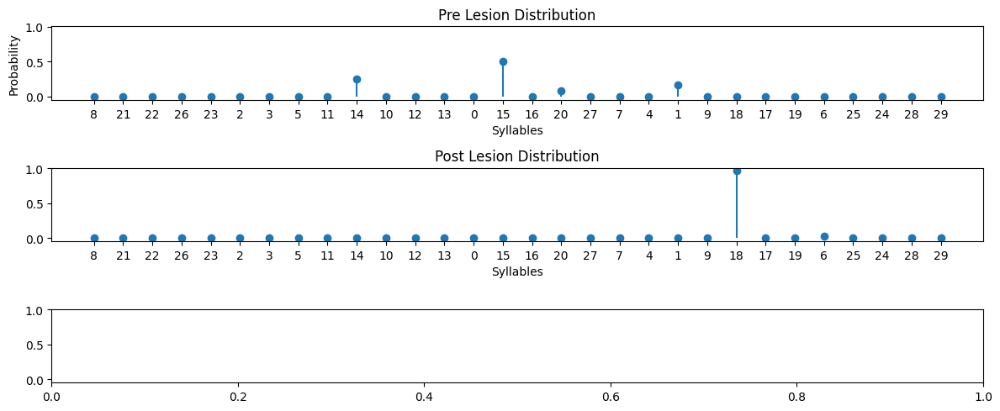

{"Earth Mover's Distance": 8.019928393187724,
 'Information Gain': 0.9632073872122418,
 'Kullback-Leibler Divergence': 22.541348718233444}


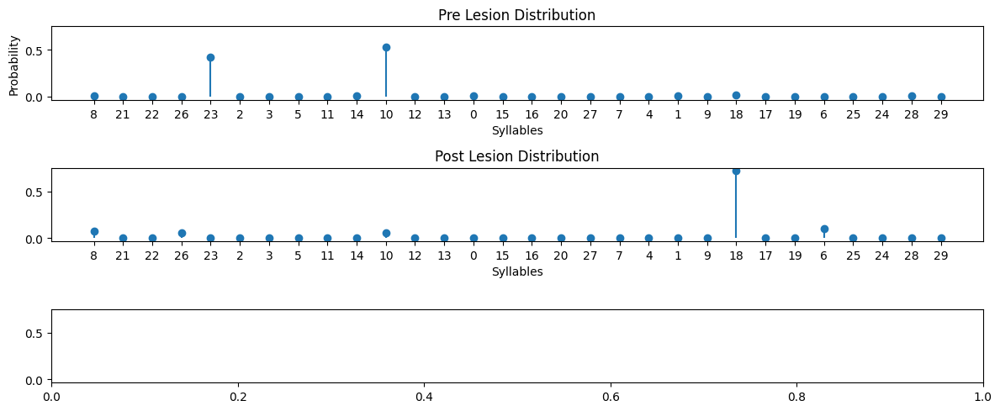

{"Earth Mover's Distance": 12.022278191742675,
 'Information Gain': -0.07759966217462622,
 'Kullback-Leibler Divergence': 10.048240861252857}


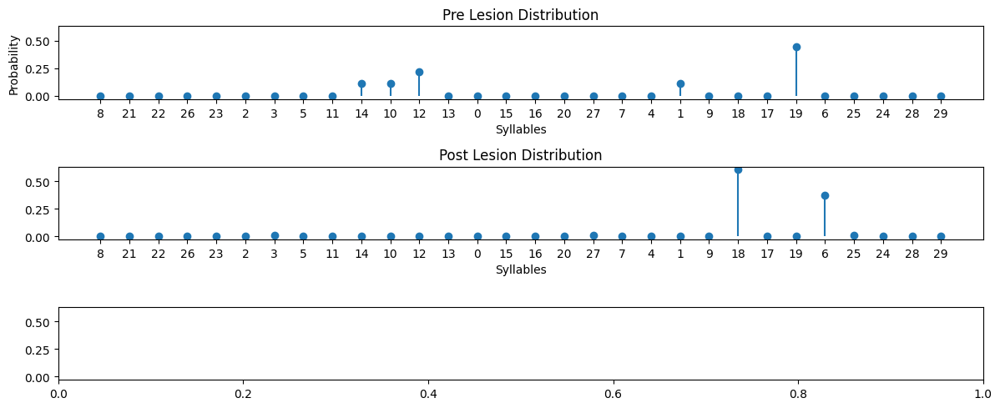

{"Earth Mover's Distance": 5.833335268589383,
 'Information Gain': 0.6314587067251516,
 'Kullback-Leibler Divergence': 20.753177173170776}


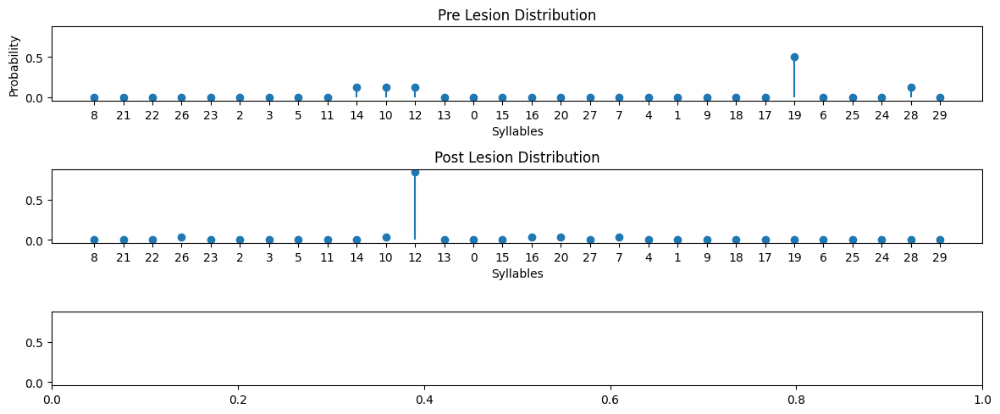

{"Earth Mover's Distance": 8.580643364949857,
 'Information Gain': 0.6849070330313773,
 'Kullback-Leibler Divergence': 14.71041643206452}


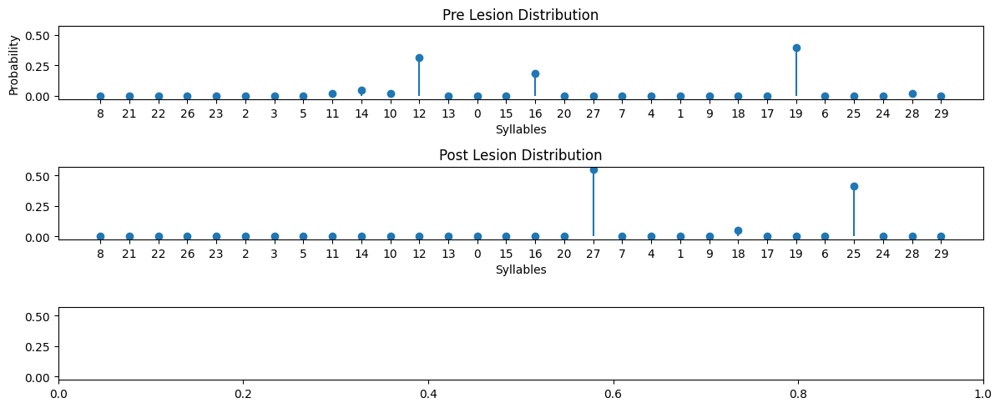

{"Earth Mover's Distance": 3.9560605851468016,
 'Information Gain': 0.5593981374443358,
 'Kullback-Leibler Divergence': 19.12152088029303}


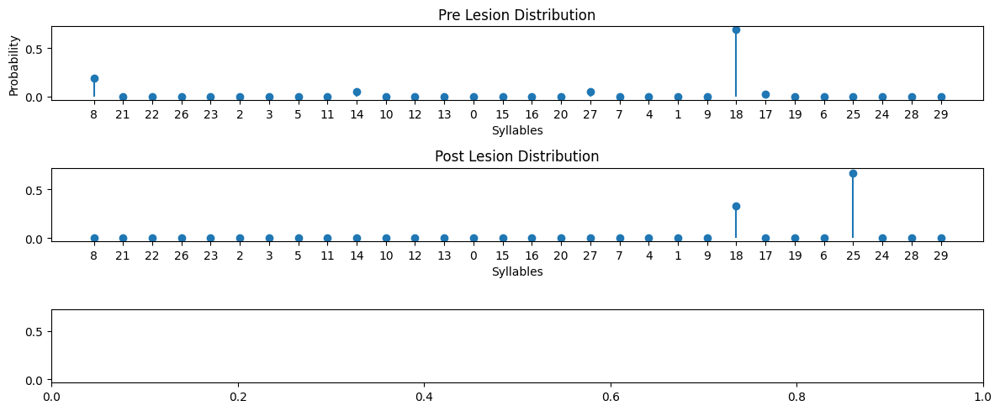

{"Earth Mover's Distance": 7.690474371930051,
 'Information Gain': 0.31401565951343957,
 'Kullback-Leibler Divergence': 5.5420419388564985}


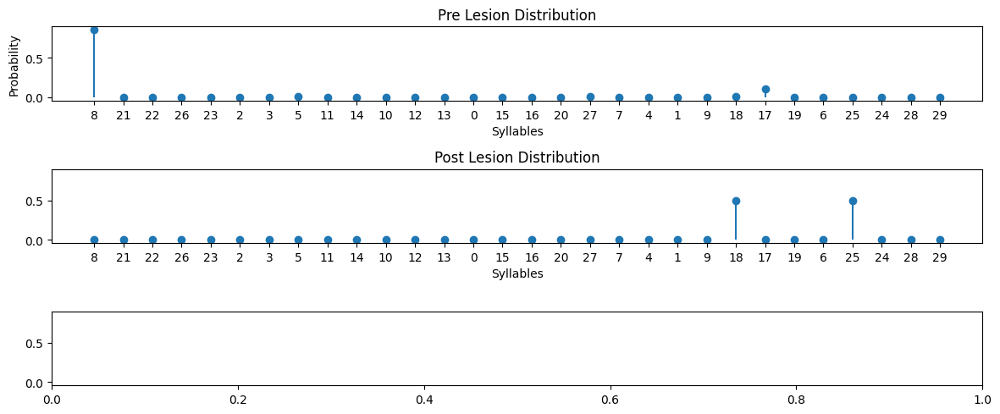

{"Earth Mover's Distance": 20.939848122891,
 'Information Gain': -0.1610421412318458,
 'Kullback-Leibler Divergence': 18.008359215870282}


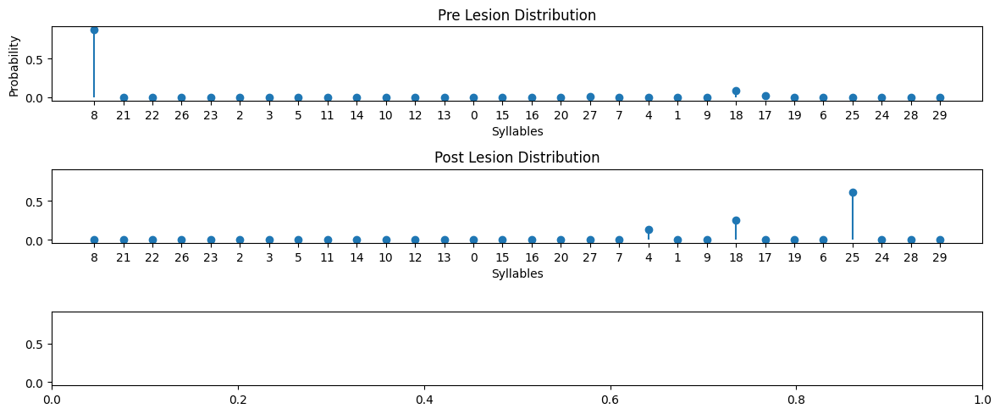

{"Earth Mover's Distance": 21.34538016096082,
 'Information Gain': -0.3953191571477649,
 'Kullback-Leibler Divergence': 18.596217364150036}


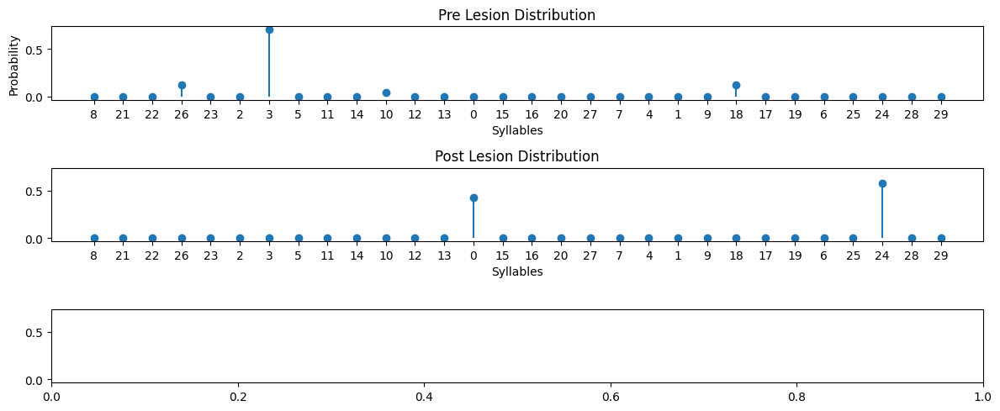

{"Earth Mover's Distance": 13.20930122597433,
 'Information Gain': 0.25220192678706255,
 'Kullback-Leibler Divergence': 18.437449597513602}


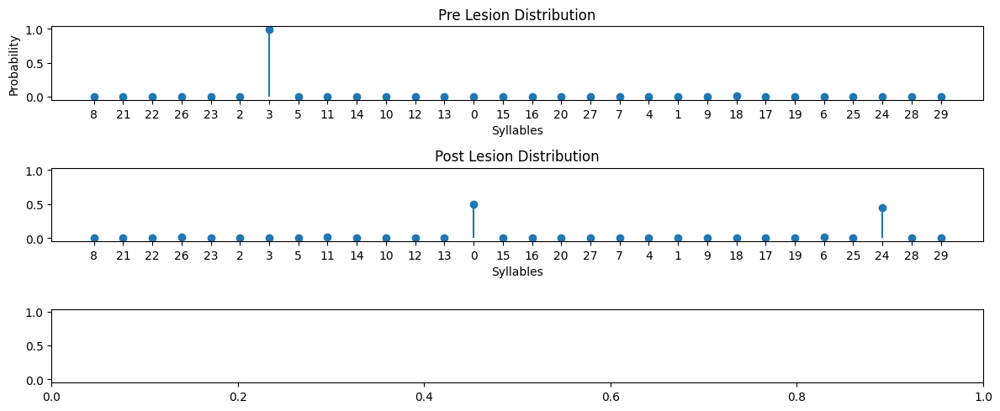

{"Earth Mover's Distance": 13.003357651859922,
 'Information Gain': -0.9335999994532101,
 'Kullback-Leibler Divergence': 6.19934650829628}


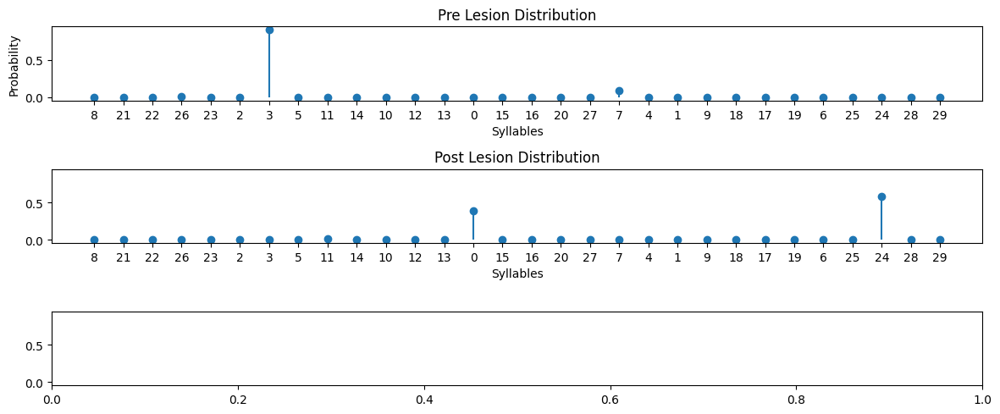

{"Earth Mover's Distance": 14.172572945728296,
 'Information Gain': -0.45297592764050354,
 'Kullback-Leibler Divergence': 21.536283400302498}


In [14]:
assert np.array_equal(pre_surgery_pst.alphabet, post_surgery_pst.alphabet), "Alphabets must be the same"

order = 3

# Check lengths before iterating
pre_probs_list = pre_surgery_pst.tree[order]['p']
post_probs_list = post_surgery_pst.tree[order]['p']

print(f"Length of pre-surgery probs: {len(pre_probs_list)}")
print(f"Length of post-surgery probs: {len(post_probs_list)}")

# only iterate up to the min length to avoid IndexError
min_length = min(len(pre_probs_list), len(post_probs_list))

for idx in range(min_length):
    pre_probs = pre_probs_list[idx]
    post_probs = post_probs_list[idx]

    # Normalize probabilities
    norm_pre_probs = (pre_probs + 1e-12) / np.sum(pre_probs)
    norm_post_probs = (post_probs + 1e-12) / np.sum(post_probs)

    # Plot metrics
    plot_before_and_after_distribution(pre_surgery_pst.alphabet, norm_pre_probs, norm_post_probs)
    metrics = calculate_metrics(norm_pre_probs, norm_post_probs)

    pprint.pprint(metrics)


**Considerations for computing KL Divergence for pre- and post-lesion data:**

1. Mismatched nodes in pre- and post-lesion trees reduces our number of valid comparisons; we only want to calculate KL Divergence for nodes that are comparable, i.e., exist in both trees. For this reason, I restricted calculations to only nodes in each order that exist in both trees.


  *  Restricting comparisons to the first min_length indices, avoided having mismatched probabilities between pre- and post-surgery trees


2. When aggregating KL Divergence values for multiple orders, the reduction in number of comparisons per order is naturally reflected in the mean calculation (i.e., fewer values are averaged)


3. Distributions were normalized before calculating KL Divergence so we can validly make direct comparisons in the KL values

4. **Interpretation**: KL Divergence values themselves don't have a strict threshold for "significance," but comparing relative changes (e.g., % increase) between pre- and post-lesion states is informative for understanding the effect of lesions on distribution patterns.
We should be looking for consistent trends across orders (e.g., an increase in divergence from pre- to post-lesion) or order-specific patterns that reflect the impact of the lesion on neural dynamics.

In [25]:
# Mean diffs in K-L Distance for comparison:

mean_kl_divergences = {"pre": [], "post": []}

for order in range(1, max_order + 1):
    # probability distributions for the current order
    pre_probs_list = pre_surgery_pst.tree[order]['p']
    post_probs_list = post_surgery_pst.tree[order]['p']

    # find length of common indices
    min_length = min(len(pre_probs_list), len(post_probs_list))

    order_kl_div_pre = []  # Pre-lesioning comparisons
    order_kl_div_post = []  # Post-lesioning comparisons

    for idx in range(min_length):
        # probability distributions for pre- and post-surgery
        pre_probs = pre_probs_list[idx]
        post_probs = post_probs_list[idx]

        # Normalize distributions
        norm_pre_probs = (pre_probs + 1e-12) / np.sum(pre_probs)
        norm_post_probs = (post_probs + 1e-12) / np.sum(post_probs)


        kl_div_pre = np.sum(norm_pre_probs * np.log(norm_pre_probs / norm_post_probs))
        kl_div_post = np.sum(norm_post_probs * np.log(norm_post_probs / norm_pre_probs))

        order_kl_div_pre.append(kl_div_pre)
        order_kl_div_post.append(kl_div_post)

    # mean KL Divergences for given order (assuming there are valid comparisons, i.e., same nodes in pre- and post-lesion trees)
    if order_kl_div_pre:
        mean_kl_div_pre = np.mean(order_kl_div_pre)
        print(f"Mean KL Divergence (pre) for order {order}: {mean_kl_div_pre}")
        mean_kl_divergences["pre"].append(mean_kl_div_pre)

    if order_kl_div_post:
        mean_kl_div_post = np.mean(order_kl_div_post)
        print(f"Mean KL Divergence (post) for order {order}: {mean_kl_div_post}")
        mean_kl_divergences["post"].append(mean_kl_div_post)

print("\nSummary of Mean KL Divergences:")
for order, (kl_pre, kl_post) in enumerate(zip(mean_kl_divergences["pre"], mean_kl_divergences["post"]), start=1):
    print(f"Order {order}: Pre-lesion = {kl_pre}, Post-lesion = {kl_post}")


Mean KL Divergence (pre) for order 1: 13.91883728992869
Mean KL Divergence (post) for order 1: 10.88027881077999
Mean KL Divergence (pre) for order 2: 15.711702431024573
Mean KL Divergence (post) for order 2: 16.26473825370809
Mean KL Divergence (pre) for order 3: 16.130501480114496
Mean KL Divergence (post) for order 3: 15.422673612146696
Mean KL Divergence (pre) for order 4: 15.10272334925135
Mean KL Divergence (post) for order 4: 13.065550977250412

Summary of Mean KL Divergences:
Order 1: Pre-lesion = 13.91883728992869, Post-lesion = 10.88027881077999
Order 2: Pre-lesion = 15.711702431024573, Post-lesion = 16.26473825370809
Order 3: Pre-lesion = 16.130501480114496, Post-lesion = 15.422673612146696
Order 4: Pre-lesion = 15.10272334925135, Post-lesion = 13.065550977250412


**Interpreting KL Divergence differences for pre- and post-lesion distributions:**

In [27]:
# Calculating % change in pre- and post-lesion KL Divergence values for easier comparison and interpretation:

def calculate_percentage_change(pre_values, post_values):
    """
    Calculate percentage change between pre- and post-lesion KL Divergence values.

    Parameters:
    - pre_values (list): Mean KL Divergence values for pre-lesion distributions.
    - post_values (list): Mean KL Divergence values for post-lesion distributions.

    Returns:
    - percent_changes (list): List of percentage change values for each order.
    """
    percentage_changes = []
    for pre, post in zip(pre_values, post_values):
        if pre > 0:
            pct_change = ((post - pre) / pre) * 100
        else:
            pct_change = float('nan')  # to deal with cases where pre-lesion KL is 0
        percentage_changes.append(pct_change)
    return percentage_changes


percentage_changes = calculate_percentage_change(mean_kl_divergences["pre"], mean_kl_divergences["post"])

# Display results
print("\nPercent change in KL Divergence (Post vs. Pre):")
for order, pct_change in enumerate(percentage_changes, start=1):
    print(f"Order {order}: {pct_change:.2f}%")



Percent change in KL Divergence (Post vs. Pre):
Order 1: -21.83%
Order 2: 3.52%
Order 3: -4.39%
Order 4: -13.49%


In [ ]:
import os
import numpy as np
import math

def pst_export_to_cytoscape(TREE, ALPHABET, **kwargs):
    """
    pst_export_to_cytoscape takes a PST computed by pst_learn
    and generates files suitable for use with Cytoscape.

    Parameters:
    TREE : list
        Structure array returned by pst_learn
    ALPHABET : list or str
        Mapping of phrase identities to rows/columns in frequency table

    Optional Parameters (kwargs):
    output_dir : str
        Directory to store generated files (default: current directory)
    filename : str
        Root name for generated files (default: 'cytoscape_output_tree')
    thresh : float
        Threshold for filtering transitions (default: 1e-5)
    """
    # Default parameters
    output_dir = kwargs.get('output_dir', os.getcwd())
    filename = kwargs.get('filename', 'cytoscape_output_tree')
    thresh = kwargs.get('thresh', 1e-5)

    # Open files for writing
    sif_path = os.path.join(output_dir, f"{filename}.sif")
    noa_gsigma_path = os.path.join(output_dir, f"{filename}.noa")
    cscript_path = os.path.join(output_dir, f"{filename}_script.txt")

    with open(sif_path, 'w') as sif_file, open(noa_gsigma_path, 'w') as noa_gsigma_file, open(cscript_path, 'w') as cscript_file:
        # Remove empty strings from TREE structure
        TREE = [node for node in TREE if node.get('string')]

        # Iterate over TREE to write .sif and .noa files
        for i in range(len(TREE) - 1):
            for j in range(len(TREE[i]['label'])):
                source = TREE[i]['label'][j]

                if not TREE[i + 1]['parent']:
                    continue

                target_idxs = [idx for idx, parent in enumerate(TREE[i + 1]['parent'][0]) if parent == j]
                target_labels = [TREE[i + 1]['label'][idx] for idx in target_idxs]

                sif_file.write(f"{source} trans")
                for target in target_labels:
                    sif_file.write(f" {target}")
                sif_file.write("\n")

        # Prepare node attributes for .noa file
        noa_gsigma_file.write('ID\t')
        if isinstance(ALPHABET, str):
            ALPHABET = list(ALPHABET)

        noa_gsigma_file.write("\t".join(ALPHABET))
        noa_gsigma_file.write("\tFrequency\tLogFrequency\tDepth")

        if 'internal' in TREE[0]:
            noa_gsigma_file.write("\tInternal\n")
            internal_flag = True
        else:
            noa_gsigma_file.write("\n")
            internal_flag = False

        # Iterate again for .noa file and node chart script
        for i, node in enumerate(TREE):
            for j, label in enumerate(node['label']):
                cscript_file.write(f'nodecharts pie nodelist="{label}"')

                noa_gsigma_file.write(f"{label}\t")
                labellist = ''
                colorlist = ''
                valuelist = ''



                for k, value in enumerate(node['g_sigma_s'][j]):
                    noa_gsigma_file.write(f"{value:.2f}\t")

                    if value > thresh:
                        labellist += f"{ALPHABET[k]},"
                        colorlist += f"{'#%02X%02X%02X' % tuple(np.random.randint(0, 256, 3))},"
                        valuelist += f"{value},"

                if len(labellist.strip(',')) == 2:
                    labellist += 'null,'
                    valuelist += '0,'
                    colorlist += '#%02X%02X%02X,' % tuple(np.random.randint(0, 256, 3))

                cscript_file.write(f' labellist="{labellist.strip(",")}"')
                cscript_file.write(f' valuelist="{valuelist.strip(",")}"')
                cscript_file.write(f' colorlist="{colorlist.strip(",")}"\n')

                #node_f = node['f'][j] + 1e-15
                #print(node_f)
                #print(node['f'][j])
                #noa_gsigma_file.write(f"{node['f'][j]:g}\t{math.log(node_f):g}\t{i - 1}")

                if internal_flag:
                    noa_gsigma_file.write(f"\t{node['internal'][j]}")

                noa_gsigma_file.write("\n")

pst_export_to_cytoscape(
    pre_surgery_pst.tree,
    pre_surgery_pst.alphabet,
    output_dir='.', filename='pre_surgery_pst')
